In [41]:
from pathlib import Path
import sys
import shutil
import time
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress
from datetime import date
import pandas as pd
import yfinance as yf

from curl_cffi import requests
session = requests.Session(impersonate="chrome")
from matplotlib.ticker import PercentFormatter

import matplotlib_fontja

# カレントワーキングディレクトリ（Jupyterを起動した場所）をプロジェクトルートとする
project_root = Path.cwd().parent
sys.path.append(str(project_root))

# パスが通ったので、srcフォルダからインポートできる
from src.data_loader import update_and_load_asset_data, load_latest_asset_data

# パラメータ管理

In [42]:
# 最古日を自動取得する関数
def get_earliest_date(ticker):
    try:
        df = yf.Ticker(ticker).history(period="max")
        if not df.empty:
            return df.index[0].strftime("%Y-%m-%d")
        else:
            return "データなし"
    except Exception as e:
        return f"エラー: {e}"

# assets 辞書（簡易版）
assets = {
    'EMERGING':  {'ticker': 'VWO', 'start': '2005-01-01'},      #✅ETF（配当あり）→Adj Closeあり（配当込み価格を反映）
    'SP500':     {'ticker': '^GSPC', 'start': '1927-12-30'},    #❌指数（S&P500価格指数）→Adj Closeなし（配当含まず）
    'SP500_TR':  {'ticker': 'VOO', 'start': '2010-09-09'},      #✅S&P500トータルリターンの代替としてVOO（配当込みETF）を使用→Adj Closeあり
    'NIKKEI':    {'ticker': '^N225', 'start': '1965-01-05'},    #❌指数（日経平均）→Adj Closeなし（配当含まず）
    'NASDAQ100_QQQM': {'ticker': 'QQQM', 'start': '2020-10-13'},#✅NASDAQ100トータルリターンETF（配当込み）→Adj Closeあり
    'NASDAQ100_QQQ': {'ticker': 'QQQ', 'start': '1999-10-03'},  #✅NASDAQ100トータルリターンETF（配当込み）→Adj Closeあり
    'NIKKEI_TR': {'ticker': '1329.T', 'start': '2008-10-14'},   #✅日経平均トータルリターンの代替としてETF「日経225連動型上場投信（東証：1329）」を使用→Adj Closeあり（配当込み）
    'BOND':      {'ticker': 'TLT', 'start': '2002-01-01'},      #✅債券ETF（利子収入あり）→Adj Closeあり（配当込み反映）
    'ALL_WORLD': {'ticker': 'VT', 'start': '2008-01-01'},       #✅ETF（配当あり）→Adj Closeあり
    'INDIA':     {'ticker': 'INDA','start': '2012-01-01'},      #✅ETF（配当あり）→Adj Closeあり
    'CHINA':     {'ticker': 'MCHI','start': '2011-03-29'},      #✅ETF（配当あり）→Adj Closeあり

    'BTC':       {'ticker': 'BTC-USD','start': '2014-01-01'},   #❌仮想通貨（配当なし）→Adj Closeなし（Close = 実質価格）
    'ETH':       {'ticker': 'ETH-USD', 'start': '2015-08-07'},  #❌仮想通貨（配当なし）→Adj Closeなし
    'XRP':       {'ticker': 'XRP-USD', 'start': '2015-01-01'},  #❌仮想通貨（配当なし）→Adj Closeなし
    'SOL':       {'ticker': 'SOL-USD', 'start': '2020-04-10'},  #❌仮想通貨（配当なし）→Adj Closeなし（Close = 実質価格）
    'ADA':       {'ticker': 'ADA-USD', 'start': '2018-10-01'},  #❌仮想通貨（カルダノ、配当なし）→Adj Closeなし
    'DOT':       {'ticker': 'DOT-USD', 'start': '2020-08-20'},  #❌仮想通貨（ポルカドット、配当なし）→Adj Closeなし
    'MATIC':     {'ticker': 'MATIC-USD', 'start': '2019-05-17'},#❌仮想通貨（ポリゴン、配当なし）→Adj Closeなし

    'OIL':       {'ticker': 'CL=F', 'start': '1983-01-01'},     #❌原油先物（インカムなし）→Adj Closeなし
    'GOLD':      {'ticker': 'GC=F', 'start': '1970-01-01'},     #❌金先物（インカムなし）→Adj Closeなし

    'KO':        {'ticker': 'KO', 'start': '1962-01-02'},       #✅株式（高配当株）→Adj Closeあり（配当込み価格）
    'META':      {'ticker': 'META', 'start': '2012-05-18'},     #✅株式（無配）→Adj Closeあり（配当なしだが分割調整など反映）
    'AAPL':      {'ticker': 'AAPL', 'start': '1980-12-12'},     #✅株式（少額配当）→Adj Closeあり（配当込み）
    'AMZN':      {'ticker': 'AMZN', 'start': '1997-05-15'},     #✅株式（無配）→Adj Closeあり
    'GOOGL':     {'ticker': 'GOOGL', 'start': '2004-08-19'},    #✅株式（無配）→Adj Closeあり
    'MSFT':      {'ticker': 'MSFT', 'start': '1986-03-13'},     #✅株式（配当あり）→Adj Closeあり
    'TSLA':      {'ticker': 'TSLA', 'start': '2010-06-29'},     #✅株式（無配）→Adj Closeあり
    'NVDA':      {'ticker': 'NVDA', 'start': '1999-01-22'},     #✅株式（少額配当）→Adj Closeあり
}

In [43]:
import os
print(os.getcwd())

c:\Users\t-miura\Documents\05.portfolio\financial_analytics\notebook


In [48]:
# 新たにデータをダウンロードするか
is_download = False
data_folder = Path("../data")

# 今日の日付を取得
today_str = date.today().strftime("%Y%m%d")

new_output_folder = data_folder / today_str

# data_dict = {}

if is_download:
    data_dict = update_and_load_asset_data(assets,
                                          data_folder,
                                          today_str,
                                          session=session,
                                          )
#     for name, info in assets.items():
#         # 保存ファイル名
#         filename = data_folder / f"{name}_day_{info['start'].replace('-', '')}_{today_str}.parquet"
#         if not filename.exists():
#             print(f"Downloading {name}...")
#             data = yf.download(info['ticker'],
#                                 start=info['start'],
#                                 auto_adjust=True,
#                                 session=session,
#                                 )
#             time.sleep(1)

#             # ファイル名パターンの生成
#             pattern = f"{name}_day_{info['start'].replace('-', '')}_*.parquet"

#             # データフォルダと "old" サブフォルダのパス
#             old_folder = data_folder / "old"

#             # "old" フォルダがなければ作成
#             old_folder.mkdir(exist_ok=True)

#             # data_folder内の過去ファイルを探す
#             for old_file in data_folder.glob(pattern):
#                 if old_file.is_file():
#                     # old フォルダ内に同じパターンにマッチするファイルがあれば削除
#                     for old_existing in old_folder.glob(pattern):
#                         try:
#                             old_existing.unlink()
#                             print(f"削除（old フォルダ内）: {old_existing}")
#                         except Exception as e:
#                             print(f"削除エラー: {old_existing} -> {e}")

#                     # ファイルを old フォルダに移動
#                     destination = old_folder / old_file.name
#                     try:
#                         shutil.move(str(old_file), str(destination))
#                         print(f"移動: {old_file} -> {destination}")
#                     except Exception as e:
#                         print(f"移動エラー: {old_file} -> {destination}\n{e}")
#                 else:
#                     print(f"ファイルが存在しません: {old_file}")
#             data.to_parquet(filename)  # 保存

#         else:
#             data = pd.read_parquet(filename)

#         data_dict[name] = data

else:
    loaded_data = load_latest_asset_data(assets=assets, data_folder=data_folder)

    # for name, info in assets.items():
    #     pattern = f"{name}_day_{info['start'].replace('-', '')}_*.parquet"
    #     files = data_folder.glob(pattern)
    #     if not files:
    #         raise FileNotFoundError(f"No saved file found for {name}.")
    #     # 最新の日付のファイルを選ぶ
    #     latest_file = max(files, key=os.path.getmtime)
    #     print(f"Loading {latest_file}")
    #     data = pd.read_parquet(latest_file)
    #     data_dict[name] = data

for name, info in assets.items():
    print(name)
    display(data_dict[name])

最新のローカルファイルを探しています...
読み込み中: EMERGING_day_20050101_20250907.parquet
読み込み中: SP500_day_19271230_20250907.parquet
読み込み中: SP500_TR_day_20100909_20250907.parquet
読み込み中: NIKKEI_day_19650105_20250907.parquet
読み込み中: NASDAQ100_QQQM_day_20201013_20250907.parquet
読み込み中: NASDAQ100_QQQ_day_19991003_20250907.parquet
読み込み中: NIKKEI_TR_day_20081014_20250907.parquet
読み込み中: BOND_day_20020101_20250907.parquet
読み込み中: ALL_WORLD_day_20080101_20250907.parquet
読み込み中: INDIA_day_20120101_20250907.parquet
読み込み中: CHINA_day_20110329_20250907.parquet
読み込み中: BTC_day_20140101_20250907.parquet
読み込み中: ETH_day_20150807_20250907.parquet
読み込み中: XRP_day_20150101_20250907.parquet
読み込み中: SOL_day_20200410_20250907.parquet
読み込み中: ADA_day_20181001_20250907.parquet
読み込み中: DOT_day_20200820_20250907.parquet
読み込み中: MATIC_day_20190517_20250907.parquet
読み込み中: OIL_day_19830101_20250907.parquet
読み込み中: GOLD_day_19700101_20250907.parquet
読み込み中: KO_day_19620102_20250907.parquet
読み込み中: META_day_20120518_20250907.parquet
読み込み中: AAPL_day_1980

Price,Close,High,Low,Open,Volume
Ticker,VWO,VWO,VWO,VWO,VWO
Date,,,,,
2005-03-10,14.686289,14.785837,14.624803,14.727279,108200
2005-03-11,14.668724,14.823903,14.665797,14.750706,184400
2005-03-14,14.580885,14.671650,14.522327,14.627731,112800
2005-03-15,14.264675,14.452060,14.258819,14.419853,127800
2005-03-16,14.141702,14.279313,14.127062,14.238323,196400
...,...,...,...,...,...
2025-08-29,51.529999,51.590000,51.330002,51.500000,6356500
2025-09-02,51.459999,51.490002,51.009998,51.070000,10064300


SP500


Price,Close,High,Low,Open,Volume
Ticker,^GSPC,^GSPC,^GSPC,^GSPC,^GSPC
Date,,,,,
1927-12-30,17.660000,17.660000,17.660000,17.660000,0
1928-01-03,17.760000,17.760000,17.760000,17.760000,0
1928-01-04,17.719999,17.719999,17.719999,17.719999,0
1928-01-05,17.549999,17.549999,17.549999,17.549999,0
1928-01-06,17.660000,17.660000,17.660000,17.660000,0
...,...,...,...,...,...
2025-08-29,6460.259766,6491.759766,6444.569824,6489.279785,4234840000
2025-09-02,6415.540039,6416.540039,6360.580078,6401.509766,4784000000


SP500_TR


Price,Close,High,Low,Open,Volume
Ticker,VOO,VOO,VOO,VOO,VOO
Date,,,,,
2010-09-09,77.214424,78.113684,77.077249,78.113684,26500
2010-09-10,77.564972,77.625940,77.199175,77.488765,8600
2010-09-13,78.540459,78.601427,78.113693,78.464251,33750
2010-09-14,78.525208,78.860527,78.022229,78.372787,59400
2010-09-15,78.723343,78.784305,78.037466,78.205125,9250
...,...,...,...,...,...
2025-08-29,593.080017,595.549988,591.250000,595.239990,7512000
2025-09-02,588.710022,588.799988,583.669983,586.059998,11116700


NIKKEI


Price,Close,High,Low,Open,Volume
Ticker,^N225,^N225,^N225,^N225,^N225
Date,,,,,
1965-01-05,1257.719971,1257.719971,1257.719971,1257.719971,0
1965-01-06,1263.989990,1263.989990,1263.989990,1263.989990,0
1965-01-07,1274.270020,1274.270020,1274.270020,1274.270020,0
1965-01-08,1286.430054,1286.430054,1286.430054,1286.430054,0
1965-01-12,1288.540039,1288.540039,1288.540039,1288.540039,0
...,...,...,...,...,...
2025-09-01,42188.789062,42454.988281,41835.171875,42362.710938,96600000
2025-09-02,42310.488281,42473.671875,42084.781250,42299.628906,99800000


NASDAQ100_QQQM


Price,Close,High,Low,Open,Volume
Ticker,QQQM,QQQM,QQQM,QQQM,QQQM
Date,,,,,
2020-10-13,117.389015,118.281189,116.913829,117.418107,13100
2020-10-14,116.341644,118.037748,115.758823,117.660513,37800
2020-10-15,115.504761,115.672525,114.226621,114.460330,30600
2020-10-16,114.916107,116.768345,114.916107,116.273767,51000
2020-10-19,112.928116,116.205897,112.719622,116.205897,50600
...,...,...,...,...,...
2025-08-29,234.809998,236.690002,234.059998,236.550003,3796500
2025-09-02,232.850006,232.960007,230.369995,231.070007,3856900


NASDAQ100_QQQ


Price,Close,High,Low,Open,Volume
Ticker,QQQ,QQQ,QQQ,QQQ,QQQ
Date,,,,,
1999-10-04,52.124569,52.309783,50.960365,51.251416,12434200
1999-10-05,52.494987,53.130007,51.383702,52.309773,19526400
1999-10-06,53.546738,53.626115,52.012106,52.812496,19098200
1999-10-07,53.421066,54.102390,53.024179,53.844413,22013600
1999-10-08,53.983299,54.135439,52.494972,53.209369,22523200
...,...,...,...,...,...
2025-08-29,570.400024,575.030029,568.539978,574.659973,56030400
2025-09-02,565.619995,565.969971,559.539978,561.309998,65876800


NIKKEI_TR


Price,Close,High,Low,Open,Volume
Ticker,1329.T,1329.T,1329.T,1329.T,1329.T
Date,,,,,
2009-01-05,7584.192871,7717.982381,7584.192871,7717.982381,1380
2009-01-06,7600.916504,7667.811259,7600.916504,7651.087570,2110
2009-01-07,7734.706543,7809.963147,7717.982853,7784.877612,5000
2009-01-08,7517.298340,7592.554942,7500.574651,7592.554942,4900
2009-01-09,7559.107422,7559.107422,7442.041599,7442.041599,1890
...,...,...,...,...,...
2025-09-01,4359.000000,4385.000000,4322.000000,4374.000000,376469
2025-09-02,4372.000000,4389.000000,4349.000000,4374.000000,239701


BOND


Price,Close,High,Low,Open,Volume
Ticker,TLT,TLT,TLT,TLT,TLT
Date,,,,,
2002-07-30,37.184689,37.358025,37.184689,37.289603,6100
2002-07-31,37.645370,37.768531,37.358002,37.380807,29400
2002-08-01,37.859749,37.868870,37.649924,37.649924,25000
2002-08-02,38.247486,38.361522,37.805028,37.932751,52800
2002-08-05,38.416256,38.516608,38.247482,38.334150,61100
...,...,...,...,...,...
2025-08-29,86.272003,86.531021,86.112613,86.431401,41686400
2025-09-02,85.629997,85.839996,85.480003,85.629997,48760600


ALL_WORLD


Price,Close,High,Low,Open,Volume
Ticker,VT,VT,VT,VT,VT
Date,,,,,
2008-06-26,34.468807,34.753846,34.301954,34.705178,15800
2008-06-27,34.413189,35.768861,34.246336,35.768861,26800
2008-06-30,34.441006,35.956577,34.315867,35.956577,23900
2008-07-01,34.135109,34.482717,33.189617,34.155967,55100
2008-07-02,33.634552,34.545283,33.634552,34.441002,74700
...,...,...,...,...,...
2025-08-29,133.770004,134.100006,133.429993,134.029999,4013100
2025-09-02,132.809998,132.860001,131.889999,132.309998,2749600


INDIA


Price,Close,High,Low,Open,Volume
Ticker,INDA,INDA,INDA,INDA,INDA
Date,,,,,
2012-02-03,23.198490,23.198490,23.198490,23.198490,100
2012-02-06,23.016163,23.997236,22.946706,23.997236,4100
2012-02-07,22.807798,22.807798,22.799116,22.799116,2300
2012-02-08,23.059578,23.988559,22.920665,23.988559,3700
2012-02-09,22.998806,23.120354,22.998806,23.120354,2500
...,...,...,...,...,...
2025-08-29,51.980000,52.009998,51.830002,52.000000,4761600
2025-09-02,52.349998,52.400002,52.099998,52.110001,5577800


CHINA


Price,Close,High,Low,Open,Volume
Ticker,MCHI,MCHI,MCHI,MCHI,MCHI
Date,,,,,
2011-03-31,38.761555,38.798897,38.530030,38.604714,14200
2011-04-01,39.299286,39.373973,39.232069,39.269414,2900
2011-04-04,40.135761,40.165633,39.672712,40.165633,10500
2011-04-05,39.896763,40.001324,39.881828,39.956512,3700
2011-04-06,40.098404,40.307524,39.978908,40.300054,4700
...,...,...,...,...,...
2025-08-29,61.310001,61.450001,60.860001,60.910000,4727100
2025-09-02,61.639999,61.669998,60.730000,60.889999,3852200


BTC


Price,Close,High,Low,Open,Volume
Ticker,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD
Date,,,,,
2014-09-17,457.334015,468.174011,452.421997,465.864014,21056800
2014-09-18,424.440002,456.859985,413.104004,456.859985,34483200
2014-09-19,394.795990,427.834991,384.532013,424.102997,37919700
2014-09-20,408.903992,423.295990,389.882996,394.673004,36863600
2014-09-21,398.821014,412.425995,393.181000,408.084991,26580100
...,...,...,...,...,...
2025-09-03,111723.210938,112600.226562,110582.960938,111190.695312,61119643565
2025-09-04,110723.601562,112208.328125,109347.226562,111718.148438,60131132901


ETH


Price,Close,High,Low,Open,Volume
Ticker,ETH-USD,ETH-USD,ETH-USD,ETH-USD,ETH-USD
Date,,,,,
2017-11-09,320.884003,329.451996,307.056000,308.644989,893249984
2017-11-10,299.252991,324.717987,294.541992,320.670990,885985984
2017-11-11,314.681000,319.453003,298.191986,298.585999,842300992
2017-11-12,307.907990,319.153015,298.513000,314.690002,1613479936
2017-11-13,316.716003,328.415009,307.024994,307.024994,1041889984
...,...,...,...,...,...
2025-09-03,4450.389160,4489.198730,4286.206055,4324.696289,35260873497
2025-09-04,4298.744141,4483.451172,4268.588867,4450.215820,34919798552


XRP


Price,Close,High,Low,Open,Volume
Ticker,XRP-USD,XRP-USD,XRP-USD,XRP-USD,XRP-USD
Date,,,,,
2017-11-09,0.217488,0.221791,0.214866,0.217911,147916992
2017-11-10,0.206483,0.219068,0.205260,0.218256,141032992
2017-11-11,0.210430,0.214456,0.205459,0.205948,134503008
2017-11-12,0.197339,0.210214,0.195389,0.210214,251175008
2017-11-13,0.203442,0.204081,0.197456,0.197472,132567000
...,...,...,...,...,...
2025-09-03,2.844895,2.884850,2.814042,2.861848,4435438842
2025-09-04,2.795828,2.859074,2.788586,2.844905,4856488220


SOL


Price,Close,High,Low,Open,Volume
Ticker,SOL-USD,SOL-USD,SOL-USD,SOL-USD,SOL-USD
Date,,,,,
2020-04-10,0.951054,1.313487,0.694187,0.832005,87364276
2020-04-11,0.776819,1.049073,0.765020,0.951054,43862444
2020-04-12,0.882507,0.956670,0.762426,0.785448,38736897
2020-04-13,0.777832,0.891603,0.773976,0.890760,18211285
2020-04-14,0.661925,0.796472,0.628169,0.777832,16747614
...,...,...,...,...,...
2025-09-03,210.746307,212.823517,207.584076,209.482788,6966454259
2025-09-04,202.560181,211.795013,202.127014,210.746307,5241887525


ADA


Price,Close,High,Low,Open,Volume
Ticker,ADA-USD,ADA-USD,ADA-USD,ADA-USD,ADA-USD
Date,,,,,
2018-10-01,0.084469,0.085806,0.082636,0.085292,42076400
2018-10-02,0.082525,0.084681,0.082388,0.084604,34775200
2018-10-03,0.080789,0.082405,0.079175,0.082032,38063700
2018-10-04,0.081304,0.082789,0.080534,0.080818,31665100
2018-10-05,0.082991,0.083091,0.080690,0.081381,31160900
...,...,...,...,...,...
2025-09-03,0.836530,0.843014,0.827355,0.834580,873946795
2025-09-04,0.809887,0.841346,0.804167,0.836530,865781781


DOT


Price,Close,High,Low,Open,Volume
Ticker,DOT-USD,DOT-USD,DOT-USD,DOT-USD,DOT-USD
Date,,,,,
2020-08-20,2.900080,3.077784,2.692896,2.787857,48819867
2020-08-21,2.875028,3.090093,2.730919,2.896923,49313137
2020-08-22,4.484690,4.510613,2.816762,2.878570,485801096
2020-08-23,3.967066,4.487058,3.716271,4.487058,320749483
2020-08-24,4.602614,4.783158,3.812670,3.987413,407690171
...,...,...,...,...,...
2025-09-03,3.864390,3.899873,3.794403,3.816989,202485380
2025-09-04,3.766683,3.874156,3.735703,3.864390,192000270


MATIC


Price,Close,High,Low,Open,Volume
Ticker,MATIC-USD,MATIC-USD,MATIC-USD,MATIC-USD,MATIC-USD
Date,,,,,
2019-05-17,0.014353,0.015077,0.009329,0.010863,168390964
2019-05-18,0.012293,0.014799,0.012092,0.014353,56628223
2019-05-19,0.020231,0.020749,0.012309,0.012320,141440073
2019-05-20,0.029343,0.032911,0.019292,0.020231,396597433
2019-05-21,0.029454,0.045017,0.025149,0.029349,698132268
...,...,...,...,...,...
2025-03-20,0.211370,0.220693,0.210122,0.220134,2428683
2025-03-21,0.206306,0.213117,0.203800,0.211360,1028770


OIL


Price,Close,High,Low,Open,Volume
Ticker,CL=F,CL=F,CL=F,CL=F,CL=F
Date,,,,,
2000-08-23,32.049999,32.799999,31.950001,31.950001,79385
2000-08-24,31.629999,32.240002,31.400000,31.900000,72978
2000-08-25,32.049999,32.099998,31.320000,31.700001,44601
2000-08-28,32.869999,32.919998,31.860001,32.040001,46770
2000-08-29,32.720001,33.029999,32.560001,32.820000,49131
...,...,...,...,...,...
2025-08-29,64.010002,64.550003,63.880001,64.260002,0
2025-09-02,65.589996,66.029999,63.660000,63.950001,320218


GOLD


Price,Close,High,Low,Open,Volume
Ticker,GC=F,GC=F,GC=F,GC=F,GC=F
Date,,,,,
2000-08-30,273.899994,273.899994,273.899994,273.899994,0
2000-08-31,278.299988,278.299988,274.799988,274.799988,0
2000-09-01,277.000000,277.000000,277.000000,277.000000,0
2000-09-05,275.799988,275.799988,275.799988,275.799988,2
2000-09-06,274.200012,274.200012,274.200012,274.200012,0
...,...,...,...,...,...
2025-08-29,3473.699951,3475.600098,3426.600098,3432.500000,0
2025-09-02,3549.399902,3559.199951,3485.699951,3485.699951,658


KO


Price,Close,High,Low,Open,Volume
Ticker,KO,KO,KO,KO,KO
Date,,,,,
1962-01-02,0.045716,0.046961,0.045716,0.045716,806400
1962-01-03,0.044698,0.045037,0.044019,0.045037,1574400
1962-01-04,0.045037,0.045377,0.044811,0.044811,844800
1962-01-05,0.044019,0.045603,0.043906,0.045037,1420800
1962-01-08,0.043566,0.043680,0.042718,0.043680,2035200
...,...,...,...,...,...
2025-08-29,68.989998,69.139999,68.430000,68.669998,14601100
2025-09-02,69.059998,69.339996,68.260002,68.959999,24770100


META


Price,Close,High,Low,Open,Volume
Ticker,META,META,META,META,META
Date,,,,,
2012-05-18,38.021408,44.754470,37.792663,41.820565,573576400
2012-05-21,33.844326,36.459977,32.819947,36.330686,168192700
2012-05-22,30.830860,33.406729,30.771188,32.432076,101786600
2012-05-23,31.825403,32.322675,31.188896,31.198841,73600000
2012-05-24,32.849785,33.028803,31.596661,32.770223,50237200
...,...,...,...,...,...
2025-08-29,738.700012,747.140015,735.349976,745.280029,9070500
2025-09-02,735.109985,736.000000,721.729980,726.039978,9350900


AAPL


Price,Close,High,Low,Open,Volume
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL
Date,,,,,
1980-12-12,0.098485,0.098913,0.098485,0.098485,469033600
1980-12-15,0.093347,0.093775,0.093347,0.093775,175884800
1980-12-16,0.086495,0.086924,0.086495,0.086924,105728000
1980-12-17,0.088636,0.089064,0.088636,0.088636,86441600
1980-12-18,0.091206,0.091634,0.091206,0.091206,73449600
...,...,...,...,...,...
2025-08-29,232.139999,233.380005,231.369995,232.509995,39418400
2025-09-02,229.720001,230.850006,226.970001,229.250000,44075600


AMZN


Price,Close,High,Low,Open,Volume
Ticker,AMZN,AMZN,AMZN,AMZN,AMZN
Date,,,,,
1997-05-15,0.097917,0.125000,0.096354,0.121875,1443120000
1997-05-16,0.086458,0.098958,0.085417,0.098438,294000000
1997-05-19,0.085417,0.088542,0.081250,0.088021,122136000
1997-05-20,0.081771,0.087500,0.081771,0.086458,109344000
1997-05-21,0.071354,0.082292,0.068750,0.081771,377064000
...,...,...,...,...,...
2025-08-29,229.000000,231.809998,228.160004,231.320007,26199200
2025-09-02,225.339996,226.169998,221.830002,223.520004,38843900


GOOGL


Price,Close,High,Low,Open,Volume
Ticker,GOOGL,GOOGL,GOOGL,GOOGL,GOOGL
Date,,,,,
2004-08-19,2.496041,2.588579,2.387085,2.487584,893181924
2004-08-20,2.694301,2.713456,2.500021,2.512708,456686856
2004-08-23,2.721416,2.822910,2.712710,2.754999,365122512
2004-08-24,2.608728,2.776143,2.576390,2.767188,304946748
2004-08-25,2.636839,2.686591,2.584102,2.610968,183772044
...,...,...,...,...,...
2025-08-29,212.910004,214.649994,210.199997,210.509995,39728400
2025-09-02,211.350006,211.679993,206.199997,208.440002,47523000


MSFT


Price,Close,High,Low,Open,Volume
Ticker,MSFT,MSFT,MSFT,MSFT,MSFT
Date,,,,,
1986-03-13,0.059500,0.062156,0.054188,0.054188,1031788800
1986-03-14,0.061625,0.062688,0.059500,0.059500,308160000
1986-03-17,0.062688,0.063219,0.061625,0.061625,133171200
1986-03-18,0.061093,0.063219,0.060562,0.062688,67766400
1986-03-19,0.060031,0.061625,0.059500,0.061093,47894400
...,...,...,...,...,...
2025-08-29,506.690002,509.600006,504.489990,508.660004,20961600
2025-09-02,505.119995,506.000000,496.809998,500.470001,18128000


TSLA


Price,Close,High,Low,Open,Volume
Ticker,TSLA,TSLA,TSLA,TSLA,TSLA
Date,,,,,
2010-06-29,1.592667,1.666667,1.169333,1.266667,281494500
2010-06-30,1.588667,2.028000,1.553333,1.719333,257806500
2010-07-01,1.464000,1.728000,1.351333,1.666667,123282000
2010-07-02,1.280000,1.540000,1.247333,1.533333,77097000
2010-07-06,1.074000,1.333333,1.055333,1.333333,103003500
...,...,...,...,...,...
2025-08-29,333.869995,348.750000,331.700012,347.230011,81145700
2025-09-02,329.359985,333.329987,325.600006,328.230011,58392000


NVDA


Price,Close,High,Low,Open,Volume
Ticker,NVDA,NVDA,NVDA,NVDA,NVDA
Date,,,,,
1999-01-22,0.037609,0.044772,0.035579,0.040116,2714688000
1999-01-25,0.041549,0.042026,0.037609,0.040594,510480000
1999-01-26,0.038325,0.042862,0.037728,0.042026,343200000
1999-01-27,0.038206,0.039400,0.036295,0.038444,244368000
1999-01-28,0.038086,0.038444,0.037848,0.038206,227520000
...,...,...,...,...,...
2025-08-29,174.179993,178.149994,173.149994,178.110001,243257900
2025-09-02,170.779999,172.380005,167.220001,170.000000,231164900


In [45]:
# xを空白を考慮した開始日からの日数にした場合の年利を計算する
def compute_annualized_return(slope, index, days_per_year=365):
    return 10 ** (slope * days_per_year) - 1

# 生データと回帰指数曲線

EMERGING


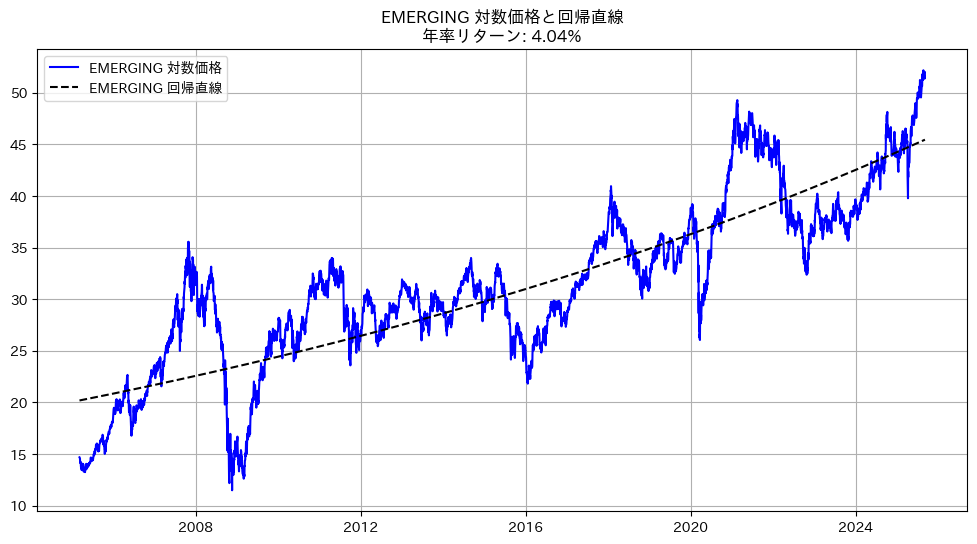

SP500


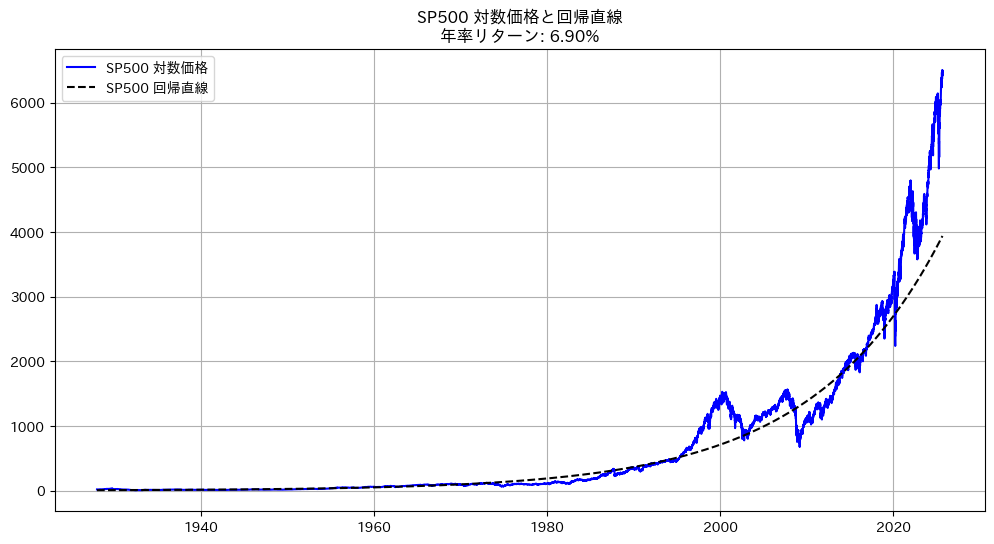

SP500_TR


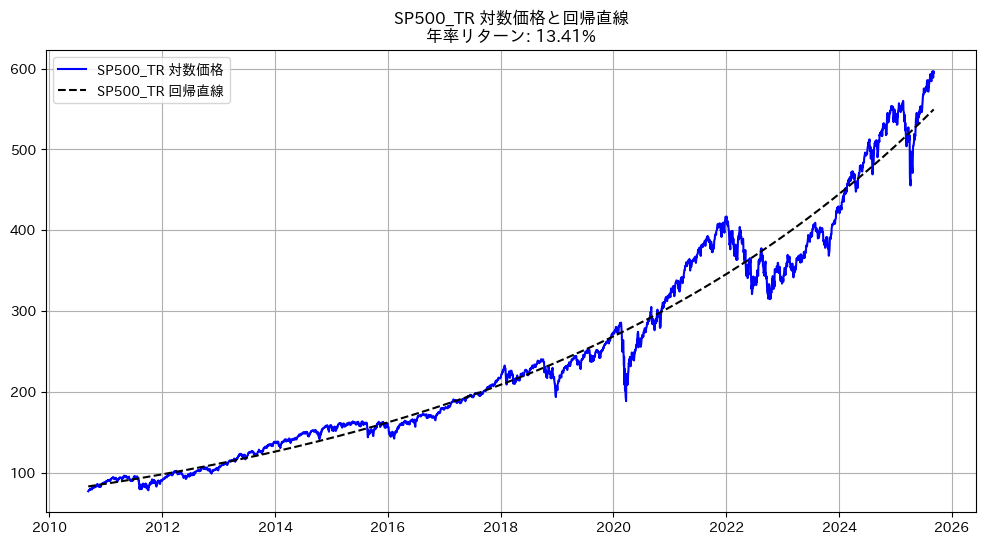

NIKKEI


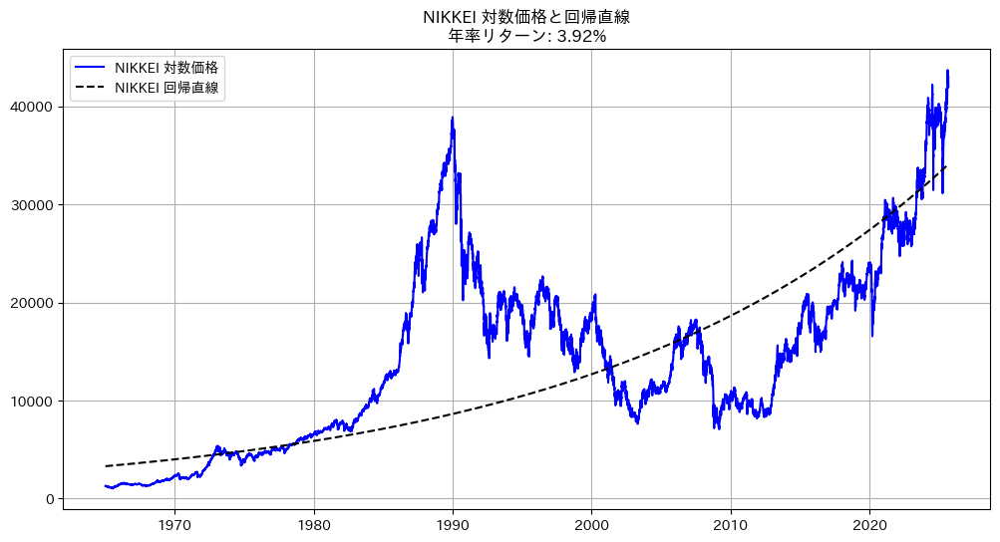

NASDAQ100_QQQM


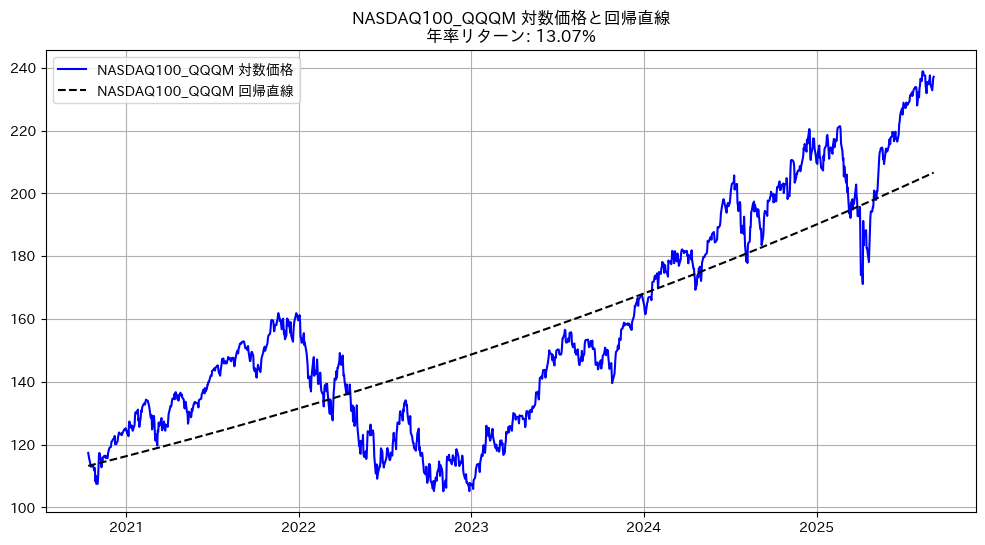

NASDAQ100_QQQ


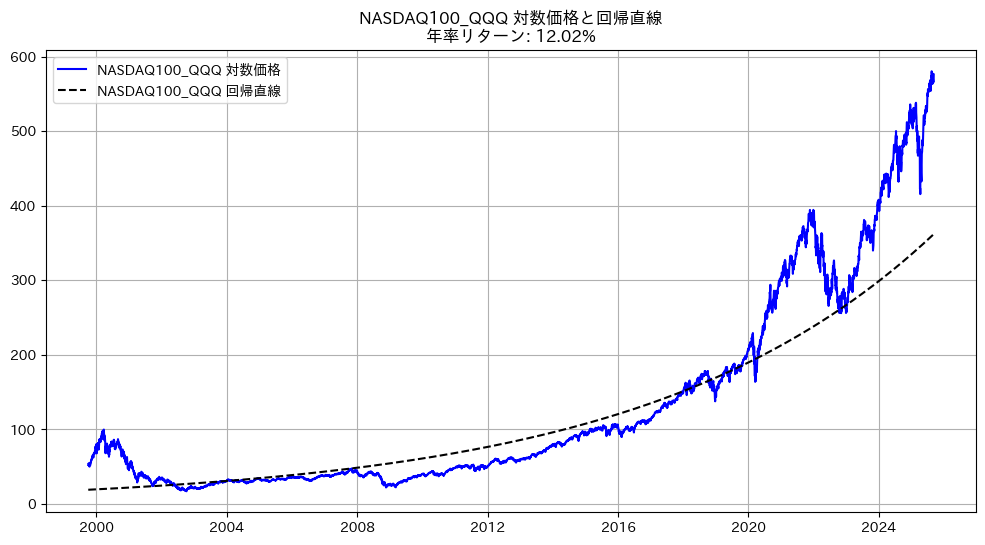

NIKKEI_TR


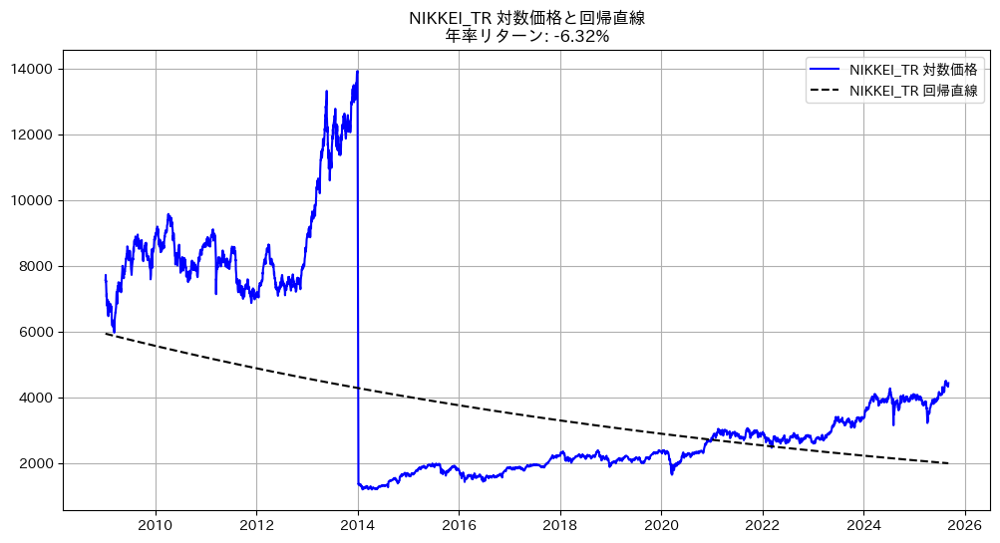

BOND


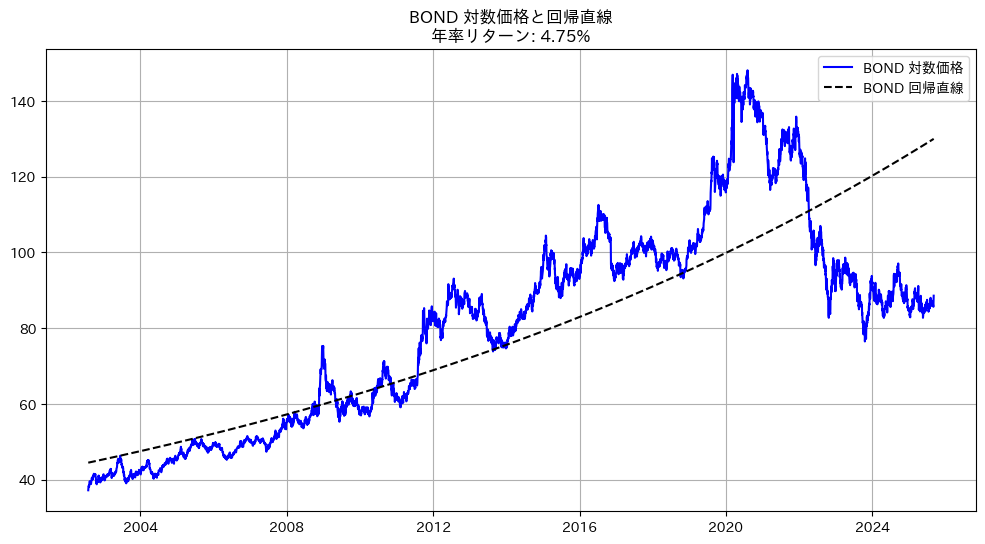

ALL_WORLD


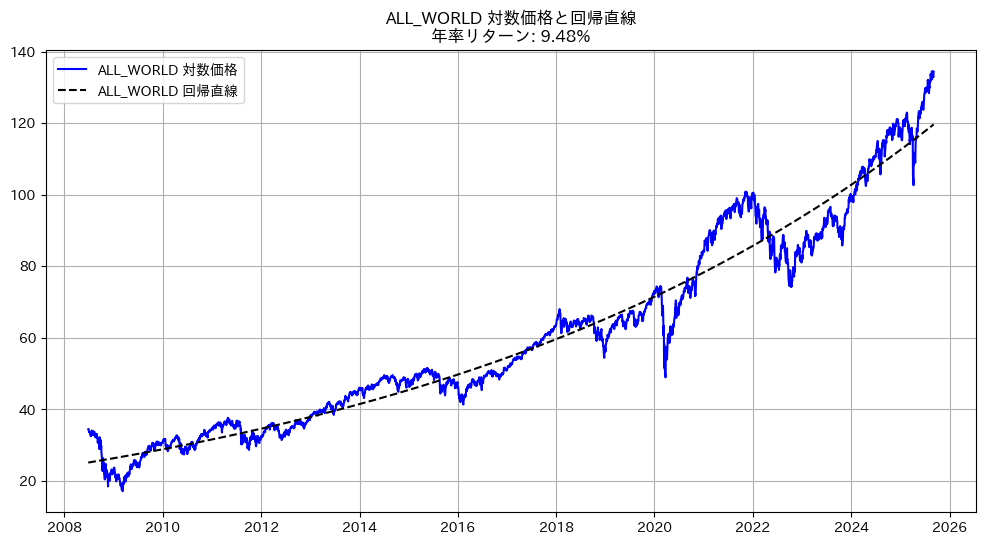

INDIA


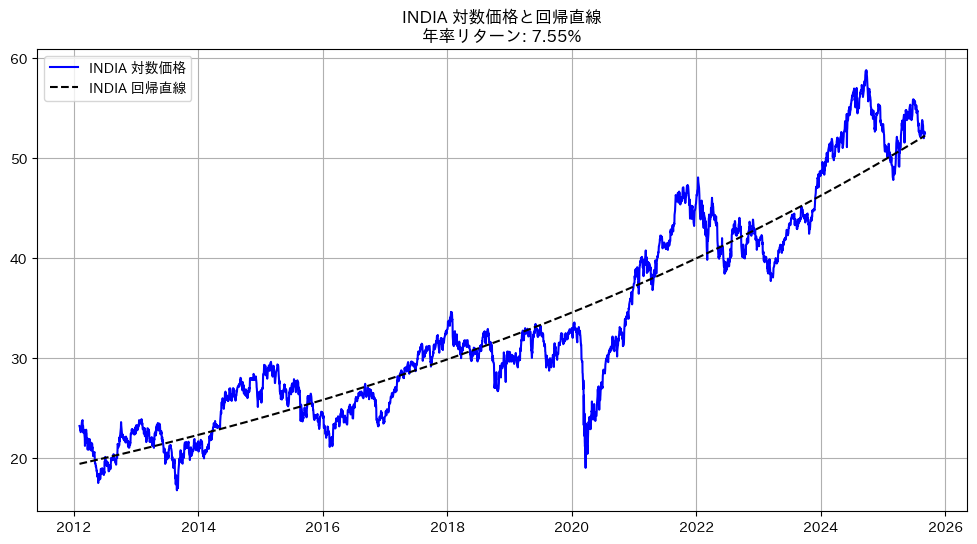

CHINA


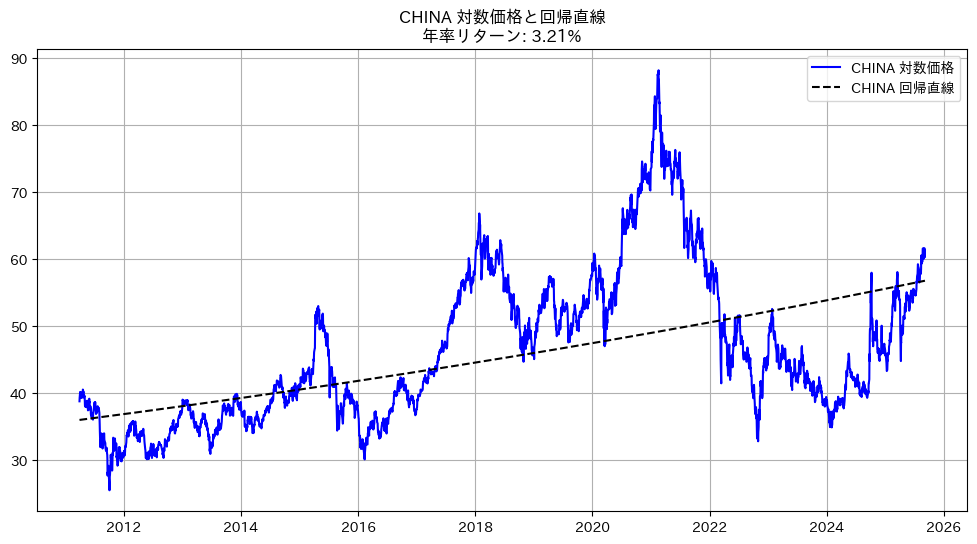

BTC


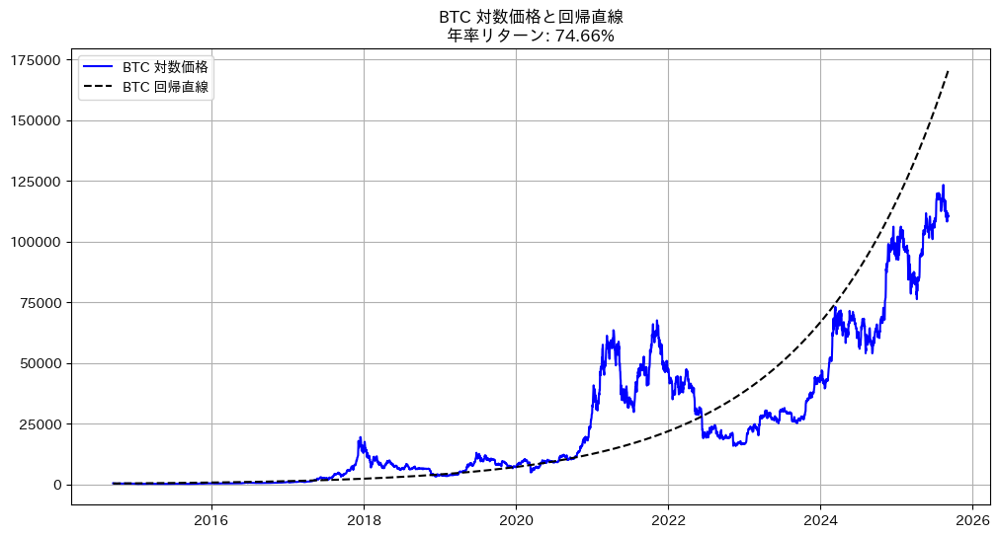

ETH


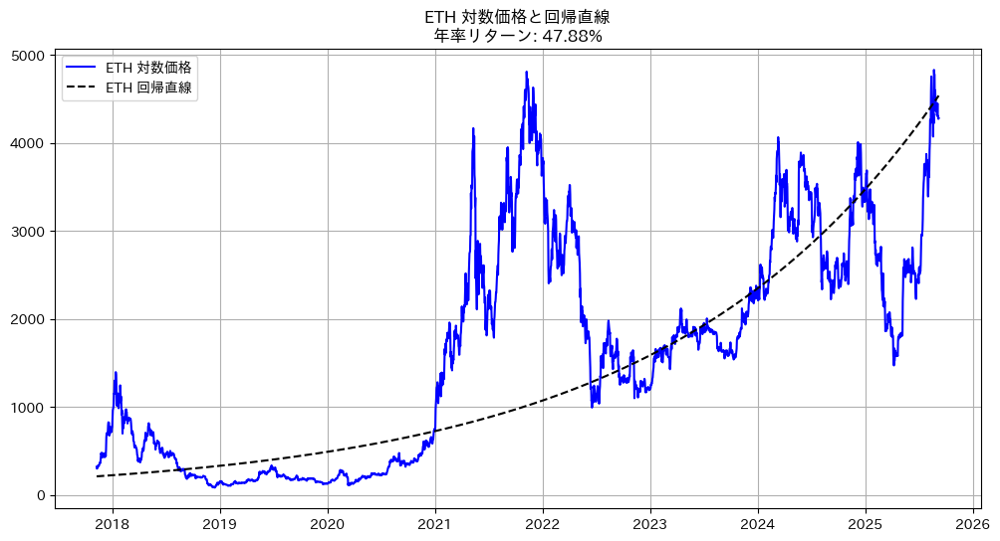

XRP


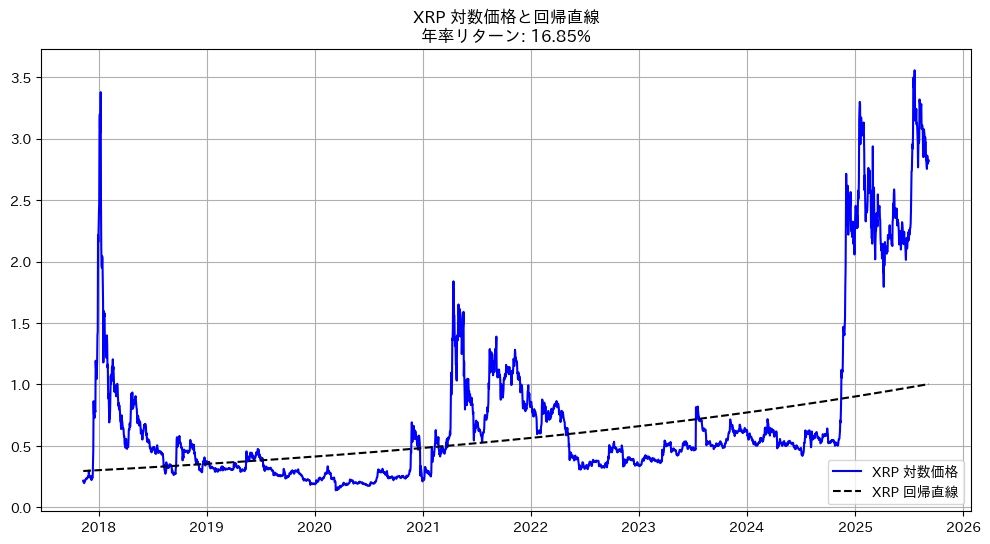

SOL


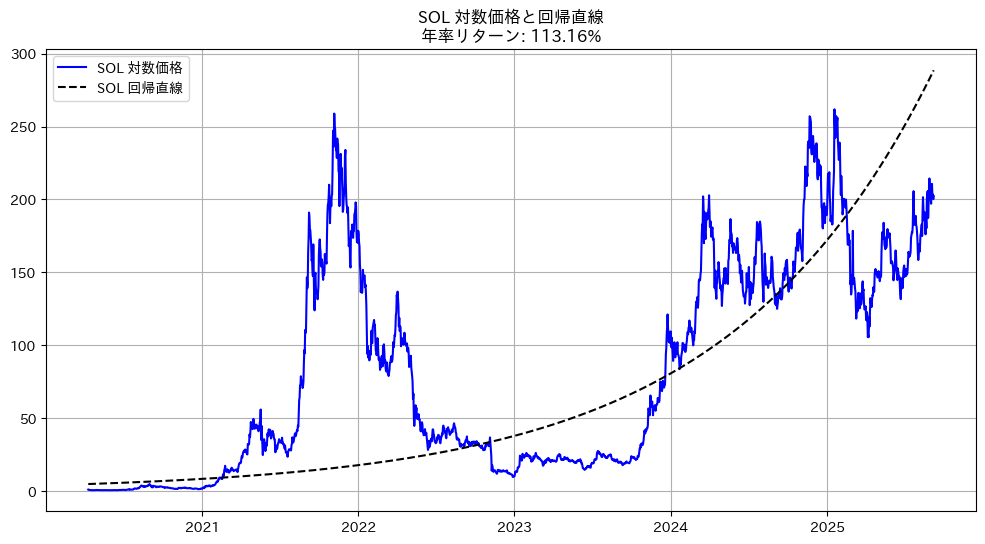

ADA


KeyboardInterrupt: 

In [46]:
for name, data in data_dict.items():
    print(name)
    log_close = np.log10(data['Close']).dropna()

    dates = log_close.index
    x = (dates - dates[0]).days.values  # 日数

    y = (10 ** log_close).values.ravel()

    slope, intercept, _, _, _ = linregress(x, log_close.values.ravel())
    # 回帰直線上の期待値
    y_pred = intercept + slope * x

    r_annual = compute_annualized_return(slope, log_close.index, days_per_year=365)

    plt.figure(figsize=(12, 6))
    plt.plot(log_close.index, y, label=f'{name} 対数価格', color='blue')
    plt.plot(log_close.index, 10 ** y_pred, linestyle='--', label=f'{name} 回帰直線', color='black')
    plt.title(f'{name} 対数価格と回帰直線\n年率リターン: {r_annual:.2%}')
    plt.legend()
    plt.grid(True)
    plt.show()

# 対数価格と回帰直線

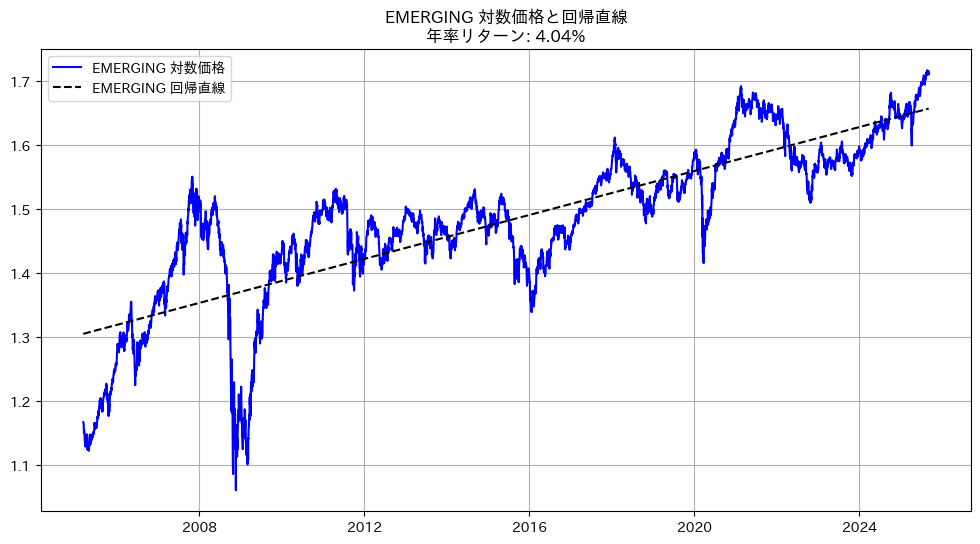

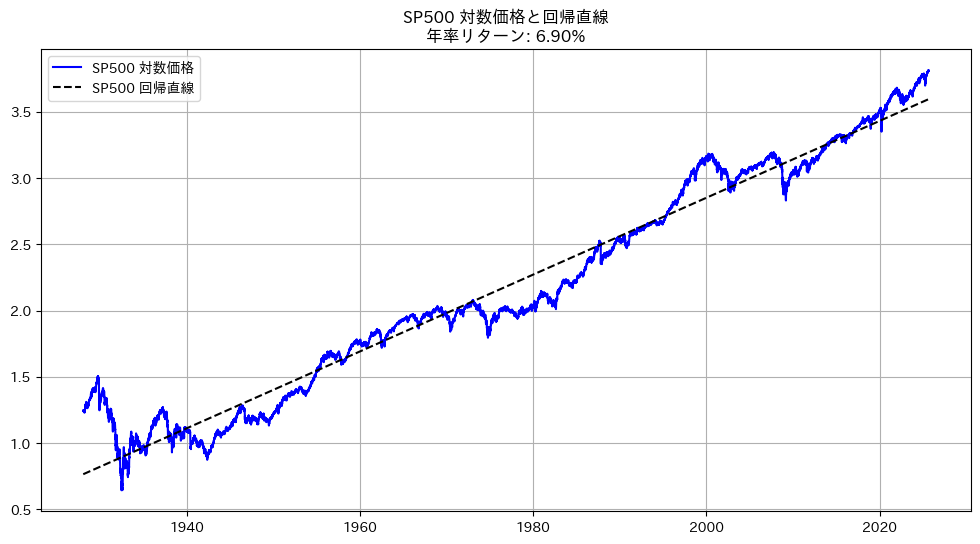

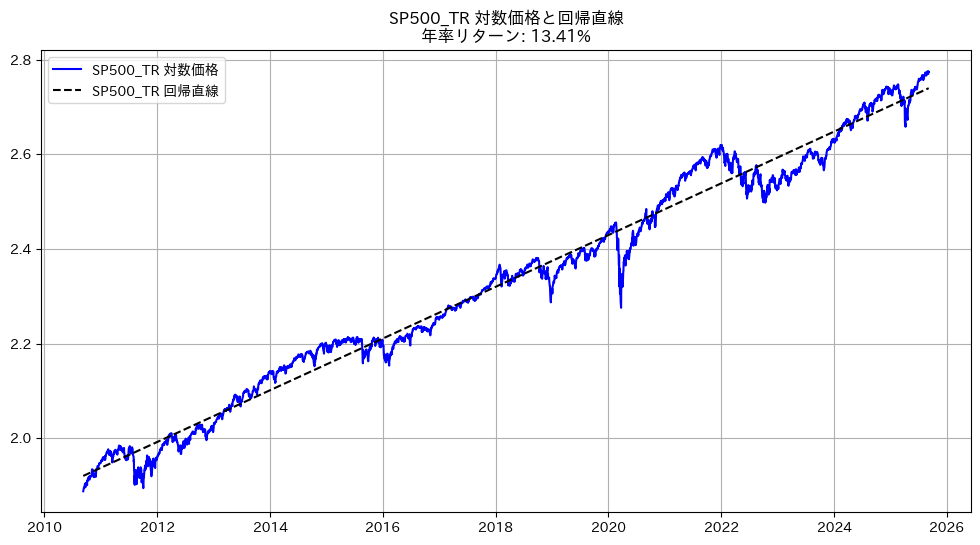

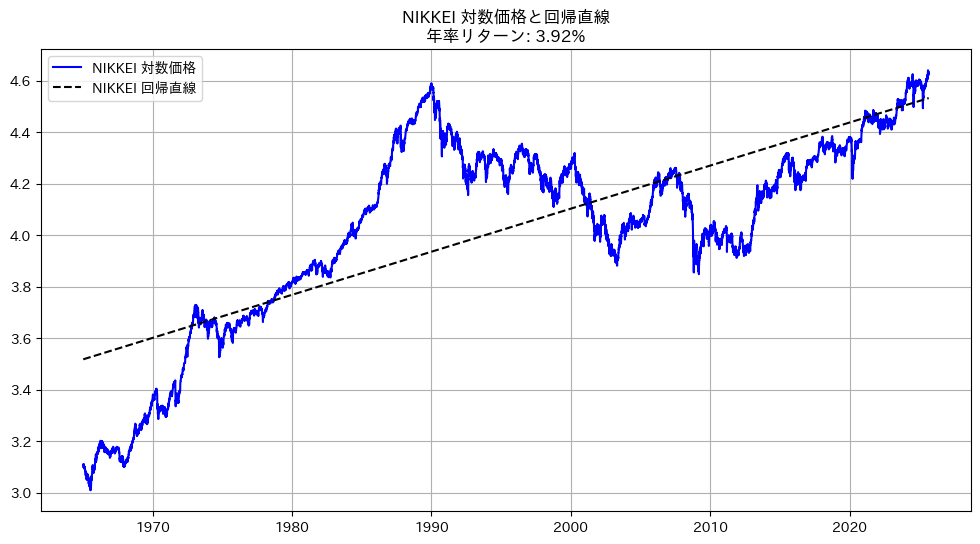

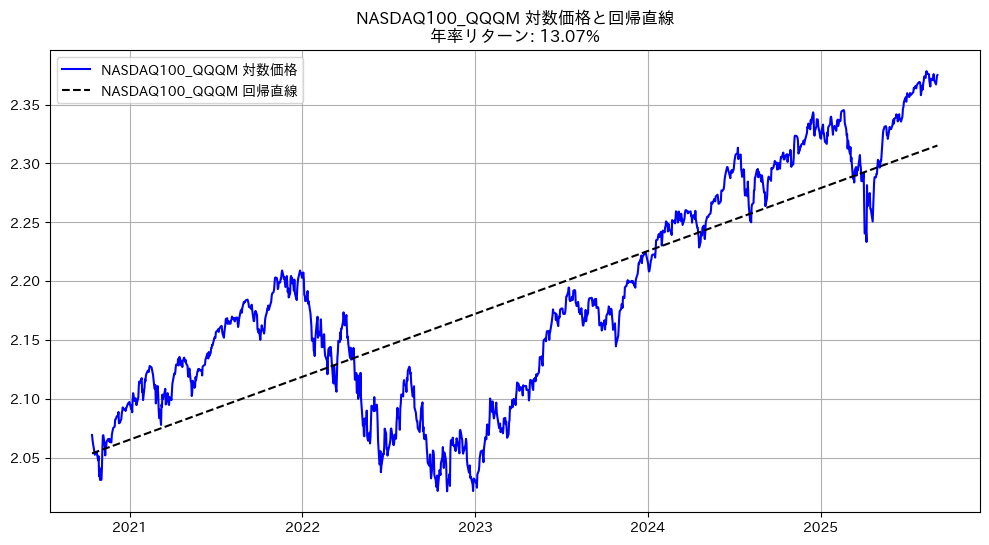

...

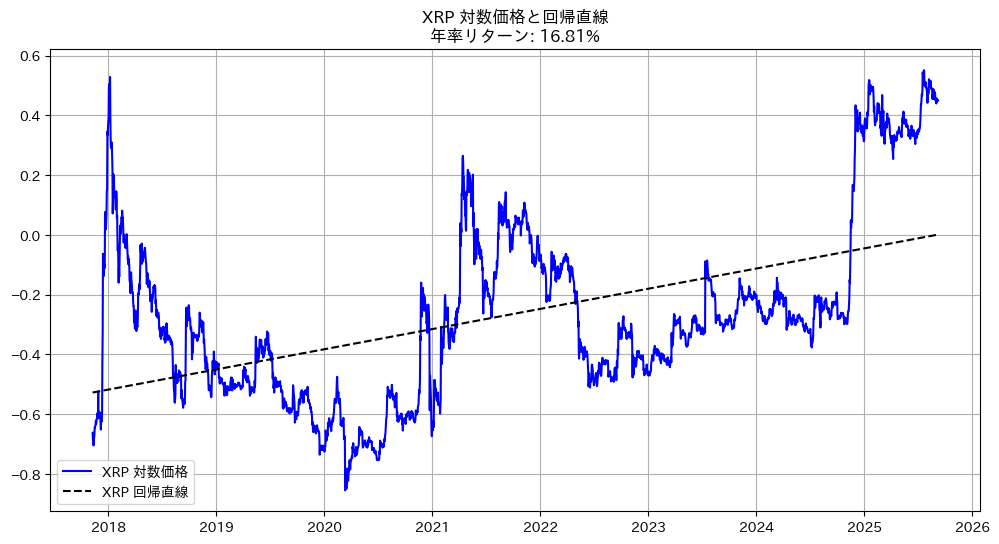

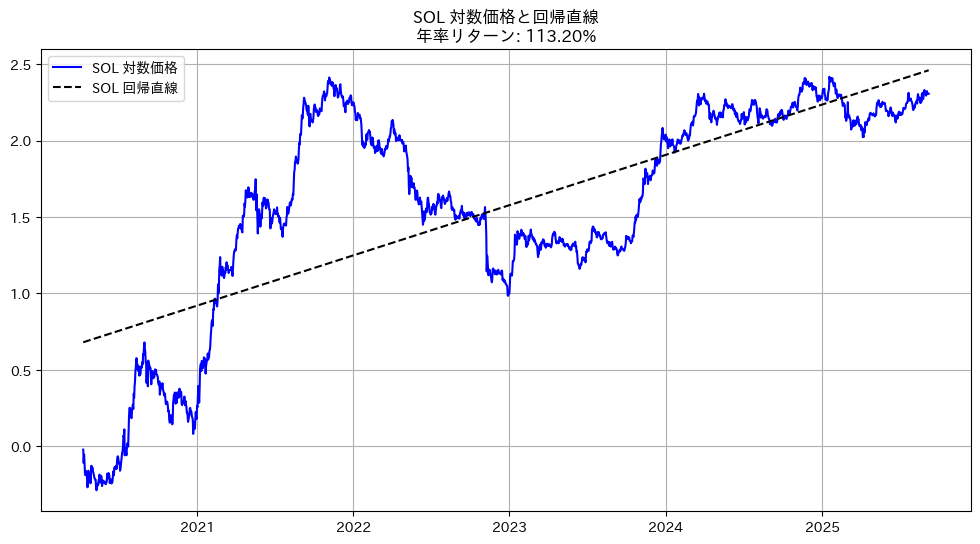

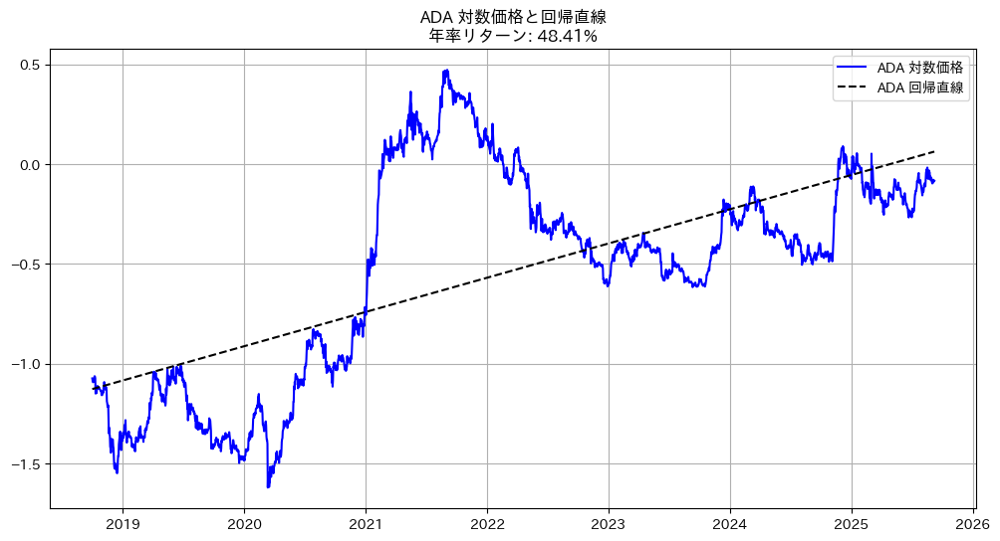

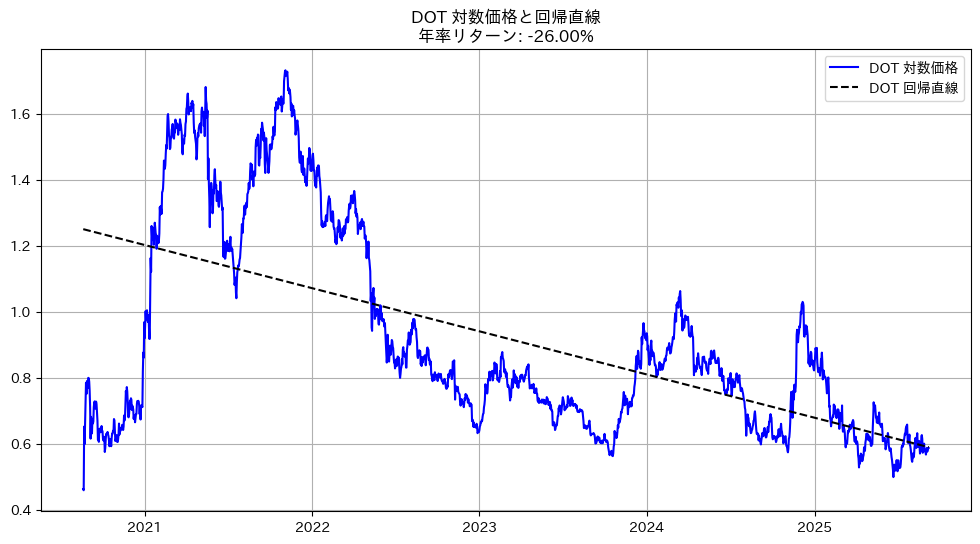

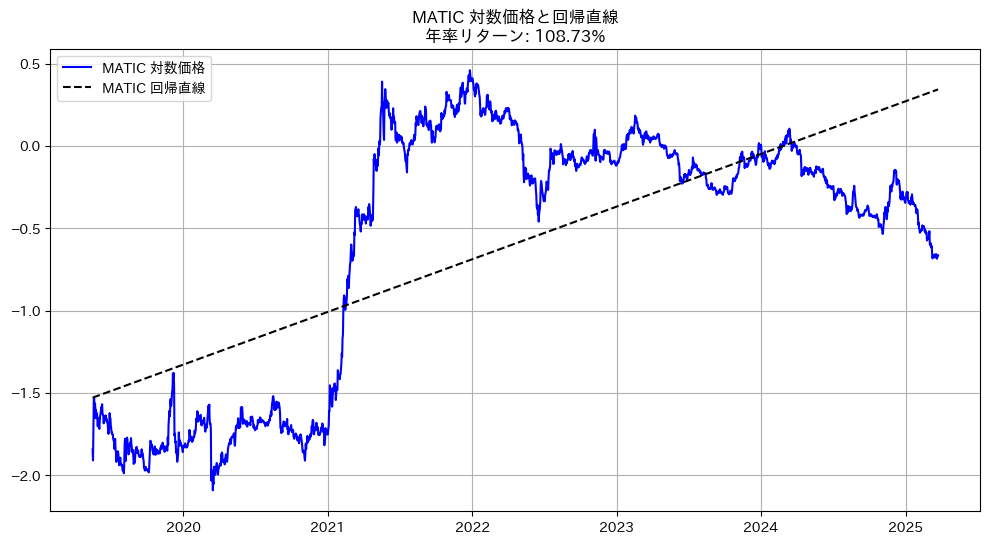

c:\Users\t-miura\Documents\05.portfolio\financial_analytics\.venv\Lib\site-packages\pandas\core\internals\blocks.py:395: RuntimeWarning: invalid value encountered in log10
  result = func(self.values, **kwargs)


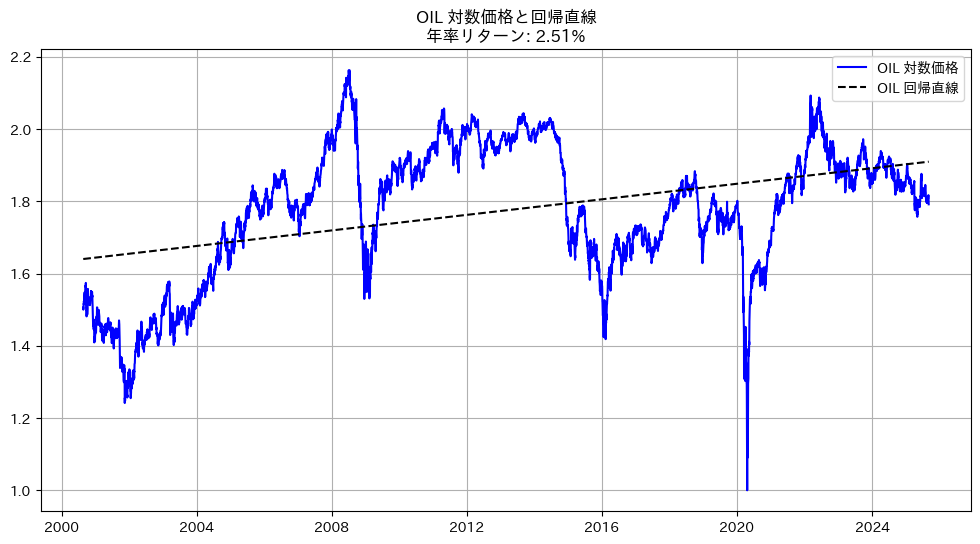

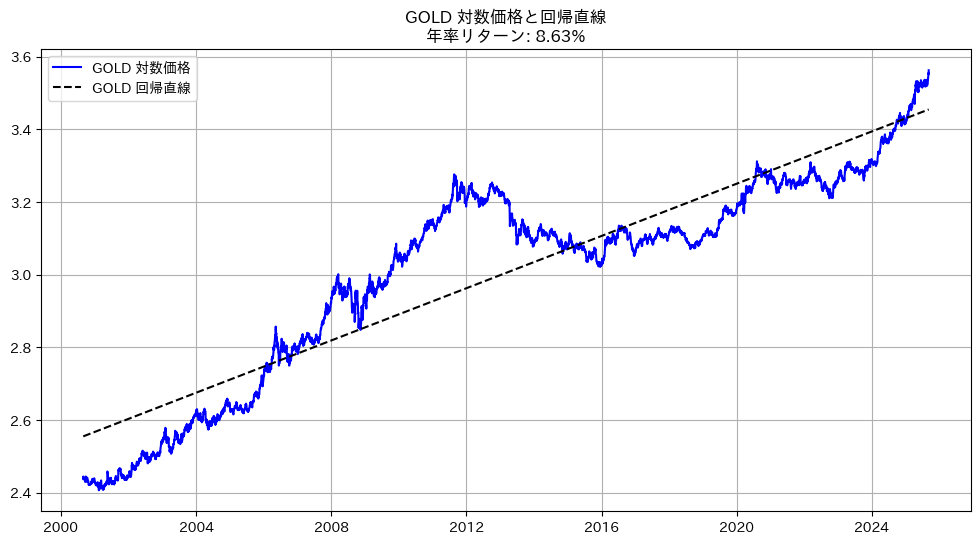

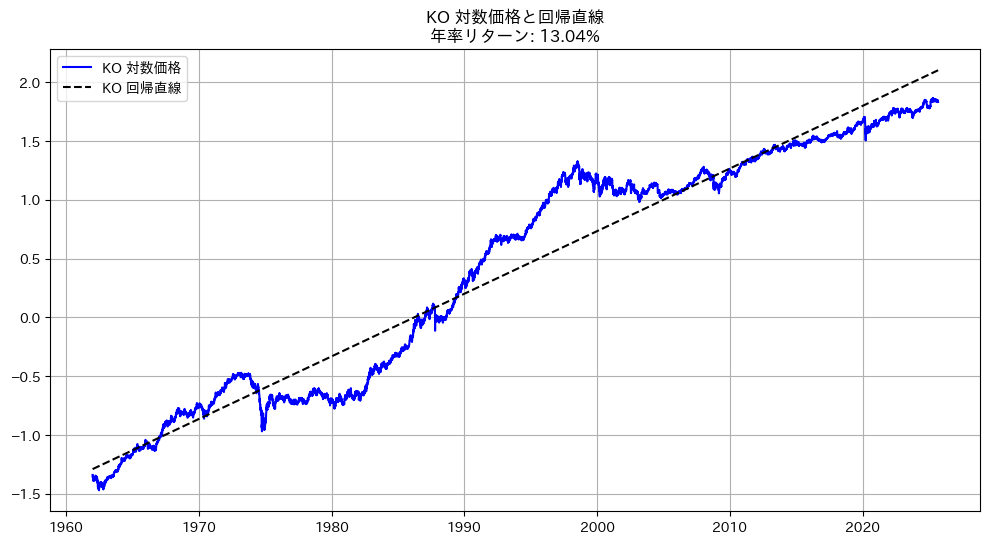

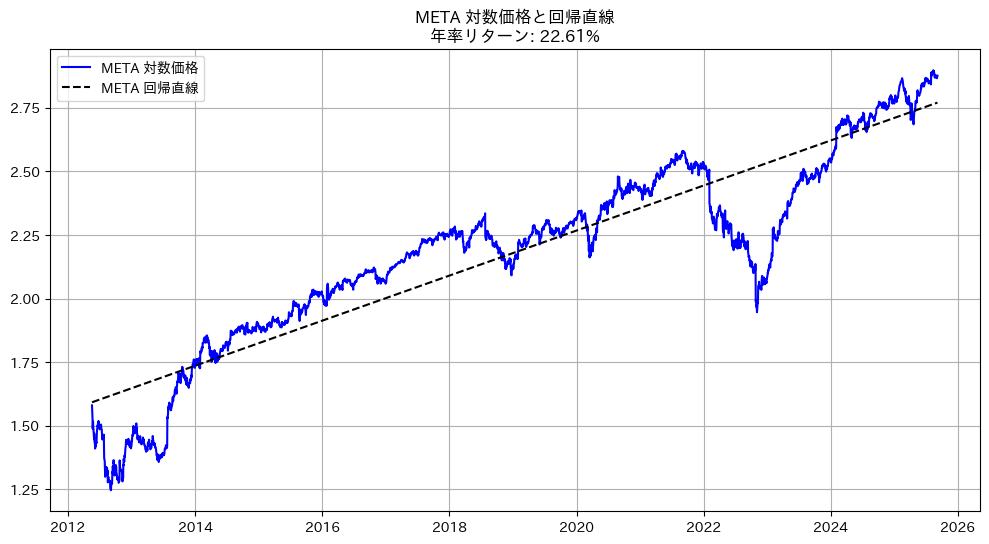

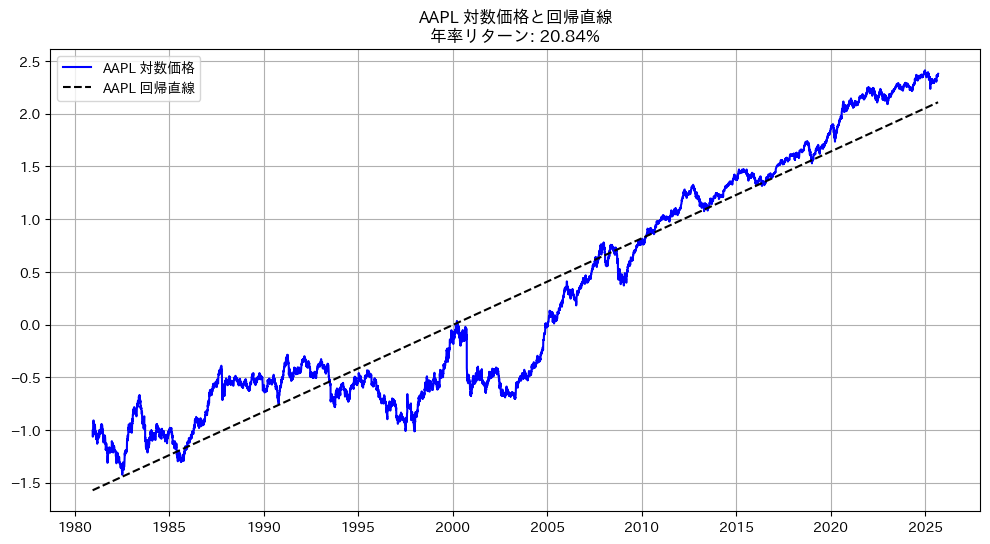

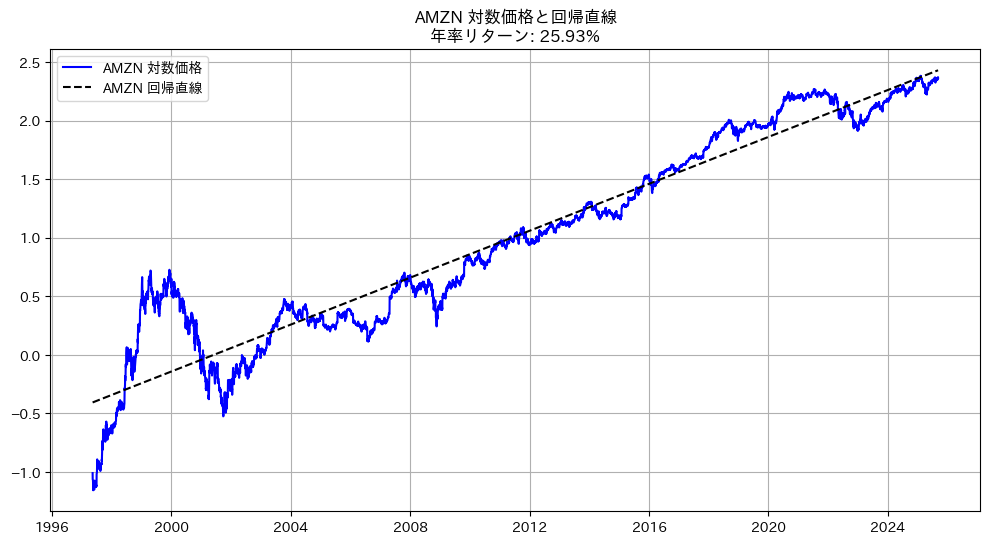

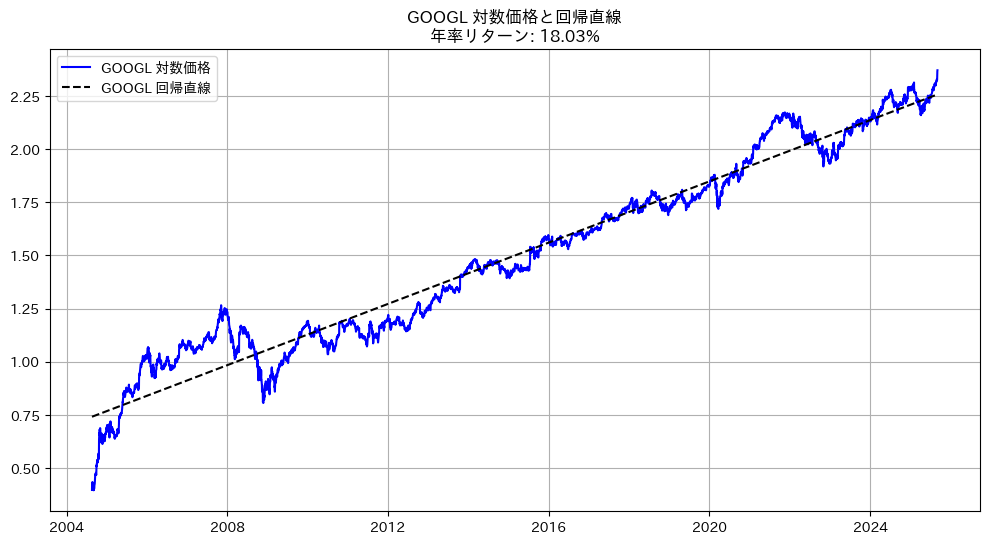

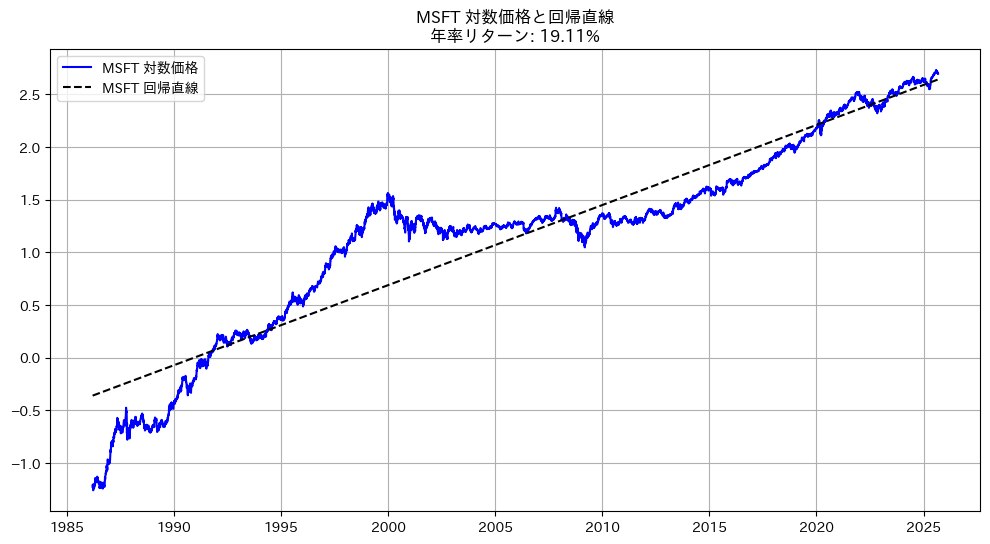

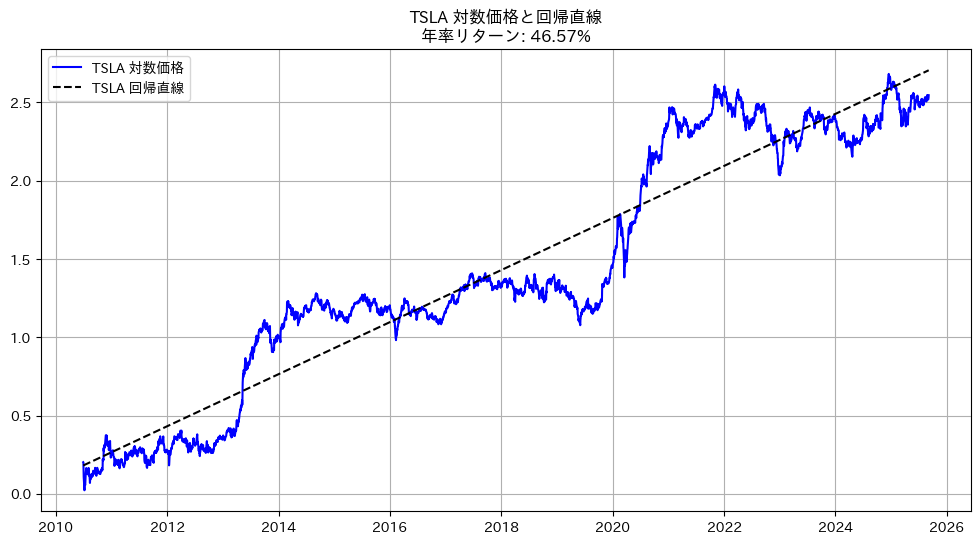

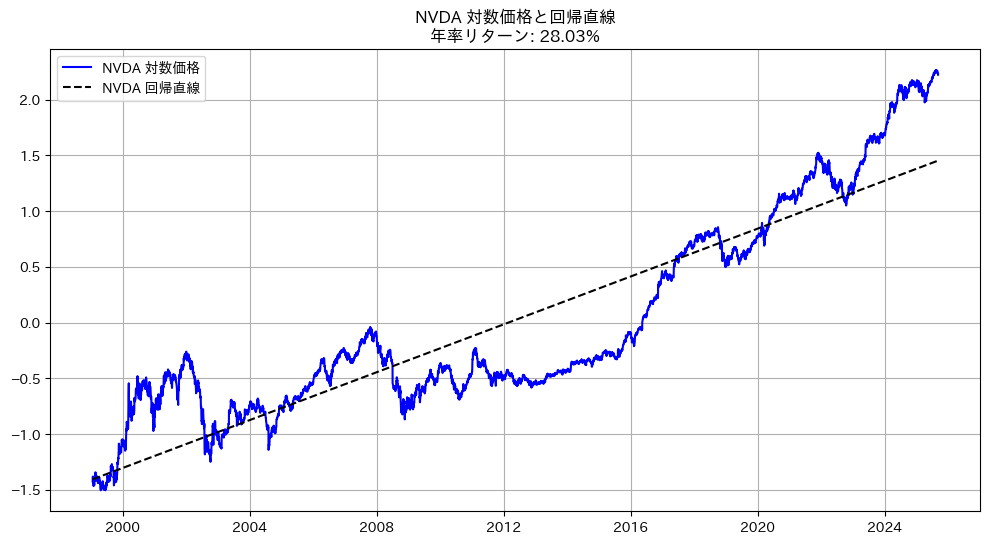

In [ ]:
from matplotlib.ticker import PercentFormatter

# 可視化と回帰直線描画
for name, data in data_dict.items():
    log_close = np.log10(data['Close']).dropna()

    dates = log_close.index
    x = (dates - dates[0]).days.values  # 日数
    # x = np.arange(len(log_close))

    y = log_close.values.ravel()

    slope, intercept, _, _, _ = linregress(x, y)
    # 回帰直線上の期待値
    y_pred = intercept + slope * x

    r_annual = compute_annualized_return(slope, log_close.index, days_per_year=365)

    plt.figure(figsize=(12, 6))
    plt.plot(log_close.index, y, label=f'{name} 対数価格', color='blue')
    plt.plot(log_close.index, y_pred, linestyle='--', label=f'{name} 回帰直線', color='black')
    plt.title(f'{name} 対数価格と回帰直線\n年率リターン: {r_annual:.2%}')
    plt.legend()
    plt.grid(True)
    plt.show()



## 期間を4等分して、期間全体と併せて5本の回帰直線を引いてみる

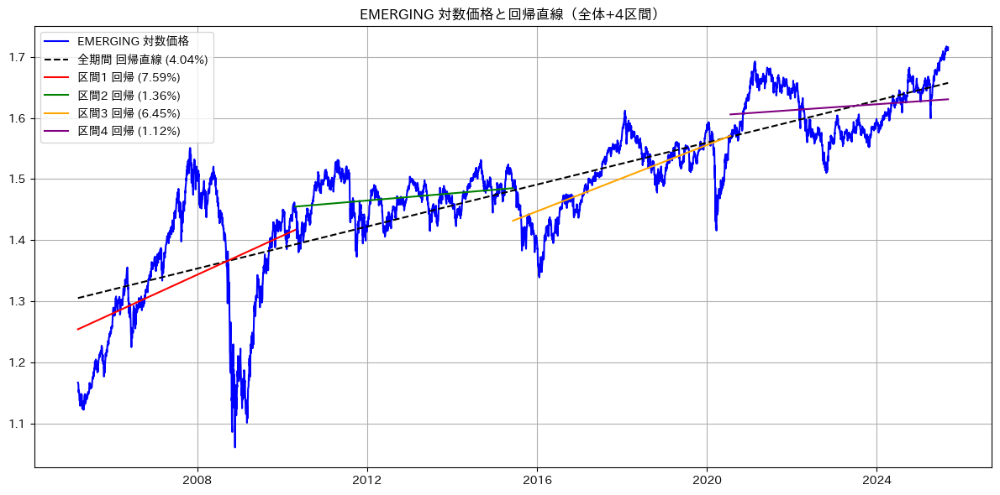

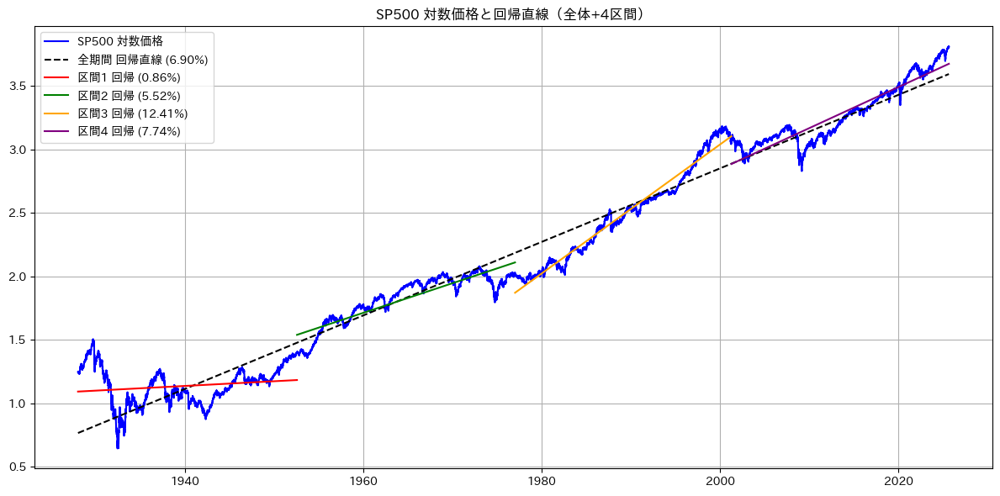

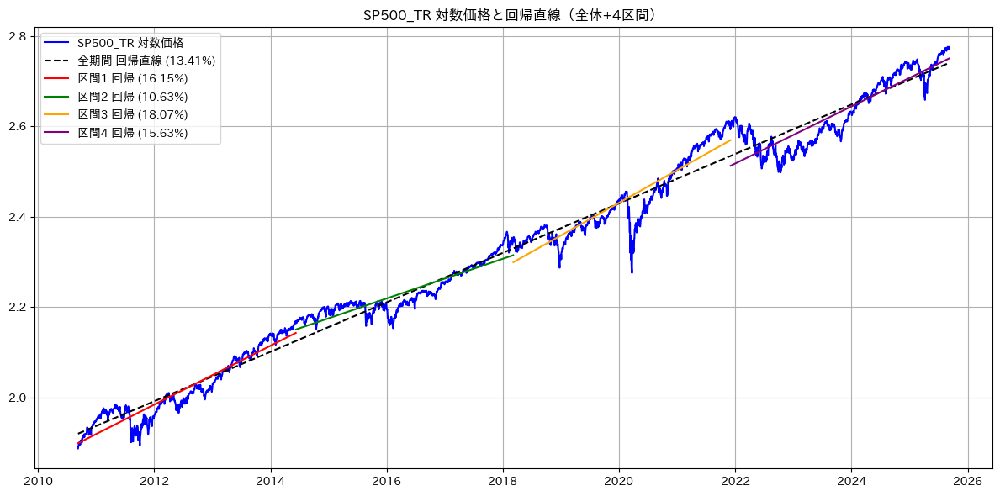

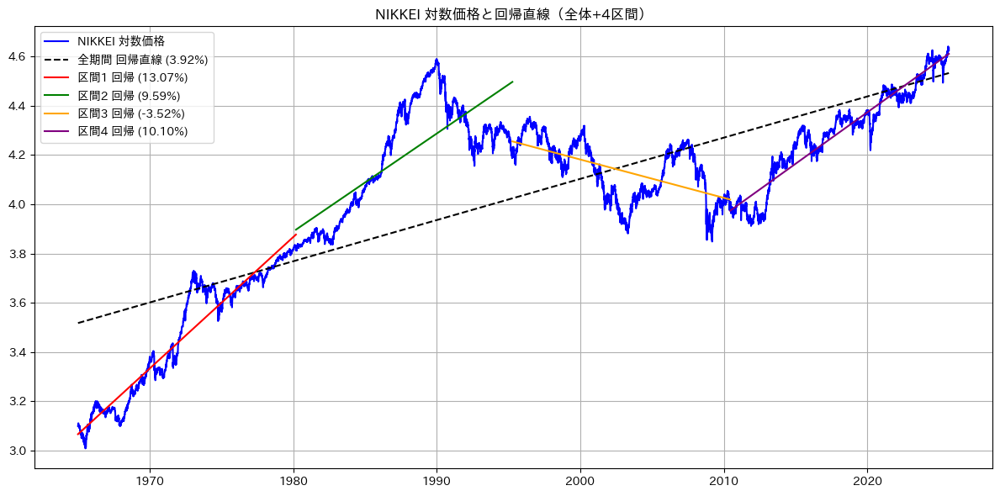

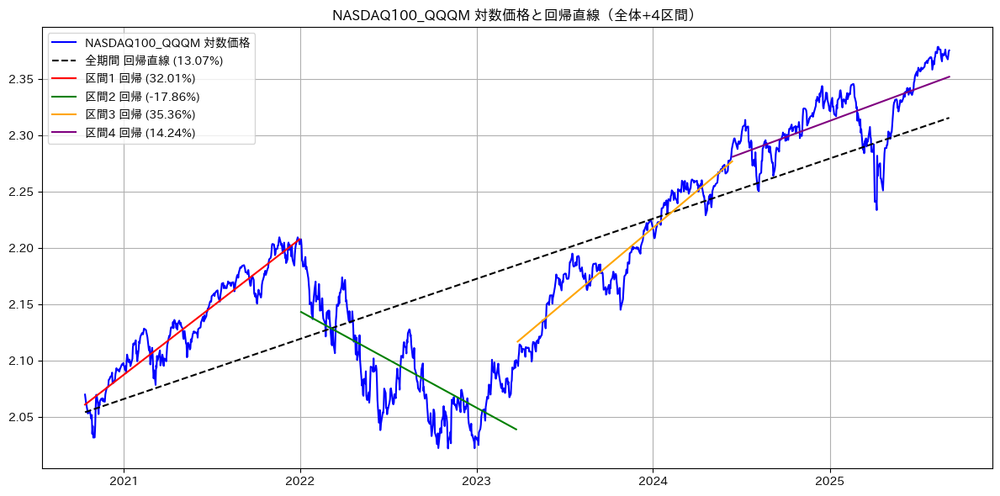

...

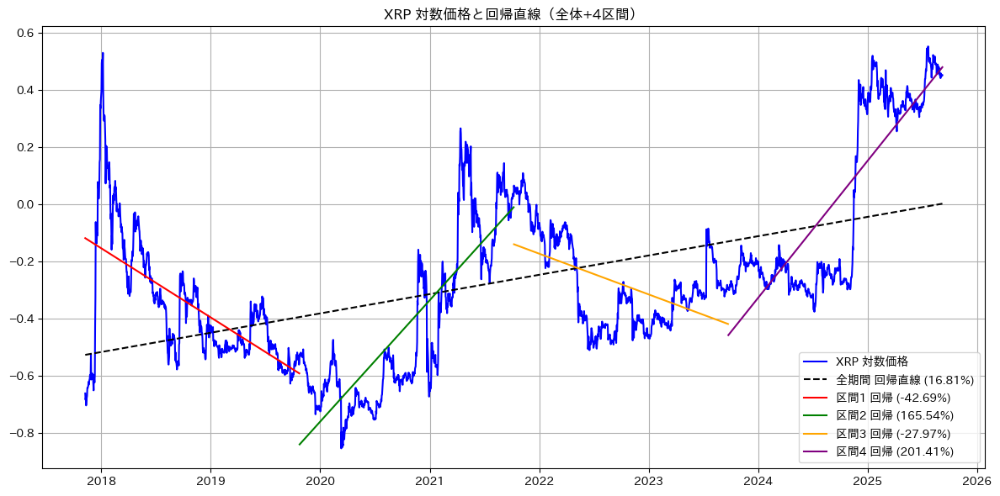

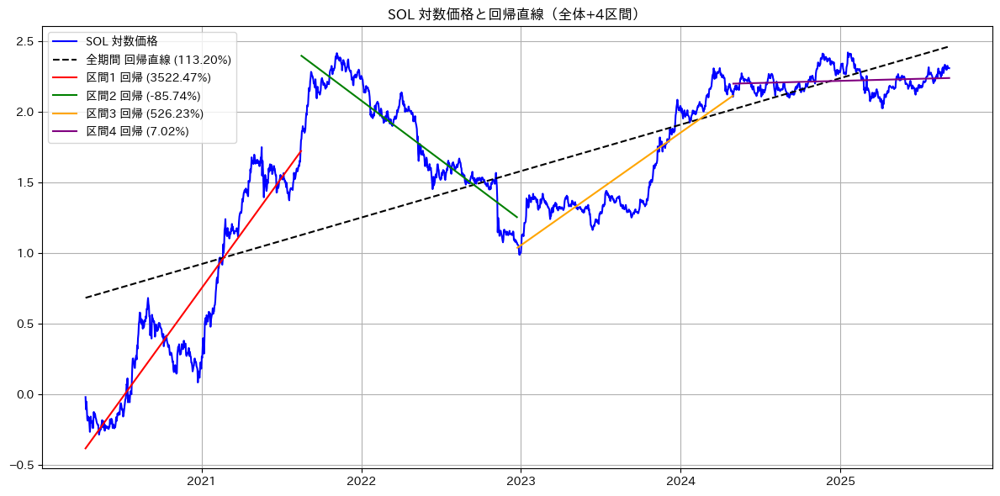

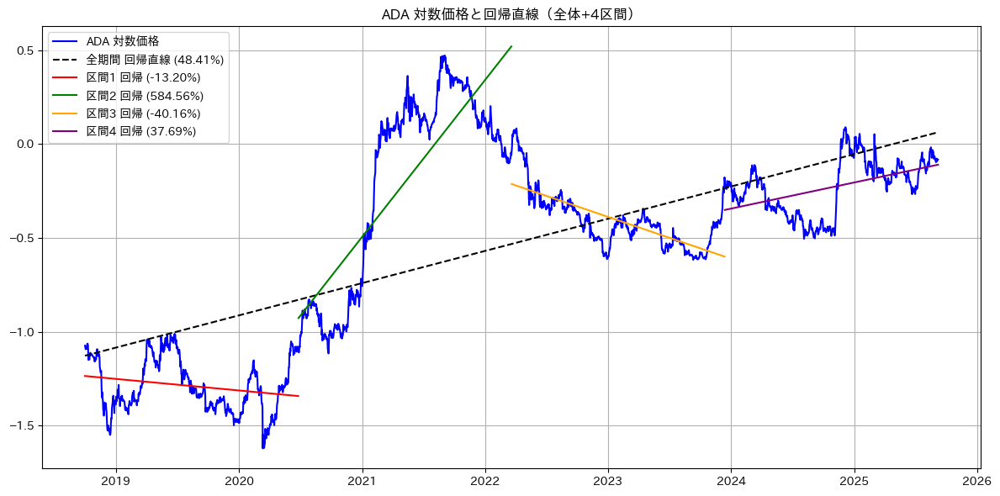

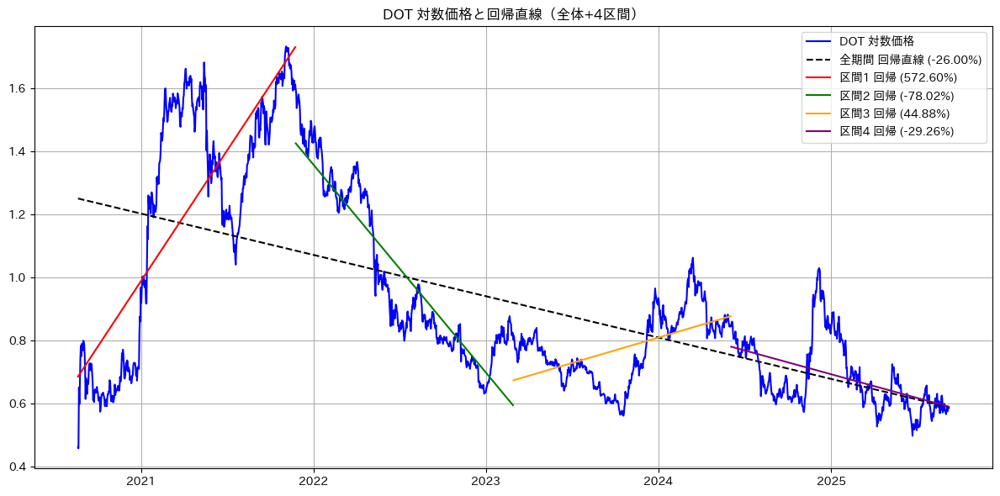

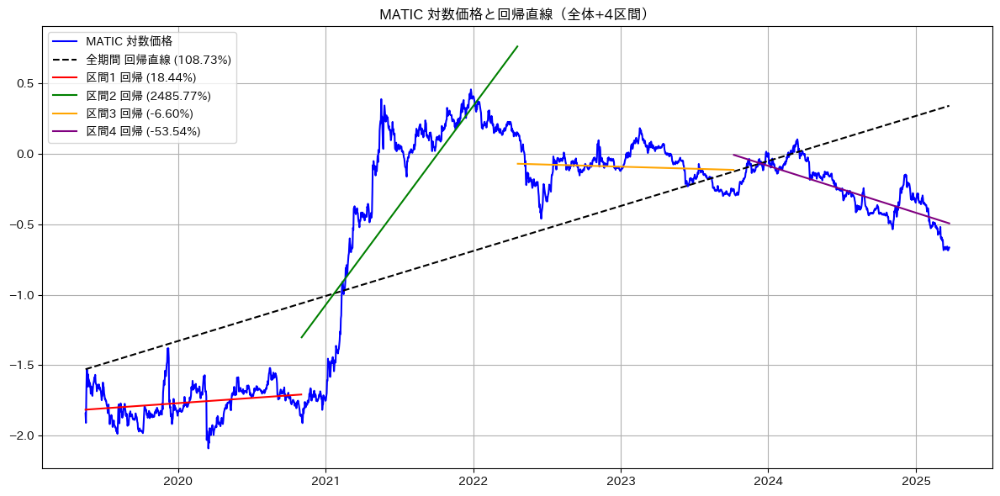

c:\Users\t-miura\Documents\05.portfolio\financial_analytics\.venv\Lib\site-packages\pandas\core\internals\blocks.py:395: RuntimeWarning: invalid value encountered in log10
  result = func(self.values, **kwargs)


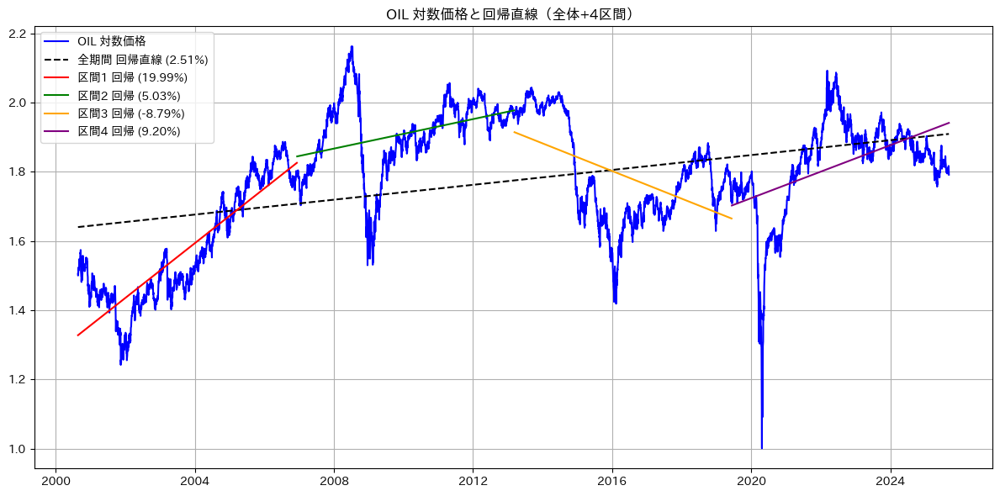

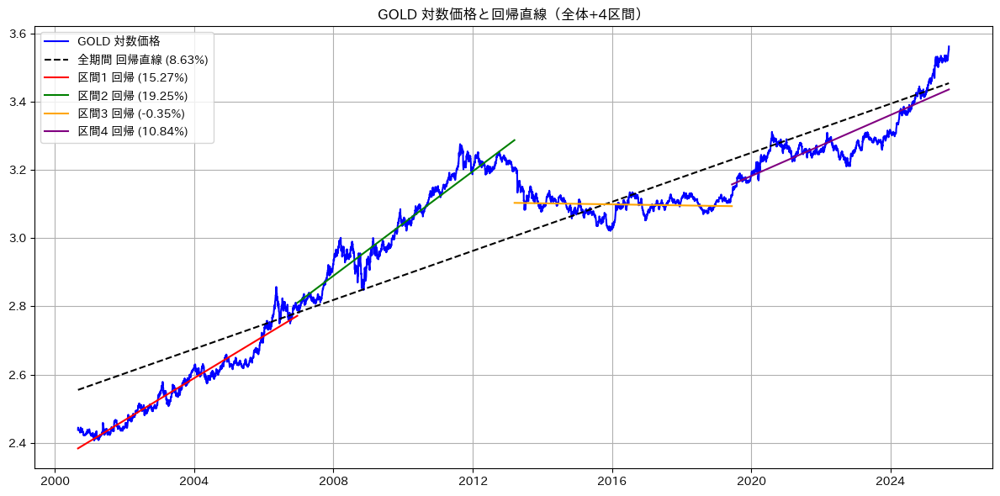

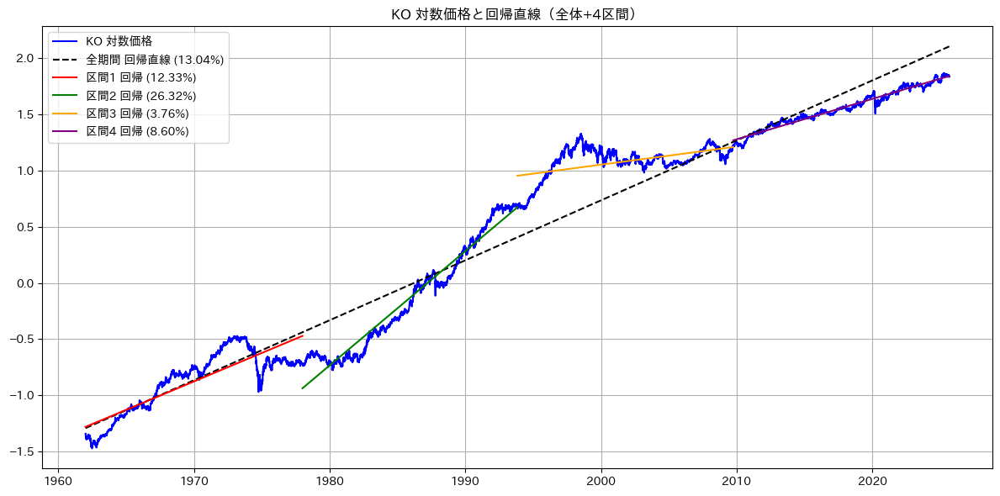

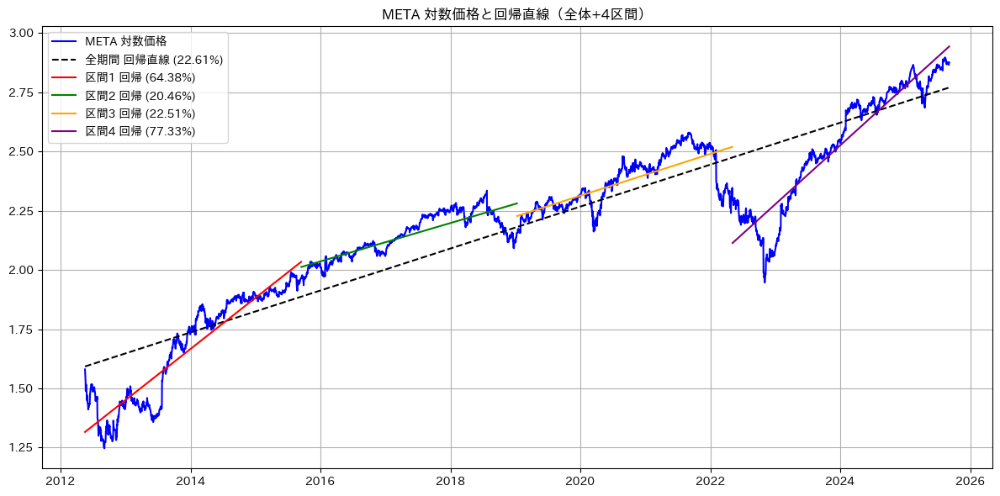

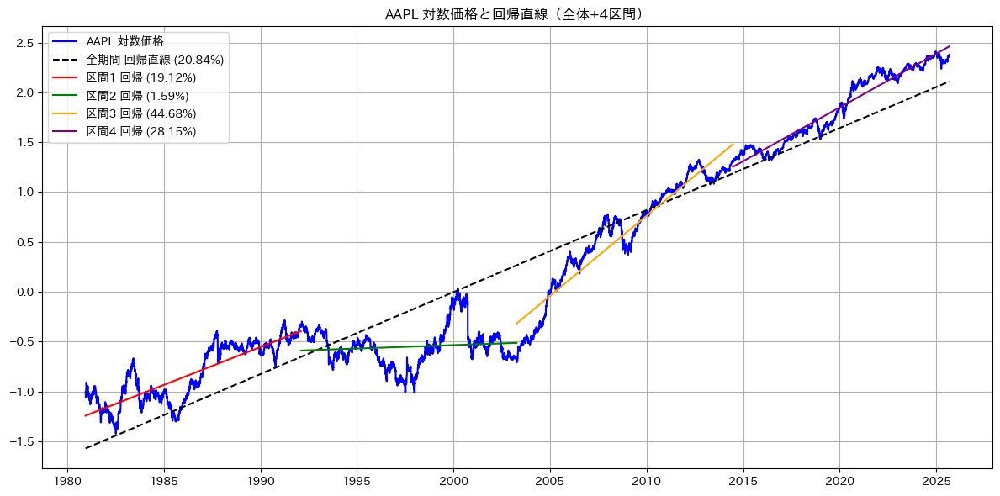

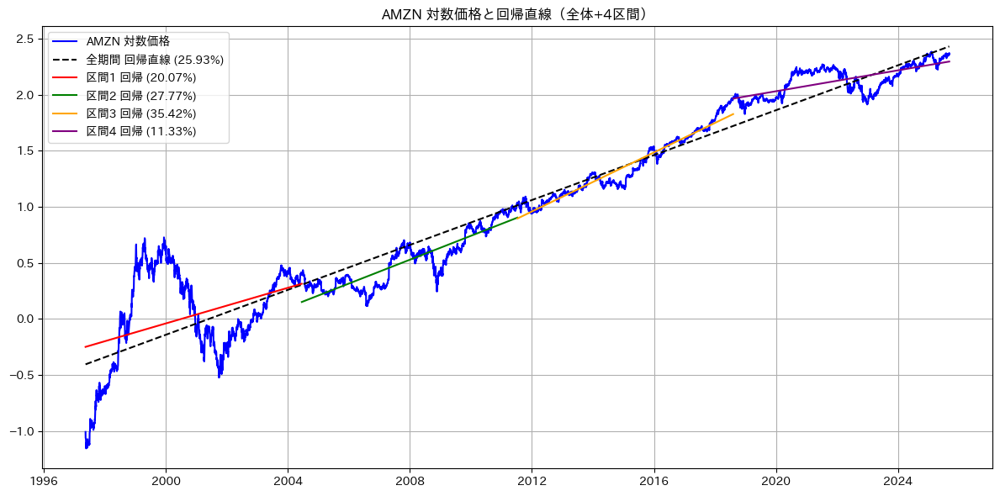

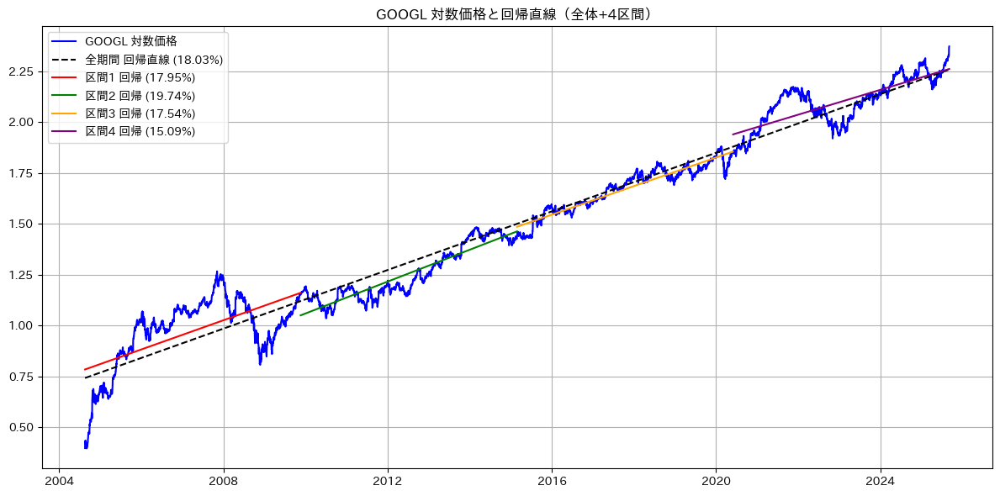

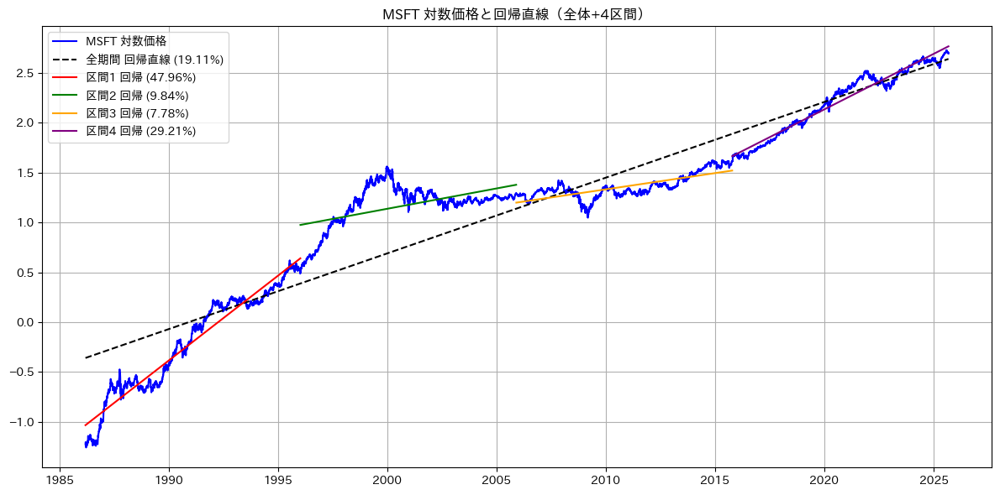

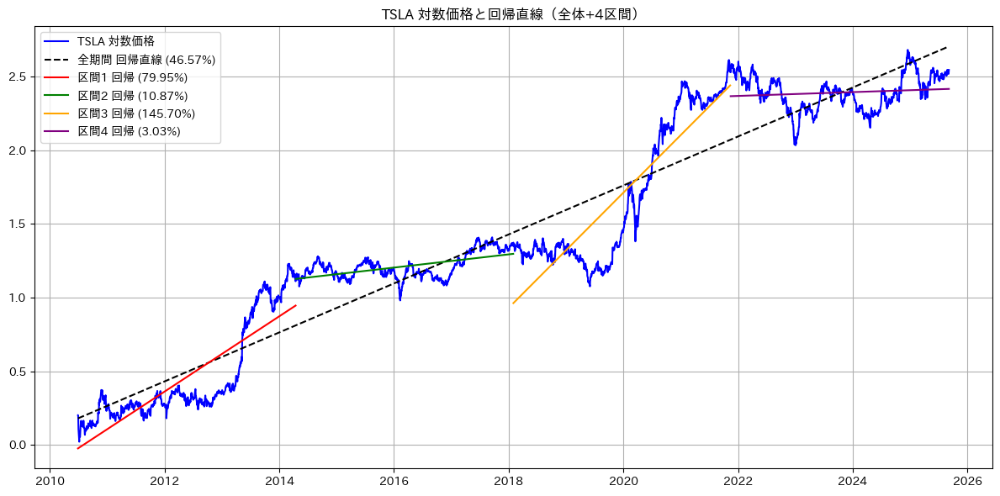

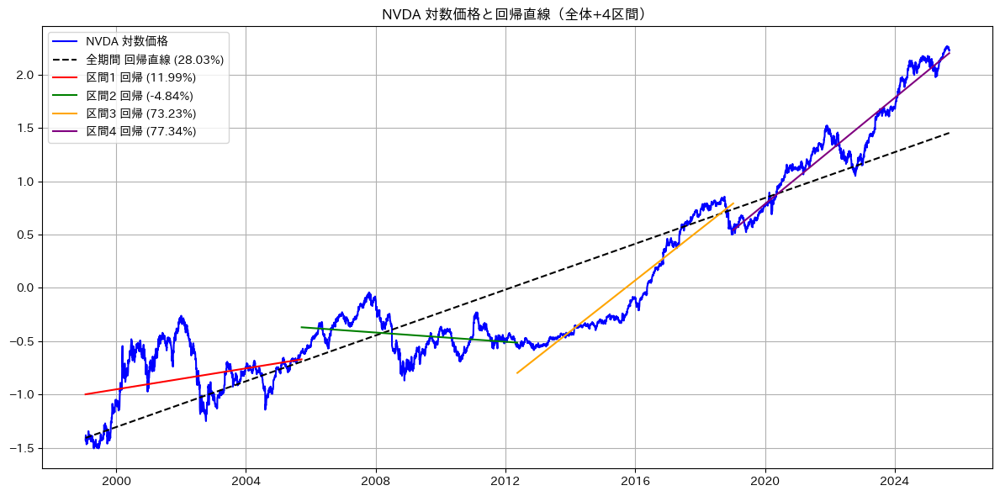

In [ ]:
# 可視化と回帰直線描画
for name, data in data_dict.items():
    log_close = np.log10(data['Close']).dropna()

    dates = log_close.index
    x = (dates - dates[0]).days.values

    y = log_close.values.ravel()

    # 全体の回帰直線
    slope, intercept, _, _, _ = linregress(x, y)
    y_pred = intercept + slope * x
    r_annual = 10 ** (slope * 365) - 1

    # 区間ごとの回帰直線
    n = len(x)
    segments = 4
    split_indices = np.array_split(np.arange(n), segments)
    segment_lines = []

    for indices in split_indices:
        x_seg = x[indices]
        y_seg = y[indices]
        slope_seg, intercept_seg, *_ = linregress(x_seg, y_seg)
        y_pred_seg = intercept_seg + slope_seg * x_seg
        r_seg = 10 ** (slope_seg * 365) - 1
        segment_lines.append((indices, y_pred_seg, r_seg))

    # プロット
    plt.figure(figsize=(12, 6))
    plt.plot(dates, y, label=f'{name} 対数価格', color='blue')
    plt.plot(dates, y_pred, linestyle='--', label=f'全期間 回帰直線 ({r_annual:.2%})', color='black')

    # 各区間の回帰直線を追加
    colors = ['red', 'green', 'orange', 'purple']
    for i, (indices, y_seg, r_seg) in enumerate(segment_lines):
        plt.plot(dates[indices], y_seg, linestyle='-', color=colors[i], label=f'区間{i+1} 回帰 ({r_seg:.2%})')

    plt.title(f'{name} 対数価格と回帰直線（全体+4区間）')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

## 回帰直線の開始点を先頭に固定して、期間を5等分し各期間までの回帰直線を引く

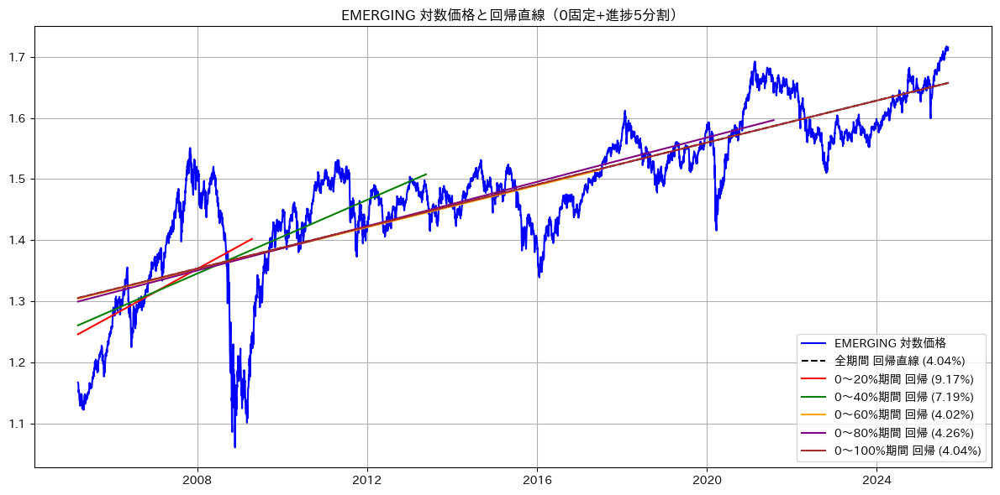

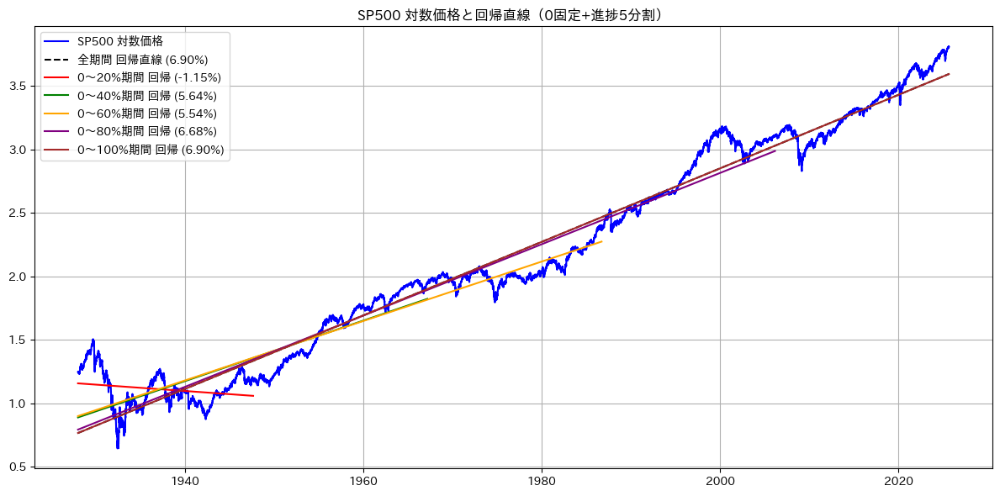

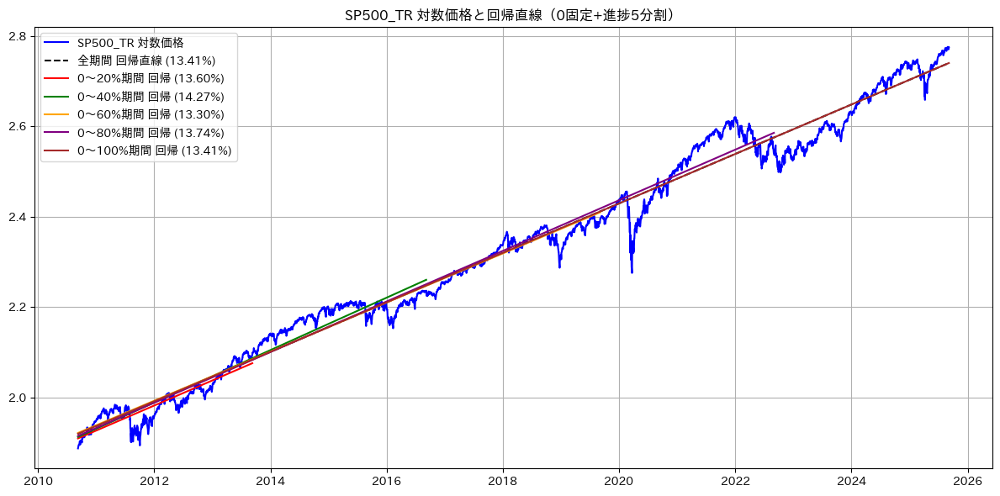

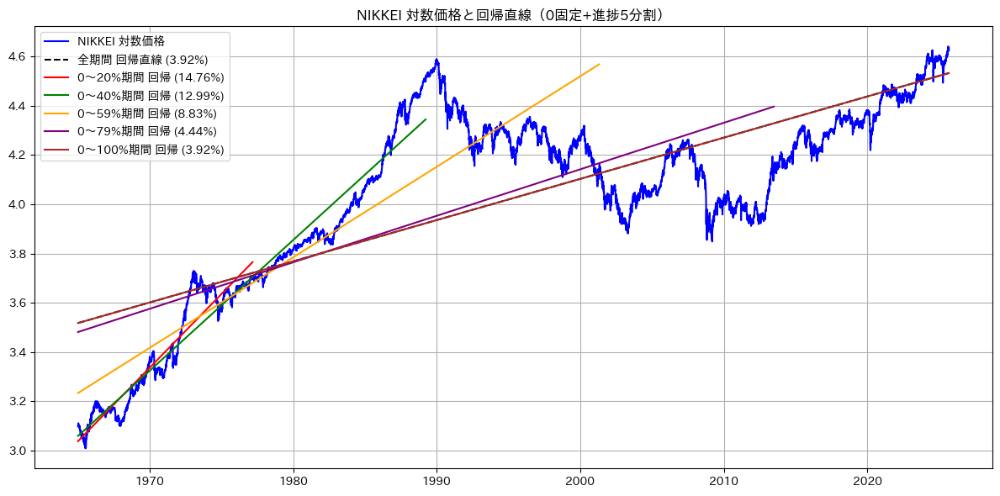

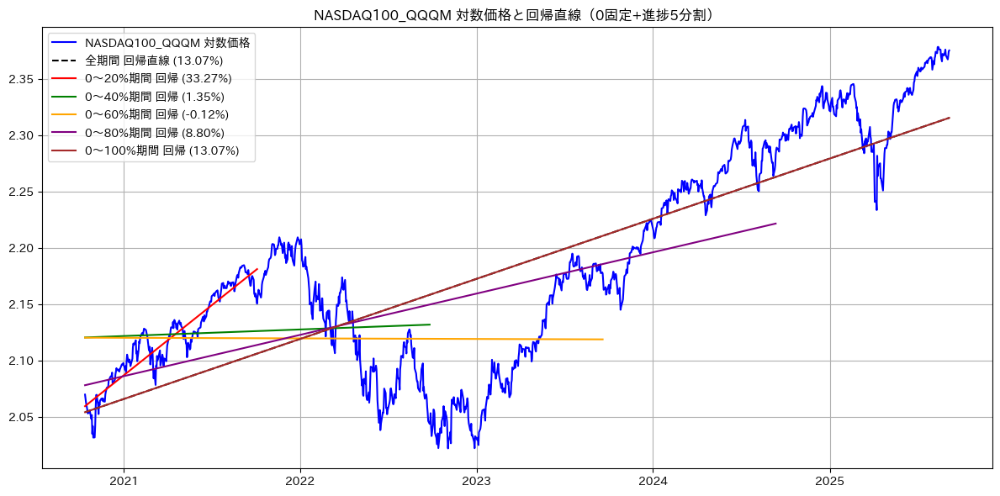

...

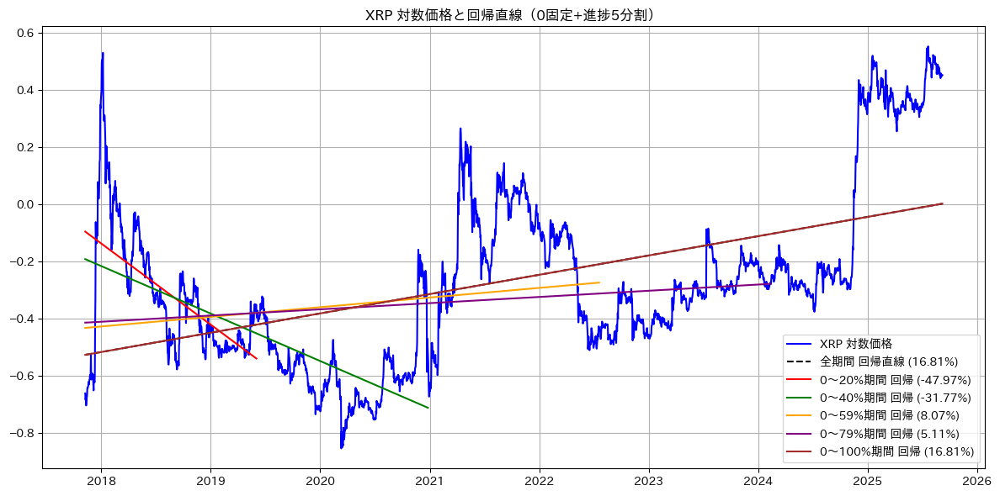

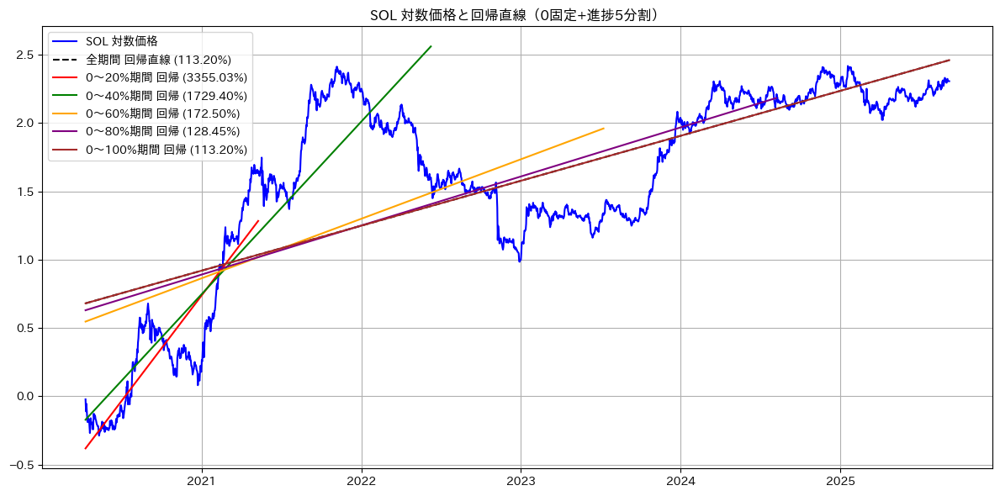

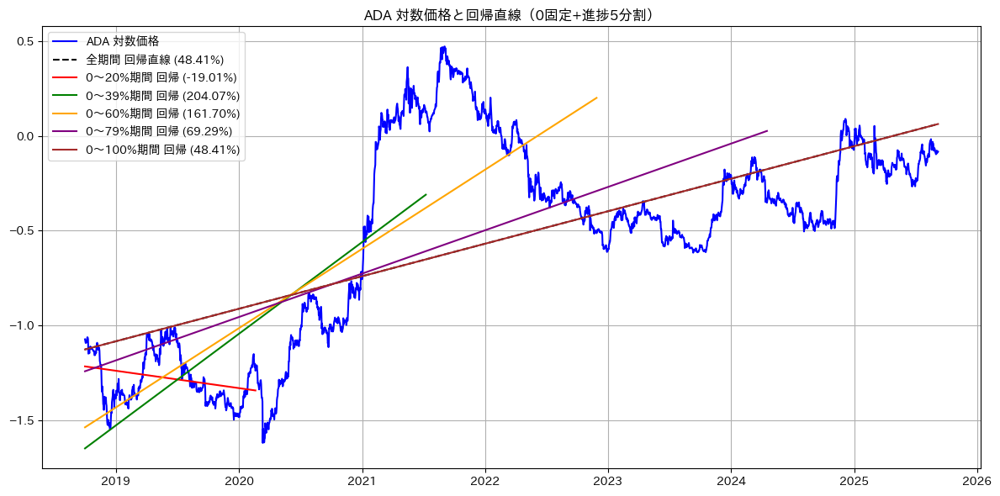

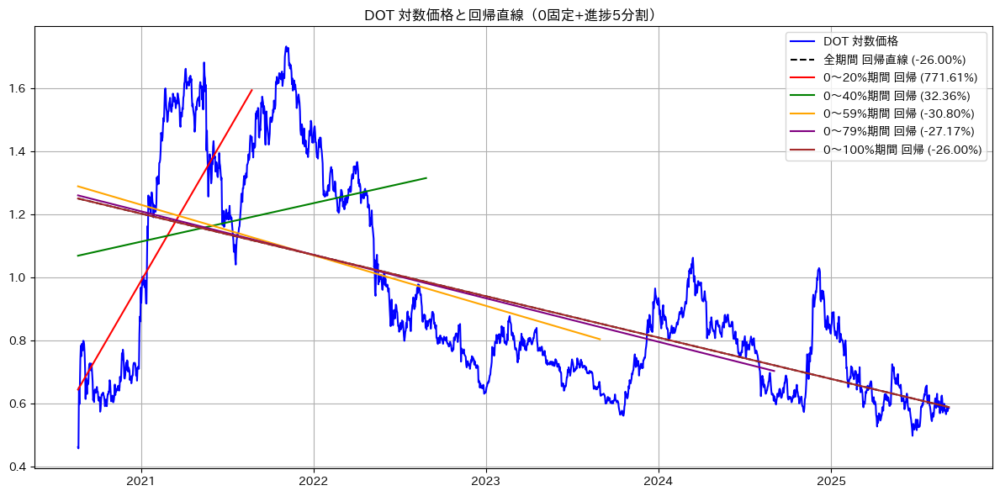

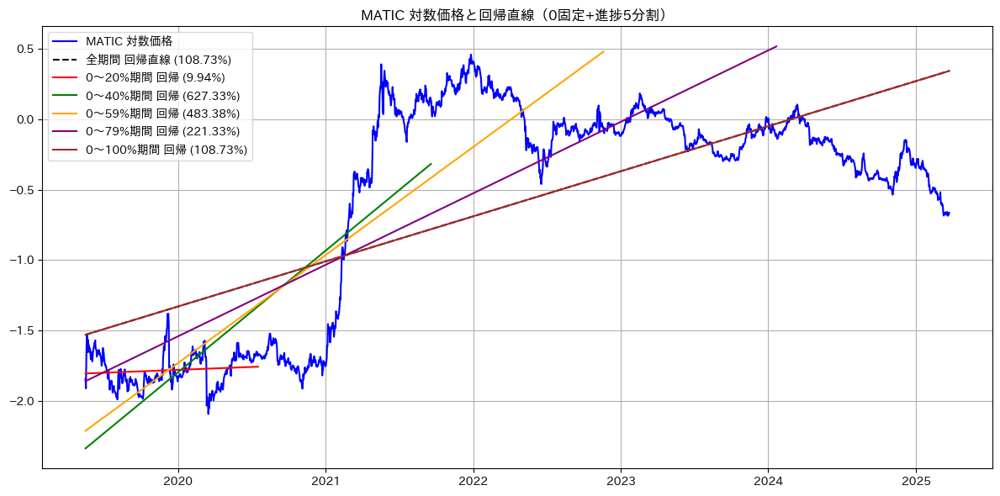

c:\Users\t-miura\Documents\05.portfolio\financial_analytics\.venv\Lib\site-packages\pandas\core\internals\blocks.py:395: RuntimeWarning: invalid value encountered in log10
  result = func(self.values, **kwargs)


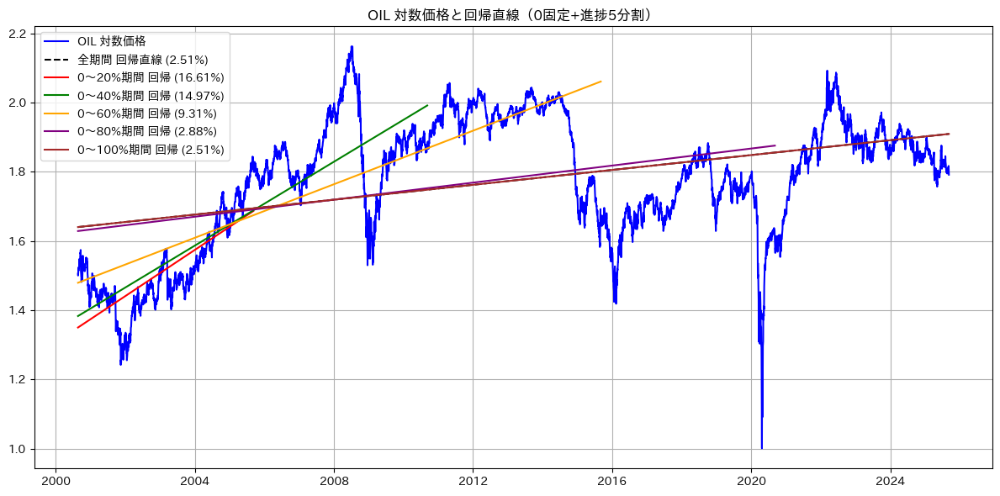

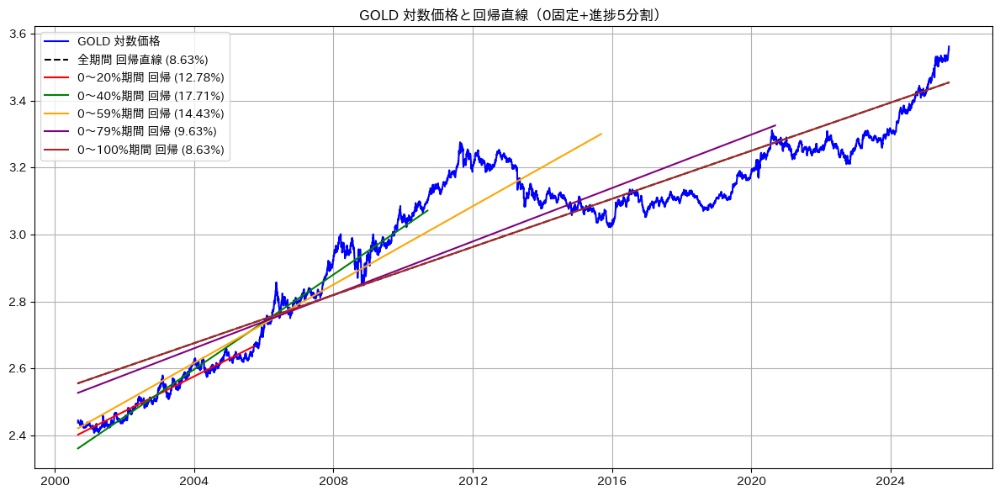

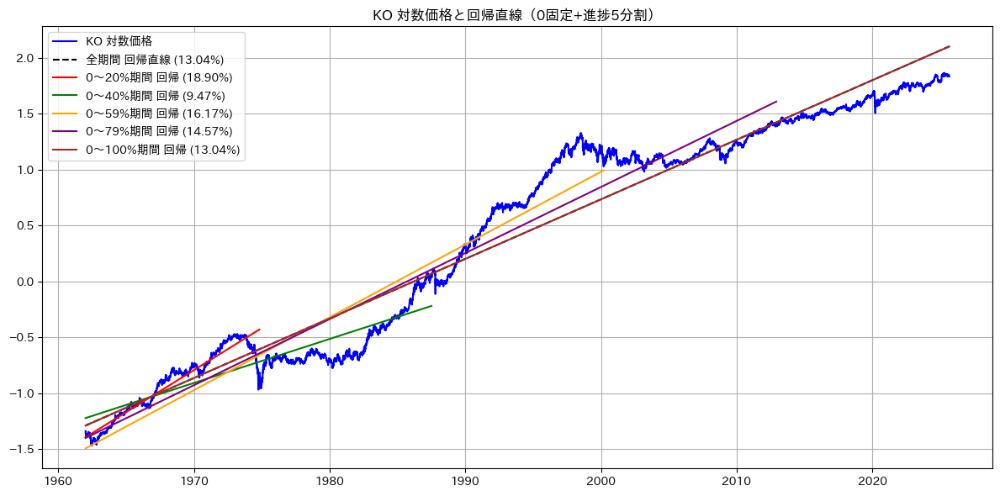

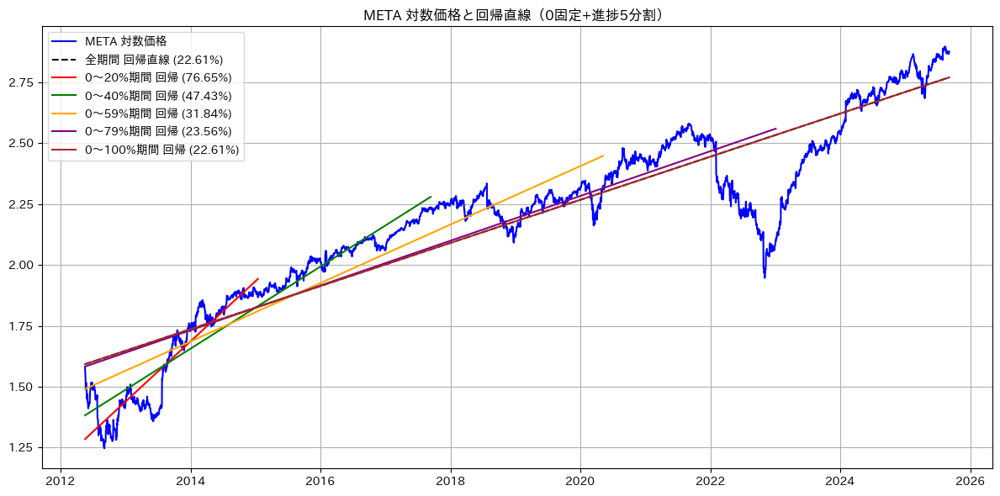

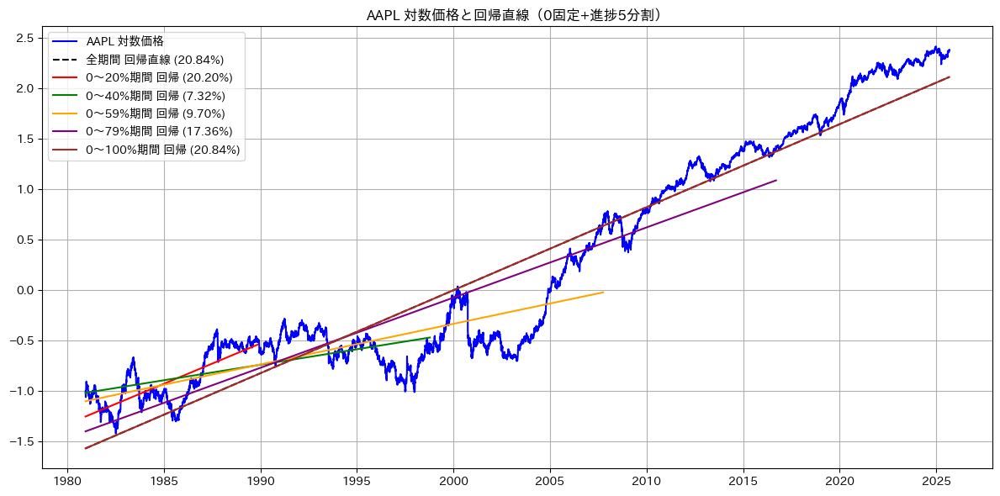

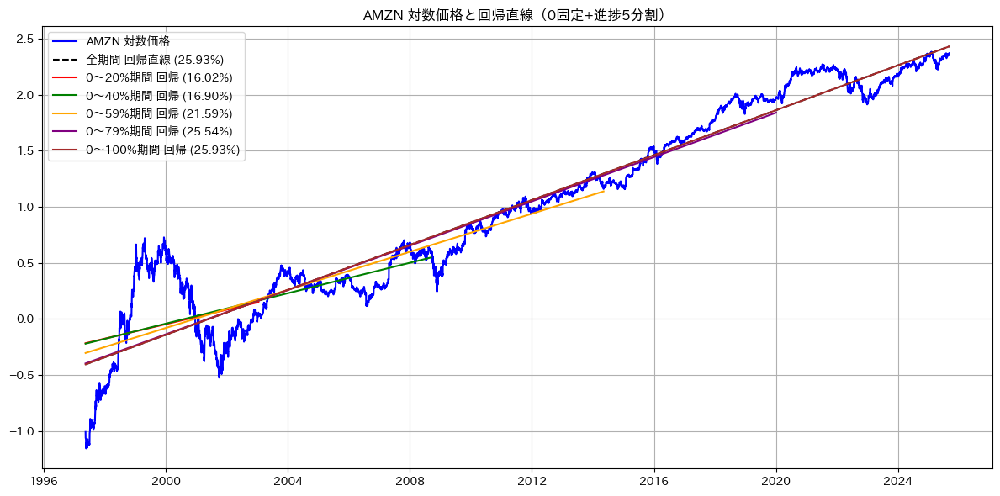

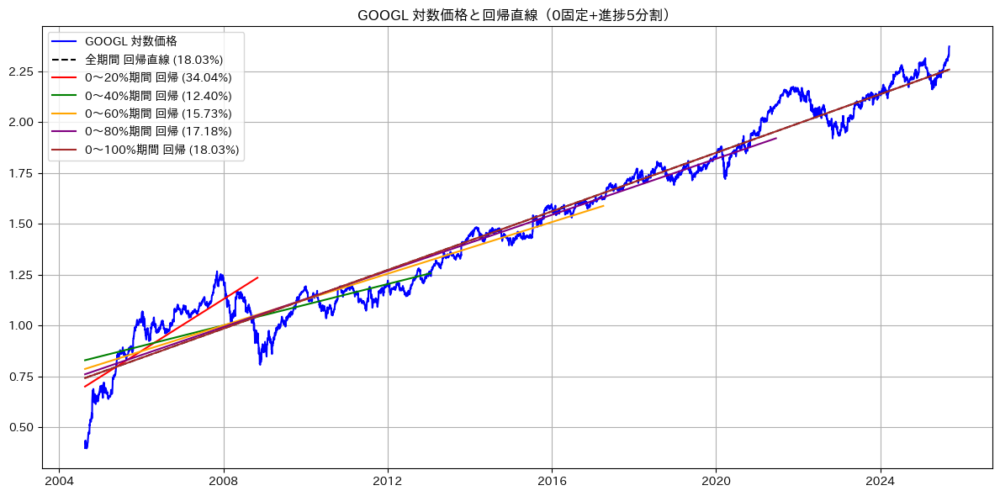

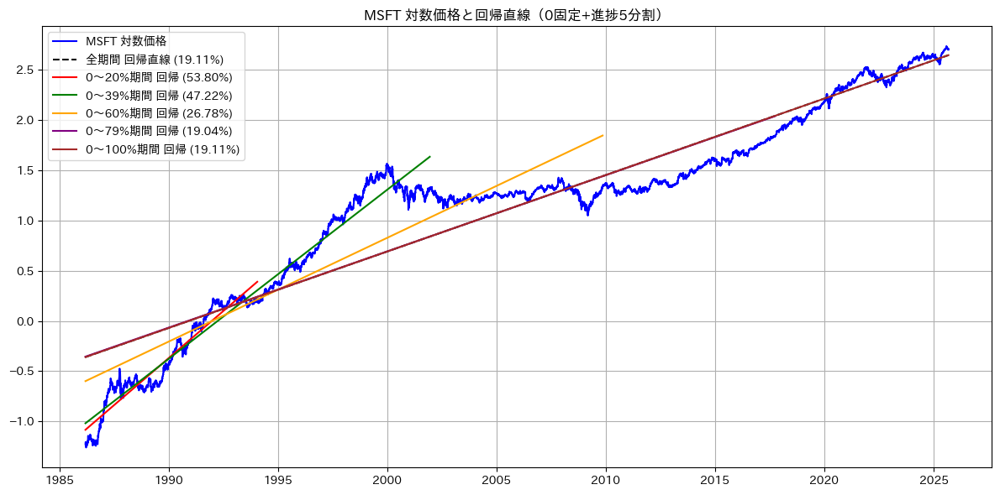

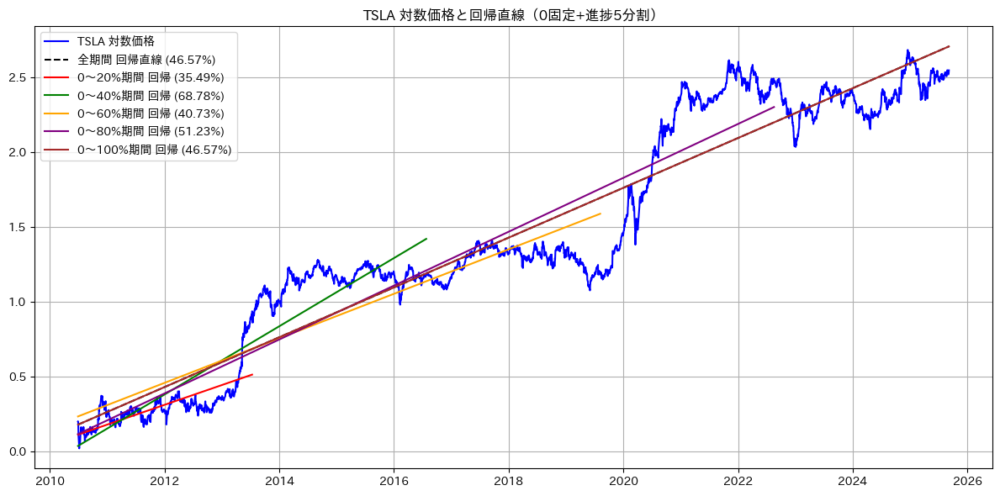

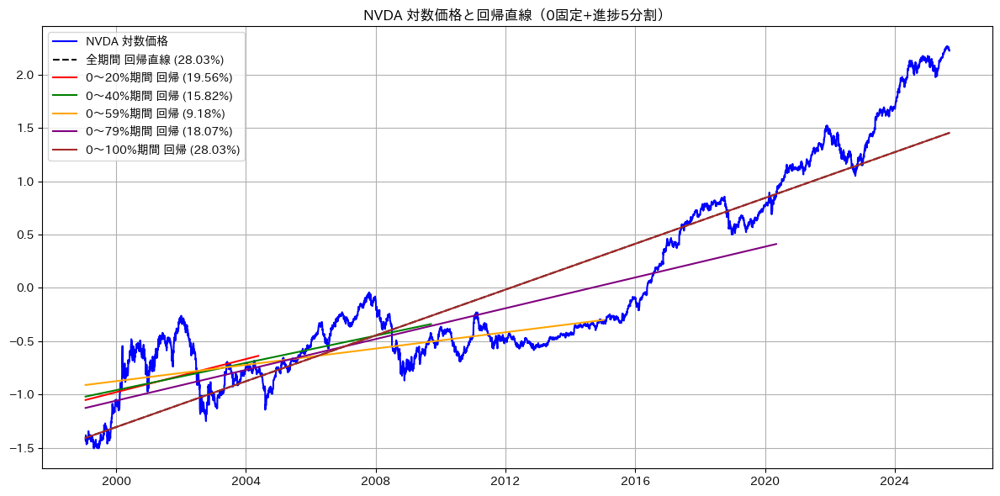

In [ ]:
for name, data in data_dict.items():
    log_close = np.log10(data['Close']).dropna()

    dates = log_close.index
    x = (dates - dates[0]).days.values

    y = log_close.values.ravel()

    # 全体の回帰直線
    slope, intercept, _, _, _ = linregress(x, y)
    y_pred = intercept + slope * x
    r_annual = 10 ** (slope * 365) - 1

    # 先頭固定で区切り点を5等分（各期間までの回帰直線）
    n = len(x)
    segments = 5
    cutoffs = np.linspace(1, n, segments + 1, dtype=int)[1:]  # 各終了インデックス
    segment_lines = []

    for i, end in enumerate(cutoffs):
        indices = np.arange(end)
        x_seg = x[indices]
        y_seg = y[indices]
        slope_seg, intercept_seg, *_ = linregress(x_seg, y_seg)
        y_pred_seg = intercept_seg + slope_seg * x_seg
        r_seg = 10 ** (slope_seg * 365) - 1
        segment_lines.append((indices, y_pred_seg, r_seg))

    # プロット
    plt.figure(figsize=(12, 6))
    plt.plot(dates, y, label=f'{name} 対数価格', color='blue')
    plt.plot(dates, y_pred, linestyle='--', label=f'全期間 回帰直線 ({r_annual:.2%})', color='black')

    # 各区間の回帰直線を追加
    colors = ['red', 'green', 'orange', 'purple', 'brown']
    for i, (indices, y_seg, r_seg) in enumerate(segment_lines):
        plt.plot(dates[indices], y_seg, linestyle='-', color=colors[i], label=f'0〜{int((indices[-1]+1)/n*100)}%期間 回帰 ({r_seg:.2%})')

    plt.title(f'{name} 対数価格と回帰直線（0固定+進捗5分割）')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

## 残差を追加

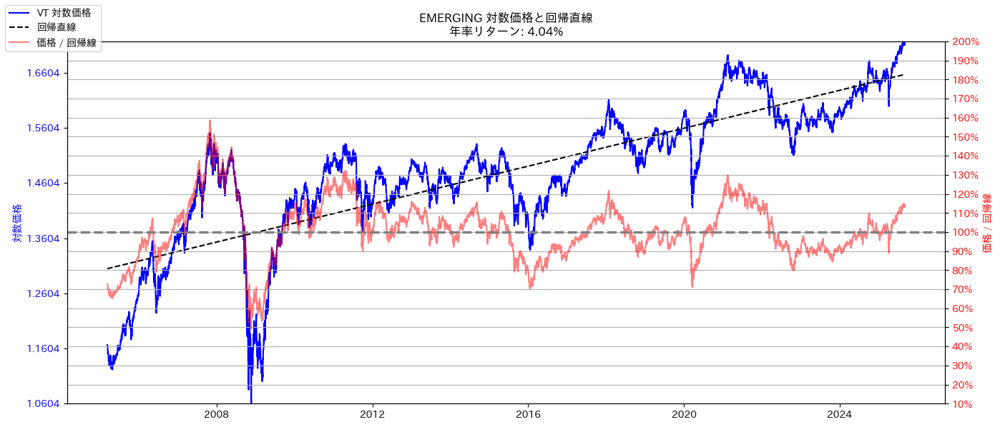

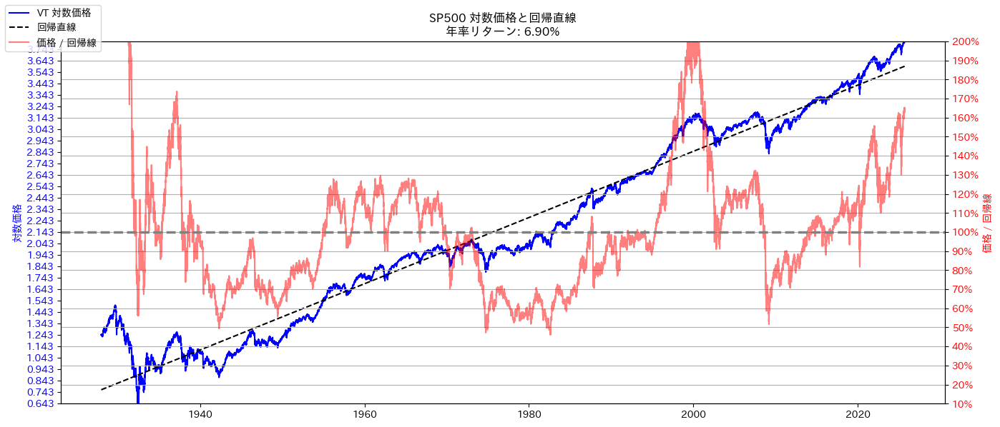

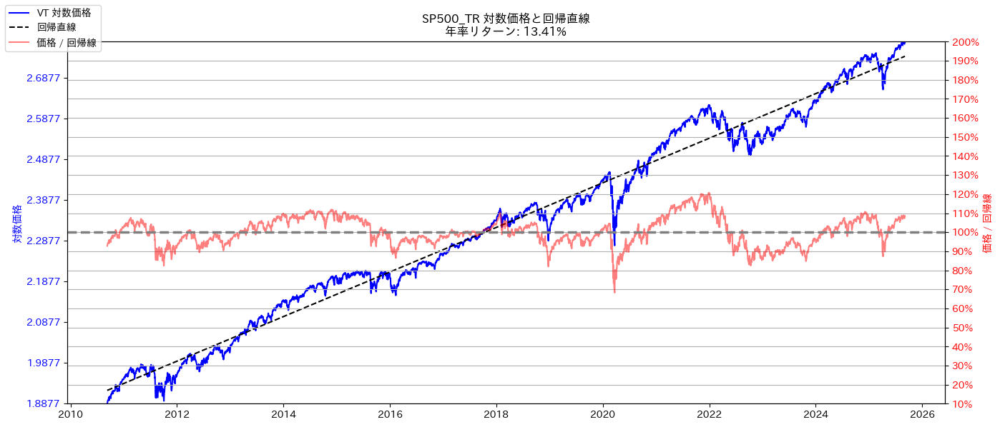

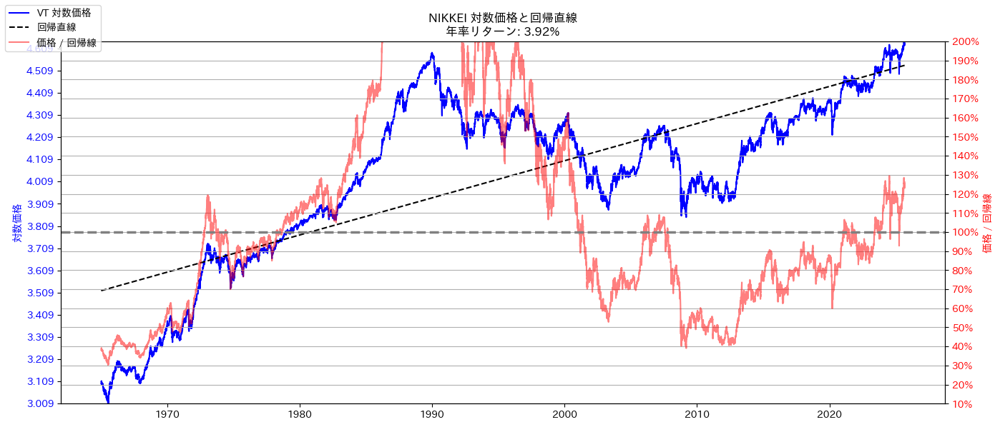

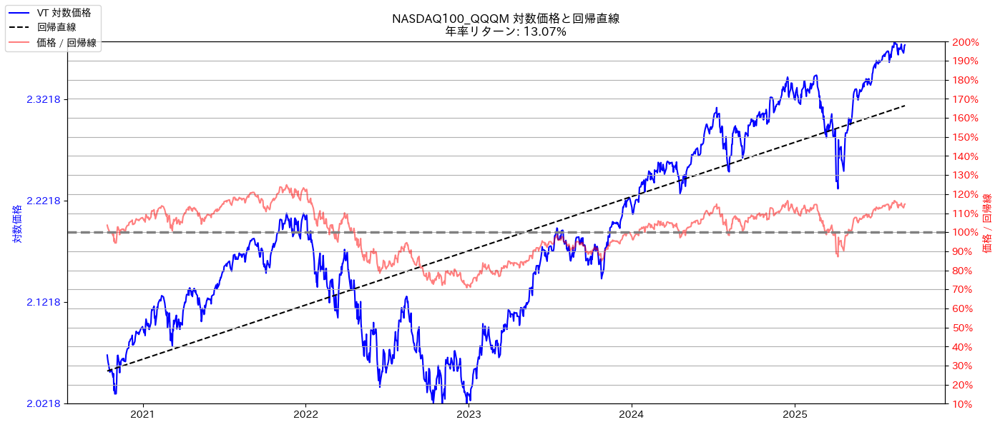

...

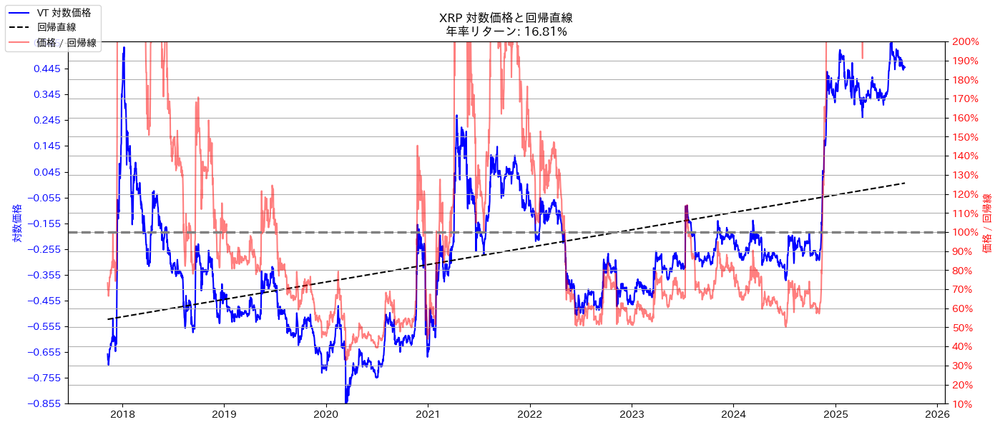

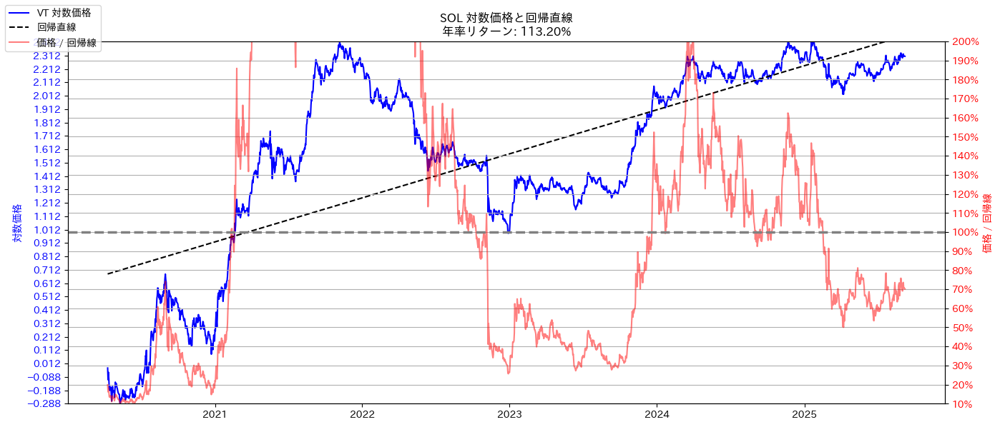

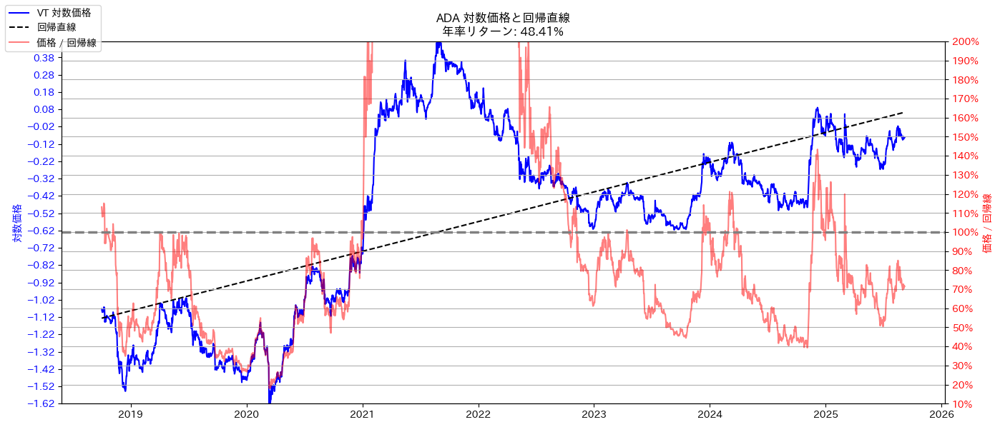

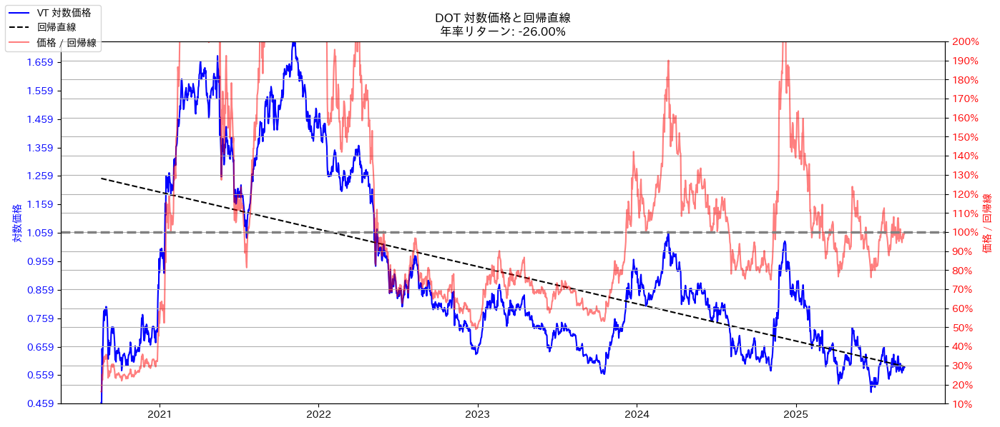

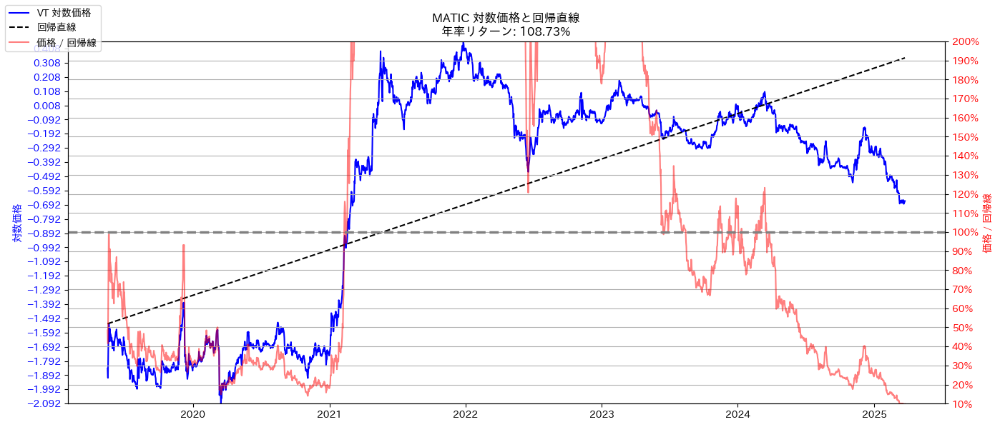

c:\Users\t-miura\Documents\05.portfolio\financial_analytics\.venv\Lib\site-packages\pandas\core\internals\blocks.py:395: RuntimeWarning: invalid value encountered in log10
  result = func(self.values, **kwargs)


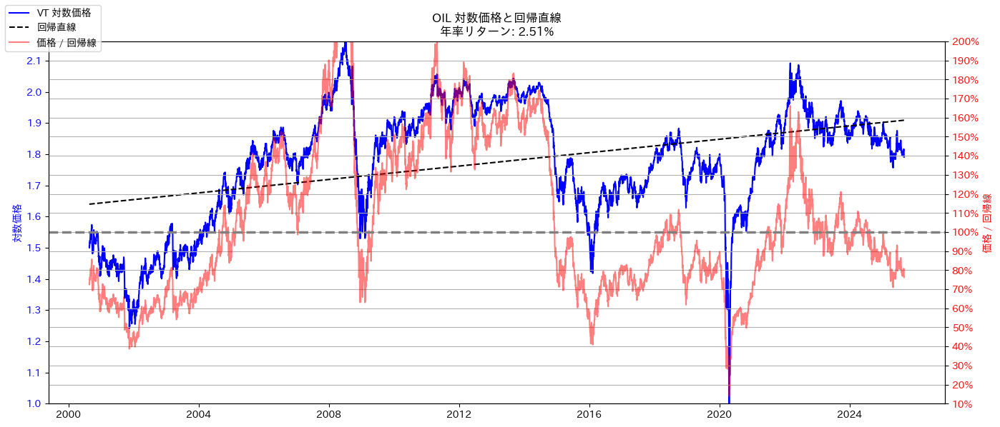

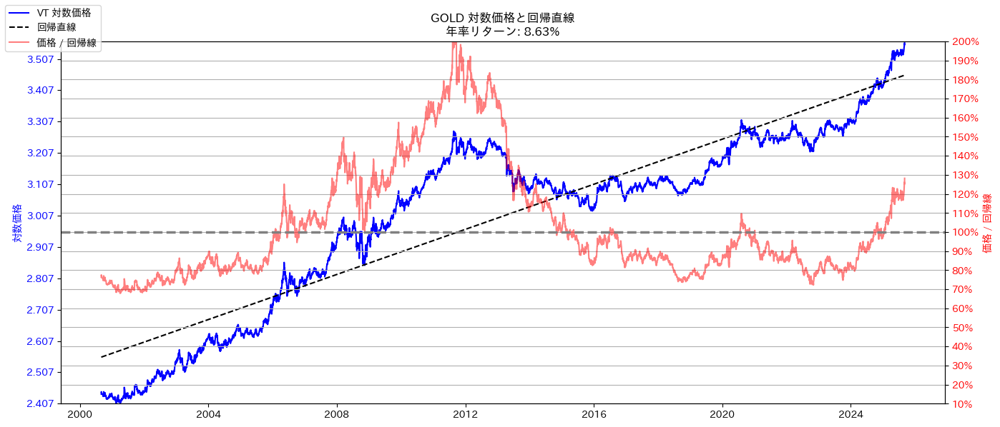

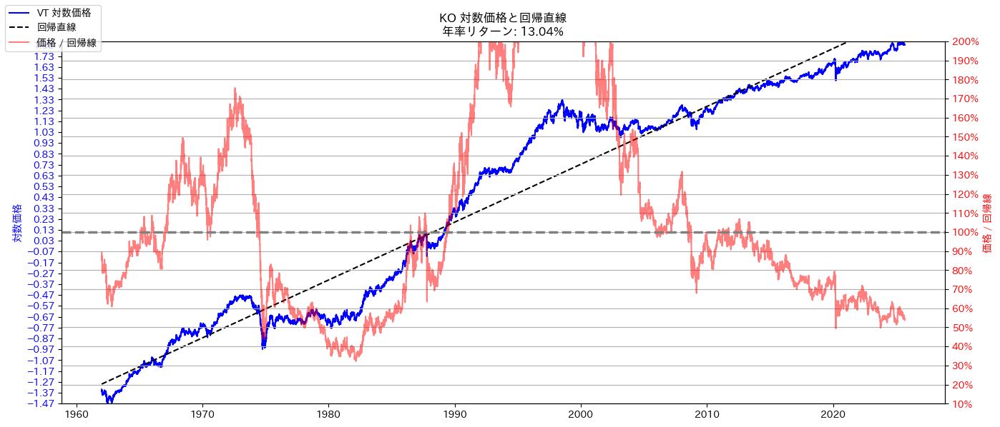

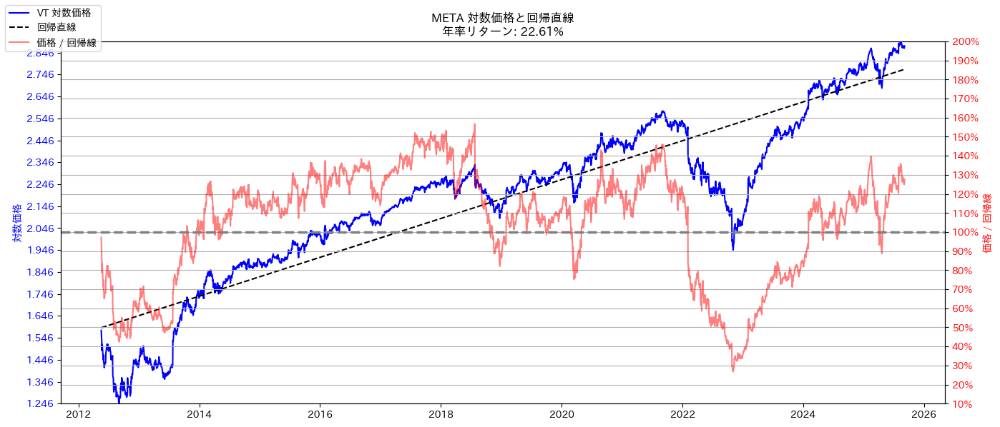

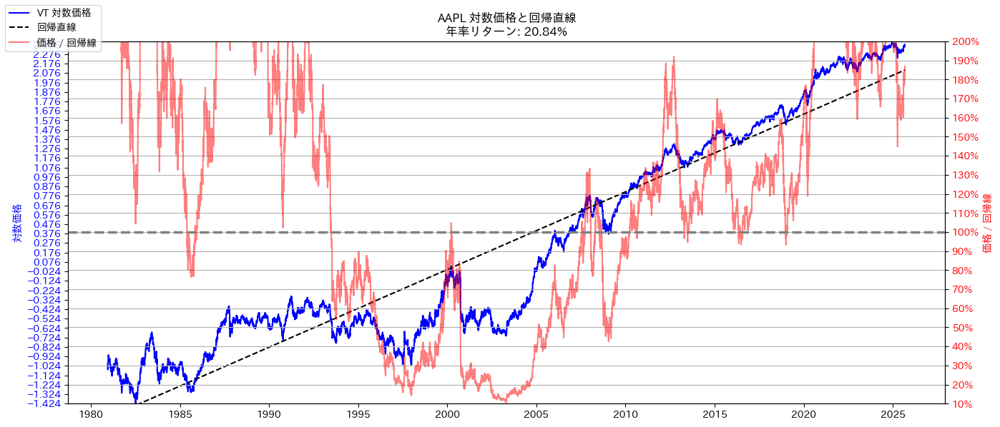

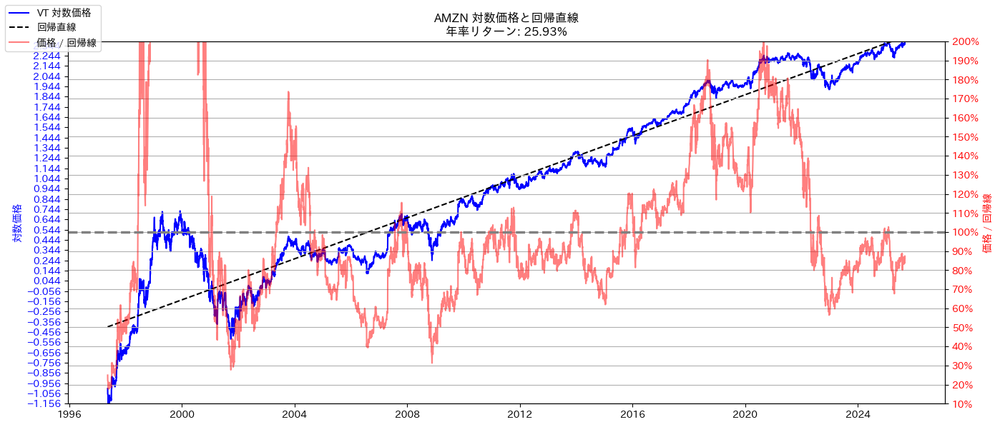

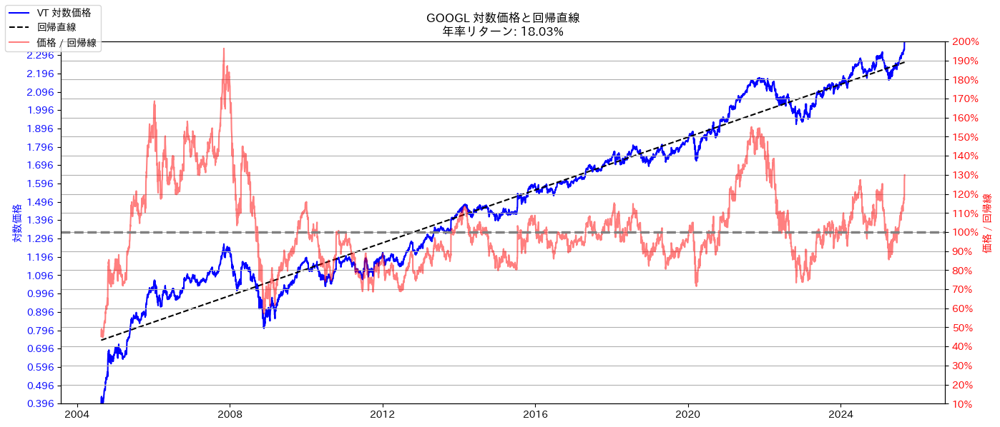

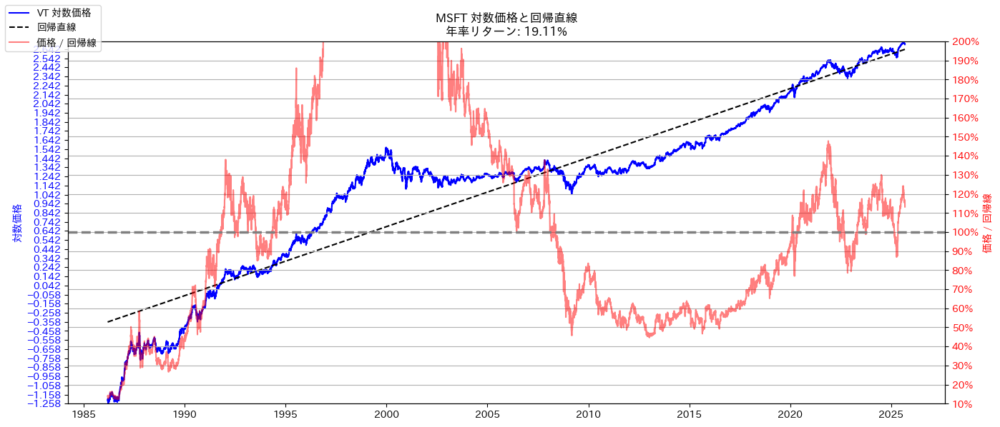

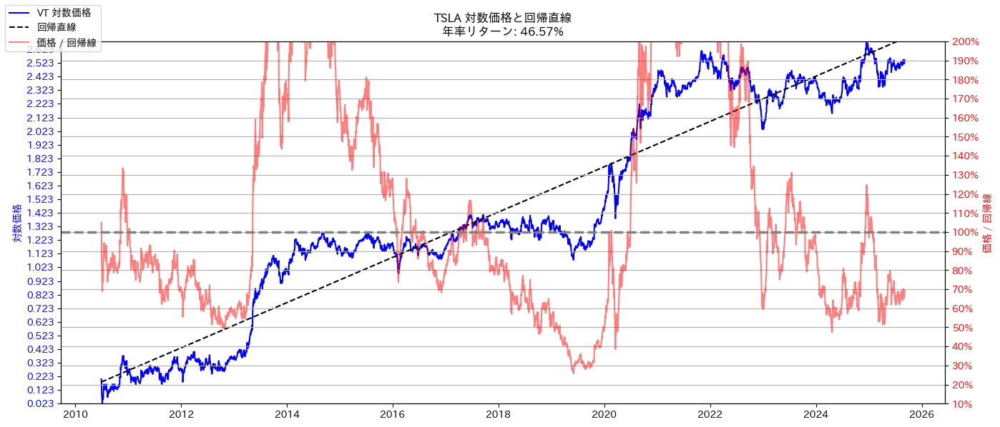

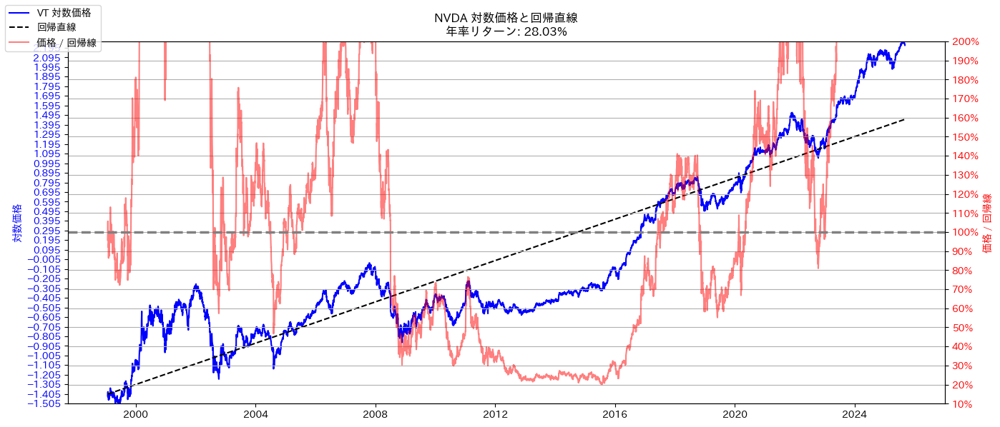

In [ ]:
from matplotlib.ticker import PercentFormatter
# 可視化と回帰直線描画

# 可視化と回帰直線描画
for name, data in data_dict.items():
    log_close = np.log10(data['Close']).dropna()

    dates = log_close.index
    x = (dates - dates[0]).days.values  # 日数
    # x = np.arange(len(log_close))

    y = log_close.values.ravel()

    slope, intercept, _, _, _ = linregress(x, y)
    # 回帰直線上の期待値
    y_pred = intercept + slope * x

    # 対数残差と比
    residuals = y - y_pred
    ratios = 10 ** residuals

    r_annual = compute_annualized_return(slope, log_close.index, days_per_year=365)

    fig, ax1 = plt.subplots(figsize=(14, 6))
    ax1.set_title(f'{name} 対数価格と回帰直線\n年率リターン: {r_annual:.2%}')
    ax1.plot(dates, y, label='VT 対数価格', color='blue')
    ax1.plot(dates, y_pred, linestyle='--', label='回帰直線', color='black')
    ax1.set_ylabel('対数価格', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    # ▼ 0.1刻みの目盛りを設定（0.1〜2.0まで)
    ax1.set_ylim(np.min(y), np.max(y))
    ax1.set_yticks(np.arange(np.min(y), np.max(y), 0.1))  # 2.0まで含めたい場合は 2.1 にしておく

    ax2 = ax1.twinx()
    ax2.plot(dates, ratios, label='価格 / 回帰線', color='red',
            alpha=0.5
            )
    ax2.set_ylabel('価格 / 回帰線', color='red')
    ax2.tick_params(axis='y', labelcolor='red')
    # ここを追加（比率 → %表示に変換）
    ax2.yaxis.set_major_formatter(PercentFormatter(xmax=1.0))
    # 100%ラインを太く目立たせる
    ax2.axhline(1.0, color='gray', linestyle='--', linewidth=2.5,
                # label='100% 基準線'
                )
    # # y軸を50〜200%に固定
    ax2.set_ylim(0.1, 2.0)

    # ▼ 0.1刻みの目盛りを設定（0.1〜2.0まで）
    ax2.set_yticks(np.arange(0.1, 2.1, 0.1))  # 2.0まで含めたい場合は 2.1 にしておく

    fig.legend(loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

## ↑は未来の情報も含んだ回帰のため、該当時点の回帰直線との残差も可視化

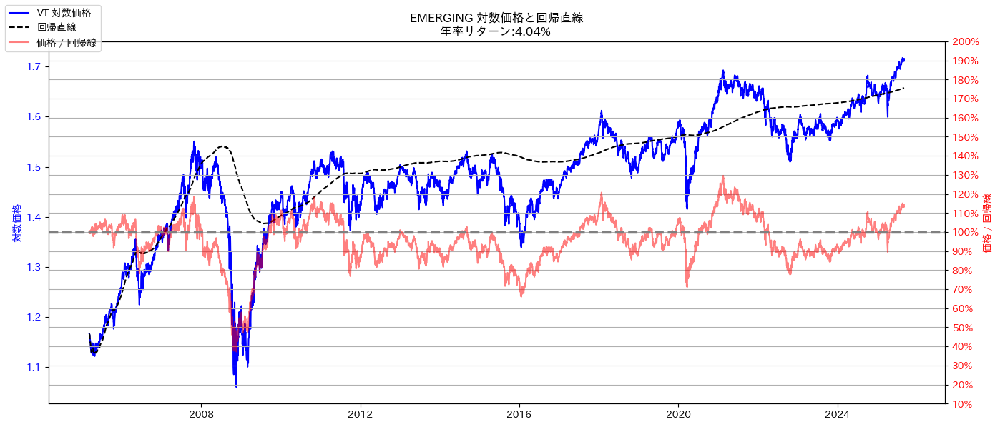

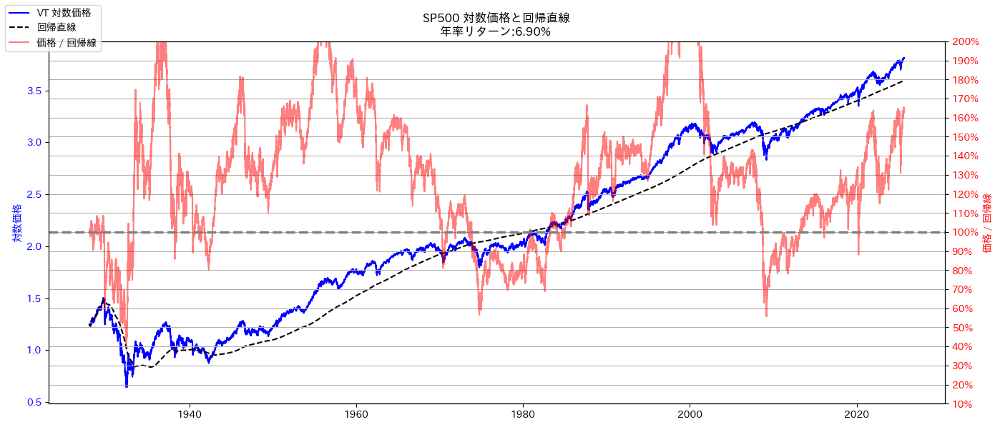

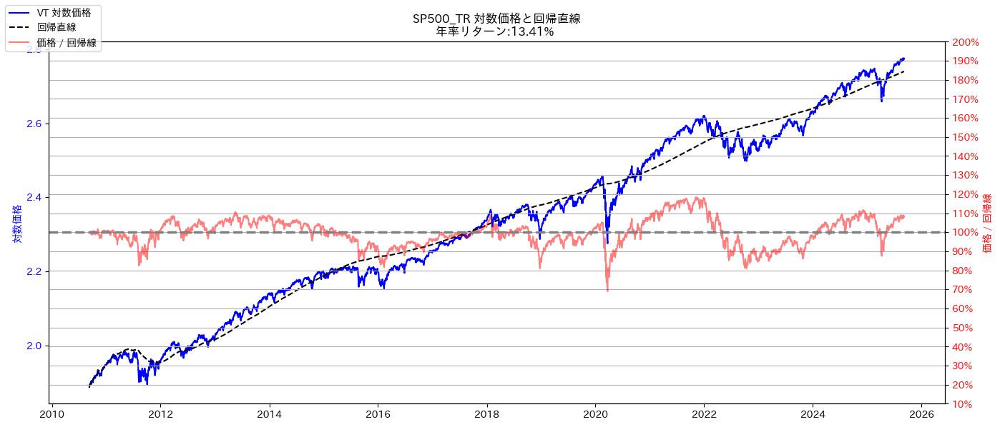

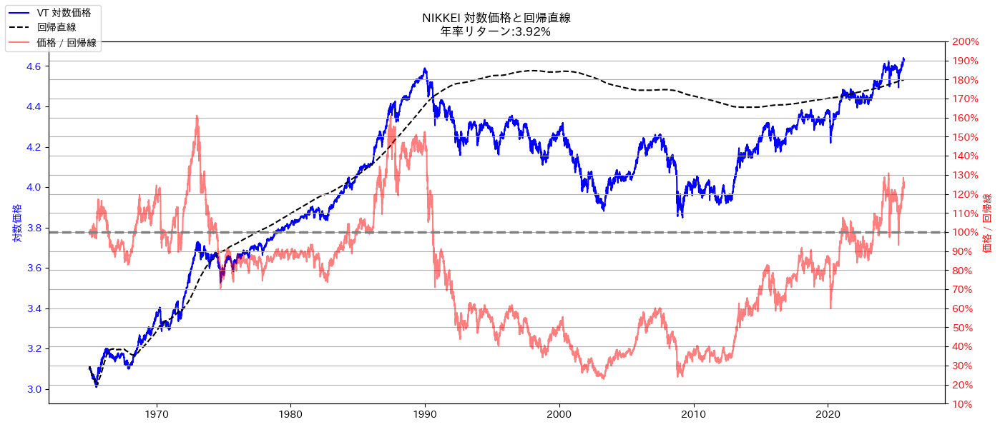

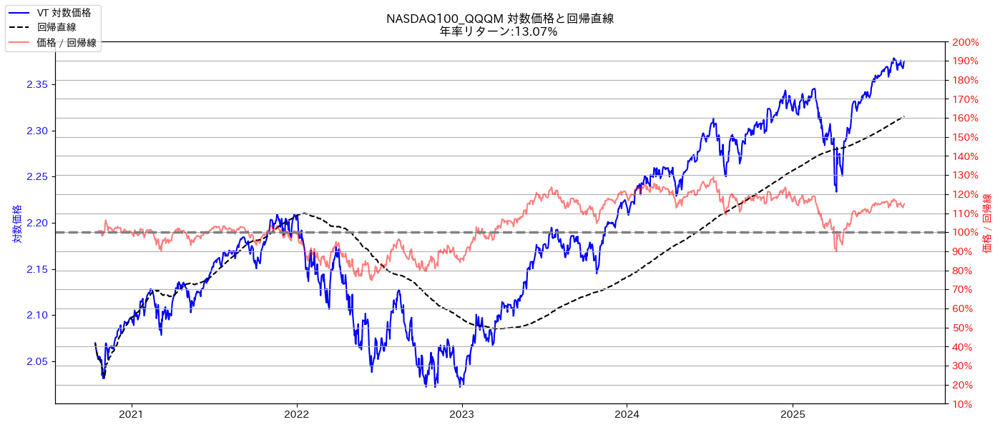

...

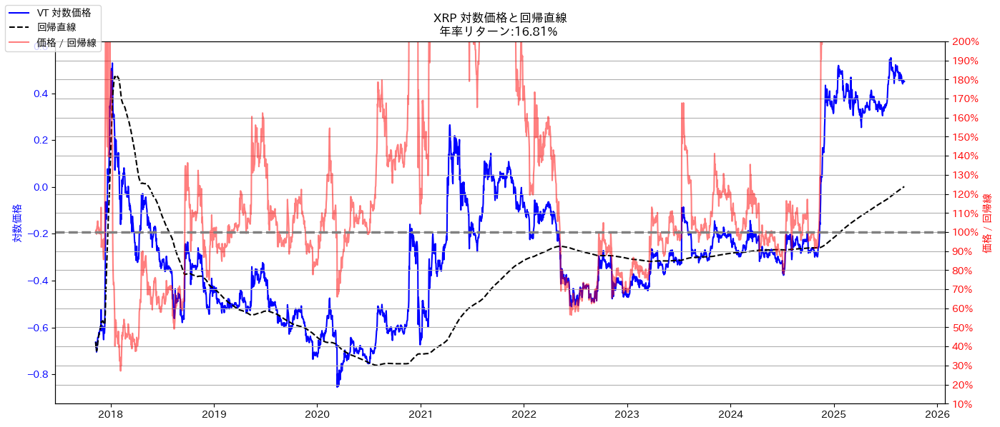

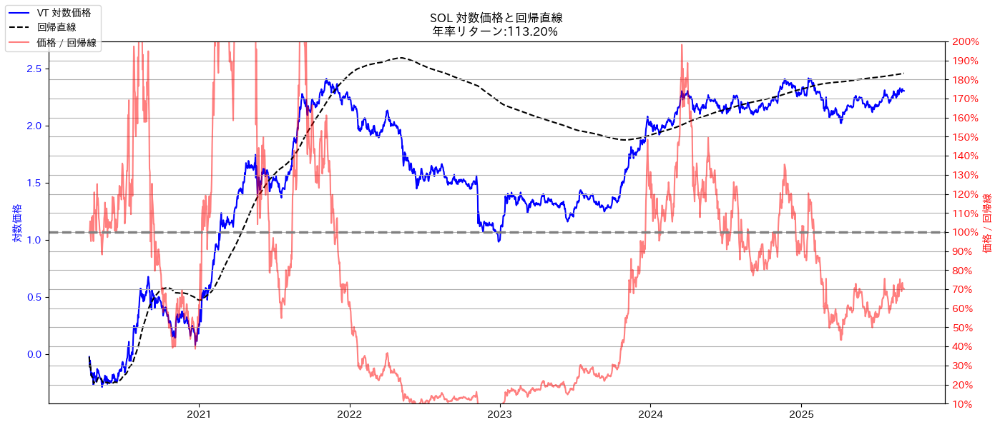

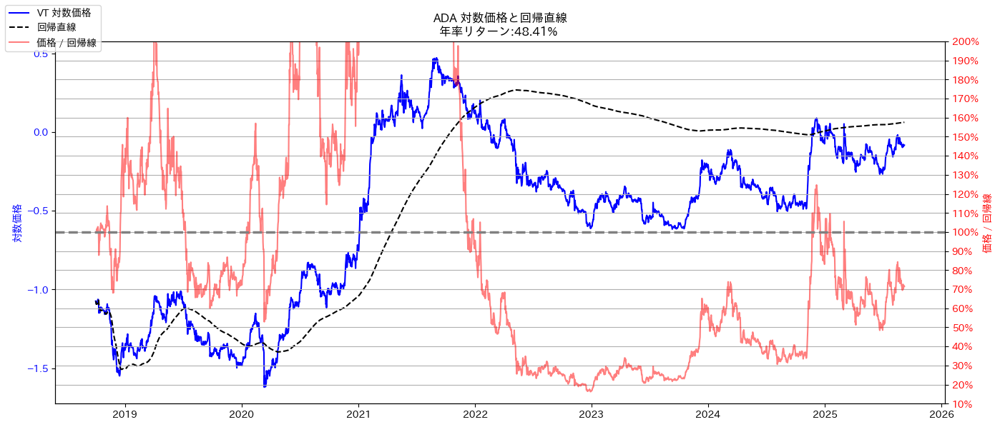

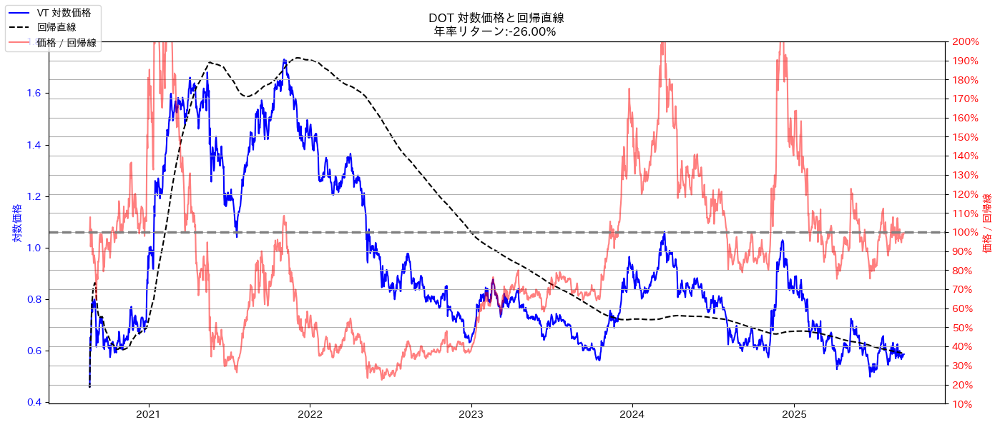

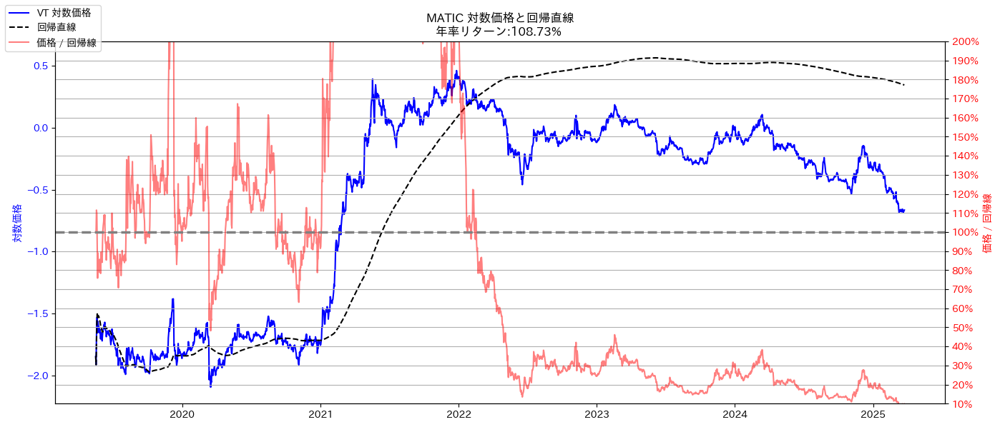

c:\Users\t-miura\Documents\05.portfolio\financial_analytics\.venv\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


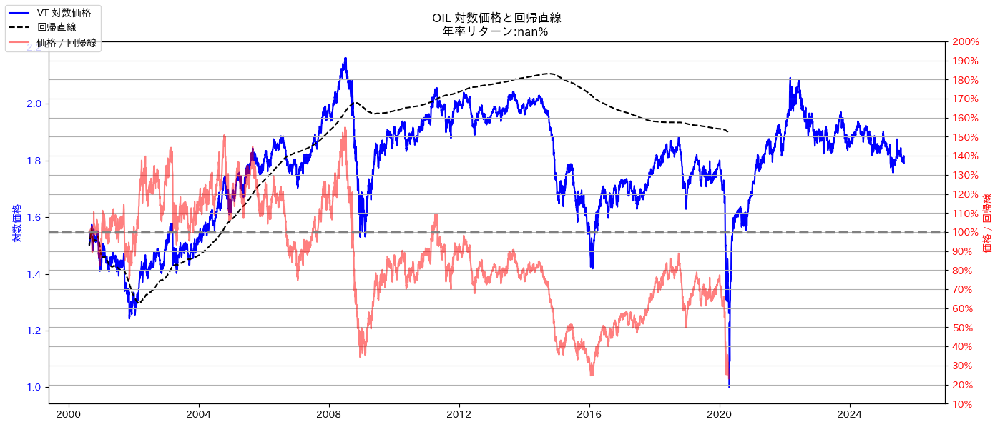

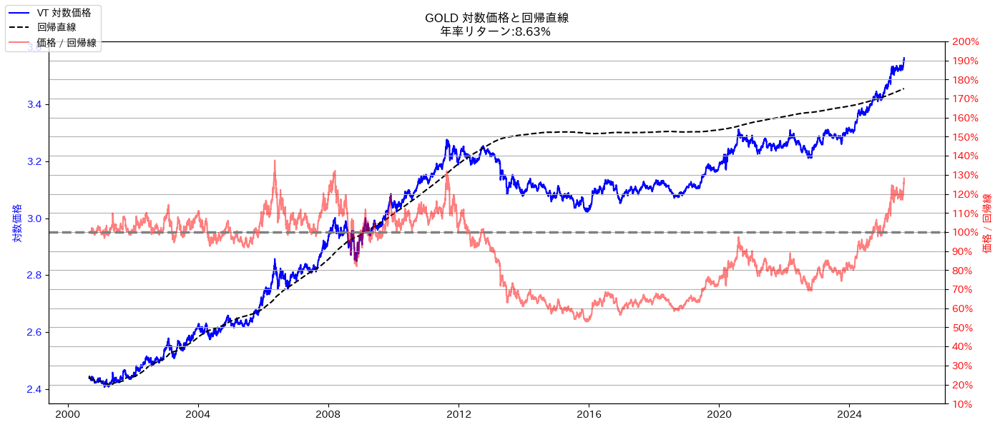

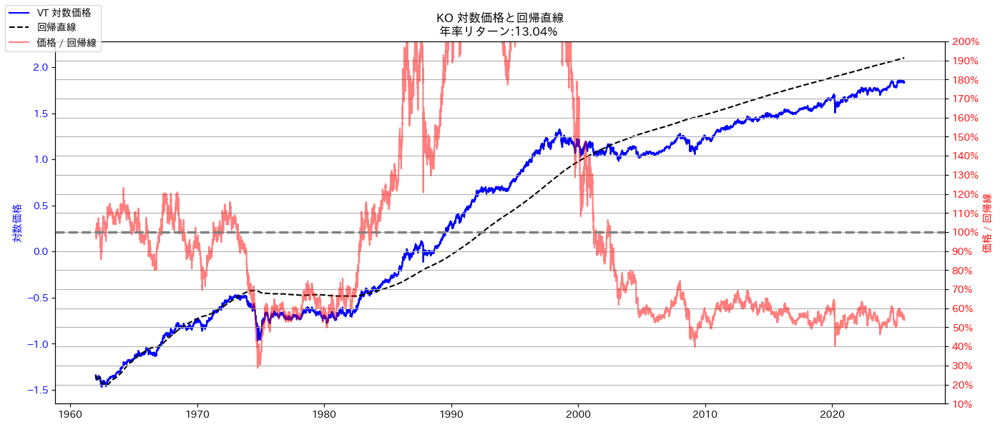

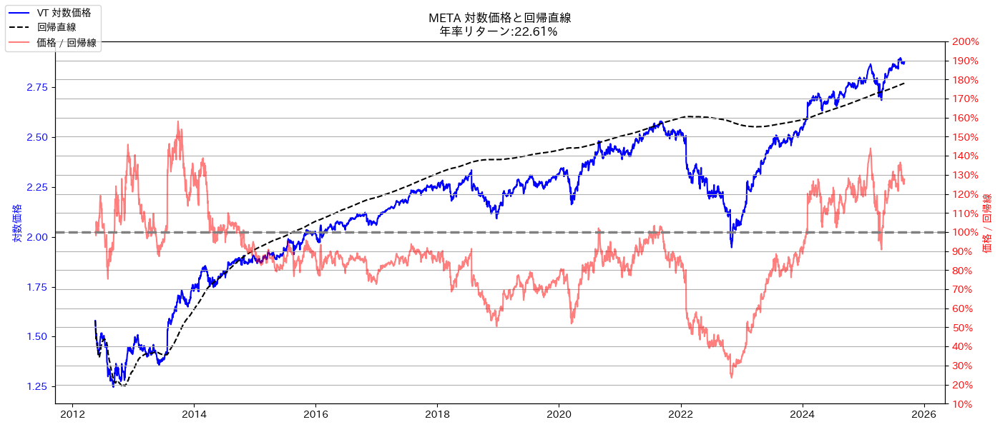

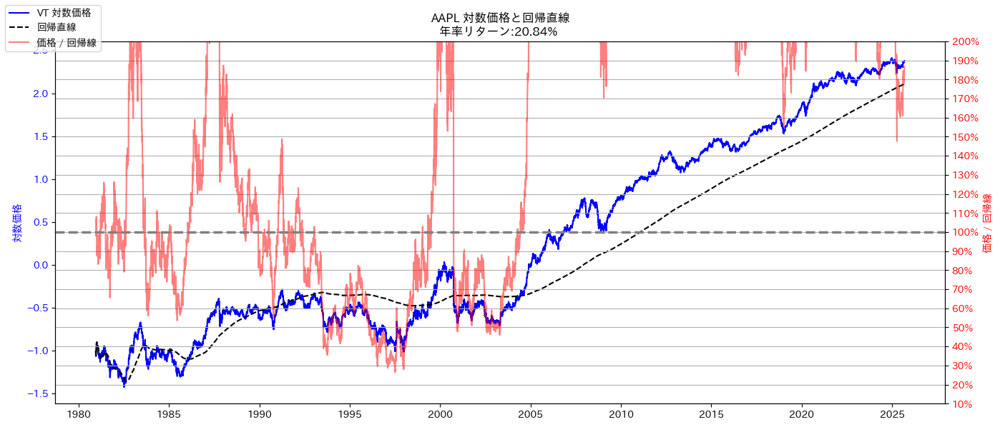

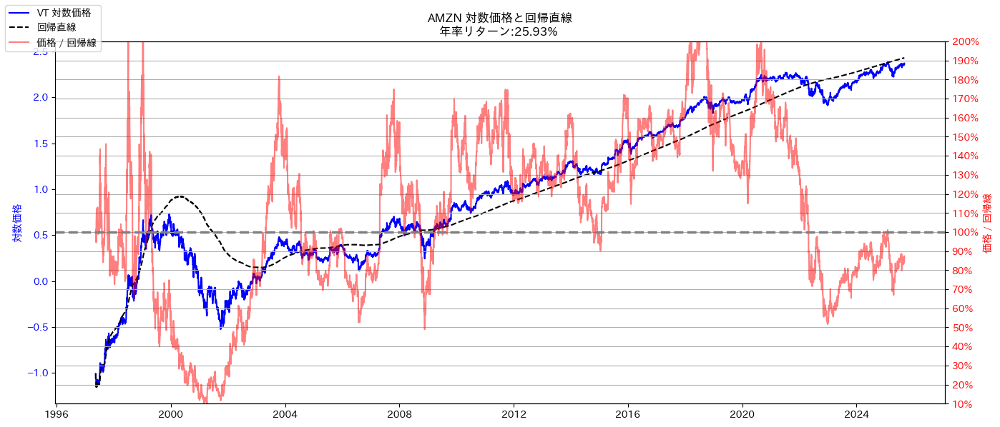

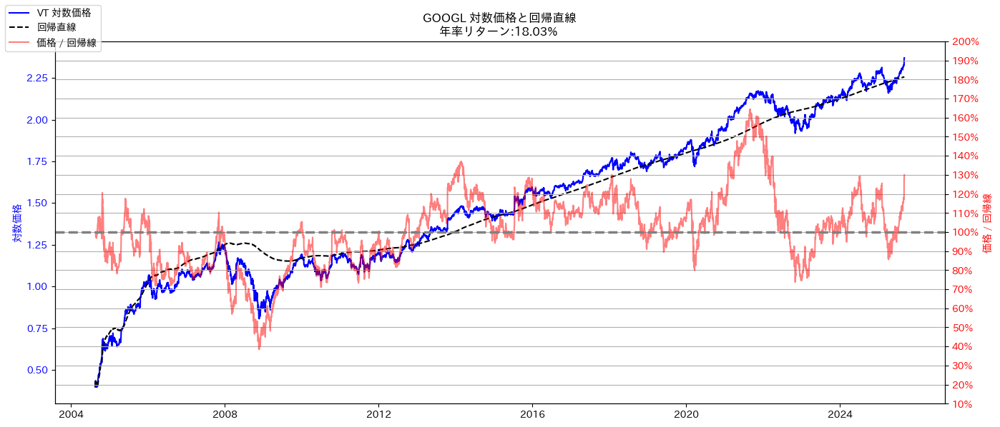

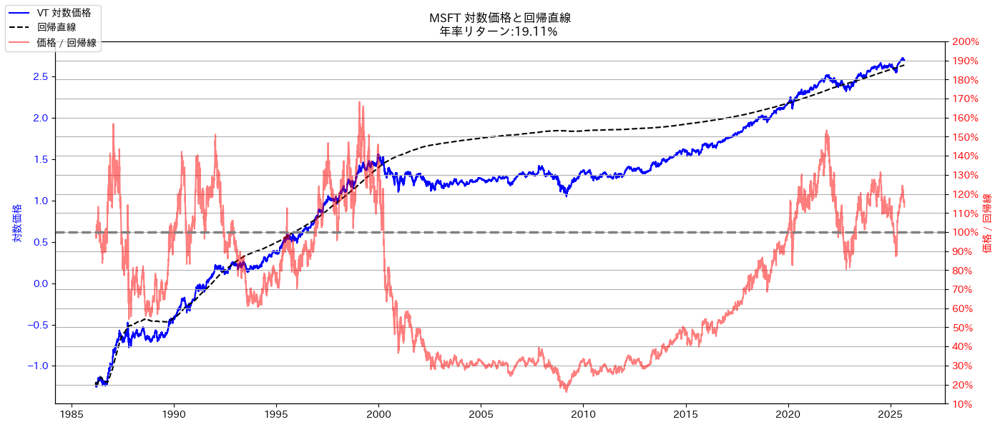

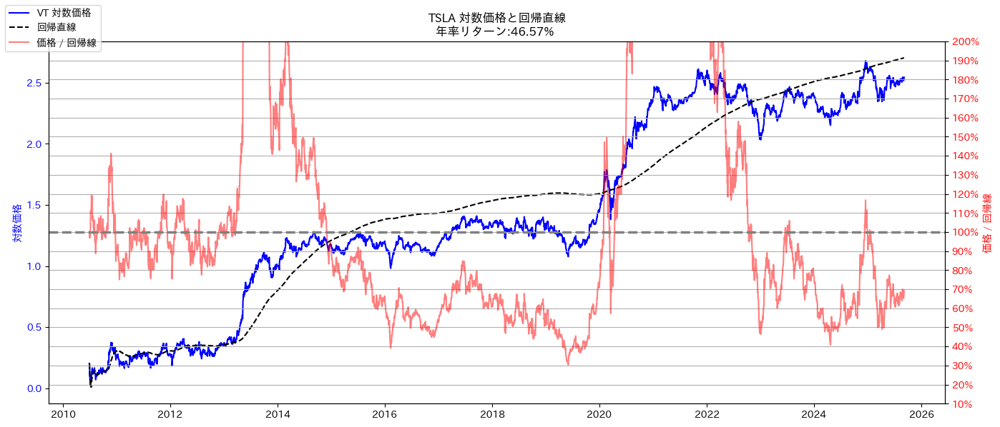

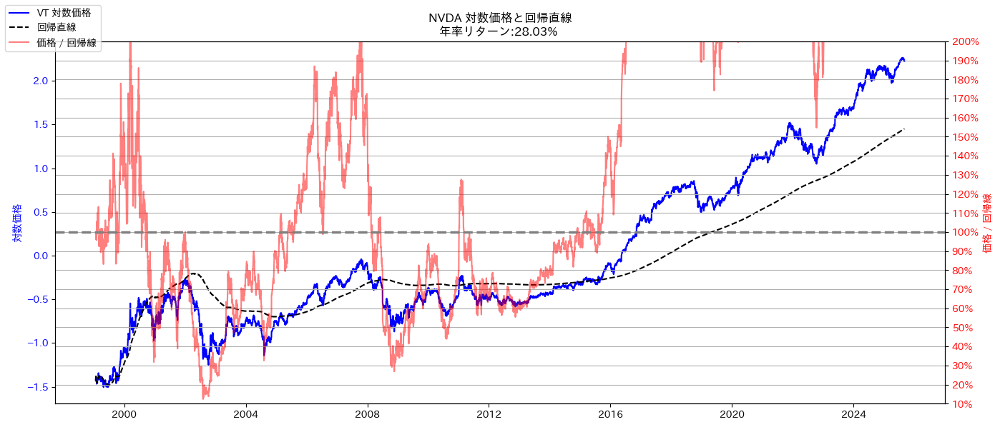

In [ ]:
for name, data in data_dict.items():
    log_trend_list = []

    # ティッカーも指定して対数価格を取得
    data[('log_Close', assets[name]['ticker'])] = np.log10(data[('Close', assets[name]['ticker'])])#.dropna()


    # 原油がマイナス価格(買ったらお金が貰える)だった時があるのでNaNを削除
    # data = data.dropna()


    dates = data.index
    # display(data)
    # print(dates)
    x = (dates - dates[0]).days.values  # 日数

    for i in range(len(x)):
        if i < 2:  # 最低日数のしきい値
            log_trend_list.append(data[('log_Close', assets[name]['ticker'])].iloc[i])
            continue

        y = data[('log_Close', assets[name]['ticker'])].iloc[:i + 1].values.ravel()
        slope, intercept, *_ = linregress(x[:i + 1], y)
        trend_today = intercept + slope * x[i]

        log_trend_list.append(trend_today)

    y = data[('log_Close', assets[name]['ticker'])].values.ravel()
    # 回帰直線から予測される価格
    data[('log_pred_Close', assets[name]['ticker'])] = np.array(log_trend_list)

    y_pred = data[('log_pred_Close', assets[name]['ticker'])]

    data_dict[name] = data  # 処理後に上書き保存


    # 対数残差と比
    residuals = y - y_pred
    ratios = 10 ** residuals

    r_annual = compute_annualized_return(slope, data[('log_Close', assets[name]['ticker'])].index, days_per_year=365)


    data[('y_to_pred_ratio', assets[name]['ticker'])] = ratios

    fig, ax1 = plt.subplots(figsize=(14, 6))
    ax1.set_title(f'{name} 対数価格と回帰直線\n年率リターン:{r_annual:.2%} ')
    ax1.plot(dates, y, label='VT 対数価格', color='blue')
    ax1.plot(dates, y_pred, linestyle='--', label='回帰直線', color='black')
    ax1.set_ylabel('対数価格', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')

    ax2 = ax1.twinx()
    ax2.plot(dates, ratios, label='価格 / 回帰線', color='red',
            alpha=0.5
            )
    ax2.set_ylabel('価格 / 回帰線', color='red')
    ax2.tick_params(axis='y', labelcolor='red')
    # ここを追加（比率 → %表示に変換）
    ax2.yaxis.set_major_formatter(PercentFormatter(xmax=1.0))
    # 100%ラインを太く目立たせる
    ax2.axhline(1.0, color='gray', linestyle='--', linewidth=2.5,
                # label='100% 基準線'
                )
    # y軸を50〜200%に固定
    ax2.set_ylim(0.1, 2.0)

    # ▼ 0.1刻みの目盛りを設定（0.1〜2.0まで）
    ax2.set_yticks(np.arange(0.1, 2.1, 0.1))  # 2.0まで含めたい場合は 2.1 にしておく

    fig.legend(loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()



# 実際の価格と期待価格

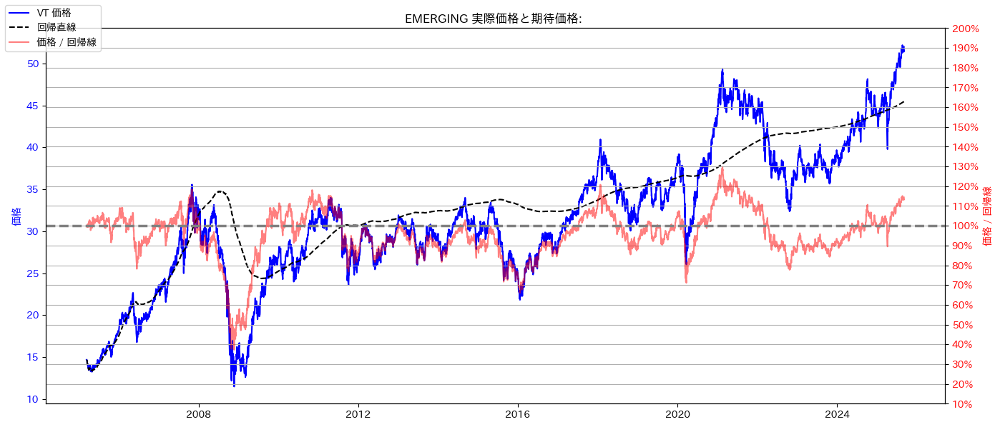

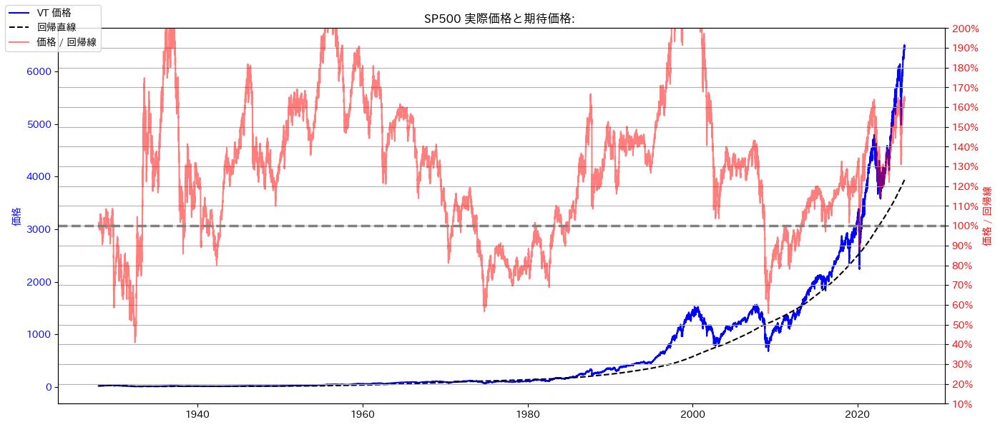

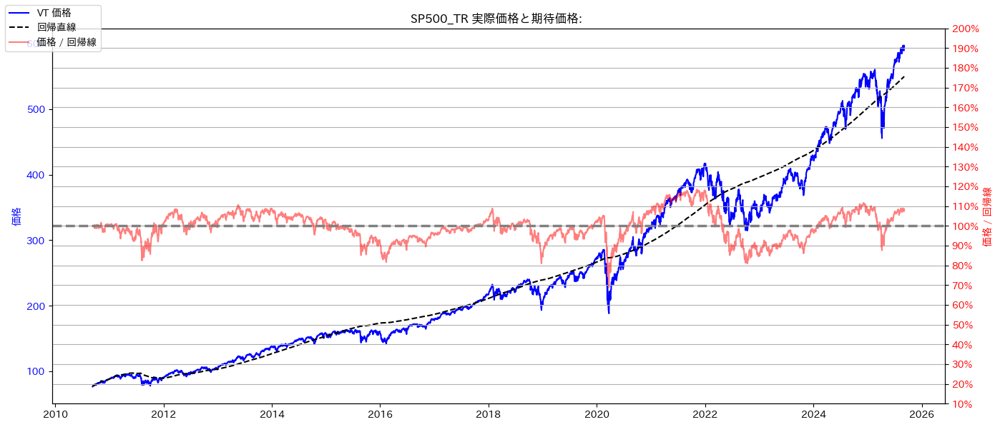

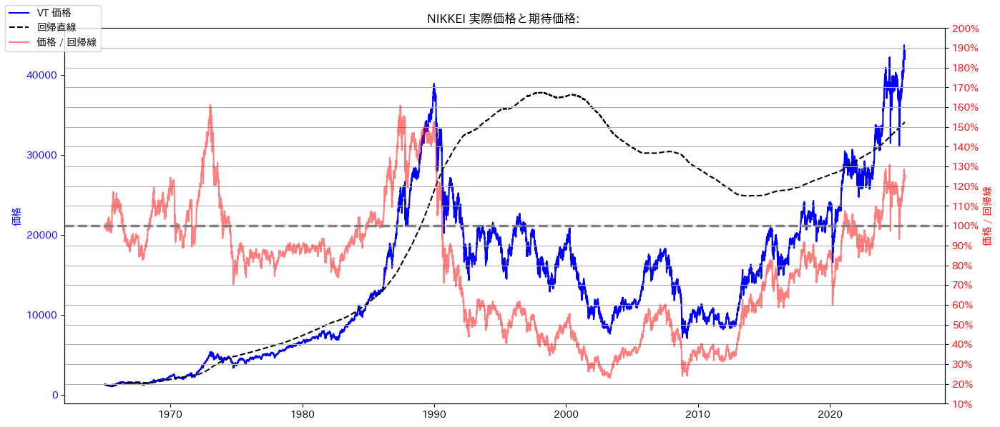

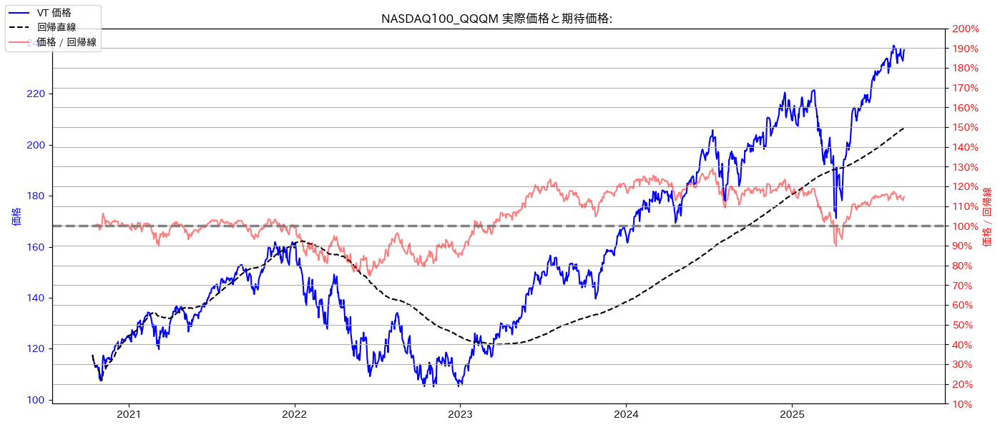

...

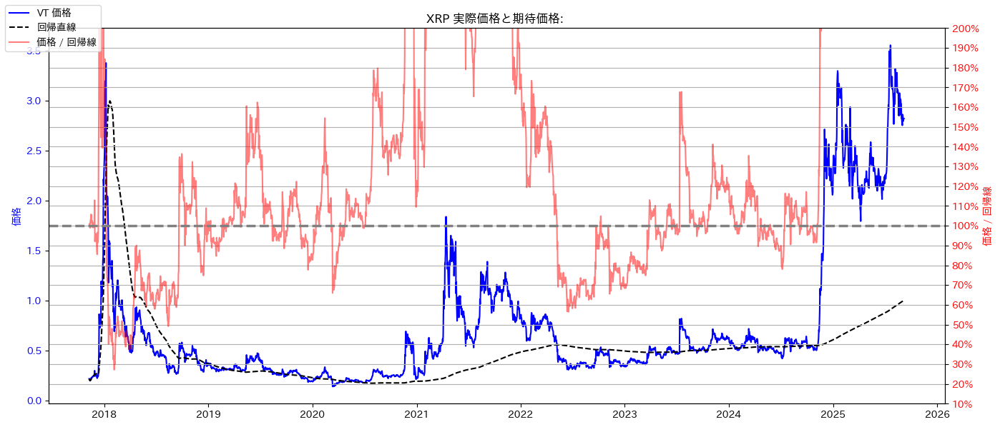

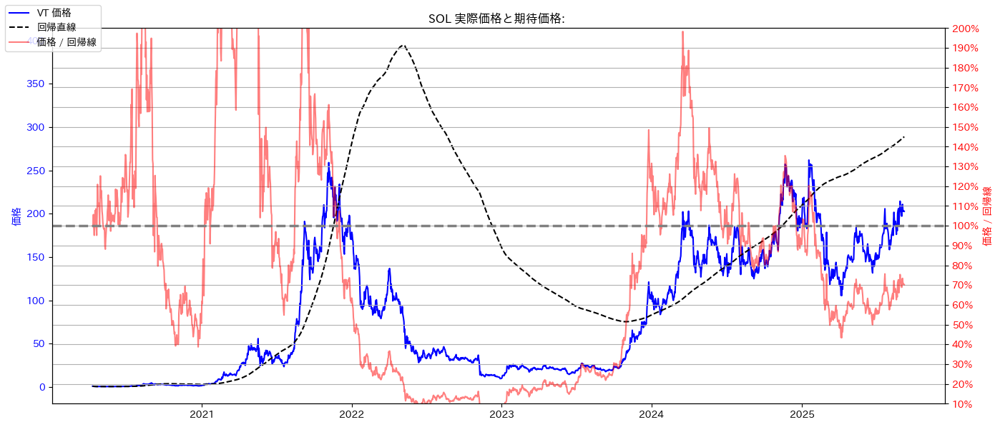

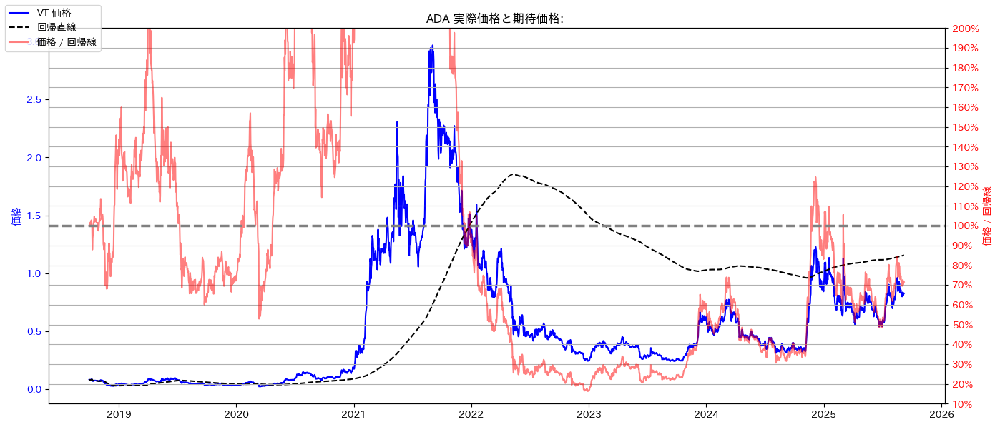

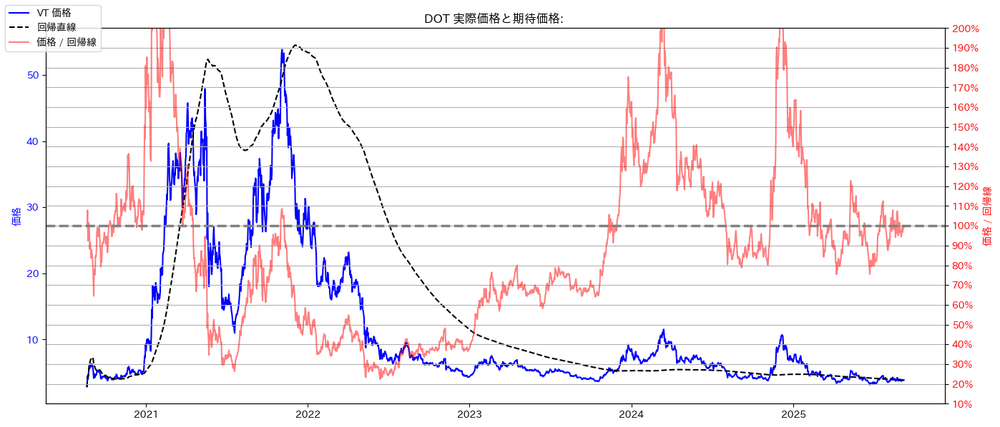

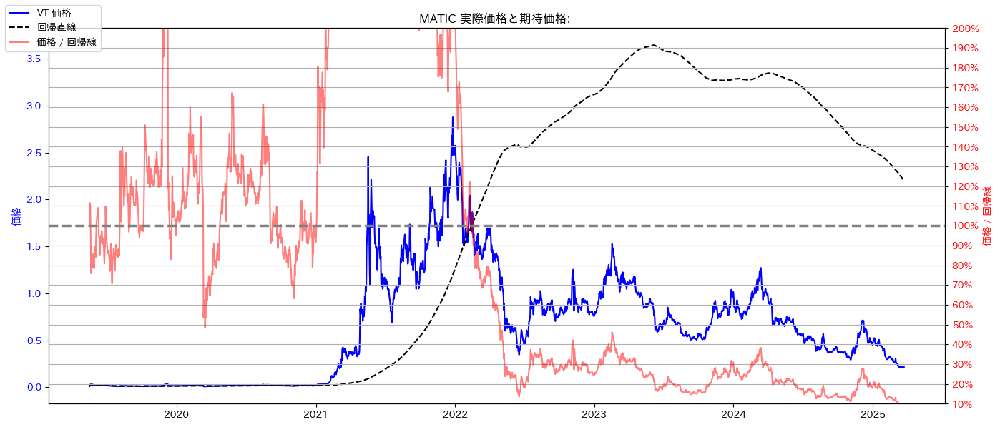

c:\Users\t-miura\Documents\05.portfolio\financial_analytics\.venv\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\t-miura\AppData\Local\Temp\ipykernel_5368\2281356790.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[('log_pred_Close', assets[name]['ticker'])] = np.array(log_trend_list)
C:\Users\t-miura\AppData\Local\Temp\ipykernel_5368\2281356790.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

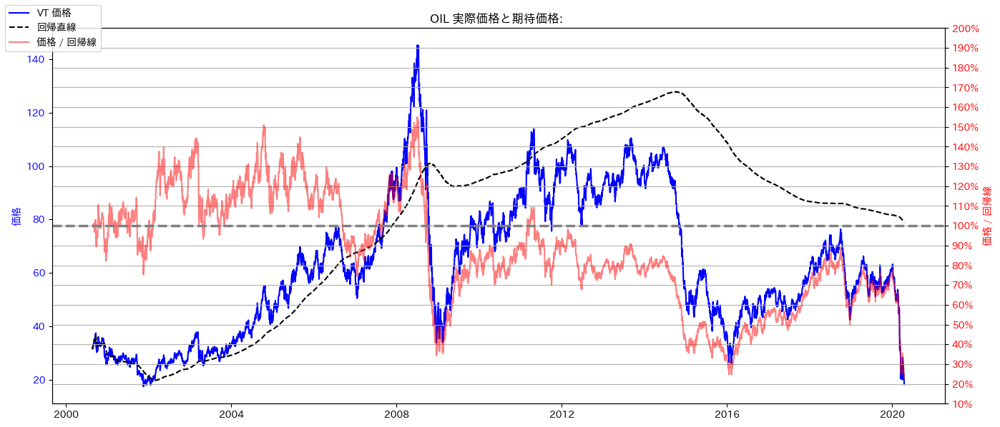

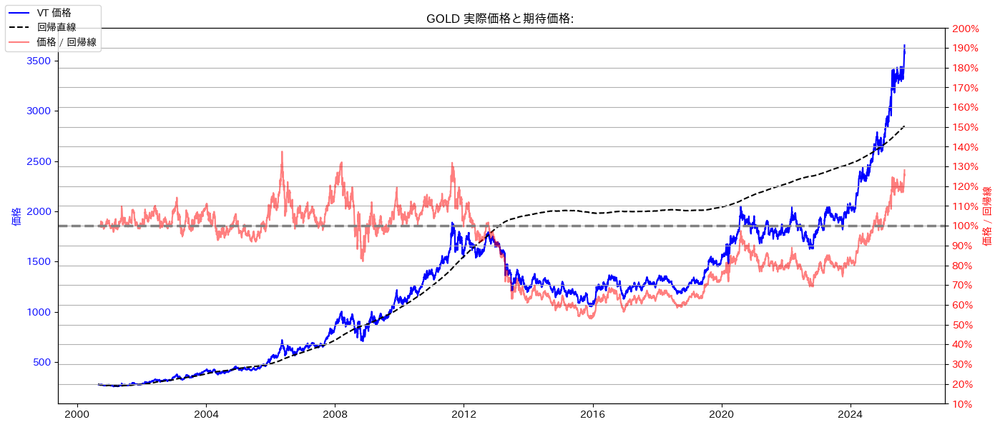

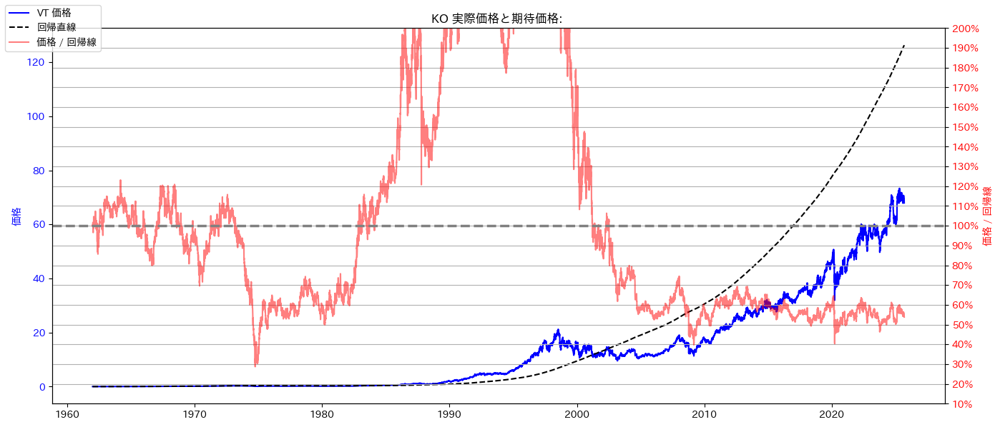

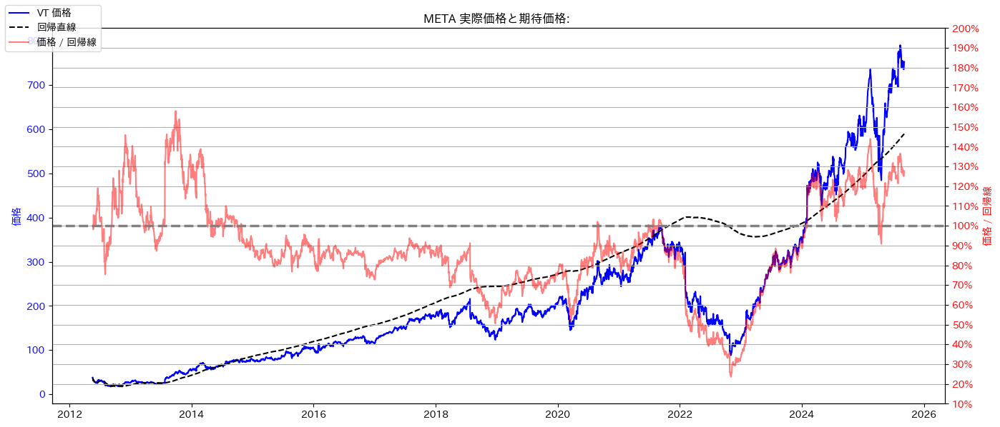

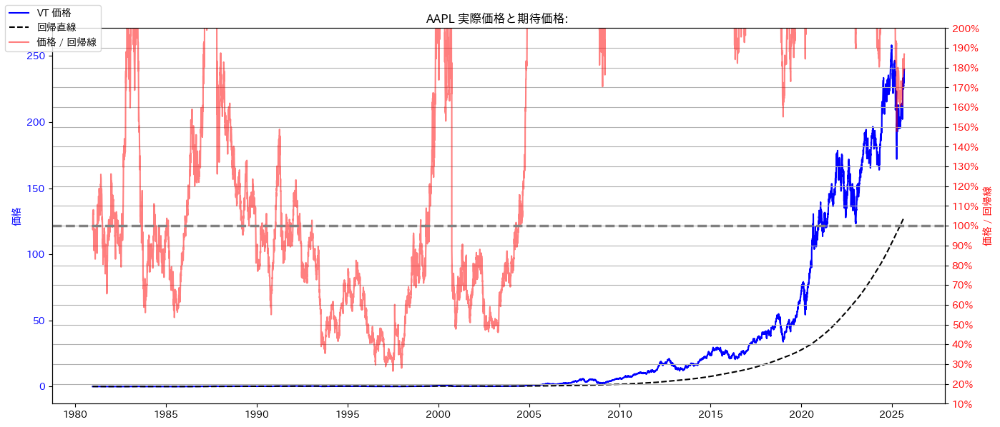

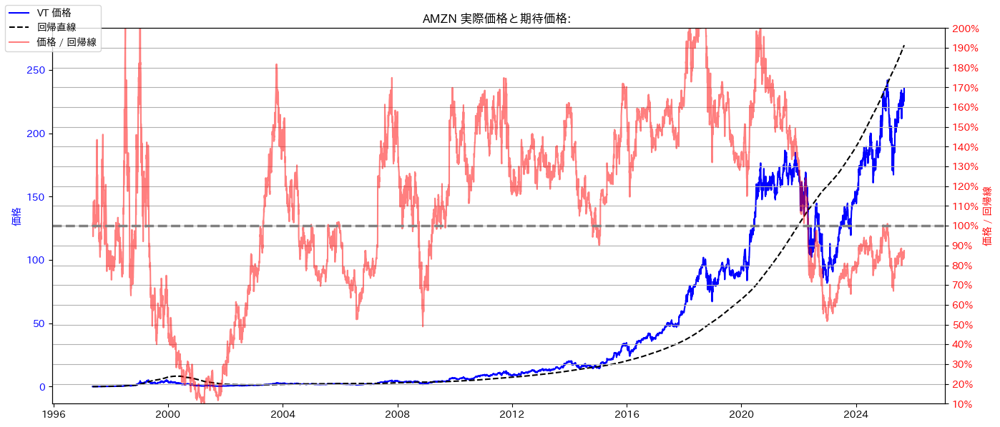

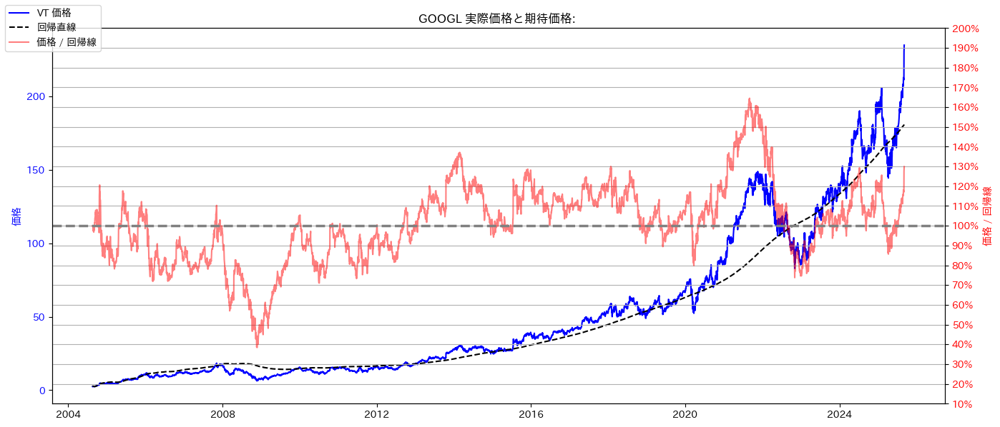

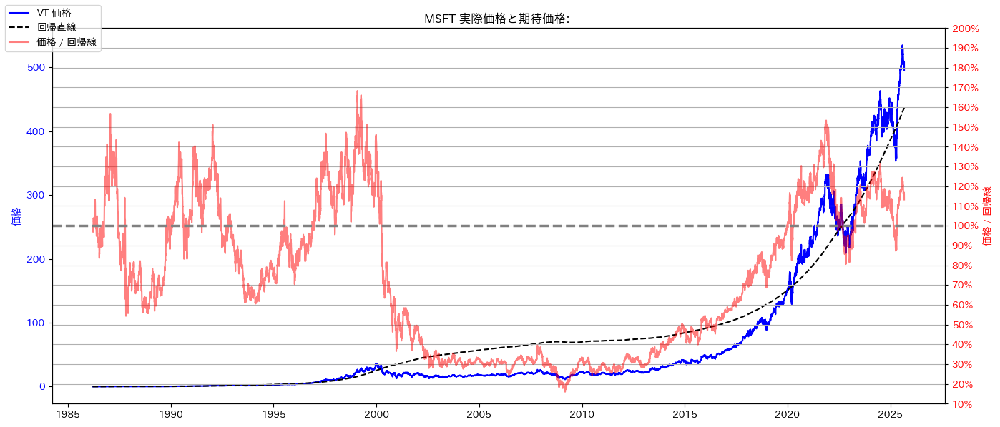

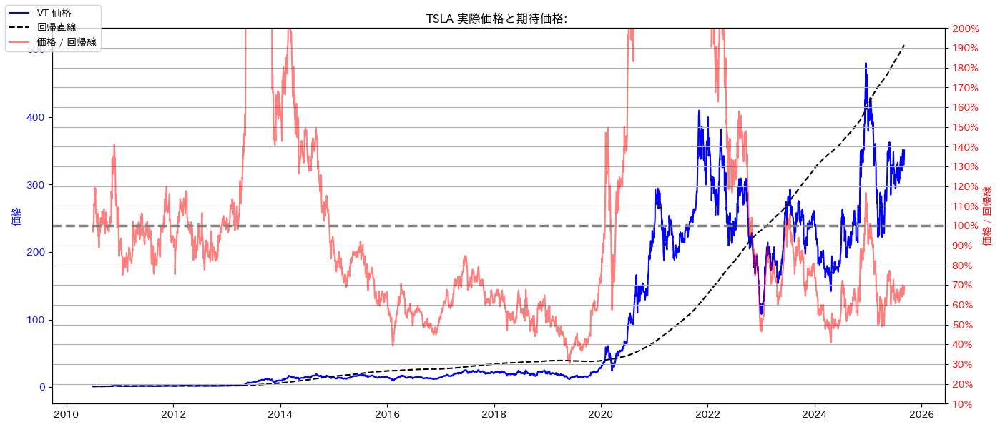

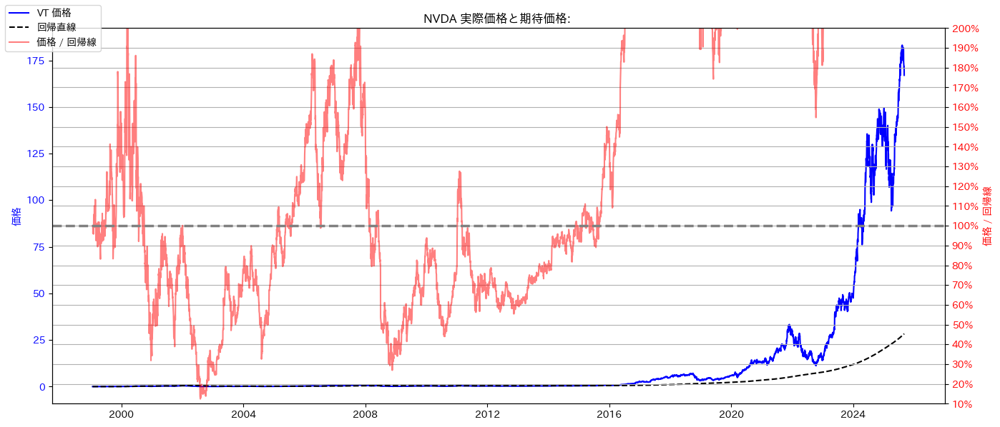

In [ ]:
for name, data in data_dict.items():
    # data = data.copy()
    log_trend_list = []

    # ティッカーも指定して対数価格を取得
    data[('log_Close', assets[name]['ticker'])] = np.log10(data[('Close', assets[name]['ticker'])])#.dropna()
    # nan_rows = data[data.isna().any(axis=1)]
    # print(nan_rows)

    # 原油がマイナス価格(買ったらお金が貰える)だった時があるのでNaNを削除
    data = data.dropna()

    # dates = data['log_Close'].index

    dates = data.index
    # display(data)
    # print(dates)
    x = (dates - dates[0]).days.values  # 日数

    for i in range(len(x)):
        if i < 2:  # 最低日数のしきい値
            log_trend_list.append(data[('log_Close', assets[name]['ticker'])].iloc[i])
            continue

        y = data[('log_Close', assets[name]['ticker'])].iloc[:i + 1].values.ravel()
        slope, intercept, *_ = linregress(x[:i + 1], y)
        trend_today = intercept + slope * x[i]

        log_trend_list.append(trend_today)

    y =data[('log_Close', assets[name]['ticker'])].values.ravel()
    # 回帰直線から予測される価格
    data[('log_pred_Close', assets[name]['ticker'])] = np.array(log_trend_list)

    y_pred = data[('log_pred_Close', assets[name]['ticker'])]

    data_dict[name] = data  # 処理後に上書き保存


    # 対数残差と比
    residuals = y - y_pred
    ratios = 10 ** residuals

    data[('y_to_pred_ratio', assets[name]['ticker'])] = ratios

    fig, ax1 = plt.subplots(figsize=(14, 6))
    ax1.set_title(f'{name} 実際価格と期待価格: ')
    ax1.plot(dates, 10 ** y, label='VT 価格', color='blue')
    ax1.plot(dates, 10 ** y_pred, linestyle='--', label='回帰直線', color='black')
    ax1.set_ylabel('価格', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')

    ax2 = ax1.twinx()
    ax2.plot(dates, ratios, label='価格 / 回帰線', color='red',
            alpha=0.5
            )
    ax2.set_ylabel('価格 / 回帰線', color='red')
    ax2.tick_params(axis='y', labelcolor='red')
    # ここを追加（比率 → %表示に変換）
    ax2.yaxis.set_major_formatter(PercentFormatter(xmax=1.0))
    # 100%ラインを太く目立たせる
    ax2.axhline(1.0, color='gray', linestyle='--', linewidth=2.5,
                # label='100% 基準線'
                )
    # y軸を50〜200%に固定
    ax2.set_ylim(0.1, 2.0)

    # ▼ 0.1刻みの目盛りを設定（0.1〜2.0まで）
    ax2.set_yticks(np.arange(0.1, 2.1, 0.1))  # 2.0まで含めたい場合は 2.1 にしておく

    fig.legend(loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [ ]:
for name, data in data_dict.items():
    # data = data.dropna()
    print(('Close', assets[name]['ticker']) in data.columns)  # True になるべき
    print(('log_Close', assets[name]['ticker']) in data.columns)  # False（まだ追加してないから）

    print(data.columns)
    data[('log_Close', assets[name]['ticker'])] = np.log10(data[('Close', assets[name]['ticker'])])
    print(name)
    display(data.dtypes)
    display(data)
    print(data.index)

True
True
MultiIndex([(          'Close', 'VWO'),
            (           'High', 'VWO'),
            (            'Low', 'VWO'),
            (           'Open', 'VWO'),
            (         'Volume', 'VWO'),
            (      'log_Close', 'VWO'),
            ( 'log_pred_Close', 'VWO'),
            ('y_to_pred_ratio', 'VWO')],
           names=['Price', 'Ticker'])
EMERGING


Price            Ticker
Close            VWO       float64
High             VWO       float64
Low              VWO       float64
Open             VWO       float64
Volume           VWO         int64
log_Close        VWO       float64
log_pred_Close   VWO       float64
y_to_pred_ratio  VWO       float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,VWO,VWO,VWO,VWO,VWO,VWO,VWO,VWO
Date,,,,,,,,
2005-03-10,14.686289,14.785837,14.624803,14.727279,108200,1.166912,1.166912,1.000000
2005-03-11,14.668722,14.823901,14.665795,14.750704,184400,1.166392,1.166392,1.000000
2005-03-14,14.580883,14.671648,14.522325,14.627729,112800,1.163784,1.163824,0.999907
2005-03-15,14.264675,14.452060,14.258819,14.419853,127800,1.154262,1.157611,0.992317
2005-03-16,14.141704,14.279315,14.127064,14.238324,196400,1.150502,1.153049,0.994152
...,...,...,...,...,...,...,...,...
2025-08-29,51.529999,51.590000,51.330002,51.500000,6356500,1.712060,1.657003,1.135161
2025-09-02,51.459999,51.490002,51.009998,51.070000,10064300,1.711470,1.657233,1.133018


DatetimeIndex(['2005-03-10', '2005-03-11', '2005-03-14', '2005-03-15',
               '2005-03-16', '2005-03-17', '2005-03-18', '2005-03-21',
               '2005-03-22', '2005-03-23',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=5156, freq=None)
True
True
MultiIndex([(          'Close', '^GSPC'),
            (           'High', '^GSPC'),
            (            'Low', '^GSPC'),
            (           'Open', '^GSPC'),
            (         'Volume', '^GSPC'),
            (      'log_Close', '^GSPC'),
            ( 'log_pred_Close', '^GSPC'),
            ('y_to_pred_ratio', '^GSPC')],
           names=['Price', 'Ticker'])
SP500


Price            Ticker
Close            ^GSPC     float64
High             ^GSPC     float64
Low              ^GSPC     float64
Open             ^GSPC     float64
Volume           ^GSPC       int64
log_Close        ^GSPC     float64
log_pred_Close   ^GSPC     float64
y_to_pred_ratio  ^GSPC     float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,^GSPC,^GSPC,^GSPC,^GSPC,^GSPC,^GSPC,^GSPC,^GSPC
Date,,,,,,,,
1927-12-30,17.660000,17.660000,17.660000,17.660000,0,1.246991,1.246991,1.000000
1928-01-03,17.760000,17.760000,17.760000,17.760000,0,1.249443,1.249443,1.000000
1928-01-04,17.719999,17.719999,17.719999,17.719999,0,1.248464,1.249070,0.998604
1928-01-05,17.549999,17.549999,17.549999,17.549999,0,1.244277,1.246898,0.993984
1928-01-06,17.660000,17.660000,17.660000,17.660000,0,1.246991,1.246838,1.000352
...,...,...,...,...,...,...,...,...
2025-08-29,6460.259766,6491.759766,6444.569824,6489.279785,4234840000,3.810250,3.594675,1.642762
2025-09-02,6415.540039,6416.540039,6360.580078,6401.509766,4784000000,3.807233,3.595027,1.630069


DatetimeIndex(['1927-12-30', '1928-01-03', '1928-01-04', '1928-01-05',
               '1928-01-06', '1928-01-09', '1928-01-10', '1928-01-11',
               '1928-01-12', '1928-01-13',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=24536, freq=None)
True
True
MultiIndex([(          'Close', 'VOO'),
            (           'High', 'VOO'),
            (            'Low', 'VOO'),
            (           'Open', 'VOO'),
            (         'Volume', 'VOO'),
            (      'log_Close', 'VOO'),
            ( 'log_pred_Close', 'VOO'),
            ('y_to_pred_ratio', 'VOO')],
           names=['Price', 'Ticker'])
SP500_TR


Price            Ticker
Close            VOO       float64
High             VOO       float64
Low              VOO       float64
Open             VOO       float64
Volume           VOO         int64
log_Close        VOO       float64
log_pred_Close   VOO       float64
y_to_pred_ratio  VOO       float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,VOO,VOO,VOO,VOO,VOO,VOO,VOO,VOO
Date,,,,,,,,
2010-09-09,77.214409,78.113669,77.077233,78.113669,26500,1.887698,1.887698,1.000000
2010-09-10,77.564957,77.625925,77.199159,77.488749,8600,1.889666,1.889666,1.000000
2010-09-13,78.540474,78.601442,78.113708,78.464267,33750,1.895094,1.895112,0.999958
2010-09-14,78.525215,78.860534,78.022236,78.372795,59400,1.895009,1.895752,0.998291
2010-09-15,78.723373,78.784336,78.037496,78.205155,9250,1.896104,1.896714,0.998596
...,...,...,...,...,...,...,...,...
2025-08-29,593.080017,595.549988,591.250000,595.239990,7512000,2.773113,2.738711,1.082437
2025-09-02,588.710022,588.799988,583.669983,586.059998,11116700,2.769901,2.739342,1.072901


DatetimeIndex(['2010-09-09', '2010-09-10', '2010-09-13', '2010-09-14',
               '2010-09-15', '2010-09-16', '2010-09-17', '2010-09-20',
               '2010-09-21', '2010-09-22',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=3771, freq=None)
True
True
MultiIndex([(          'Close', '^N225'),
            (           'High', '^N225'),
            (            'Low', '^N225'),
            (           'Open', '^N225'),
            (         'Volume', '^N225'),
            (      'log_Close', '^N225'),
            ( 'log_pred_Close', '^N225'),
            ('y_to_pred_ratio', '^N225')],
           names=['Price', 'Ticker'])
NIKKEI


Price            Ticker
Close            ^N225     float64
High             ^N225     float64
Low              ^N225     float64
Open             ^N225     float64
Volume           ^N225       int64
log_Close        ^N225     float64
log_pred_Close   ^N225     float64
y_to_pred_ratio  ^N225     float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,^N225,^N225,^N225,^N225,^N225,^N225,^N225,^N225
Date,,,,,,,,
1965-01-05,1257.719971,1257.719971,1257.719971,1257.719971,0,3.099584,3.099584,1.000000
1965-01-06,1263.989990,1263.989990,1263.989990,1263.989990,0,3.101744,3.101744,1.000000
1965-01-07,1274.270020,1274.270020,1274.270020,1274.270020,0,3.105261,3.105035,1.000521
1965-01-08,1286.430054,1286.430054,1286.430054,1286.430054,0,3.109386,3.108932,1.001045
1965-01-12,1288.540039,1288.540039,1288.540039,1288.540039,0,3.110098,3.111742,0.996221
...,...,...,...,...,...,...,...,...
2025-09-01,42188.789062,42454.988281,41835.171875,42362.710938,96600000,4.625197,4.532318,1.238452
2025-09-02,42310.488281,42473.671875,42084.781250,42299.628906,99800000,4.626448,4.532389,1.241822


DatetimeIndex(['1965-01-05', '1965-01-06', '1965-01-07', '1965-01-08',
               '1965-01-12', '1965-01-13', '1965-01-14', '1965-01-18',
               '1965-01-19', '1965-01-20',
               ...
               '2025-08-25', '2025-08-26', '2025-08-27', '2025-08-28',
               '2025-08-29', '2025-09-01', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=14919, freq=None)
True
True
MultiIndex([(          'Close', 'QQQM'),
            (           'High', 'QQQM'),
            (            'Low', 'QQQM'),
            (           'Open', 'QQQM'),
            (         'Volume', 'QQQM'),
            (      'log_Close', 'QQQM'),
            ( 'log_pred_Close', 'QQQM'),
            ('y_to_pred_ratio', 'QQQM')],
           names=['Price', 'Ticker'])
NASDAQ100_QQQM


Price            Ticker
Close            QQQM      float64
High             QQQM      float64
Low              QQQM      float64
Open             QQQM      float64
Volume           QQQM        int64
log_Close        QQQM      float64
log_pred_Close   QQQM      float64
y_to_pred_ratio  QQQM      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,QQQM,QQQM,QQQM,QQQM,QQQM,QQQM,QQQM,QQQM
Date,,,,,,,,
2020-10-13,117.389000,118.281174,116.913814,117.418091,13100,2.069627,2.069627,1.000000
2020-10-14,116.341660,118.037764,115.758838,117.660529,37800,2.065735,2.065735,1.000000
2020-10-15,115.504761,115.672525,114.226621,114.460330,30600,2.062600,2.062474,1.000290
2020-10-16,114.916107,116.768345,114.916107,116.273767,51000,2.060381,2.059955,1.000982
2020-10-19,112.928101,116.205881,112.719607,116.205881,50600,2.052802,2.052404,1.000917
...,...,...,...,...,...,...,...,...
2025-08-29,234.809998,236.690002,234.059998,236.550003,3796500,2.370717,2.313459,1.140927
2025-09-02,232.850006,232.960007,230.369995,231.070007,3856900,2.367076,2.314214,1.129437


DatetimeIndex(['2020-10-13', '2020-10-14', '2020-10-15', '2020-10-16',
               '2020-10-19', '2020-10-20', '2020-10-21', '2020-10-22',
               '2020-10-23', '2020-10-26',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=1230, freq=None)
True
True
MultiIndex([(          'Close', 'QQQ'),
            (           'High', 'QQQ'),
            (            'Low', 'QQQ'),
            (           'Open', 'QQQ'),
            (         'Volume', 'QQQ'),
            (      'log_Close', 'QQQ'),
            ( 'log_pred_Close', 'QQQ'),
            ('y_to_pred_ratio', 'QQQ')],
           names=['Price', 'Ticker'])
NASDAQ100_QQQ


Price            Ticker
Close            QQQ       float64
High             QQQ       float64
Low              QQQ       float64
Open             QQQ       float64
Volume           QQQ         int64
log_Close        QQQ       float64
log_pred_Close   QQQ       float64
y_to_pred_ratio  QQQ       float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,QQQ,QQQ,QQQ,QQQ,QQQ,QQQ,QQQ,QQQ
Date,,,,,,,,
1999-10-04,52.124569,52.309783,50.960365,51.251416,12434200,1.717042,1.717042,1.000000
1999-10-05,52.495010,53.130031,51.383725,52.309796,19526400,1.720118,1.720118,1.000000
1999-10-06,53.546753,53.626130,52.012121,52.812511,19098200,1.728733,1.727810,1.002128
1999-10-07,53.421074,54.102398,53.024186,53.844421,22013600,1.727713,1.729495,0.995903
1999-10-08,53.983315,54.135455,52.494986,53.209384,22523200,1.732260,1.732779,0.998805
...,...,...,...,...,...,...,...,...
2025-08-29,570.400024,575.030029,568.539978,574.659973,56030400,2.756180,2.557100,1.581537
2025-09-02,565.619995,565.969971,559.539978,561.309998,65876800,2.752525,2.557760,1.565902


DatetimeIndex(['1999-10-04', '1999-10-05', '1999-10-06', '1999-10-07',
               '1999-10-08', '1999-10-11', '1999-10-12', '1999-10-13',
               '1999-10-14', '1999-10-15',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=6521, freq=None)
True
True
MultiIndex([(          'Close', '1329.T'),
            (           'High', '1329.T'),
            (            'Low', '1329.T'),
            (           'Open', '1329.T'),
            (         'Volume', '1329.T'),
            (      'log_Close', '1329.T'),
            ( 'log_pred_Close', '1329.T'),
            ('y_to_pred_ratio', '1329.T')],
           names=['Price', 'Ticker'])
NIKKEI_TR


Price            Ticker
Close            1329.T    float64
High             1329.T    float64
Low              1329.T    float64
Open             1329.T    float64
Volume           1329.T      int64
log_Close        1329.T    float64
log_pred_Close   1329.T    float64
y_to_pred_ratio  1329.T    float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,1329.T,1329.T,1329.T,1329.T,1329.T,1329.T,1329.T,1329.T
Date,,,,,,,,
2009-01-05,7584.192871,7717.982381,7584.192871,7717.982381,1380,3.879909,3.879909,1.000000
2009-01-06,7600.916504,7667.811259,7600.916504,7651.087570,2110,3.880866,3.880866,1.000000
2009-01-07,7734.707031,7809.963640,7717.983340,7784.878104,5000,3.888444,3.887340,1.002544
2009-01-08,7517.297363,7592.553955,7500.573676,7592.553955,4900,3.876062,3.880725,0.989319
2009-01-09,7559.107910,7559.107910,7442.042080,7442.042080,1890,3.878471,3.879214,0.998290
...,...,...,...,...,...,...,...,...
2025-09-01,4359.000000,4385.000000,4322.000000,4374.000000,376469,3.639387,3.300421,2.182560
2025-09-02,4372.000000,4389.000000,4349.000000,4374.000000,239701,3.640680,3.300676,2.187783


DatetimeIndex(['2009-01-05', '2009-01-06', '2009-01-07', '2009-01-08',
               '2009-01-09', '2009-01-13', '2009-01-14', '2009-01-15',
               '2009-01-16', '2009-01-19',
               ...
               '2025-08-25', '2025-08-26', '2025-08-27', '2025-08-28',
               '2025-08-29', '2025-09-01', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=4096, freq=None)
True
True
MultiIndex([(          'Close', 'TLT'),
            (           'High', 'TLT'),
            (            'Low', 'TLT'),
            (           'Open', 'TLT'),
            (         'Volume', 'TLT'),
            (      'log_Close', 'TLT'),
            ( 'log_pred_Close', 'TLT'),
            ('y_to_pred_ratio', 'TLT')],
           names=['Price', 'Ticker'])
BOND


Price            Ticker
Close            TLT       float64
High             TLT       float64
Low              TLT       float64
Open             TLT       float64
Volume           TLT         int64
log_Close        TLT       float64
log_pred_Close   TLT       float64
y_to_pred_ratio  TLT       float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,TLT,TLT,TLT,TLT,TLT,TLT,TLT,TLT
Date,,,,,,,,
2002-07-30,37.184662,37.357998,37.184662,37.289576,6100,1.570364,1.570364,1.000000
2002-07-31,37.645351,37.768512,37.357984,37.380789,29400,1.575711,1.575711,1.000000
2002-08-01,37.859764,37.868885,37.649939,37.649939,25000,1.578178,1.578658,0.998895
2002-08-02,38.247501,38.361537,37.805043,37.932766,52800,1.582603,1.582592,1.000026
2002-08-05,38.416225,38.516577,38.247452,38.334120,61100,1.584515,1.586370,0.995737
...,...,...,...,...,...,...,...,...
2025-08-29,86.272003,86.531021,86.112613,86.431401,41686400,1.935870,2.113910,0.663681
2025-09-02,85.629997,85.839996,85.480003,85.629997,48760600,1.932626,2.114006,0.658597


DatetimeIndex(['2002-07-30', '2002-07-31', '2002-08-01', '2002-08-02',
               '2002-08-05', '2002-08-06', '2002-08-07', '2002-08-08',
               '2002-08-09', '2002-08-12',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=5814, freq=None)
True
True
MultiIndex([(          'Close', 'VT'),
            (           'High', 'VT'),
            (            'Low', 'VT'),
            (           'Open', 'VT'),
            (         'Volume', 'VT'),
            (      'log_Close', 'VT'),
            ( 'log_pred_Close', 'VT'),
            ('y_to_pred_ratio', 'VT')],
           names=['Price', 'Ticker'])
ALL_WORLD


Price            Ticker
Close            VT        float64
High             VT        float64
Low              VT        float64
Open             VT        float64
Volume           VT          int64
log_Close        VT        float64
log_pred_Close   VT        float64
y_to_pred_ratio  VT        float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,VT,VT,VT,VT,VT,VT,VT,VT
Date,,,,,,,,
2008-06-26,34.468811,34.753849,34.301958,34.705182,15800,1.537426,1.537426,1.000000
2008-06-27,34.413204,35.768876,34.246351,35.768876,26800,1.536725,1.536725,1.000000
2008-06-30,34.440998,35.956569,34.315859,35.956569,23900,1.537076,1.536981,1.000217
2008-07-01,34.135109,34.482717,33.189617,34.155967,55100,1.533201,1.534631,0.996713
2008-07-02,33.634552,34.545283,33.634552,34.441002,74700,1.526786,1.530467,0.991558
...,...,...,...,...,...,...,...,...
2025-08-29,133.770004,134.100006,133.429993,134.029999,4013100,2.126359,2.077023,1.120304
2025-09-02,132.809998,132.860001,131.889999,132.309998,2749600,2.123231,2.077496,1.111052


DatetimeIndex(['2008-06-26', '2008-06-27', '2008-06-30', '2008-07-01',
               '2008-07-02', '2008-07-03', '2008-07-07', '2008-07-08',
               '2008-07-09', '2008-07-10',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=4326, freq=None)
True
True
MultiIndex([(          'Close', 'INDA'),
            (           'High', 'INDA'),
            (            'Low', 'INDA'),
            (           'Open', 'INDA'),
            (         'Volume', 'INDA'),
            (      'log_Close', 'INDA'),
            ( 'log_pred_Close', 'INDA'),
            ('y_to_pred_ratio', 'INDA')],
           names=['Price', 'Ticker'])
INDIA


Price            Ticker
Close            INDA      float64
High             INDA      float64
Low              INDA      float64
Open             INDA      float64
Volume           INDA        int64
log_Close        INDA      float64
log_pred_Close   INDA      float64
y_to_pred_ratio  INDA      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,INDA,INDA,INDA,INDA,INDA,INDA,INDA,INDA
Date,,,,,,,,
2012-02-03,23.198490,23.198490,23.198490,23.198490,100,1.365460,1.365460,1.000000
2012-02-06,23.016167,23.997240,22.946710,23.997240,4100,1.362033,1.362033,1.000000
2012-02-07,22.807800,22.807800,22.799118,22.799118,2300,1.358083,1.359055,0.997765
2012-02-08,23.059574,23.988555,22.920661,23.988555,3700,1.362851,1.360308,1.005874
2012-02-09,22.998806,23.120354,22.998806,23.120354,2500,1.361705,1.360492,1.002798
...,...,...,...,...,...,...,...,...
2025-08-29,51.980000,52.009998,51.830002,52.000000,4761600,1.715836,1.717330,0.996566
2025-09-02,52.349998,52.400002,52.099998,52.110001,5577800,1.718917,1.717678,1.002856


DatetimeIndex(['2012-02-03', '2012-02-06', '2012-02-07', '2012-02-08',
               '2012-02-09', '2012-02-10', '2012-02-13', '2012-02-14',
               '2012-02-15', '2012-02-16',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=3417, freq=None)
True
True
MultiIndex([(          'Close', 'MCHI'),
            (           'High', 'MCHI'),
            (            'Low', 'MCHI'),
            (           'Open', 'MCHI'),
            (         'Volume', 'MCHI'),
            (      'log_Close', 'MCHI'),
            ( 'log_pred_Close', 'MCHI'),
            ('y_to_pred_ratio', 'MCHI')],
           names=['Price', 'Ticker'])
CHINA


Price            Ticker
Close            MCHI      float64
High             MCHI      float64
Low              MCHI      float64
Open             MCHI      float64
Volume           MCHI        int64
log_Close        MCHI      float64
log_pred_Close   MCHI      float64
y_to_pred_ratio  MCHI      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,MCHI,MCHI,MCHI,MCHI,MCHI,MCHI,MCHI,MCHI
Date,,,,,,,,
2011-03-31,38.761551,38.798893,38.530026,38.604710,14200,1.588401,1.588401,1.000000
2011-04-01,39.299282,39.373969,39.232065,39.269410,2900,1.594385,1.594385,1.000000
2011-04-04,40.135761,40.165633,39.672712,40.165633,10500,1.603532,1.603870,0.999221
2011-04-05,39.896767,40.001328,39.881832,39.956516,3700,1.600938,1.603440,0.994254
2011-04-06,40.098415,40.307536,39.978919,40.300065,4700,1.603127,1.604631,0.996543
...,...,...,...,...,...,...,...,...
2025-08-29,61.310001,61.450001,60.860001,60.910000,4727100,1.787531,1.753807,1.080748
2025-09-02,61.639999,61.669998,60.730000,60.889999,3852200,1.789863,1.753997,1.086090


DatetimeIndex(['2011-03-31', '2011-04-01', '2011-04-04', '2011-04-05',
               '2011-04-06', '2011-04-07', '2011-04-08', '2011-04-11',
               '2011-04-12', '2011-04-13',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=3630, freq=None)
True
True
MultiIndex([(          'Close', 'BTC-USD'),
            (           'High', 'BTC-USD'),
            (            'Low', 'BTC-USD'),
            (           'Open', 'BTC-USD'),
            (         'Volume', 'BTC-USD'),
            (      'log_Close', 'BTC-USD'),
            ( 'log_pred_Close', 'BTC-USD'),
            ('y_to_pred_ratio', 'BTC-USD')],
           names=['Price', 'Ticker'])
BTC


Price            Ticker 
Close            BTC-USD    float64
High             BTC-USD    float64
Low              BTC-USD    float64
Open             BTC-USD    float64
Volume           BTC-USD      int64
log_Close        BTC-USD    float64
log_pred_Close   BTC-USD    float64
y_to_pred_ratio  BTC-USD    float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD
Date,,,,,,,,
2014-09-17,457.334015,468.174011,452.421997,465.864014,21056800,2.660234,2.660234,1.000000
2014-09-18,424.440002,456.859985,413.104004,456.859985,34483200,2.627816,2.627816,1.000000
2014-09-19,394.795990,427.834991,384.532013,424.102997,37919700,2.596373,2.596210,1.000374
2014-09-20,408.903992,423.295990,389.882996,394.673004,36863600,2.611621,2.597419,1.033243
2014-09-21,398.821014,412.425995,393.181000,408.084991,26580100,2.600778,2.592343,1.019612
...,...,...,...,...,...,...,...,...
2025-09-02,111200.585938,111748.015625,108454.031250,109243.070312,74776999491,5.046107,5.230369,0.654242
2025-09-03,111723.210938,112600.226562,110582.960938,111190.695312,61119643565,5.048143,5.230850,0.656588


DatetimeIndex(['2014-09-17', '2014-09-18', '2014-09-19', '2014-09-20',
               '2014-09-21', '2014-09-22', '2014-09-23', '2014-09-24',
               '2014-09-25', '2014-09-26',
               ...
               '2025-08-28', '2025-08-29', '2025-08-30', '2025-08-31',
               '2025-09-01', '2025-09-02', '2025-09-03', '2025-09-04',
               '2025-09-05', '2025-09-07'],
              dtype='datetime64[ns]', name='Date', length=4008, freq=None)
True
True
MultiIndex([(          'Close', 'ETH-USD'),
            (           'High', 'ETH-USD'),
            (            'Low', 'ETH-USD'),
            (           'Open', 'ETH-USD'),
            (         'Volume', 'ETH-USD'),
            (      'log_Close', 'ETH-USD'),
            ( 'log_pred_Close', 'ETH-USD'),
            ('y_to_pred_ratio', 'ETH-USD')],
           names=['Price', 'Ticker'])
ETH


Price            Ticker 
Close            ETH-USD    float64
High             ETH-USD    float64
Low              ETH-USD    float64
Open             ETH-USD    float64
Volume           ETH-USD      int64
log_Close        ETH-USD    float64
log_pred_Close   ETH-USD    float64
y_to_pred_ratio  ETH-USD    float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,ETH-USD,ETH-USD,ETH-USD,ETH-USD,ETH-USD,ETH-USD,ETH-USD,ETH-USD
Date,,,,,,,,
2017-11-09,320.884003,329.451996,307.056000,308.644989,893249984,2.506348,2.506348,1.000000
2017-11-10,299.252991,324.717987,294.541992,320.670990,885985984,2.476038,2.476038,1.000000
2017-11-11,314.681000,319.453003,298.191986,298.585999,842300992,2.497871,2.489180,1.020212
2017-11-12,307.907990,319.153015,298.513000,314.690002,1613479936,2.488421,2.487377,1.002406
2017-11-13,316.716003,328.415009,307.024994,307.024994,1041889984,2.500670,2.494075,1.015302
...,...,...,...,...,...,...,...,...
2025-09-02,4325.365723,4414.934082,4260.459473,4314.391113,39884692334,3.636023,3.654756,0.957782
2025-09-03,4450.389160,4489.198730,4286.206055,4324.696289,35260873497,3.648398,3.655212,0.984432


DatetimeIndex(['2017-11-09', '2017-11-10', '2017-11-11', '2017-11-12',
               '2017-11-13', '2017-11-14', '2017-11-15', '2017-11-16',
               '2017-11-17', '2017-11-18',
               ...
               '2025-08-28', '2025-08-29', '2025-08-30', '2025-08-31',
               '2025-09-01', '2025-09-02', '2025-09-03', '2025-09-04',
               '2025-09-05', '2025-09-07'],
              dtype='datetime64[ns]', name='Date', length=2859, freq=None)
True
True
MultiIndex([(          'Close', 'XRP-USD'),
            (           'High', 'XRP-USD'),
            (            'Low', 'XRP-USD'),
            (           'Open', 'XRP-USD'),
            (         'Volume', 'XRP-USD'),
            (      'log_Close', 'XRP-USD'),
            ( 'log_pred_Close', 'XRP-USD'),
            ('y_to_pred_ratio', 'XRP-USD')],
           names=['Price', 'Ticker'])
XRP


Price            Ticker 
Close            XRP-USD    float64
High             XRP-USD    float64
Low              XRP-USD    float64
Open             XRP-USD    float64
Volume           XRP-USD      int64
log_Close        XRP-USD    float64
log_pred_Close   XRP-USD    float64
y_to_pred_ratio  XRP-USD    float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,XRP-USD,XRP-USD,XRP-USD,XRP-USD,XRP-USD,XRP-USD,XRP-USD,XRP-USD
Date,,,,,,,,
2017-11-09,0.217488,0.221791,0.214866,0.217911,147916992,-0.662565,-0.662565,1.000000
2017-11-10,0.206483,0.219068,0.205260,0.218256,141032992,-0.685116,-0.685116,1.000000
2017-11-11,0.210430,0.214456,0.205459,0.205948,134503008,-0.676892,-0.682021,1.011880
2017-11-12,0.197339,0.210214,0.195389,0.210214,251175008,-0.704787,-0.700107,0.989280
2017-11-13,0.203442,0.204081,0.197456,0.197472,132567000,-0.691559,-0.699716,1.018959
...,...,...,...,...,...,...,...,...
2025-09-02,2.861859,2.862517,2.750748,2.753838,7493678799,0.456648,-0.002527,2.878557
2025-09-03,2.844895,2.884850,2.814042,2.861848,4435438842,0.454066,-0.001704,2.856079


DatetimeIndex(['2017-11-09', '2017-11-10', '2017-11-11', '2017-11-12',
               '2017-11-13', '2017-11-14', '2017-11-15', '2017-11-16',
               '2017-11-17', '2017-11-18',
               ...
               '2025-08-28', '2025-08-29', '2025-08-30', '2025-08-31',
               '2025-09-01', '2025-09-02', '2025-09-03', '2025-09-04',
               '2025-09-05', '2025-09-07'],
              dtype='datetime64[ns]', name='Date', length=2859, freq=None)
True
True
MultiIndex([(          'Close', 'SOL-USD'),
            (           'High', 'SOL-USD'),
            (            'Low', 'SOL-USD'),
            (           'Open', 'SOL-USD'),
            (         'Volume', 'SOL-USD'),
            (      'log_Close', 'SOL-USD'),
            ( 'log_pred_Close', 'SOL-USD'),
            ('y_to_pred_ratio', 'SOL-USD')],
           names=['Price', 'Ticker'])
SOL


Price            Ticker 
Close            SOL-USD    float64
High             SOL-USD    float64
Low              SOL-USD    float64
Open             SOL-USD    float64
Volume           SOL-USD      int64
log_Close        SOL-USD    float64
log_pred_Close   SOL-USD    float64
y_to_pred_ratio  SOL-USD    float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,SOL-USD,SOL-USD,SOL-USD,SOL-USD,SOL-USD,SOL-USD,SOL-USD,SOL-USD
Date,,,,,,,,
2020-04-10,0.951054,1.313487,0.694187,0.832005,87364276,-0.021795,-0.021795,1.000000
2020-04-11,0.776819,1.049073,0.765020,0.951054,43862444,-0.109680,-0.109680,1.000000
2020-04-12,0.882507,0.956670,0.762426,0.785448,38736897,-0.054282,-0.078162,1.056527
2020-04-13,0.777832,0.891603,0.773976,0.890760,18211285,-0.109114,-0.104702,0.989891
2020-04-14,0.661925,0.796472,0.628169,0.777832,16747614,-0.179191,-0.157658,0.951627
...,...,...,...,...,...,...,...,...
2025-09-02,209.481537,209.481537,197.093658,197.109589,8625200488,2.321146,2.457367,0.730767
2025-09-03,210.746307,212.823517,207.584076,209.482788,6966454259,2.323760,2.457996,0.734115


DatetimeIndex(['2020-04-10', '2020-04-11', '2020-04-12', '2020-04-13',
               '2020-04-14', '2020-04-15', '2020-04-16', '2020-04-17',
               '2020-04-18', '2020-04-19',
               ...
               '2025-08-28', '2025-08-29', '2025-08-30', '2025-08-31',
               '2025-09-01', '2025-09-02', '2025-09-03', '2025-09-04',
               '2025-09-05', '2025-09-07'],
              dtype='datetime64[ns]', name='Date', length=1976, freq=None)
True
True
MultiIndex([(          'Close', 'ADA-USD'),
            (           'High', 'ADA-USD'),
            (            'Low', 'ADA-USD'),
            (           'Open', 'ADA-USD'),
            (         'Volume', 'ADA-USD'),
            (      'log_Close', 'ADA-USD'),
            ( 'log_pred_Close', 'ADA-USD'),
            ('y_to_pred_ratio', 'ADA-USD')],
           names=['Price', 'Ticker'])
ADA


Price            Ticker 
Close            ADA-USD    float64
High             ADA-USD    float64
Low              ADA-USD    float64
Open             ADA-USD    float64
Volume           ADA-USD      int64
log_Close        ADA-USD    float64
log_pred_Close   ADA-USD    float64
y_to_pred_ratio  ADA-USD    float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,ADA-USD,ADA-USD,ADA-USD,ADA-USD,ADA-USD,ADA-USD,ADA-USD,ADA-USD
Date,,,,,,,,
2018-10-01,0.084469,0.085806,0.082636,0.085292,42076400,-1.073303,-1.073303,1.000000
2018-10-02,0.082525,0.084681,0.082388,0.084604,34775200,-1.083414,-1.083414,1.000000
2018-10-03,0.080789,0.082405,0.079175,0.082032,38063700,-1.092648,-1.092794,1.000337
2018-10-04,0.081304,0.082789,0.080534,0.080818,31665100,-1.089888,-1.093662,1.008727
2018-10-05,0.082991,0.083091,0.080690,0.081381,31160900,-1.080969,-1.088406,1.017271
...,...,...,...,...,...,...,...,...
2025-09-02,0.834581,0.834733,0.799329,0.800190,1225760452,-0.078531,0.061579,0.724252
2025-09-03,0.836530,0.843014,0.827355,0.834580,873946795,-0.077518,0.061828,0.725526


DatetimeIndex(['2018-10-01', '2018-10-02', '2018-10-03', '2018-10-04',
               '2018-10-05', '2018-10-06', '2018-10-07', '2018-10-08',
               '2018-10-09', '2018-10-10',
               ...
               '2025-08-28', '2025-08-29', '2025-08-30', '2025-08-31',
               '2025-09-01', '2025-09-02', '2025-09-03', '2025-09-04',
               '2025-09-05', '2025-09-07'],
              dtype='datetime64[ns]', name='Date', length=2533, freq=None)
True
True
MultiIndex([(          'Close', 'DOT-USD'),
            (           'High', 'DOT-USD'),
            (            'Low', 'DOT-USD'),
            (           'Open', 'DOT-USD'),
            (         'Volume', 'DOT-USD'),
            (      'log_Close', 'DOT-USD'),
            ( 'log_pred_Close', 'DOT-USD'),
            ('y_to_pred_ratio', 'DOT-USD')],
           names=['Price', 'Ticker'])
DOT


Price            Ticker 
Close            DOT-USD    float64
High             DOT-USD    float64
Low              DOT-USD    float64
Open             DOT-USD    float64
Volume           DOT-USD      int64
log_Close        DOT-USD    float64
log_pred_Close   DOT-USD    float64
y_to_pred_ratio  DOT-USD    float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,DOT-USD,DOT-USD,DOT-USD,DOT-USD,DOT-USD,DOT-USD,DOT-USD,DOT-USD
Date,,,,,,,,
2020-08-20,2.900080,3.077784,2.692896,2.787857,48819867,0.462410,0.462410,1.000000
2020-08-21,2.875028,3.090093,2.730919,2.896923,49313137,0.458642,0.458642,1.000000
2020-08-22,4.484690,4.510613,2.816762,2.878570,485801096,0.651732,0.618923,1.078474
2020-08-23,3.967066,4.487058,3.716271,4.487058,320749483,0.598469,0.633004,0.923561
2020-08-24,4.602614,4.783158,3.812670,3.987413,407690171,0.663005,0.675055,0.972634
...,...,...,...,...,...,...,...,...
2025-09-02,3.817001,3.820536,3.681783,3.689152,258689520,0.581722,0.591197,0.978419
2025-09-03,3.864390,3.899873,3.794403,3.816989,202485380,0.587081,0.590831,0.991403


DatetimeIndex(['2020-08-20', '2020-08-21', '2020-08-22', '2020-08-23',
               '2020-08-24', '2020-08-25', '2020-08-26', '2020-08-27',
               '2020-08-28', '2020-08-29',
               ...
               '2025-08-28', '2025-08-29', '2025-08-30', '2025-08-31',
               '2025-09-01', '2025-09-02', '2025-09-03', '2025-09-04',
               '2025-09-05', '2025-09-07'],
              dtype='datetime64[ns]', name='Date', length=1844, freq=None)
True
True
MultiIndex([(          'Close', 'MATIC-USD'),
            (           'High', 'MATIC-USD'),
            (            'Low', 'MATIC-USD'),
            (           'Open', 'MATIC-USD'),
            (         'Volume', 'MATIC-USD'),
            (      'log_Close', 'MATIC-USD'),
            ( 'log_pred_Close', 'MATIC-USD'),
            ('y_to_pred_ratio', 'MATIC-USD')],
           names=['Price', 'Ticker'])
MATIC


Price            Ticker   
Close            MATIC-USD    float64
High             MATIC-USD    float64
Low              MATIC-USD    float64
Open             MATIC-USD    float64
Volume           MATIC-USD      int64
log_Close        MATIC-USD    float64
log_pred_Close   MATIC-USD    float64
y_to_pred_ratio  MATIC-USD    float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,MATIC-USD,MATIC-USD,MATIC-USD,MATIC-USD,MATIC-USD,MATIC-USD,MATIC-USD,MATIC-USD
Date,,,,,,,,
2019-05-17,0.014353,0.015077,0.009329,0.010863,168390964,-1.843057,-1.843057,1.000000
2019-05-18,0.012293,0.014799,0.012092,0.014353,56628223,-1.910342,-1.910342,1.000000
2019-05-19,0.020231,0.020749,0.012309,0.012320,141440073,-1.693983,-1.741257,1.114998
2019-05-20,0.029343,0.032911,0.019292,0.020231,396597433,-1.532495,-1.572763,1.097153
2019-05-21,0.029454,0.045017,0.025149,0.029349,698132268,-1.530856,-1.501697,0.935063
...,...,...,...,...,...,...,...,...
2025-03-20,0.211370,0.220693,0.210122,0.220134,2428683,-0.674957,0.346830,0.095107
2025-03-21,0.206306,0.213117,0.203800,0.211360,1028770,-0.685488,0.345777,0.093054


DatetimeIndex(['2019-05-17', '2019-05-18', '2019-05-19', '2019-05-20',
               '2019-05-21', '2019-05-22', '2019-05-23', '2019-05-24',
               '2019-05-25', '2019-05-26',
               ...
               '2025-03-15', '2025-03-16', '2025-03-17', '2025-03-18',
               '2025-03-19', '2025-03-20', '2025-03-21', '2025-03-22',
               '2025-03-23', '2025-03-24'],
              dtype='datetime64[ns]', name='Date', length=2139, freq=None)
True
True
MultiIndex([(          'Close', 'CL=F'),
            (           'High', 'CL=F'),
            (            'Low', 'CL=F'),
            (           'Open', 'CL=F'),
            (         'Volume', 'CL=F'),
            (      'log_Close', 'CL=F'),
            ( 'log_pred_Close', 'CL=F'),
            ('y_to_pred_ratio', 'CL=F')],
           names=['Price', 'Ticker'])
OIL


Price            Ticker
Close            CL=F      float64
High             CL=F      float64
Low              CL=F      float64
Open             CL=F      float64
Volume           CL=F        int64
log_Close        CL=F      float64
log_pred_Close   CL=F      float64
y_to_pred_ratio  CL=F      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,CL=F,CL=F,CL=F,CL=F,CL=F,CL=F,CL=F,CL=F
Date,,,,,,,,
2000-08-23,32.049999,32.799999,31.950001,31.950001,79385,1.505828,1.505828,1.000000
2000-08-24,31.629999,32.240002,31.400000,31.900000,72978,1.500099,1.500099,1.000000
2000-08-25,32.049999,32.099998,31.320000,31.700001,44601,1.505828,1.503918,1.004407
2000-08-28,32.869999,32.919998,31.860001,32.040001,46770,1.516800,1.515420,1.003183
2000-08-29,32.720001,33.029999,32.560001,32.820000,49131,1.514813,1.516220,0.996766
...,...,...,...,...,...,...,...,...
2020-04-13,22.410000,24.740000,22.030001,24.600000,775120,1.350442,1.899399,0.282516
2020-04-14,20.110001,23.080000,19.950001,22.360001,785478,1.303412,1.898955,0.253780


DatetimeIndex(['2000-08-23', '2000-08-24', '2000-08-25', '2000-08-28',
               '2000-08-29', '2000-08-30', '2000-08-31', '2000-09-01',
               '2000-09-05', '2000-09-06',
               ...
               '2020-04-03', '2020-04-06', '2020-04-07', '2020-04-08',
               '2020-04-09', '2020-04-13', '2020-04-14', '2020-04-15',
               '2020-04-16', '2020-04-17'],
              dtype='datetime64[ns]', name='Date', length=4931, freq=None)
True
True
MultiIndex([(          'Close', 'GC=F'),
            (           'High', 'GC=F'),
            (            'Low', 'GC=F'),
            (           'Open', 'GC=F'),
            (         'Volume', 'GC=F'),
            (      'log_Close', 'GC=F'),
            ( 'log_pred_Close', 'GC=F'),
            ('y_to_pred_ratio', 'GC=F')],
           names=['Price', 'Ticker'])
GOLD


Price            Ticker
Close            GC=F      float64
High             GC=F      float64
Low              GC=F      float64
Open             GC=F      float64
Volume           GC=F        int64
log_Close        GC=F      float64
log_pred_Close   GC=F      float64
y_to_pred_ratio  GC=F      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,GC=F,GC=F,GC=F,GC=F,GC=F,GC=F,GC=F,GC=F
Date,,,,,,,,
2000-08-30,273.899994,273.899994,273.899994,273.899994,0,2.437592,2.437592,1.000000
2000-08-31,278.299988,278.299988,274.799988,274.799988,0,2.444513,2.444513,1.000000
2000-09-01,277.000000,277.000000,277.000000,277.000000,0,2.442480,2.443972,0.996569
2000-09-05,275.799988,275.799988,275.799988,275.799988,2,2.440594,2.441545,0.997813
2000-09-06,274.200012,274.200012,274.200012,274.200012,0,2.438067,2.439584,0.996514
...,...,...,...,...,...,...,...,...
2025-08-29,3473.699951,3475.600098,3426.600098,3432.500000,0,3.540792,3.453879,1.221555
2025-09-02,3549.399902,3559.199951,3485.699951,3485.699951,658,3.550155,3.454334,1.246869


DatetimeIndex(['2000-08-30', '2000-08-31', '2000-09-01', '2000-09-05',
               '2000-09-06', '2000-09-07', '2000-09-08', '2000-09-11',
               '2000-09-12', '2000-09-13',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=6277, freq=None)
True
True
MultiIndex([(          'Close', 'KO'),
            (           'High', 'KO'),
            (            'Low', 'KO'),
            (           'Open', 'KO'),
            (         'Volume', 'KO'),
            (      'log_Close', 'KO'),
            ( 'log_pred_Close', 'KO'),
            ('y_to_pred_ratio', 'KO')],
           names=['Price', 'Ticker'])
KO


Price            Ticker
Close            KO        float64
High             KO        float64
Low              KO        float64
Open             KO        float64
Volume           KO          int64
log_Close        KO        float64
log_pred_Close   KO        float64
y_to_pred_ratio  KO        float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,KO,KO,KO,KO,KO,KO,KO,KO
Date,,,,,,,,
1962-01-02,0.045716,0.046961,0.045716,0.045716,806400,-1.339928,-1.339928,1.000000
1962-01-03,0.044698,0.045038,0.044019,0.045038,1574400,-1.349713,-1.349713,1.000000
1962-01-04,0.045037,0.045377,0.044811,0.044811,844800,-1.346426,-1.348605,1.005029
1962-01-05,0.044019,0.045603,0.043906,0.045037,1420800,-1.356360,-1.355008,0.996892
1962-01-08,0.043566,0.043679,0.042718,0.043679,2035200,-1.360849,-1.362351,1.003465
...,...,...,...,...,...,...,...,...
2025-08-29,68.989998,69.139999,68.430000,68.669998,14601100,1.838786,2.100787,0.547014
2025-09-02,69.059998,69.339996,68.260002,68.959999,24770100,1.839227,2.101305,0.546917


DatetimeIndex(['1962-01-02', '1962-01-03', '1962-01-04', '1962-01-05',
               '1962-01-08', '1962-01-09', '1962-01-10', '1962-01-11',
               '1962-01-12', '1962-01-15',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=16027, freq=None)
True
True
MultiIndex([(          'Close', 'META'),
            (           'High', 'META'),
            (            'Low', 'META'),
            (           'Open', 'META'),
            (         'Volume', 'META'),
            (      'log_Close', 'META'),
            ( 'log_pred_Close', 'META'),
            ('y_to_pred_ratio', 'META')],
           names=['Price', 'Ticker'])
META


Price            Ticker
Close            META      float64
High             META      float64
Low              META      float64
Open             META      float64
Volume           META        int64
log_Close        META      float64
log_pred_Close   META      float64
y_to_pred_ratio  META      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,META,META,META,META,META,META,META,META
Date,,,,,,,,
2012-05-18,38.021416,44.754479,37.792671,41.820573,573576400,1.580028,1.580028,1.000000
2012-05-21,33.844334,36.459986,32.819954,36.330694,168192700,1.529486,1.529486,1.000000
2012-05-22,30.830862,33.406731,30.771190,32.432078,101786600,1.488986,1.497173,0.981324
2012-05-23,31.825405,32.322677,31.188898,31.198843,73600000,1.502774,1.490240,1.029282
2012-05-24,32.849781,33.028799,31.596657,32.770220,50237200,1.516532,1.493376,1.054767
...,...,...,...,...,...,...,...,...
2025-08-29,738.700012,747.140015,735.349976,745.280029,9070500,2.868468,2.768234,1.259605
2025-09-02,735.109985,736.000000,721.729980,726.039978,9350900,2.866352,2.769320,1.250353


DatetimeIndex(['2012-05-18', '2012-05-21', '2012-05-22', '2012-05-23',
               '2012-05-24', '2012-05-25', '2012-05-29', '2012-05-30',
               '2012-05-31', '2012-06-01',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=3344, freq=None)
True
True
MultiIndex([(          'Close', 'AAPL'),
            (           'High', 'AAPL'),
            (            'Low', 'AAPL'),
            (           'Open', 'AAPL'),
            (         'Volume', 'AAPL'),
            (      'log_Close', 'AAPL'),
            ( 'log_pred_Close', 'AAPL'),
            ('y_to_pred_ratio', 'AAPL')],
           names=['Price', 'Ticker'])
AAPL


Price            Ticker
Close            AAPL      float64
High             AAPL      float64
Low              AAPL      float64
Open             AAPL      float64
Volume           AAPL        int64
log_Close        AAPL      float64
log_pred_Close   AAPL      float64
y_to_pred_ratio  AAPL      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL,AAPL,AAPL,AAPL
Date,,,,,,,,
1980-12-12,0.098485,0.098913,0.098485,0.098485,469033600,-1.006631,-1.006631,1.000000
1980-12-15,0.093347,0.093775,0.093347,0.093775,175884800,-1.029900,-1.029900,1.000000
1980-12-16,0.086495,0.086924,0.086495,0.086924,105728000,-1.063007,-1.054232,0.979997
1980-12-17,0.088636,0.089064,0.088636,0.088636,86441600,-1.052389,-1.059109,1.015595
1980-12-18,0.091206,0.091634,0.091206,0.091206,73449600,-1.039977,-1.055665,1.036785
...,...,...,...,...,...,...,...,...
2025-08-29,232.139999,233.380005,231.369995,232.509995,39418400,2.365750,2.106473,1.816675
2025-09-02,229.720001,230.850006,226.970001,229.250000,44075600,2.361199,2.107464,1.793639


DatetimeIndex(['1980-12-12', '1980-12-15', '1980-12-16', '1980-12-17',
               '1980-12-18', '1980-12-19', '1980-12-22', '1980-12-23',
               '1980-12-24', '1980-12-26',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=11274, freq=None)
True
True
MultiIndex([(          'Close', 'AMZN'),
            (           'High', 'AMZN'),
            (            'Low', 'AMZN'),
            (           'Open', 'AMZN'),
            (         'Volume', 'AMZN'),
            (      'log_Close', 'AMZN'),
            ( 'log_pred_Close', 'AMZN'),
            ('y_to_pred_ratio', 'AMZN')],
           names=['Price', 'Ticker'])
AMZN


Price            Ticker
Close            AMZN      float64
High             AMZN      float64
Low              AMZN      float64
Open             AMZN      float64
Volume           AMZN        int64
log_Close        AMZN      float64
log_pred_Close   AMZN      float64
y_to_pred_ratio  AMZN      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,AMZN,AMZN,AMZN,AMZN,AMZN,AMZN,AMZN,AMZN
Date,,,,,,,,
1997-05-15,0.097917,0.125000,0.096354,0.121875,1443120000,-1.009142,-1.009142,1.000000
1997-05-16,0.086458,0.098958,0.085417,0.098438,294000000,-1.063195,-1.063195,1.000000
1997-05-19,0.085417,0.088542,0.081250,0.088021,122136000,-1.068456,-1.074490,1.013992
1997-05-20,0.081771,0.087500,0.081771,0.086458,109344000,-1.087401,-1.086980,0.999033
1997-05-21,0.071354,0.082292,0.068750,0.081771,377064000,-1.146582,-1.122412,0.945868
...,...,...,...,...,...,...,...,...
2025-08-29,229.000000,231.809998,228.160004,231.320007,26199200,2.359835,2.429045,0.852689
2025-09-02,225.339996,226.169998,221.830002,223.520004,38843900,2.352838,2.430099,0.837027


DatetimeIndex(['1997-05-15', '1997-05-16', '1997-05-19', '1997-05-20',
               '1997-05-21', '1997-05-22', '1997-05-23', '1997-05-27',
               '1997-05-28', '1997-05-29',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=7122, freq=None)
True
True
MultiIndex([(          'Close', 'GOOGL'),
            (           'High', 'GOOGL'),
            (            'Low', 'GOOGL'),
            (           'Open', 'GOOGL'),
            (         'Volume', 'GOOGL'),
            (      'log_Close', 'GOOGL'),
            ( 'log_pred_Close', 'GOOGL'),
            ('y_to_pred_ratio', 'GOOGL')],
           names=['Price', 'Ticker'])
GOOGL


Price            Ticker
Close            GOOGL     float64
High             GOOGL     float64
Low              GOOGL     float64
Open             GOOGL     float64
Volume           GOOGL       int64
log_Close        GOOGL     float64
log_pred_Close   GOOGL     float64
y_to_pred_ratio  GOOGL     float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,GOOGL,GOOGL,GOOGL,GOOGL,GOOGL,GOOGL,GOOGL,GOOGL
Date,,,,,,,,
2004-08-19,2.496041,2.588579,2.387085,2.487584,893181924,0.397252,0.397252,1.000000
2004-08-20,2.694301,2.713456,2.500021,2.512708,456686856,0.430446,0.430446,1.000000
2004-08-23,2.721417,2.822910,2.712710,2.754999,365122512,0.434795,0.438458,0.991601
2004-08-24,2.608728,2.776143,2.576390,2.767188,304946748,0.416429,0.427740,0.974291
2004-08-25,2.636839,2.686591,2.584102,2.610968,183772044,0.421084,0.426087,0.988544
...,...,...,...,...,...,...,...,...
2025-08-29,212.910004,214.649994,210.199997,210.509995,39728400,2.328196,2.255800,1.181398
2025-09-02,211.350006,211.679993,206.199997,208.440002,47523000,2.325002,2.256640,1.170475


DatetimeIndex(['2004-08-19', '2004-08-20', '2004-08-23', '2004-08-24',
               '2004-08-25', '2004-08-26', '2004-08-27', '2004-08-30',
               '2004-08-31', '2004-09-01',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=5296, freq=None)
True
True
MultiIndex([(          'Close', 'MSFT'),
            (           'High', 'MSFT'),
            (            'Low', 'MSFT'),
            (           'Open', 'MSFT'),
            (         'Volume', 'MSFT'),
            (      'log_Close', 'MSFT'),
            ( 'log_pred_Close', 'MSFT'),
            ('y_to_pred_ratio', 'MSFT')],
           names=['Price', 'Ticker'])
MSFT


Price            Ticker
Close            MSFT      float64
High             MSFT      float64
Low              MSFT      float64
Open             MSFT      float64
Volume           MSFT        int64
log_Close        MSFT      float64
log_pred_Close   MSFT      float64
y_to_pred_ratio  MSFT      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,MSFT,MSFT,MSFT,MSFT,MSFT,MSFT,MSFT,MSFT
Date,,,,,,,,
1986-03-13,0.059500,0.062156,0.054188,0.054188,1031788800,-1.225485,-1.225485,1.000000
1986-03-14,0.061625,0.062688,0.059500,0.059500,308160000,-1.210245,-1.210245,1.000000
1986-03-17,0.062688,0.063219,0.061625,0.061625,133171200,-1.202818,-1.201345,0.996615
1986-03-18,0.061093,0.063219,0.060562,0.062688,67766400,-1.214005,-1.207280,0.984633
1986-03-19,0.060031,0.061625,0.059500,0.061093,47894400,-1.221624,-1.213156,0.980689
...,...,...,...,...,...,...,...,...
2025-08-29,506.690002,509.600006,504.489990,508.660004,20961600,2.704742,2.639124,1.163104
2025-09-02,505.119995,506.000000,496.809998,500.470001,18128000,2.703395,2.639981,1.157212


DatetimeIndex(['1986-03-13', '1986-03-14', '1986-03-17', '1986-03-18',
               '1986-03-19', '1986-03-20', '1986-03-21', '1986-03-24',
               '1986-03-25', '1986-03-26',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=9948, freq=None)
True
True
MultiIndex([(          'Close', 'TSLA'),
            (           'High', 'TSLA'),
            (            'Low', 'TSLA'),
            (           'Open', 'TSLA'),
            (         'Volume', 'TSLA'),
            (      'log_Close', 'TSLA'),
            ( 'log_pred_Close', 'TSLA'),
            ('y_to_pred_ratio', 'TSLA')],
           names=['Price', 'Ticker'])
TSLA


Price            Ticker
Close            TSLA      float64
High             TSLA      float64
Low              TSLA      float64
Open             TSLA      float64
Volume           TSLA        int64
log_Close        TSLA      float64
log_pred_Close   TSLA      float64
y_to_pred_ratio  TSLA      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,TSLA,TSLA,TSLA,TSLA,TSLA,TSLA,TSLA,TSLA
Date,,,,,,,,
2010-06-29,1.592667,1.666667,1.169333,1.266667,281494500,0.202125,0.202125,1.000000
2010-06-30,1.588667,2.028000,1.553333,1.719333,257806500,0.201033,0.201033,1.000000
2010-07-01,1.464000,1.728000,1.351333,1.666667,123282000,0.165541,0.171274,0.986885
2010-07-02,1.280000,1.540000,1.247333,1.533333,77097000,0.107210,0.120942,0.968876
2010-07-06,1.074000,1.333333,1.055333,1.333333,103003500,0.031004,0.025777,1.012108
...,...,...,...,...,...,...,...,...
2025-08-29,333.869995,348.750000,331.700012,347.230011,81145700,2.523577,2.701951,0.663172
2025-09-02,329.359985,333.329987,325.600006,328.230011,58392000,2.517671,2.703577,0.651770


DatetimeIndex(['2010-06-29', '2010-06-30', '2010-07-01', '2010-07-02',
               '2010-07-06', '2010-07-07', '2010-07-08', '2010-07-09',
               '2010-07-12', '2010-07-13',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=3821, freq=None)
True
True
MultiIndex([(          'Close', 'NVDA'),
            (           'High', 'NVDA'),
            (            'Low', 'NVDA'),
            (           'Open', 'NVDA'),
            (         'Volume', 'NVDA'),
            (      'log_Close', 'NVDA'),
            ( 'log_pred_Close', 'NVDA'),
            ('y_to_pred_ratio', 'NVDA')],
           names=['Price', 'Ticker'])
NVDA


Price            Ticker
Close            NVDA      float64
High             NVDA      float64
Low              NVDA      float64
Open             NVDA      float64
Volume           NVDA        int64
log_Close        NVDA      float64
log_pred_Close   NVDA      float64
y_to_pred_ratio  NVDA      float64
dtype: object

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,NVDA,NVDA,NVDA,NVDA,NVDA,NVDA,NVDA,NVDA
Date,,,,,,,,
1999-01-22,0.037609,0.044772,0.035579,0.040116,2714688000,-1.424707,-1.424707,1.000000
1999-01-25,0.041549,0.042026,0.037609,0.040594,510480000,-1.381438,-1.381438,1.000000
1999-01-26,0.038325,0.042862,0.037728,0.042026,343200000,-1.416515,-1.399380,0.961314
1999-01-27,0.038206,0.039400,0.036295,0.038444,244368000,-1.417868,-1.407008,0.975303
1999-01-28,0.038086,0.038444,0.037848,0.038206,227520000,-1.419236,-1.411950,0.983365
...,...,...,...,...,...,...,...,...
2025-08-29,174.179993,178.149994,173.149994,178.110001,243257900,2.240998,1.448470,6.201951
2025-09-02,170.779999,172.380005,167.220001,170.000000,231164900,2.232437,1.450113,6.057925


DatetimeIndex(['1999-01-22', '1999-01-25', '1999-01-26', '1999-01-27',
               '1999-01-28', '1999-01-29', '1999-02-01', '1999-02-02',
               '1999-02-03', '1999-02-04',
               ...
               '2025-08-22', '2025-08-25', '2025-08-26', '2025-08-27',
               '2025-08-28', '2025-08-29', '2025-09-02', '2025-09-03',
               '2025-09-04', '2025-09-05'],
              dtype='datetime64[ns]', name='Date', length=6697, freq=None)


## BTCを基準に取ったETHの基準価格

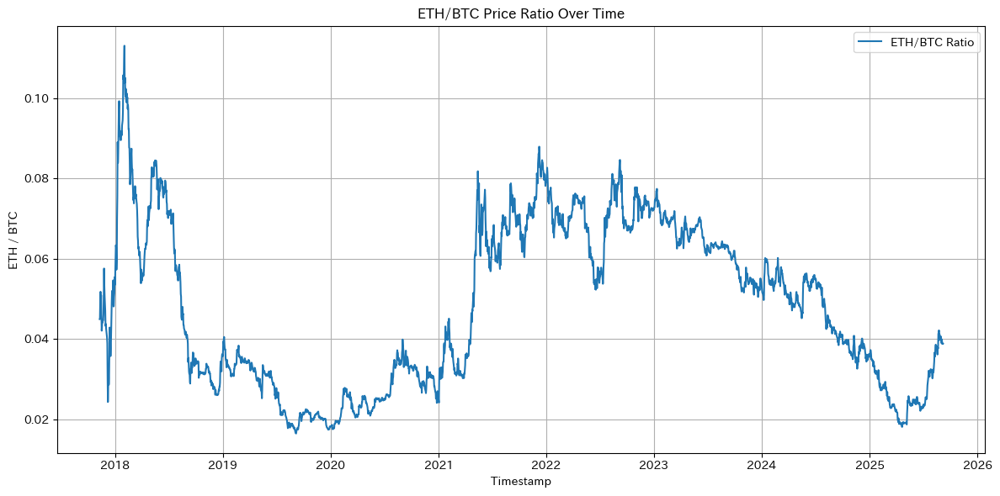

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# カラム構造に従って、各 'Close' 列を取り出す（MultiIndex対応）
btc_close = data_dict['BTC'][('Close', 'BTC-USD')]
eth_close = data_dict['ETH'][('Close', 'ETH-USD')]

# Series に名前をつけておく（後で分かりやすくなる）
btc_close.name = 'BTC_Close'
eth_close.name = 'ETH_Close'

# 同じTIMESTAMPインデックスでマージ（innerで共通期間だけ）
merged = pd.concat([btc_close, eth_close], axis=1, join='inner')

# ETH/BTC比率を計算
merged['ETH/BTC'] = merged['ETH_Close'] / merged['BTC_Close']

# インデックスがdatetimeでなければ変換（念のため）
if not pd.api.types.is_datetime64_any_dtype(merged.index):
    merged.index = pd.to_datetime(merged.index)

# プロット
plt.figure(figsize=(12, 6))
plt.plot(merged.index, merged['ETH/BTC'], label='ETH/BTC Ratio')
plt.xlabel('Timestamp')
plt.ylabel('ETH / BTC')
plt.title('ETH/BTC Price Ratio Over Time')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

## SP500が回帰線より上かつ、米国債が回帰線より下の場合に米国債を買い、逆転したらSP500にスイッチするシミュレーション

In [ ]:
display((data_dict["SP500_TR"].index-data_dict["SP500_TR"].index[0]).days.values)
display(data_dict["SP500_TR"])
display(data_dict["BOND"])

array([   0,    1,    4, ..., 5473, 5474, 5475], shape=(3771,))

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,VOO,VOO,VOO,VOO,VOO,VOO,VOO,VOO
Date,,,,,,,,
2010-09-09,77.214409,78.113669,77.077233,78.113669,26500,1.887698,1.887698,1.000000
2010-09-10,77.564957,77.625925,77.199159,77.488749,8600,1.889666,1.889666,1.000000
2010-09-13,78.540474,78.601442,78.113708,78.464267,33750,1.895094,1.895112,0.999958
2010-09-14,78.525215,78.860534,78.022236,78.372795,59400,1.895009,1.895752,0.998291
2010-09-15,78.723373,78.784336,78.037496,78.205155,9250,1.896104,1.896714,0.998596
...,...,...,...,...,...,...,...,...
2025-08-29,593.080017,595.549988,591.250000,595.239990,7512000,2.773113,2.738711,1.082437
2025-09-02,588.710022,588.799988,583.669983,586.059998,11116700,2.769901,2.739342,1.072901


Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,TLT,TLT,TLT,TLT,TLT,TLT,TLT,TLT
Date,,,,,,,,
2002-07-30,37.184662,37.357998,37.184662,37.289576,6100,1.570364,1.570364,1.000000
2002-07-31,37.645351,37.768512,37.357984,37.380789,29400,1.575711,1.575711,1.000000
2002-08-01,37.859764,37.868885,37.649939,37.649939,25000,1.578178,1.578658,0.998895
2002-08-02,38.247501,38.361537,37.805043,37.932766,52800,1.582603,1.582592,1.000026
2002-08-05,38.416225,38.516577,38.247452,38.334120,61100,1.584515,1.586370,0.995737
...,...,...,...,...,...,...,...,...
2025-08-29,86.272003,86.531021,86.112613,86.431401,41686400,1.935870,2.113910,0.663681
2025-09-02,85.629997,85.839996,85.480003,85.629997,48760600,1.932626,2.114006,0.658597


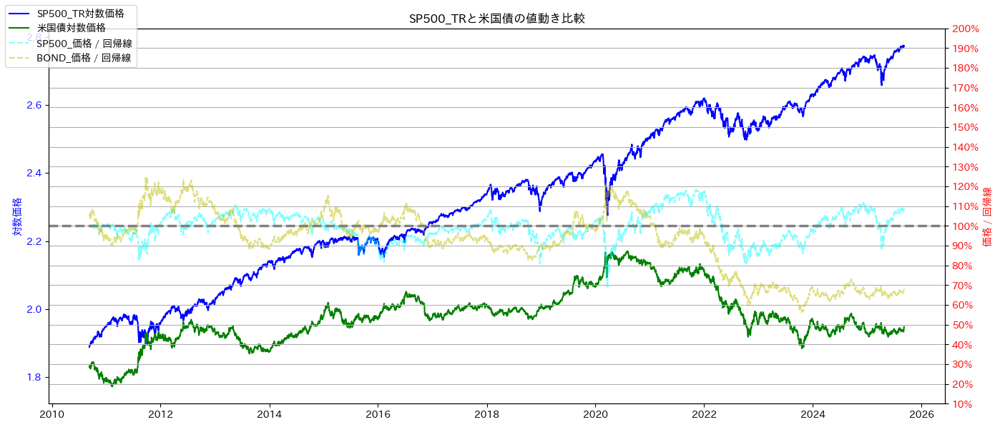

In [ ]:

# 共通期間のインデックスを決定
common_index = set.intersection(*[set(np.log(data['Close']).dropna().index) for data in [data_dict["BOND"], data_dict["SP500_TR"]]])
common_index = sorted(common_index)

dates = data_dict["SP500_TR"]["log_Close"].loc[common_index].index

fig, ax1 = plt.subplots(figsize=(14, 6))
ax1.set_title(f'SP500_TRと米国債の値動き比較')

ax1.plot(dates, data_dict["SP500_TR"]["log_Close"].loc[common_index], label='SP500_TR対数価格', color='blue')
ax1.plot(dates, data_dict["BOND"]["log_Close"].loc[common_index], label='米国債対数価格', color='green')

ax1.set_ylabel('対数価格', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

ax2 = ax1.twinx()
ax2.plot(dates,
        data_dict["SP500_TR"]["y_to_pred_ratio"].loc[common_index],
        label='SP500_価格 / 回帰線',
        color='cyan',
        linestyle='--',
        alpha=0.5
        )

ax2.plot(dates,
        data_dict["BOND"]["y_to_pred_ratio"].loc[common_index],
        label='BOND_価格 / 回帰線',
        color='y',
        linestyle='--',
        alpha=0.5
        )
ax2.set_ylabel('価格 / 回帰線', color='red')
ax2.tick_params(axis='y', labelcolor='red')
# ここを追加（比率 → %表示に変換）
ax2.yaxis.set_major_formatter(PercentFormatter(xmax=1.0))
# 100%ラインを太く目立たせる
ax2.axhline(1.0, color='gray',
        linestyle='--',
        linewidth=2.5,
        # label='100% 基準線',
        )
# # y軸を50〜200%に固定
ax2.set_ylim(0.1, 2.0)

# ▼ 0.1刻みの目盛りを設定（0.1〜2.0まで）
ax2.set_yticks(np.arange(0.1, 2.1, 0.1))  # 2.0まで含めたい場合は 2.1 にしておく

fig.legend(loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()



===== 最終評価額 =====
bond_only          3.568357e+05
sp500_only         1.216194e+06
switch_strategy    1.196805e+06
Name: 2025-09-05 00:00:00, dtype: float64

===== 掛け金総額 =====
377,100 円

===== 投資収益率（ROI） =====
bond_only           -5.37 %
sp500_only         222.51 %
switch_strategy    217.37 %
Name: 2025-09-05 00:00:00, dtype: object


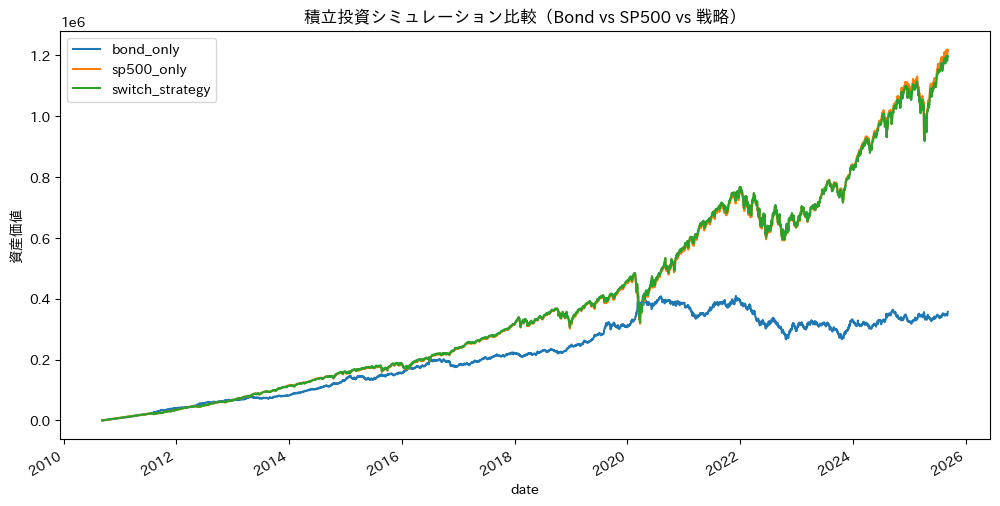

In [ ]:
sp500_df = data_dict["SP500_TR"].loc[common_index].copy()
bond_df = data_dict["BOND"].loc[common_index].copy()

investment_per_day = 100
dates = sp500_df.index

# 各シナリオの初期化
bond_units_1 = 0.0
sp500_units_2 = 0.0

bond_units_3 = 0.0
sp500_units_3 = 0.0

# 結果を記録するリスト
result = {
    'date': [],
    'bond_only': [],
    'sp500_only': [],
    'switch_strategy': [],
}

for date in dates:
    sp_price = sp500_df.loc[date,('Close', assets['SP500_TR']['ticker'])]
    bond_price = bond_df.loc[date,('Close', assets['BOND']['ticker'])]
    sp_ratio = sp500_df.loc[date,('y_to_pred_ratio', assets['SP500_TR']['ticker'])]
    bond_ratio = bond_df.loc[date,('y_to_pred_ratio', assets['BOND']['ticker'])]

    # ---- 戦略①: Bondのみ積立 ----
    bond_units_1 += investment_per_day / bond_price
    value_bond_only = bond_units_1 * bond_price

    # ---- 戦略②: SP500のみ積立 ----
    sp500_units_2 += investment_per_day / sp_price
    value_sp500_only = sp500_units_2 * sp_price

    # ---- 戦略③: 条件付き積立＋スイッチング ----
    # スイッチング条件: bond_ratio > 1 and sp_ratio < 1
    if bond_ratio > 1 and sp_ratio < 1:
        sp500_units_3 += bond_units_3 * bond_price / sp_price
        bond_units_3 = 0.0

    # 積立先の判断
    if bond_ratio < 1 and sp_ratio > 1:
        # bondに積立
        bond_units_3 += investment_per_day / bond_price
    else:
        # sp500に積立
        sp500_units_3 += investment_per_day / sp_price

    value_switch = bond_units_3 * bond_price + sp500_units_3 * sp_price

    # 結果を保存
    result['date'].append(date)
    result['bond_only'].append(value_bond_only)
    result['sp500_only'].append(value_sp500_only)
    result['switch_strategy'].append(value_switch)

# DataFrame化
result_df = pd.DataFrame(result).set_index('date')

# グラフ比較
result_df.plot(title='積立投資シミュレーション比較（Bond vs SP500 vs 戦略）', ylabel='資産価値', figsize=(12, 6))

# 投資日数 × 毎日の掛け金
total_invested = len(result_df) * investment_per_day

# 最終評価額を取得
final_returns = result_df.iloc[-1]

# ROI（投資収益率）を計算
roi = (final_returns - total_invested) / total_invested

# 結果表示
print("===== 最終評価額 =====")
print(final_returns)
print("\n===== 掛け金総額 =====")
print(f"{total_invested:,.0f} 円")

print("\n===== 投資収益率（ROI） =====")
print((roi * 100).round(2).astype(str) + " %")


### 全資産の価格推移

C:\Users\t-miura\AppData\Local\Temp\ipykernel_5368\3416864420.py:28: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


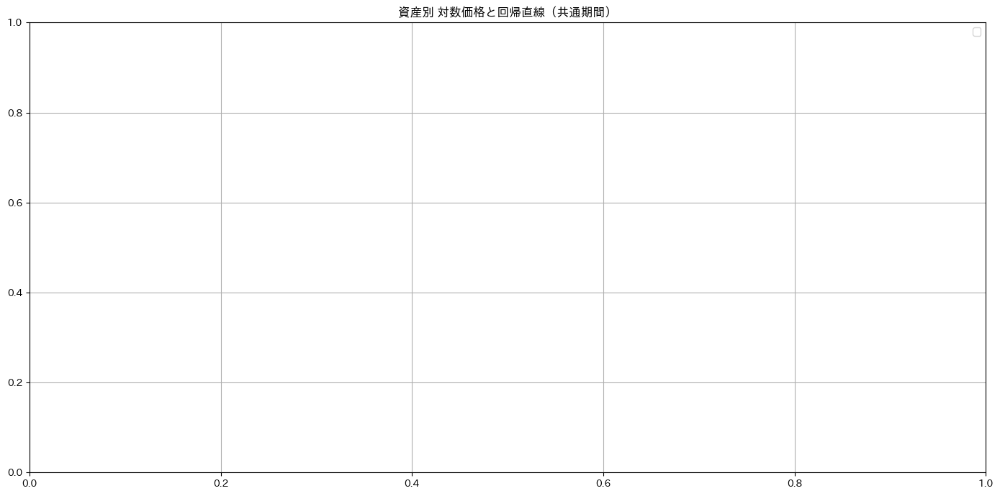

In [ ]:
# 共通期間のインデックスを決定
common_index = set.intersection(*[set(np.log(data['Close']).dropna().index) for data in data_dict.values()])
common_index = sorted(common_index)

# 1枚の図にまとめて描画
plt.figure(figsize=(14, 7))

for name, data in data_dict.items():
    try:
        log_close = np.log10(data['Close']).dropna().loc[common_index]
        dates = log_close.index
        x = (dates - dates[0]).days.values  # 日数
        # x = np.arange(len(log_close))
        y = log_close.values.ravel()

        slope, intercept, _, _, _ = linregress(x, y)
        y_pred = intercept + slope * x

        r_annual = compute_annualized_return(slope, log_close.index, days_per_year=365)
        # r_annual = np.exp(slope * 252) - 1

        plt.plot(log_close.index, y, label=f'{name} 対数価格')
        plt.plot(log_close.index, y_pred, linestyle='--', label=f'{name} 回帰（{r_annual:.2%}）')
    except:
        continue

plt.title('資産別 対数価格と回帰直線（共通期間）')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

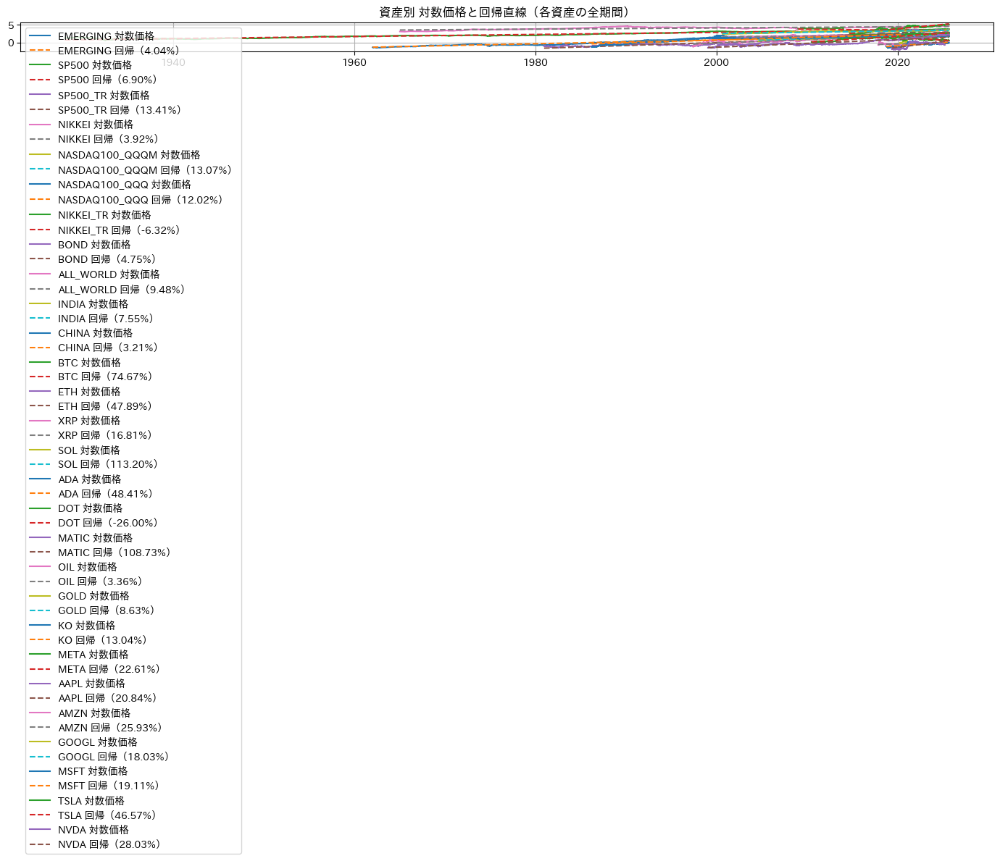

In [ ]:
plt.figure(figsize=(14, 7))

for name, data in data_dict.items():
    log_close = np.log10(data['Close']).dropna()
    dates = log_close.index
    x = (dates - dates[0]).days.values  # 日数
    # x = np.arange(len(log_close))
    y = log_close.values.ravel()

    slope, intercept, _, _, _ = linregress(x, y)
    y_pred = intercept + slope * x
    r_annual = compute_annualized_return(slope, log_close.index, days_per_year=365)
    # r_annual = np.exp(slope * 252) - 1

    plt.plot(log_close.index, y, label=f'{name} 対数価格')
    plt.plot(log_close.index, y_pred, linestyle='--', label=f'{name} 回帰（{r_annual:.2%}）')

plt.title('資産別 対数価格と回帰直線（各資産の全期間）')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## 現在価格が回帰直線の下にある時のみに積み立てたとき

In [ ]:
BTC = data_dict['BTC']
BTC

Price,Close,High,Low,Open,Volume,log_Close,log_pred_Close,y_to_pred_ratio
Ticker,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD,BTC-USD
Date,,,,,,,,
2014-09-17,457.334015,468.174011,452.421997,465.864014,21056800,2.660234,2.660234,1.000000
2014-09-18,424.440002,456.859985,413.104004,456.859985,34483200,2.627816,2.627816,1.000000
2014-09-19,394.795990,427.834991,384.532013,424.102997,37919700,2.596373,2.596210,1.000374
2014-09-20,408.903992,423.295990,389.882996,394.673004,36863600,2.611621,2.597419,1.033243
2014-09-21,398.821014,412.425995,393.181000,408.084991,26580100,2.600778,2.592343,1.019612
...,...,...,...,...,...,...,...,...
2025-09-02,111200.585938,111748.015625,108454.031250,109243.070312,74776999491,5.046107,5.230369,0.654242
2025-09-03,111723.210938,112600.226562,110582.960938,111190.695312,61119643565,5.048143,5.230850,0.656588


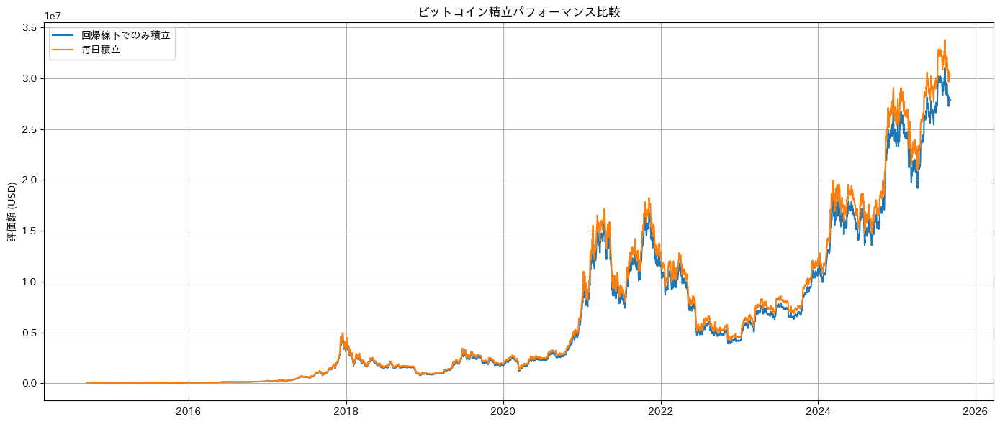


最終評価額（回帰線下でのみ積立）: $27,851,611.96
最終評価額（毎日積立）: $30,296,146.26


In [ ]:

BTC = BTC[['Close']].dropna()
BTC['Close'] = BTC['Close'].squeeze()

# 対数価格
BTC['log_price'] = np.log(BTC['Close'])

# 回帰直線
BTC = BTC.copy()

dates = BTC['Close'].index

BTC['time'] = (dates - dates[0]).days.values  # 日数


# x = np.arange(len(log_close))

slope, intercept, _, _, _ = linregress(BTC['time'], BTC['log_price'])
BTC['log_trend'] = intercept + slope * BTC['time']

# 積立戦略
investment_amount = 100  # 毎回の積立額

# ① 回帰線より下のときのみ積立
BTC['buy_conditional'] = BTC['log_price'] < BTC['log_trend']
BTC['btc_units_conditional'] = pd.Series(
    np.where(
        BTC['buy_conditional'].values,
        (investment_amount / BTC['Close'].squeeze()).values,
        0.0
    ),
    index=BTC.index
)


BTC['btc_cum_conditional'] = BTC['btc_units_conditional'].cumsum()
BTC['total_value_conditional'] = BTC['btc_cum_conditional'] * BTC['Close'].squeeze()

# ② 毎日積立
BTC['btc_units_daily'] = investment_amount / BTC['Close']
BTC['btc_cum_daily'] = BTC['btc_units_daily'].cumsum()
BTC['total_value_daily'] = BTC['btc_cum_daily'] * BTC['Close'].squeeze()

# 結果を可視化
plt.figure(figsize=(14, 6))
plt.plot(BTC.index, BTC['total_value_conditional'], label='回帰線下でのみ積立')
plt.plot(BTC.index, BTC['total_value_daily'], label='毎日積立')
plt.title('ビットコイン積立パフォーマンス比較')
plt.ylabel('評価額 (USD)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# 最終結果の比較
final_conditional = BTC['total_value_conditional'].iloc[-1]
final_daily = BTC['total_value_daily'].iloc[-1]
print(f"\n最終評価額（回帰線下でのみ積立）: ${final_conditional:,.2f}")
print(f"最終評価額（毎日積立）: ${final_daily:,.2f}")

In [ ]:
total_investment_conditional = BTC['buy_conditional'].sum() * investment_amount
total_investment_daily = len(BTC) * investment_amount

return_conditional = final_conditional / total_investment_conditional
return_daily = final_daily / total_investment_daily

print(f"\n回帰線下でのみ積立：")
print(f"  - 投資額: ${total_investment_conditional:,.2f}")
print(f"  - 評価額: ${final_conditional:,.2f}")
print(f"  - 収益率: {return_conditional:.2%}")

print(f"\n毎日積立：")
print(f"  - 投資額: ${total_investment_daily:,.2f}")
print(f"  - 評価額: ${final_daily:,.2f}")
print(f"  - 収益率: {return_daily:.2%}")




回帰線下でのみ積立：
  - 投資額: $236,800.00
  - 評価額: $27,851,611.96
  - 収益率: 11761.66%

毎日積立：
  - 投資額: $400,800.00
  - 評価額: $30,296,146.26
  - 収益率: 7558.92%


# 各資産において毎日積み立てと回帰直線の下にある時積み立てのリターン比較

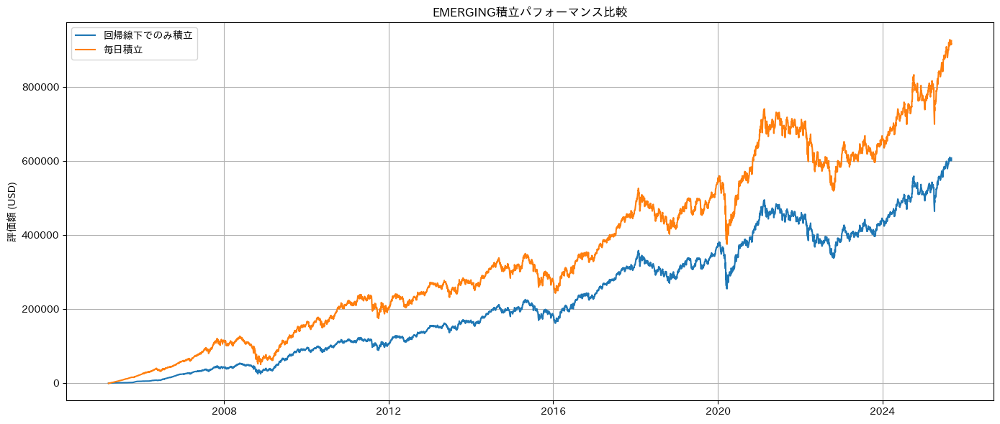


最終評価額（回帰線下でのみ積立）: $607,205.06
最終評価額（毎日積立）: $923,845.73

回帰線下でのみ積立：
  - 投資額: $327,300.00
  - 評価額: $607,205.06
  - 収益率: 185.52%

毎日積立：
  - 投資額: $515,600.00
  - 評価額: $923,845.73
  - 収益率: 179.18%
  -回帰直線の下にある割合 : 63.48%


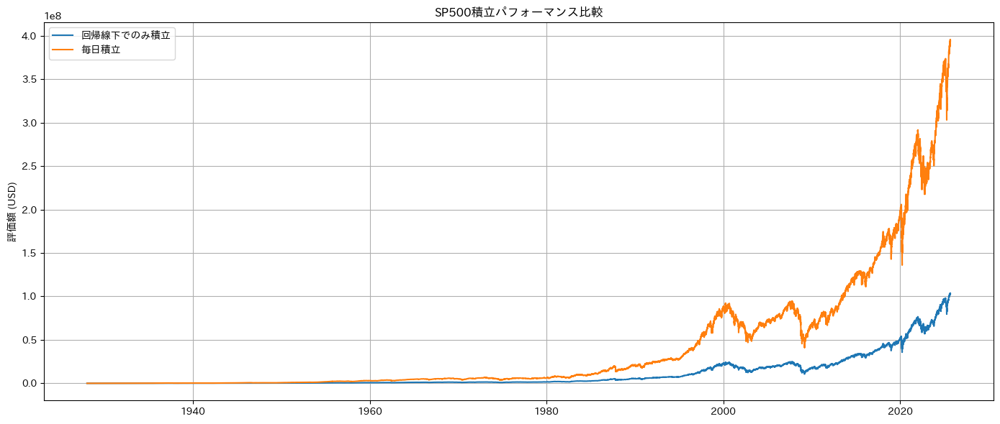


最終評価額（回帰線下でのみ積立）: $103,509,489.35
最終評価額（毎日積立）: $394,265,921.92

回帰線下でのみ積立：
  - 投資額: $533,500.00
  - 評価額: $103,509,489.35
  - 収益率: 19401.97%

毎日積立：
  - 投資額: $2,453,600.00
  - 評価額: $394,265,921.92
  - 収益率: 16068.88%
  -回帰直線の下にある割合 : 21.74%


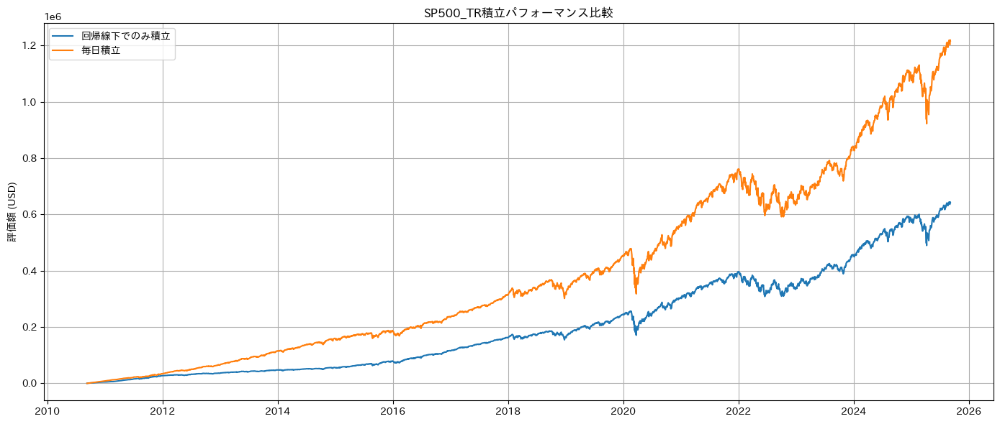


最終評価額（回帰線下でのみ積立）: $642,581.99
最終評価額（毎日積立）: $1,216,194.29

回帰線下でのみ積立：
  - 投資額: $195,700.00
  - 評価額: $642,581.99
  - 収益率: 328.35%

毎日積立：
  - 投資額: $377,100.00
  - 評価額: $1,216,194.29
  - 収益率: 322.51%
  -回帰直線の下にある割合 : 51.90%


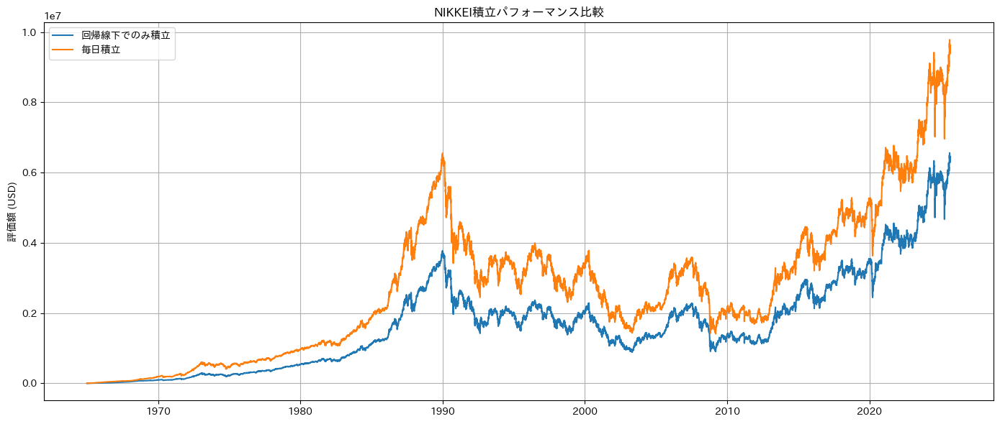


最終評価額（回帰線下でのみ積立）: $6,455,919.53
最終評価額（毎日積立）: $9,630,844.43

回帰線下でのみ積立：
  - 投資額: $1,134,100.00
  - 評価額: $6,455,919.53
  - 収益率: 569.25%

毎日積立：
  - 投資額: $1,491,900.00
  - 評価額: $9,630,844.43
  - 収益率: 645.54%
  -回帰直線の下にある割合 : 76.02%


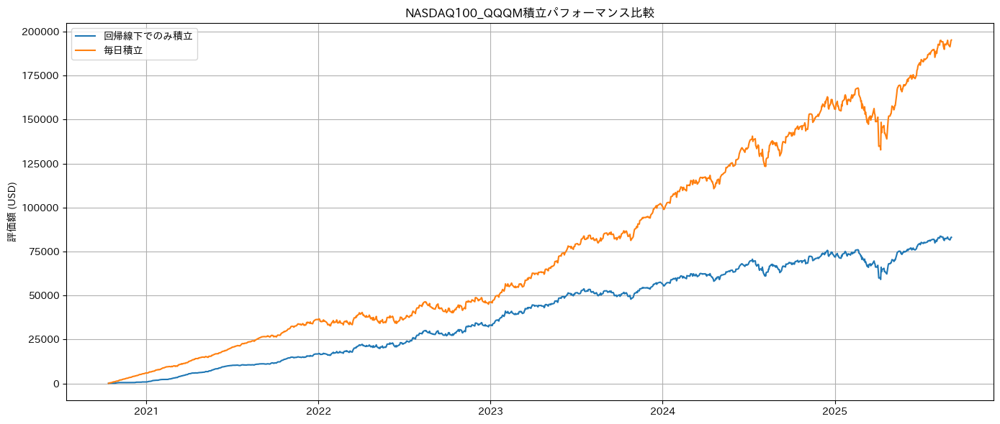


最終評価額（回帰線下でのみ積立）: $83,118.26
最終評価額（毎日積立）: $195,249.71

回帰線下でのみ積立：
  - 投資額: $44,700.00
  - 評価額: $83,118.26
  - 収益率: 185.95%

毎日積立：
  - 投資額: $123,000.00
  - 評価額: $195,249.71
  - 収益率: 158.74%
  -回帰直線の下にある割合 : 36.34%


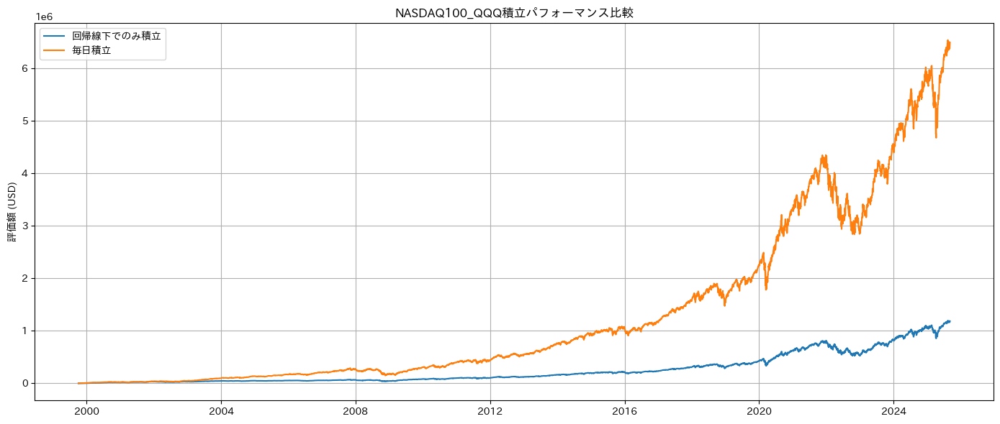


最終評価額（回帰線下でのみ積立）: $1,185,614.32
最終評価額（毎日積立）: $6,497,442.61

回帰線下でのみ積立：
  - 投資額: $73,400.00
  - 評価額: $1,185,614.32
  - 収益率: 1615.28%

毎日積立：
  - 投資額: $652,100.00
  - 評価額: $6,497,442.61
  - 収益率: 996.39%
  -回帰直線の下にある割合 : 11.26%


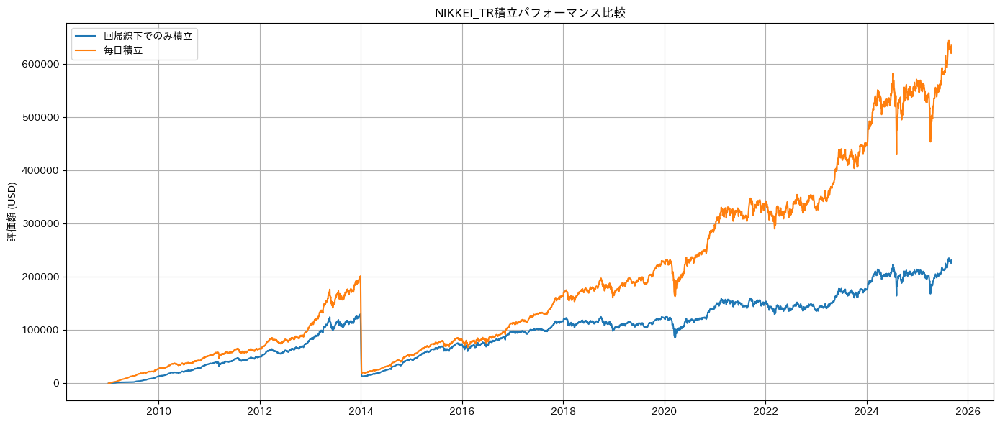


最終評価額（回帰線下でのみ積立）: $231,653.42
最終評価額（毎日積立）: $636,182.03

回帰線下でのみ積立：
  - 投資額: $141,300.00
  - 評価額: $231,653.42
  - 収益率: 163.94%

毎日積立：
  - 投資額: $409,600.00
  - 評価額: $636,182.03
  - 収益率: 155.32%
  -回帰直線の下にある割合 : 34.50%


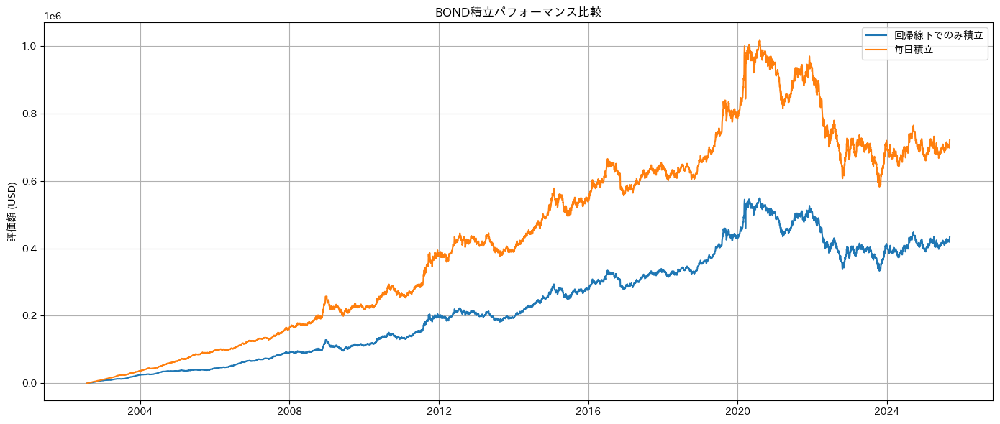


最終評価額（回帰線下でのみ積立）: $433,372.26
最終評価額（毎日積立）: $721,974.92

回帰線下でのみ積立：
  - 投資額: $356,100.00
  - 評価額: $433,372.26
  - 収益率: 121.70%

毎日積立：
  - 投資額: $581,400.00
  - 評価額: $721,974.92
  - 収益率: 124.18%
  -回帰直線の下にある割合 : 61.25%


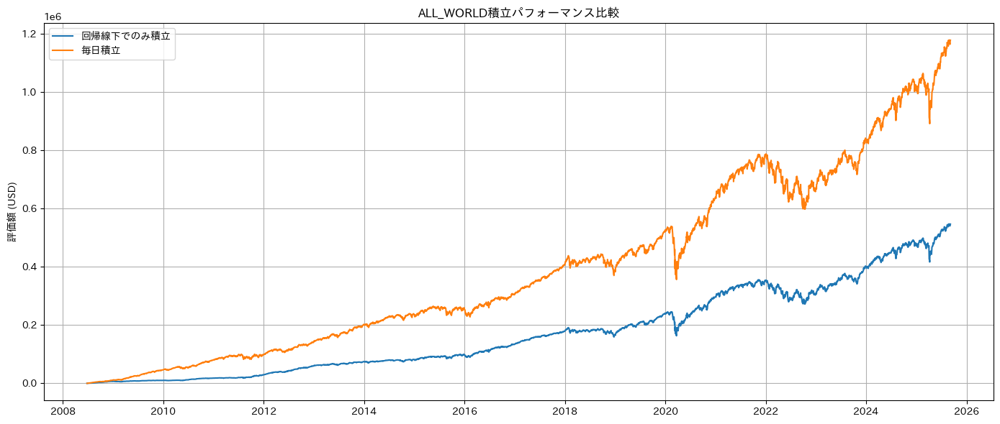


最終評価額（回帰線下でのみ積立）: $546,278.70
最終評価額（毎日積立）: $1,176,955.92

回帰線下でのみ積立：
  - 投資額: $203,200.00
  - 評価額: $546,278.70
  - 収益率: 268.84%

毎日積立：
  - 投資額: $432,600.00
  - 評価額: $1,176,955.92
  - 収益率: 272.07%
  -回帰直線の下にある割合 : 46.97%


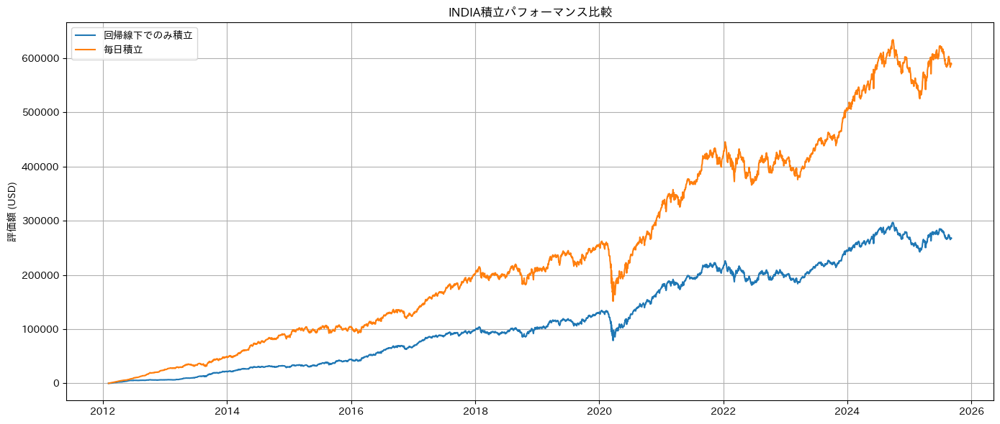


最終評価額（回帰線下でのみ積立）: $267,688.61
最終評価額（毎日積立）: $589,123.53

回帰線下でのみ積立：
  - 投資額: $135,900.00
  - 評価額: $267,688.61
  - 収益率: 196.97%

毎日積立：
  - 投資額: $341,700.00
  - 評価額: $589,123.53
  - 収益率: 172.41%
  -回帰直線の下にある割合 : 39.77%


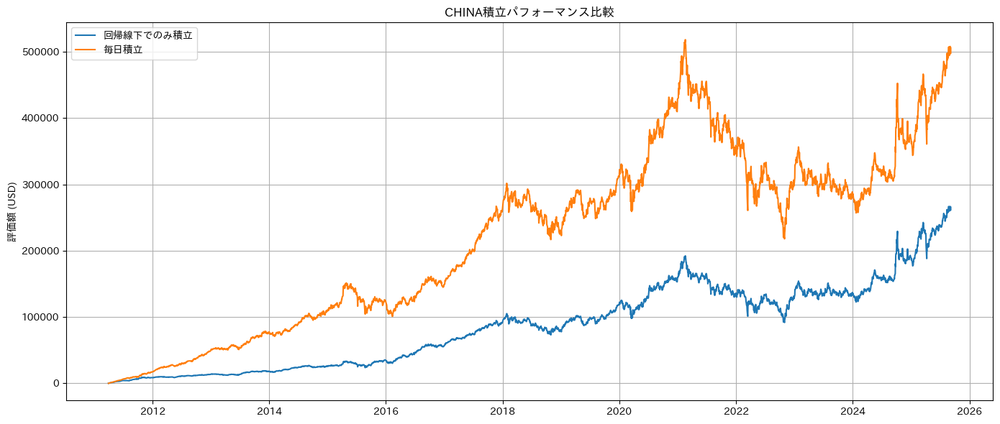


最終評価額（回帰線下でのみ積立）: $265,490.41
最終評価額（毎日積立）: $505,955.93

回帰線下でのみ積立：
  - 投資額: $185,400.00
  - 評価額: $265,490.41
  - 収益率: 143.20%

毎日積立：
  - 投資額: $363,000.00
  - 評価額: $505,955.93
  - 収益率: 139.38%
  -回帰直線の下にある割合 : 51.07%


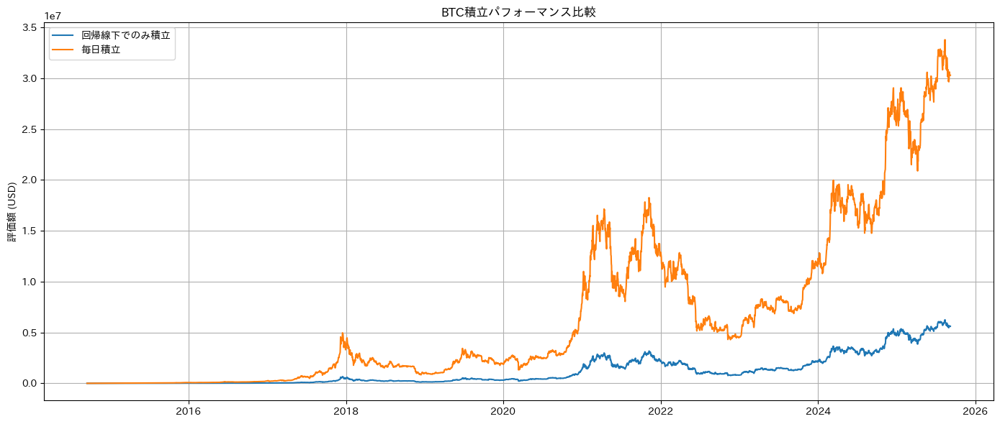


最終評価額（回帰線下でのみ積立）: $5,604,299.77
最終評価額（毎日積立）: $30,296,146.26

回帰線下でのみ積立：
  - 投資額: $245,900.00
  - 評価額: $5,604,299.77
  - 収益率: 2279.10%

毎日積立：
  - 投資額: $400,800.00
  - 評価額: $30,296,146.26
  - 収益率: 7558.92%
  -回帰直線の下にある割合 : 61.35%


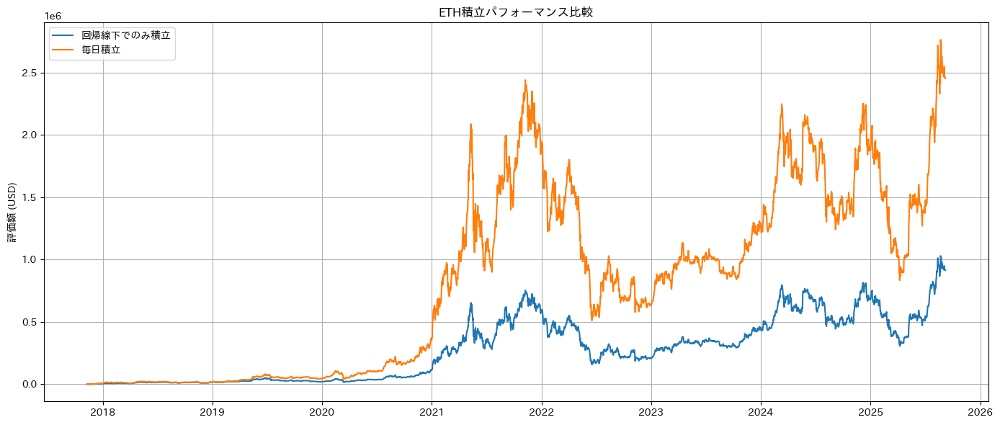


最終評価額（回帰線下でのみ積立）: $915,424.52
最終評価額（毎日積立）: $2,456,007.71

回帰線下でのみ積立：
  - 投資額: $152,100.00
  - 評価額: $915,424.52
  - 収益率: 601.86%

毎日積立：
  - 投資額: $285,900.00
  - 評価額: $2,456,007.71
  - 収益率: 859.04%
  -回帰直線の下にある割合 : 53.20%


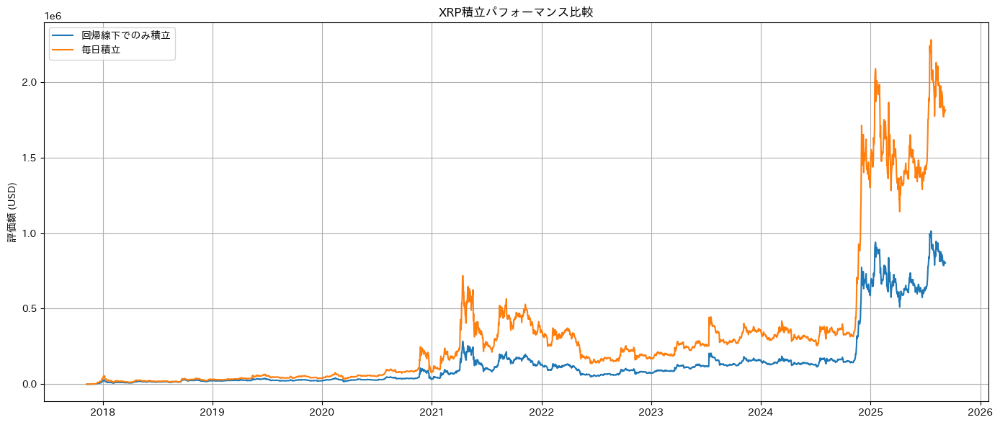


最終評価額（回帰線下でのみ積立）: $803,373.92
最終評価額（毎日積立）: $1,811,451.83

回帰線下でのみ積立：
  - 投資額: $106,600.00
  - 評価額: $803,373.92
  - 収益率: 753.63%

毎日積立：
  - 投資額: $285,900.00
  - 評価額: $1,811,451.83
  - 収益率: 633.60%
  -回帰直線の下にある割合 : 37.29%


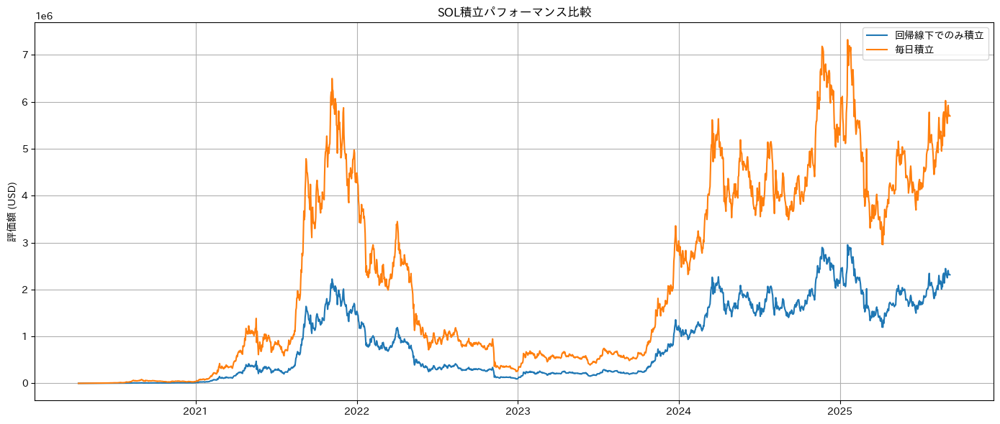


最終評価額（回帰線下でのみ積立）: $2,313,767.75
最終評価額（毎日積立）: $5,698,834.40

回帰線下でのみ積立：
  - 投資額: $129,300.00
  - 評価額: $2,313,767.75
  - 収益率: 1789.46%

毎日積立：
  - 投資額: $197,600.00
  - 評価額: $5,698,834.40
  - 収益率: 2884.03%
  -回帰直線の下にある割合 : 65.44%


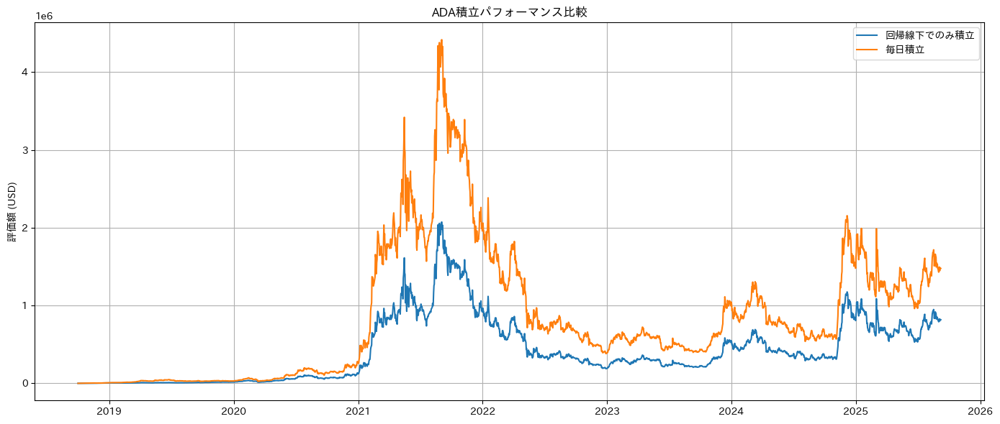


最終評価額（回帰線下でのみ積立）: $817,647.12
最終評価額（毎日積立）: $1,477,474.92

回帰線下でのみ積立：
  - 投資額: $161,100.00
  - 評価額: $817,647.12
  - 収益率: 507.54%

毎日積立：
  - 投資額: $253,300.00
  - 評価額: $1,477,474.92
  - 収益率: 583.29%
  -回帰直線の下にある割合 : 63.60%


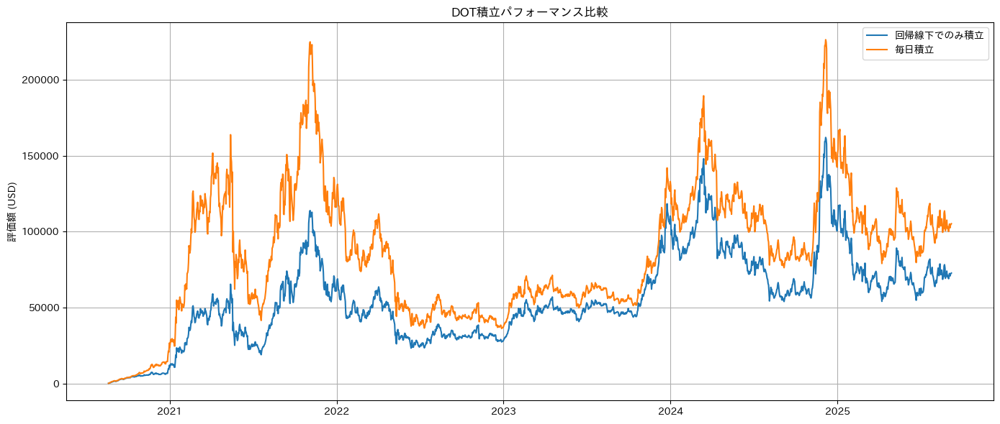


最終評価額（回帰線下でのみ積立）: $72,679.12
最終評価額（毎日積立）: $105,196.77

回帰線下でのみ積立：
  - 投資額: $124,300.00
  - 評価額: $72,679.12
  - 収益率: 58.47%

毎日積立：
  - 投資額: $184,400.00
  - 評価額: $105,196.77
  - 収益率: 57.05%
  -回帰直線の下にある割合 : 67.41%


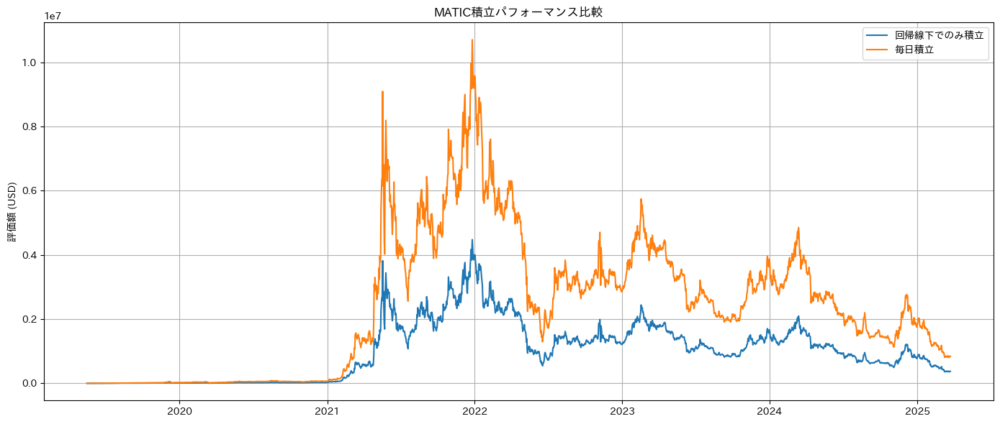


最終評価額（回帰線下でのみ積立）: $375,029.96
最終評価額（毎日積立）: $844,125.86

回帰線下でのみ積立：
  - 投資額: $137,000.00
  - 評価額: $375,029.96
  - 収益率: 273.74%

毎日積立：
  - 投資額: $213,900.00
  - 評価額: $844,125.86
  - 収益率: 394.64%
  -回帰直線の下にある割合 : 64.05%


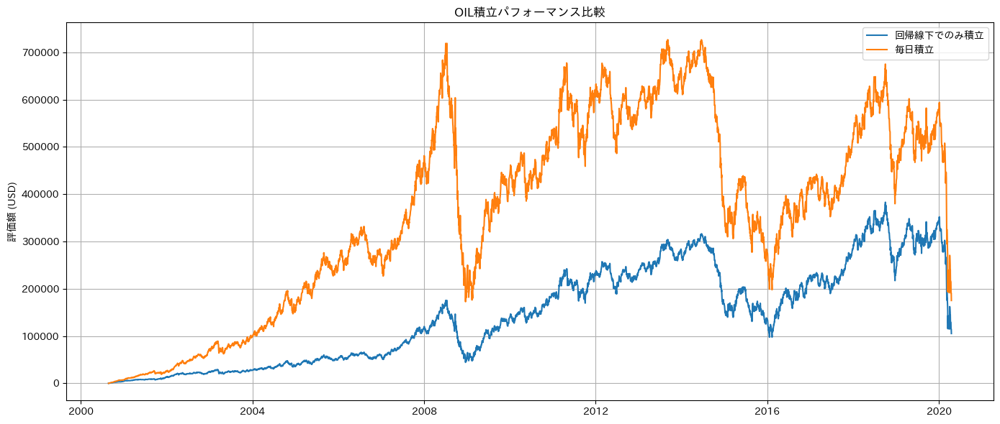


最終評価額（回帰線下でのみ積立）: $105,385.13
最終評価額（毎日積立）: $175,251.78

回帰線下でのみ積立：
  - 投資額: $329,600.00
  - 評価額: $105,385.13
  - 収益率: 31.97%

毎日積立：
  - 投資額: $493,100.00
  - 評価額: $175,251.78
  - 収益率: 35.54%
  -回帰直線の下にある割合 : 66.84%


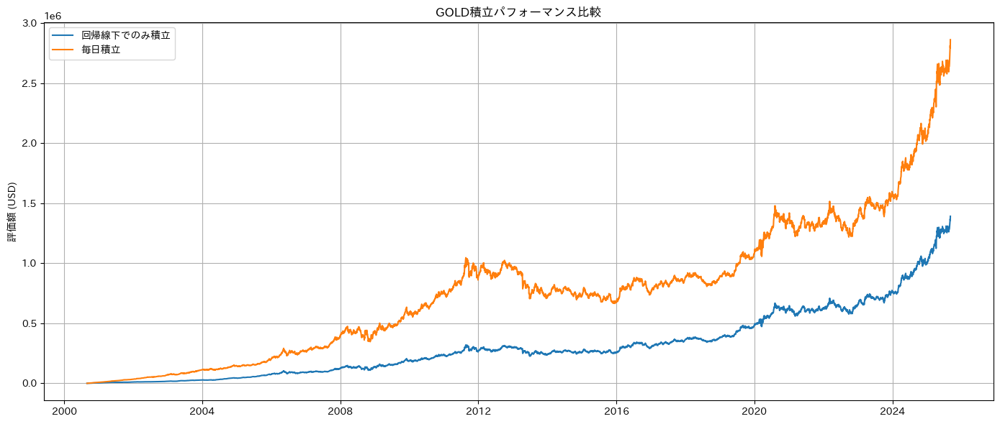


最終評価額（回帰線下でのみ積立）: $1,390,708.61
最終評価額（毎日積立）: $2,860,545.64

回帰線下でのみ積立：
  - 投資額: $384,900.00
  - 評価額: $1,390,708.61
  - 収益率: 361.32%

毎日積立：
  - 投資額: $627,700.00
  - 評価額: $2,860,545.64
  - 収益率: 455.72%
  -回帰直線の下にある割合 : 61.32%


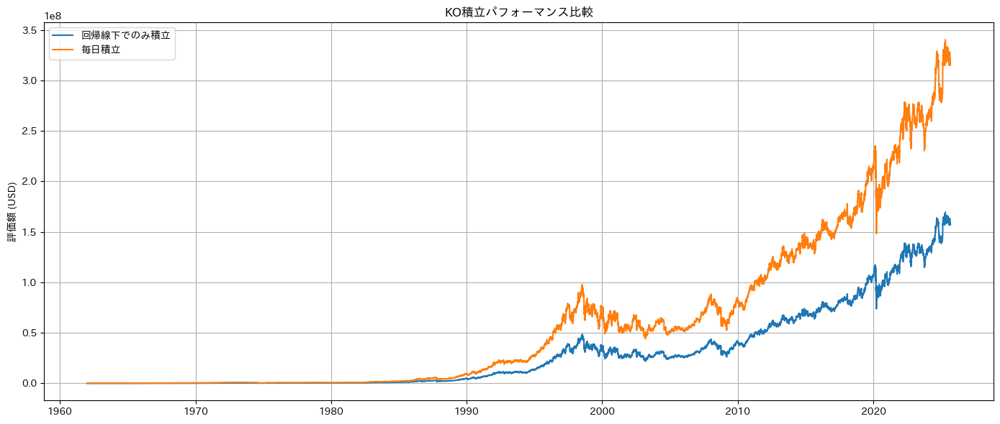


最終評価額（回帰線下でのみ積立）: $157,009,013.62
最終評価額（毎日積立）: $315,190,290.94

回帰線下でのみ積立：
  - 投資額: $978,800.00
  - 評価額: $157,009,013.62
  - 収益率: 16040.97%

毎日積立：
  - 投資額: $1,602,700.00
  - 評価額: $315,190,290.94
  - 収益率: 19666.21%
  -回帰直線の下にある割合 : 61.07%


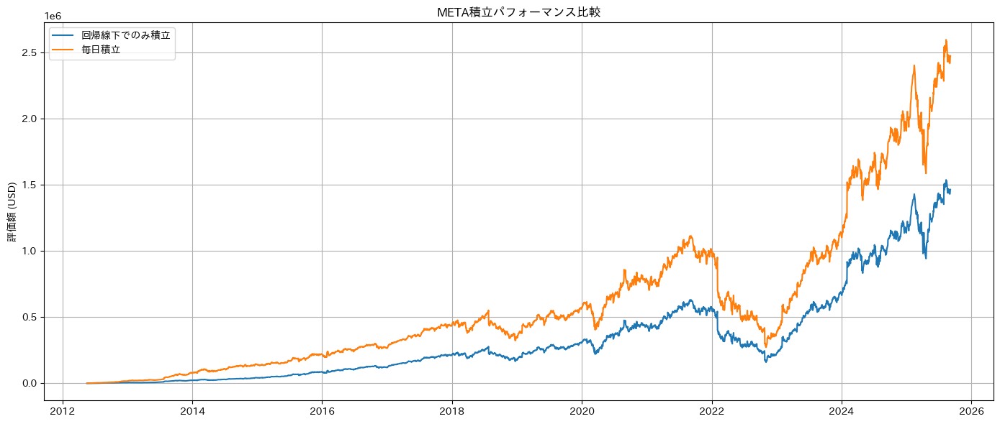


最終評価額（回帰線下でのみ積立）: $1,463,776.32
最終評価額（毎日積立）: $2,473,532.27

回帰線下でのみ積立：
  - 投資額: $245,800.00
  - 評価額: $1,463,776.32
  - 収益率: 595.52%

毎日積立：
  - 投資額: $334,400.00
  - 評価額: $2,473,532.27
  - 収益率: 739.69%
  -回帰直線の下にある割合 : 73.50%


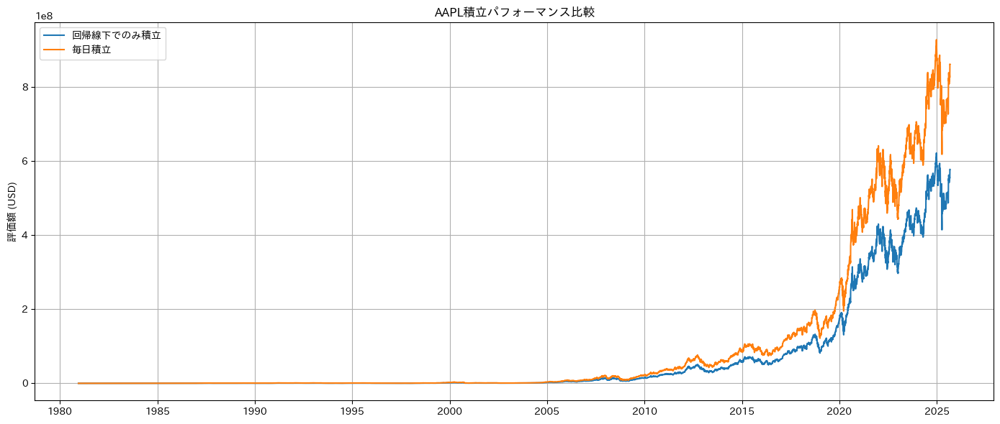


最終評価額（回帰線下でのみ積立）: $577,999,137.77
最終評価額（毎日積立）: $862,266,187.49

回帰線下でのみ積立：
  - 投資額: $393,200.00
  - 評価額: $577,999,137.77
  - 収益率: 146998.76%

毎日積立：
  - 投資額: $1,127,400.00
  - 評価額: $862,266,187.49
  - 収益率: 76482.72%
  -回帰直線の下にある割合 : 34.88%


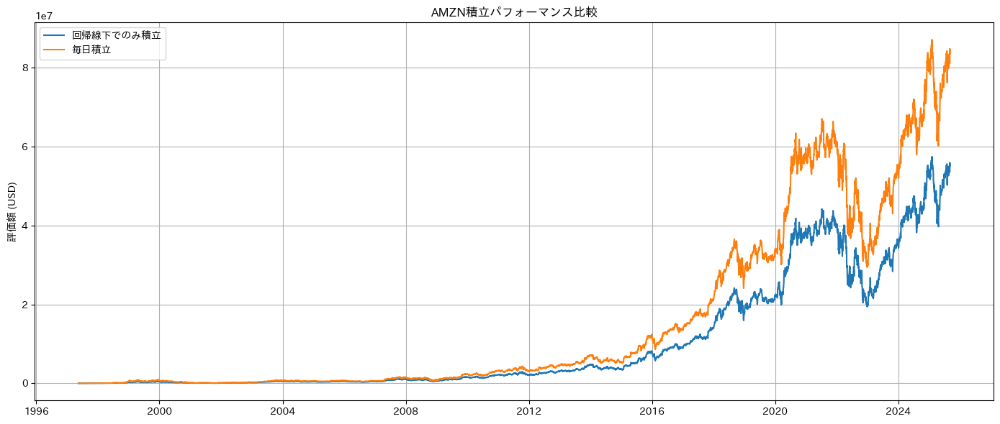


最終評価額（回帰線下でのみ積立）: $55,159,878.72
最終評価額（毎日積立）: $83,607,582.93

回帰線下でのみ積立：
  - 投資額: $293,400.00
  - 評価額: $55,159,878.72
  - 収益率: 18800.23%

毎日積立：
  - 投資額: $712,200.00
  - 評価額: $83,607,582.93
  - 収益率: 11739.34%
  -回帰直線の下にある割合 : 41.20%


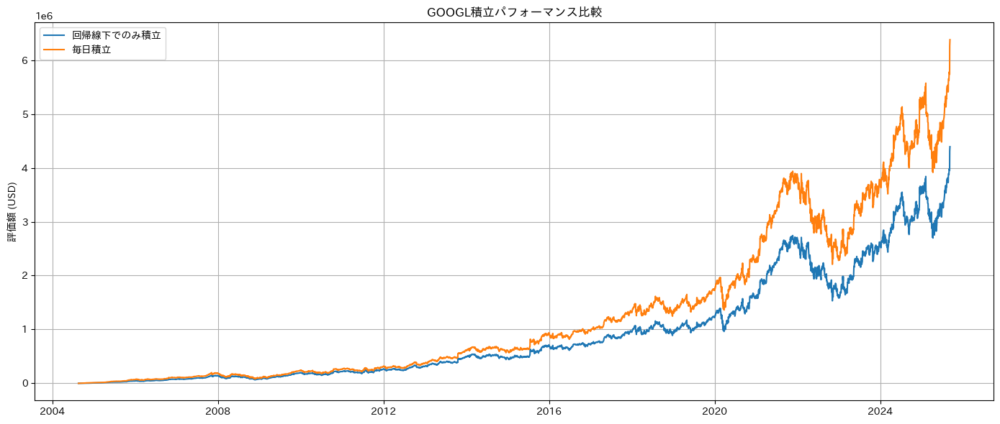


最終評価額（回帰線下でのみ積立）: $4,392,934.83
最終評価額（毎日積立）: $6,379,442.57

回帰線下でのみ積立：
  - 投資額: $242,700.00
  - 評価額: $4,392,934.83
  - 収益率: 1810.03%

毎日積立：
  - 投資額: $529,600.00
  - 評価額: $6,379,442.57
  - 収益率: 1204.58%
  -回帰直線の下にある割合 : 45.83%


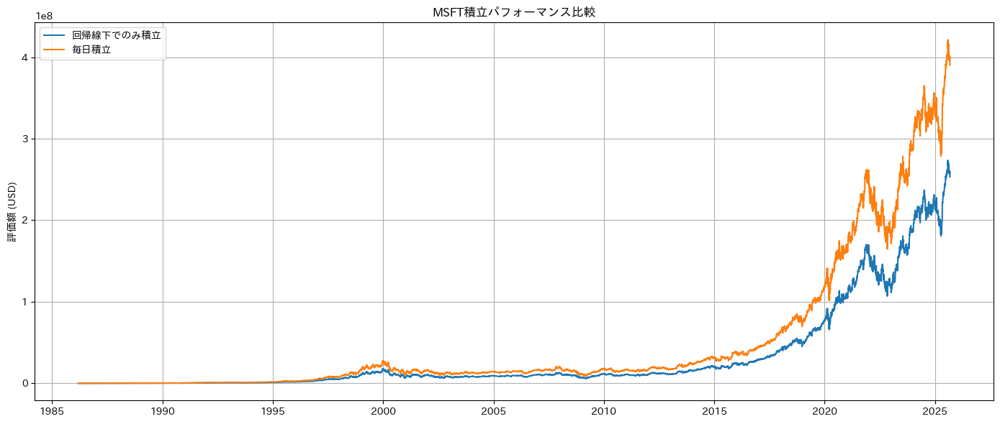


最終評価額（回帰線下でのみ積立）: $253,137,447.20
最終評価額（毎日積立）: $390,080,227.24

回帰線下でのみ積立：
  - 投資額: $707,800.00
  - 評価額: $253,137,447.20
  - 収益率: 35763.98%

毎日積立：
  - 投資額: $994,800.00
  - 評価額: $390,080,227.24
  - 収益率: 39211.92%
  -回帰直線の下にある割合 : 71.15%


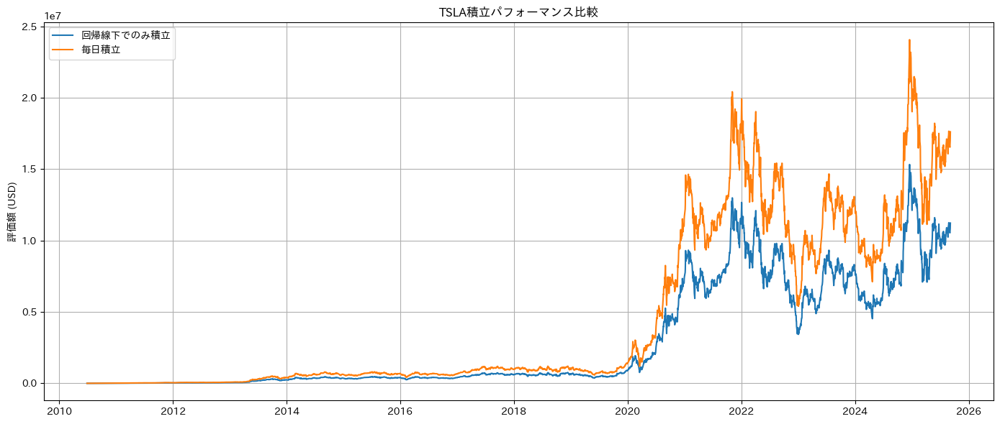


最終評価額（回帰線下でのみ積立）: $11,227,378.68
最終評価額（毎日積立）: $17,620,607.81

回帰線下でのみ積立：
  - 投資額: $244,200.00
  - 評価額: $11,227,378.68
  - 収益率: 4597.62%

毎日積立：
  - 投資額: $382,100.00
  - 評価額: $17,620,607.81
  - 収益率: 4611.52%
  -回帰直線の下にある割合 : 63.91%


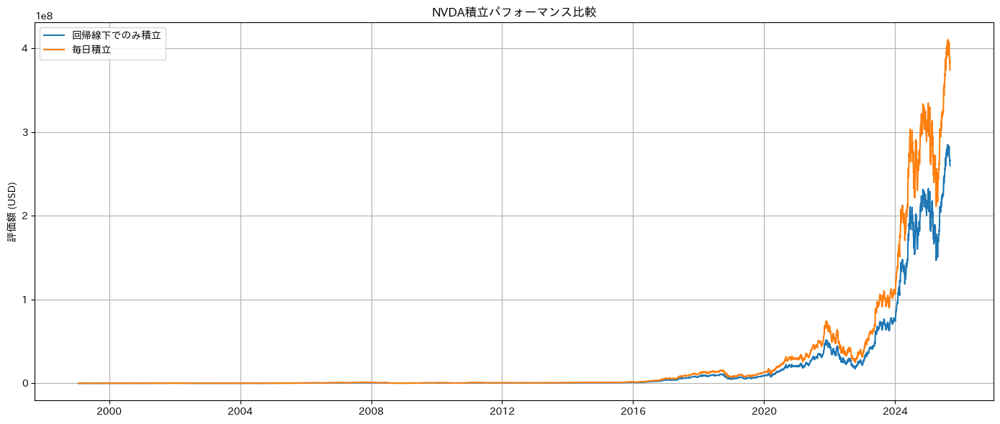


最終評価額（回帰線下でのみ積立）: $259,944,690.80
最終評価額（毎日積立）: $374,190,321.56

回帰線下でのみ積立：
  - 投資額: $303,000.00
  - 評価額: $259,944,690.80
  - 収益率: 85790.33%

毎日積立：
  - 投資額: $669,700.00
  - 評価額: $374,190,321.56
  - 収益率: 55874.32%
  -回帰直線の下にある割合 : 45.24%


In [ ]:
for name, data in data_dict.items():
    data = data.copy()
    log_trend_list = []

    data['log_price'] = np.log(data['Close']).dropna()
    # dates = data['log_price'].index
    # x = (dates - dates[0]).days.values  # 日数

    x = (data.index - data.index[0]).days.values


    # # 対数価格
    # data['log_price'] = np.log(data['Close']).dropna()
    # display(data)

    for i in range(len(data)):
        if i < 2:  # 最低日数のしきい値
            # log_trend_list.append(log_close.iloc[i].values.ravel()[0])
            log_trend_list.append(10**6)
            continue

        # x = np.arange(i + 1)

        # y = data['log_price'].iloc[:i + 1].values.ravel()
        y = data['log_price'].iloc[:i + 1].squeeze().values
        slope, intercept, *_ = linregress(x[:i + 1], y)
        trend_today = intercept + slope * x[i]

        log_trend_list.append(trend_today)

    data['log_trend_dynamic'] = log_trend_list
    # ① 回帰線より下のときのみ積立
    data['buy_conditional'] = data['log_price'] <= data['log_trend_dynamic']
    data['data_units_conditional'] = pd.Series(
        np.where(
            data['buy_conditional'].values,
            (investment_amount / data['Close'].squeeze()).values,
            0.0
        ),
        index=data.index
    )


    data['data_cum_conditional'] = data['data_units_conditional'].cumsum()
    data['total_value_conditional'] = data['data_cum_conditional'] * data['Close'].squeeze()

    # ② 毎日積立
    data['data_units_daily'] = investment_amount / data['Close'].values
    data['data_cum_daily'] = data['data_units_daily'].cumsum()
    data['total_value_daily'] = data['data_cum_daily'] * data['Close'].squeeze()

    # 結果を可視化
    plt.figure(figsize=(14, 6))
    plt.plot(data.index, data['total_value_conditional'], label='回帰線下でのみ積立')
    plt.plot(data.index, data['total_value_daily'], label='毎日積立')
    plt.title(f'{name}積立パフォーマンス比較')
    plt.ylabel('評価額 (USD)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # 最終結果の比較
    final_conditional = data['total_value_conditional'].iloc[-1]
    final_daily = data['total_value_daily'].iloc[-1]
    print(f"\n最終評価額（回帰線下でのみ積立）: ${final_conditional:,.2f}")
    print(f"最終評価額（毎日積立）: ${final_daily:,.2f}")

    total_investment_conditional = data['buy_conditional'].sum() * investment_amount
    total_investment_daily = len(data) * investment_amount

    return_conditional = final_conditional / total_investment_conditional
    return_daily = final_daily / total_investment_daily

    # display(data)

    print(f"\n回帰線下でのみ積立：")
    print(f"  - 投資額: ${total_investment_conditional:,.2f}")
    print(f"  - 評価額: ${final_conditional:,.2f}")
    print(f"  - 収益率: {return_conditional:.2%}")

    print(f"\n毎日積立：")
    print(f"  - 投資額: ${total_investment_daily:,.2f}")
    print(f"  - 評価額: ${final_daily:,.2f}")
    print(f"  - 収益率: {return_daily:.2%}")

    print(f"  -回帰直線の下にある割合 : {data['buy_conditional'].mean():.2%}")

## その時点での回帰直線の下に存在する割合に応じて、掛け金を調整

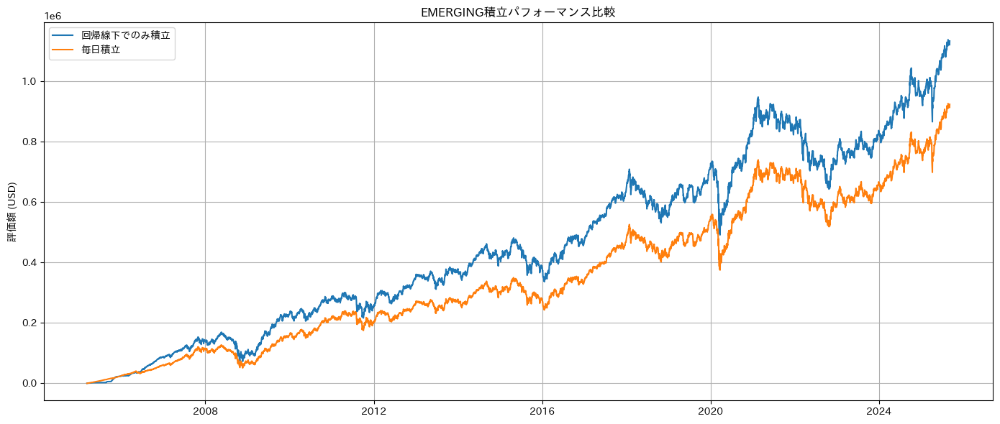


最終評価額（回帰線下でのみ積立）: $1,133,551.24
最終評価額（毎日積立）: $923,845.73

回帰線下でのみ積立：
  - 投資額: $584,916.92
  - 評価額: $1,133,551.24
  - 収益率: 193.80%

毎日積立：
  - 投資額: $515,600.00
  - 評価額: $923,845.73
  - 収益率: 179.18%
  -回帰直線の下にある割合 : 63.48%


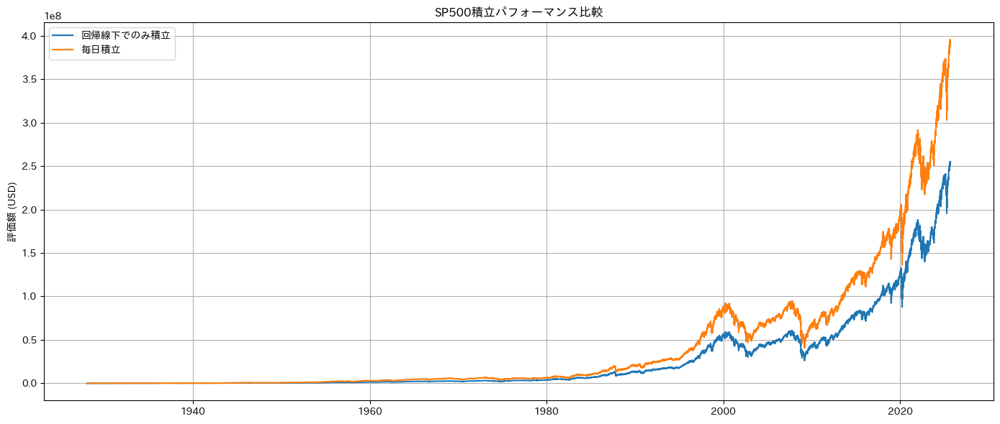


最終評価額（回帰線下でのみ積立）: $254,342,409.22
最終評価額（毎日積立）: $394,265,921.92

回帰線下でのみ積立：
  - 投資額: $2,121,317.17
  - 評価額: $254,342,409.22
  - 収益率: 11989.83%

毎日積立：
  - 投資額: $2,453,600.00
  - 評価額: $394,265,921.92
  - 収益率: 16068.88%
  -回帰直線の下にある割合 : 21.74%


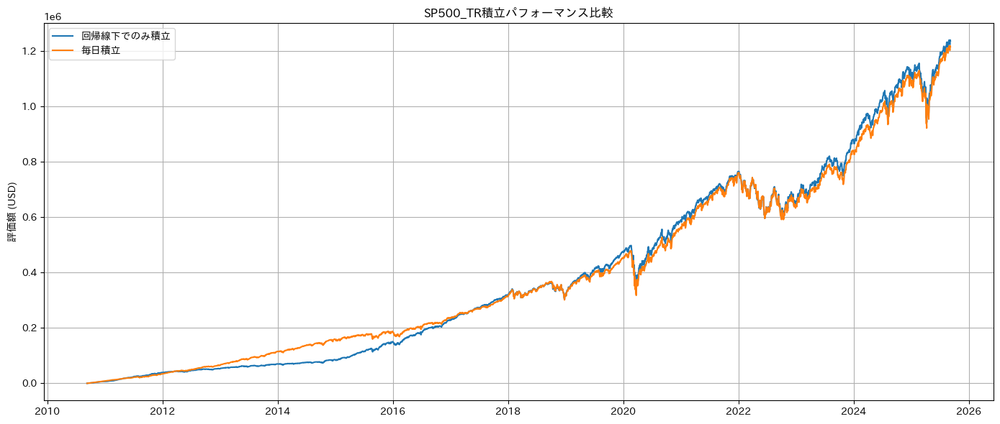


最終評価額（回帰線下でのみ積立）: $1,237,092.60
最終評価額（毎日積立）: $1,216,194.29

回帰線下でのみ積立：
  - 投資額: $384,130.46
  - 評価額: $1,237,092.60
  - 収益率: 322.05%

毎日積立：
  - 投資額: $377,100.00
  - 評価額: $1,216,194.29
  - 収益率: 322.51%
  -回帰直線の下にある割合 : 51.90%


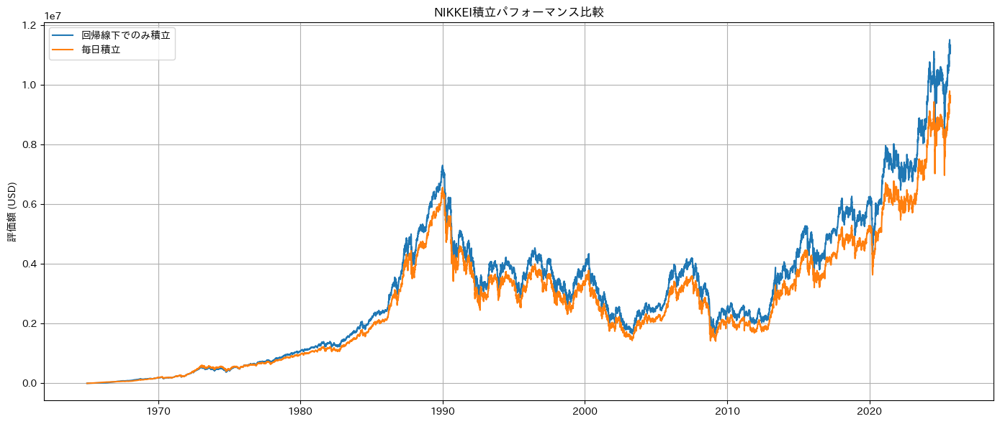


最終評価額（回帰線下でのみ積立）: $11,320,688.92
最終評価額（毎日積立）: $9,630,844.43

回帰線下でのみ積立：
  - 投資額: $1,772,082.53
  - 評価額: $11,320,688.92
  - 収益率: 638.84%

毎日積立：
  - 投資額: $1,491,900.00
  - 評価額: $9,630,844.43
  - 収益率: 645.54%
  -回帰直線の下にある割合 : 76.02%


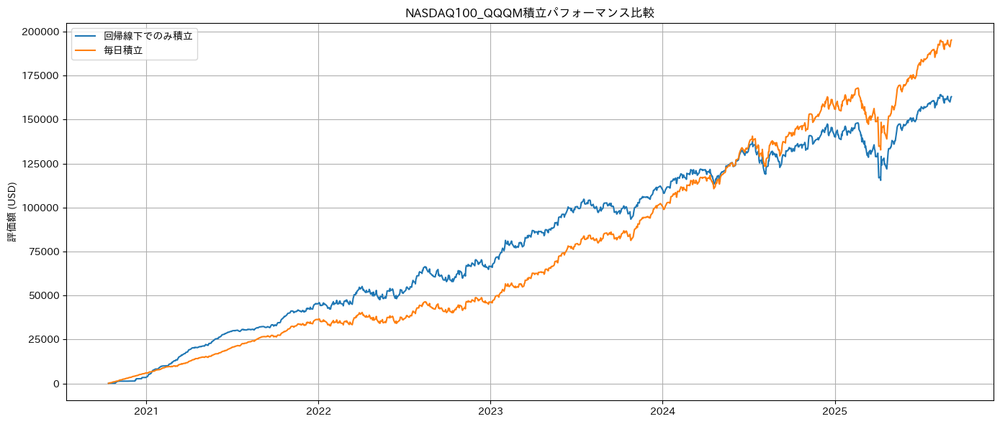


最終評価額（回帰線下でのみ積立）: $162,994.24
最終評価額（毎日積立）: $195,249.71

回帰線下でのみ積立：
  - 投資額: $88,815.76
  - 評価額: $162,994.24
  - 収益率: 183.52%

毎日積立：
  - 投資額: $123,000.00
  - 評価額: $195,249.71
  - 収益率: 158.74%
  -回帰直線の下にある割合 : 36.34%


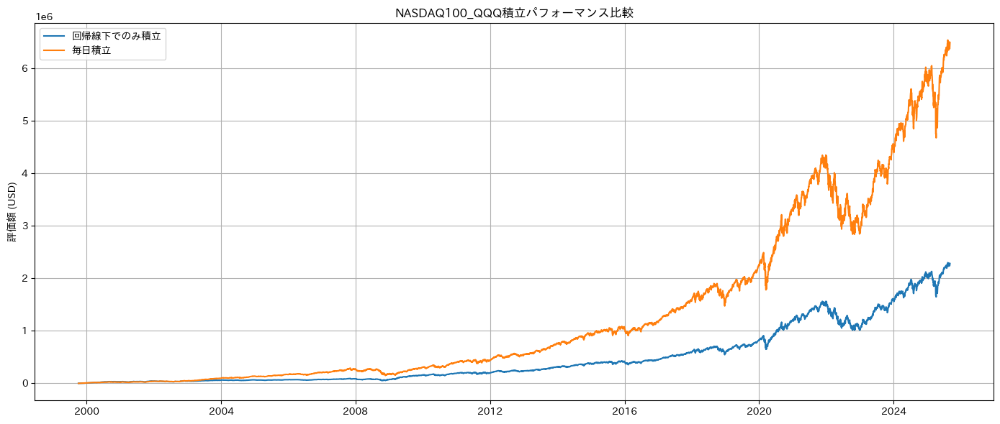


最終評価額（回帰線下でのみ積立）: $2,283,255.55
最終評価額（毎日積立）: $6,497,442.61

回帰線下でのみ積立：
  - 投資額: $132,688.37
  - 評価額: $2,283,255.55
  - 収益率: 1720.77%

毎日積立：
  - 投資額: $652,100.00
  - 評価額: $6,497,442.61
  - 収益率: 996.39%
  -回帰直線の下にある割合 : 11.26%


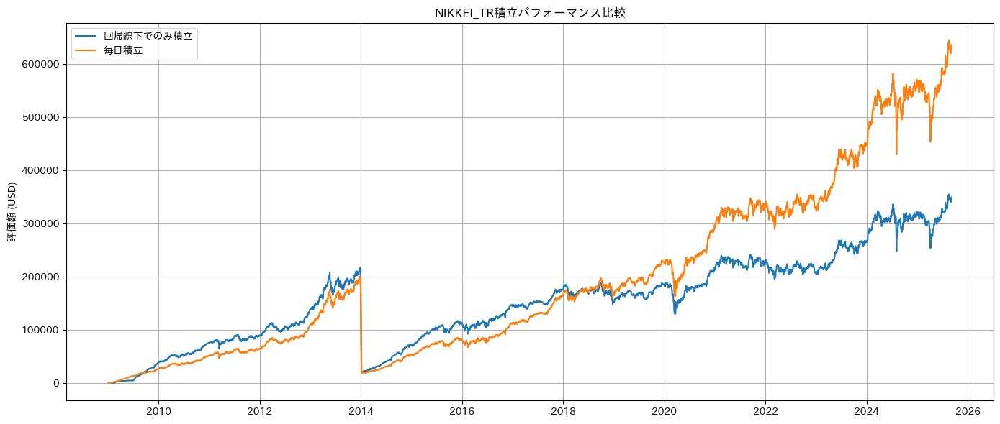


最終評価額（回帰線下でのみ積立）: $349,467.47
最終評価額（毎日積立）: $636,182.03

回帰線下でのみ積立：
  - 投資額: $223,199.52
  - 評価額: $349,467.47
  - 収益率: 156.57%

毎日積立：
  - 投資額: $409,600.00
  - 評価額: $636,182.03
  - 収益率: 155.32%
  -回帰直線の下にある割合 : 34.50%


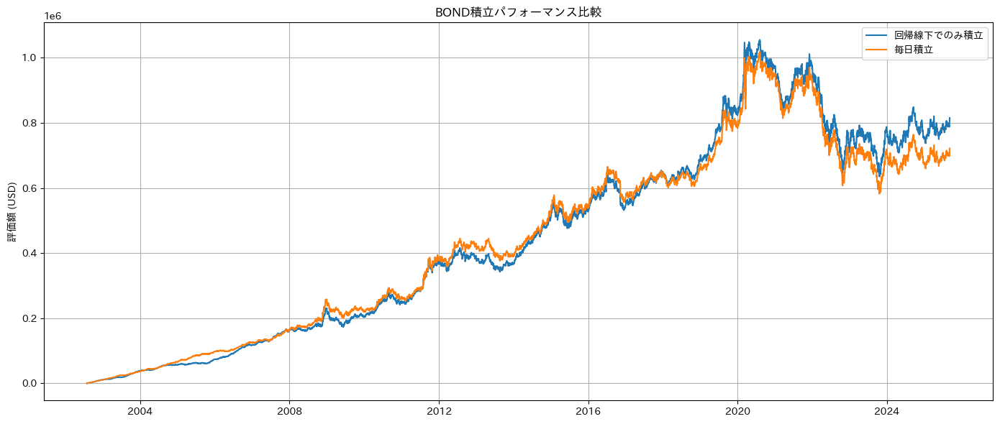


最終評価額（回帰線下でのみ積立）: $815,379.11
最終評価額（毎日積立）: $721,974.92

回帰線下でのみ積立：
  - 投資額: $674,474.03
  - 評価額: $815,379.11
  - 収益率: 120.89%

毎日積立：
  - 投資額: $581,400.00
  - 評価額: $721,974.92
  - 収益率: 124.18%
  -回帰直線の下にある割合 : 61.25%


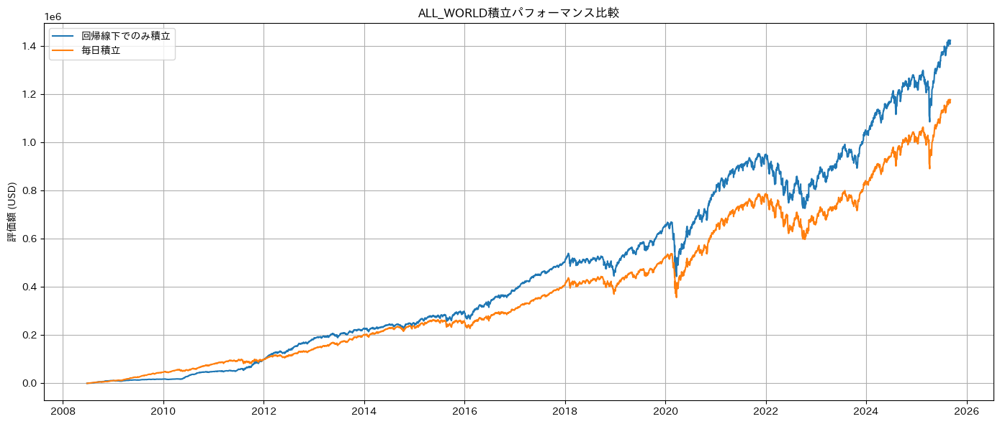


最終評価額（回帰線下でのみ積立）: $1,423,141.03
最終評価額（毎日積立）: $1,176,955.92

回帰線下でのみ積立：
  - 投資額: $501,012.58
  - 評価額: $1,423,141.03
  - 収益率: 284.05%

毎日積立：
  - 投資額: $432,600.00
  - 評価額: $1,176,955.92
  - 収益率: 272.07%
  -回帰直線の下にある割合 : 46.97%


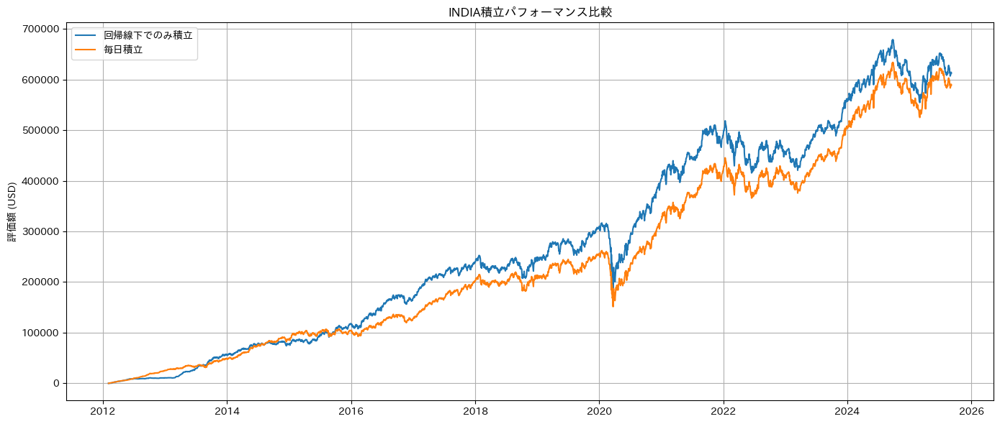


最終評価額（回帰線下でのみ積立）: $612,616.52
最終評価額（毎日積立）: $589,123.53

回帰線下でのみ積立：
  - 投資額: $308,338.18
  - 評価額: $612,616.52
  - 収益率: 198.68%

毎日積立：
  - 投資額: $341,700.00
  - 評価額: $589,123.53
  - 収益率: 172.41%
  -回帰直線の下にある割合 : 39.77%


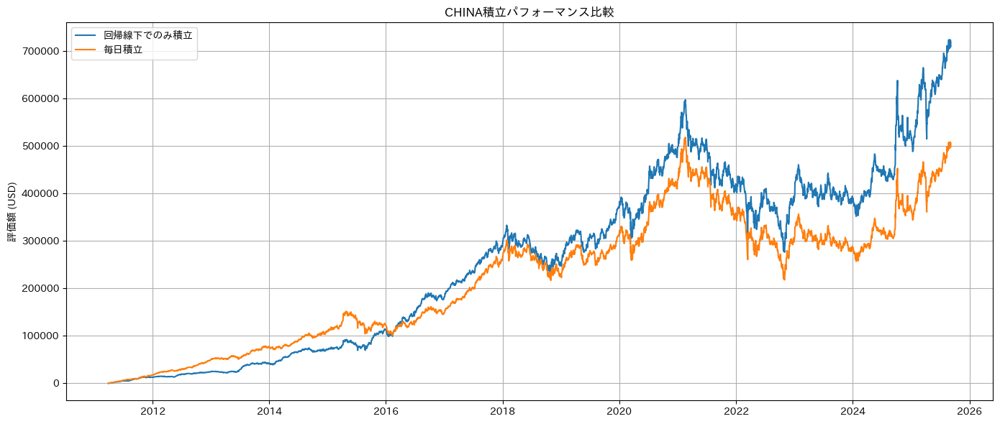


最終評価額（回帰線下でのみ積立）: $720,291.56
最終評価額（毎日積立）: $505,955.93

回帰線下でのみ積立：
  - 投資額: $499,199.95
  - 評価額: $720,291.56
  - 収益率: 144.29%

毎日積立：
  - 投資額: $363,000.00
  - 評価額: $505,955.93
  - 収益率: 139.38%
  -回帰直線の下にある割合 : 51.07%


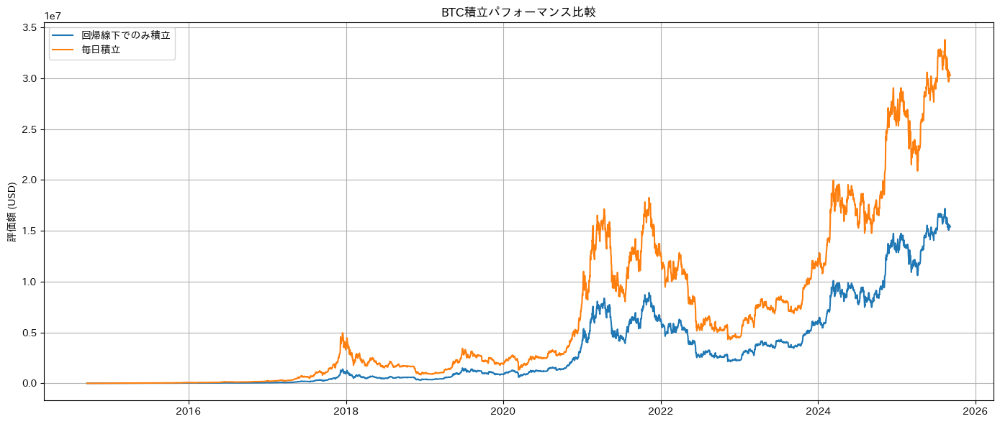


最終評価額（回帰線下でのみ積立）: $15,405,697.95
最終評価額（毎日積立）: $30,296,146.26

回帰線下でのみ積立：
  - 投資額: $692,491.71
  - 評価額: $15,405,697.95
  - 収益率: 2224.68%

毎日積立：
  - 投資額: $400,800.00
  - 評価額: $30,296,146.26
  - 収益率: 7558.92%
  -回帰直線の下にある割合 : 61.35%


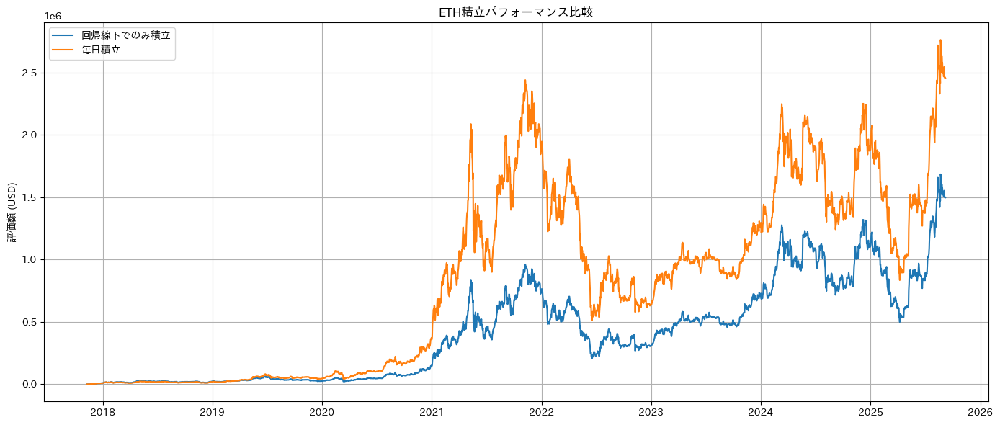


最終評価額（回帰線下でのみ積立）: $1,498,260.50
最終評価額（毎日積立）: $2,456,007.71

回帰線下でのみ積立：
  - 投資額: $335,312.56
  - 評価額: $1,498,260.50
  - 収益率: 446.83%

毎日積立：
  - 投資額: $285,900.00
  - 評価額: $2,456,007.71
  - 収益率: 859.04%
  -回帰直線の下にある割合 : 53.20%


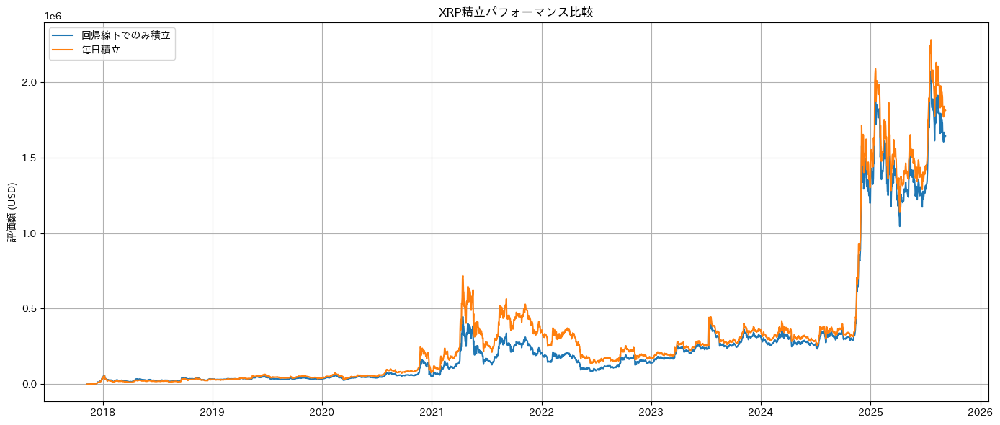


最終評価額（回帰線下でのみ積立）: $1,641,790.95
最終評価額（毎日積立）: $1,811,451.83

回帰線下でのみ積立：
  - 投資額: $221,141.47
  - 評価額: $1,641,790.95
  - 収益率: 742.42%

毎日積立：
  - 投資額: $285,900.00
  - 評価額: $1,811,451.83
  - 収益率: 633.60%
  -回帰直線の下にある割合 : 37.29%


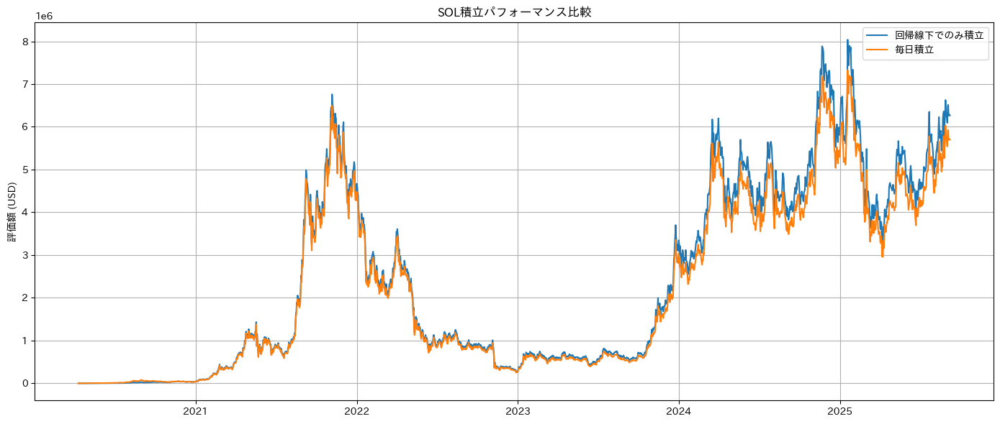


最終評価額（回帰線下でのみ積立）: $6,265,824.40
最終評価額（毎日積立）: $5,698,834.40

回帰線下でのみ積立：
  - 投資額: $258,695.93
  - 評価額: $6,265,824.40
  - 収益率: 2422.08%

毎日積立：
  - 投資額: $197,600.00
  - 評価額: $5,698,834.40
  - 収益率: 2884.03%
  -回帰直線の下にある割合 : 65.44%


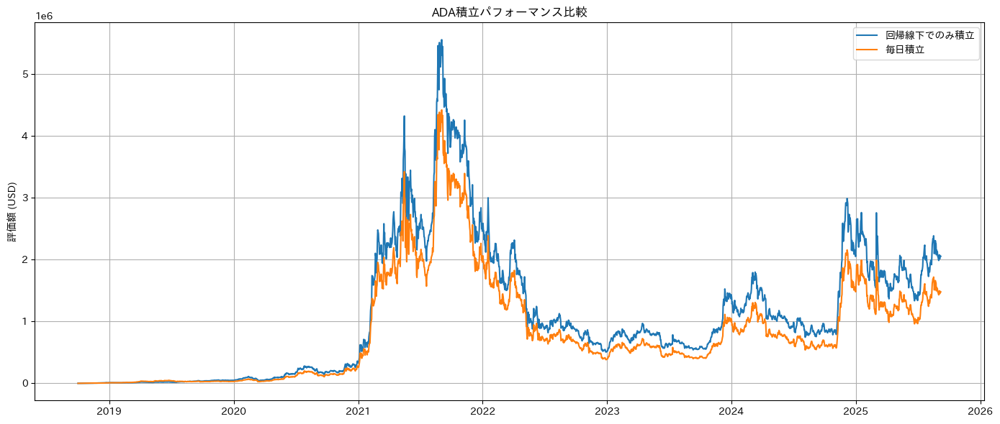


最終評価額（回帰線下でのみ積立）: $2,052,292.54
最終評価額（毎日積立）: $1,477,474.92

回帰線下でのみ積立：
  - 投資額: $368,058.77
  - 評価額: $2,052,292.54
  - 収益率: 557.60%

毎日積立：
  - 投資額: $253,300.00
  - 評価額: $1,477,474.92
  - 収益率: 583.29%
  -回帰直線の下にある割合 : 63.60%


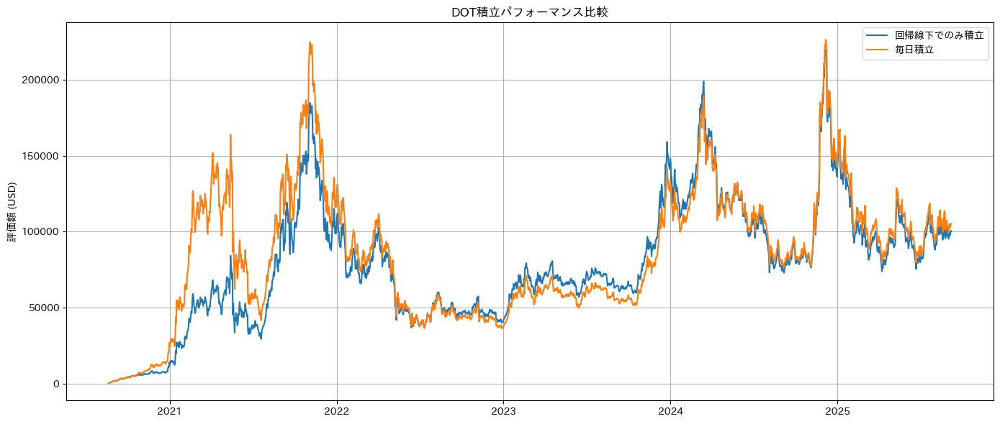


最終評価額（回帰線下でのみ積立）: $100,421.07
最終評価額（毎日積立）: $105,196.77

回帰線下でのみ積立：
  - 投資額: $189,463.21
  - 評価額: $100,421.07
  - 収益率: 53.00%

毎日積立：
  - 投資額: $184,400.00
  - 評価額: $105,196.77
  - 収益率: 57.05%
  -回帰直線の下にある割合 : 67.41%


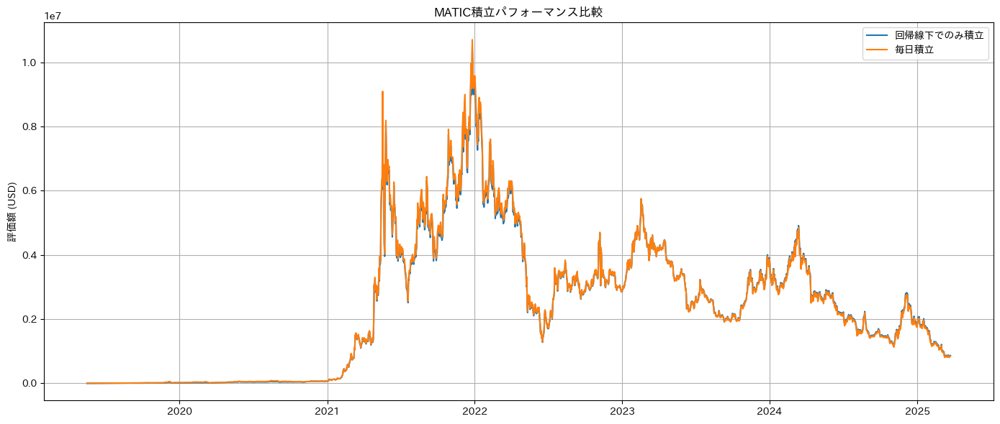


最終評価額（回帰線下でのみ積立）: $866,228.16
最終評価額（毎日積立）: $844,125.86

回帰線下でのみ積立：
  - 投資額: $304,238.63
  - 評価額: $866,228.16
  - 収益率: 284.72%

毎日積立：
  - 投資額: $213,900.00
  - 評価額: $844,125.86
  - 収益率: 394.64%
  -回帰直線の下にある割合 : 64.05%


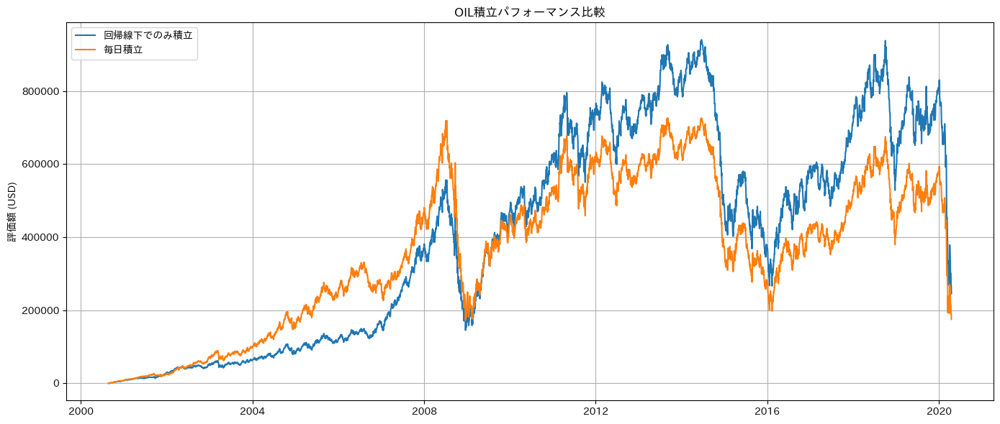


最終評価額（回帰線下でのみ積立）: $245,392.07
最終評価額（毎日積立）: $175,251.78

回帰線下でのみ積立：
  - 投資額: $780,772.00
  - 評価額: $245,392.07
  - 収益率: 31.43%

毎日積立：
  - 投資額: $493,100.00
  - 評価額: $175,251.78
  - 収益率: 35.54%
  -回帰直線の下にある割合 : 66.84%


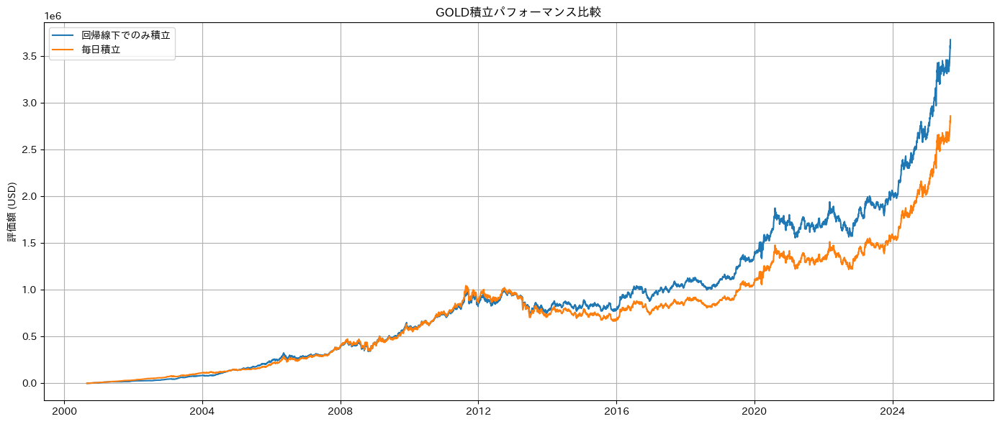


最終評価額（回帰線下でのみ積立）: $3,676,829.52
最終評価額（毎日積立）: $2,860,545.64

回帰線下でのみ積立：
  - 投資額: $914,726.42
  - 評価額: $3,676,829.52
  - 収益率: 401.96%

毎日積立：
  - 投資額: $627,700.00
  - 評価額: $2,860,545.64
  - 収益率: 455.72%
  -回帰直線の下にある割合 : 61.32%


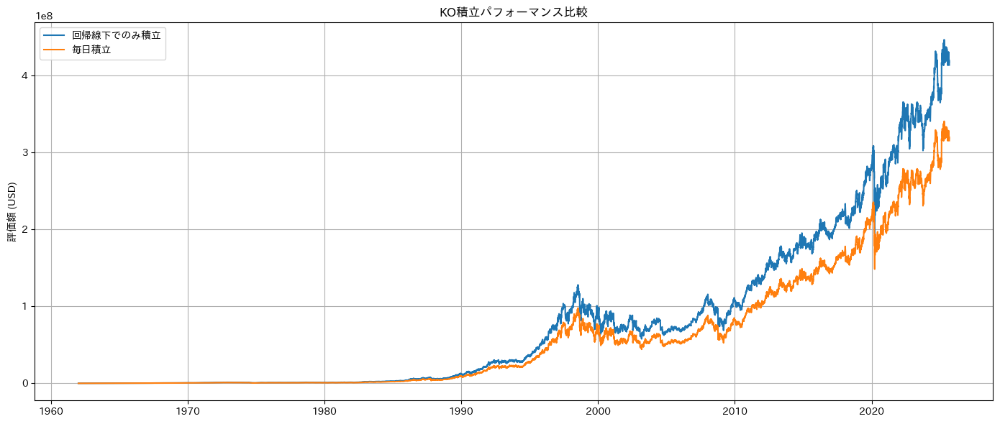


最終評価額（回帰線下でのみ積立）: $413,273,930.98
最終評価額（毎日積立）: $315,190,290.94

回帰線下でのみ積立：
  - 投資額: $2,044,865.03
  - 評価額: $413,273,930.98
  - 収益率: 20210.33%

毎日積立：
  - 投資額: $1,602,700.00
  - 評価額: $315,190,290.94
  - 収益率: 19666.21%
  -回帰直線の下にある割合 : 61.07%


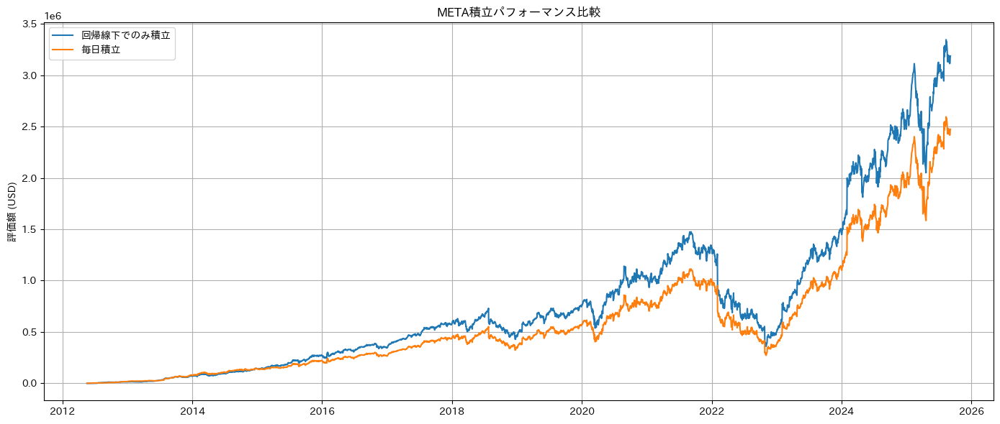


最終評価額（回帰線下でのみ積立）: $3,187,196.45
最終評価額（毎日積立）: $2,473,532.27

回帰線下でのみ積立：
  - 投資額: $419,711.05
  - 評価額: $3,187,196.45
  - 収益率: 759.38%

毎日積立：
  - 投資額: $334,400.00
  - 評価額: $2,473,532.27
  - 収益率: 739.69%
  -回帰直線の下にある割合 : 73.50%


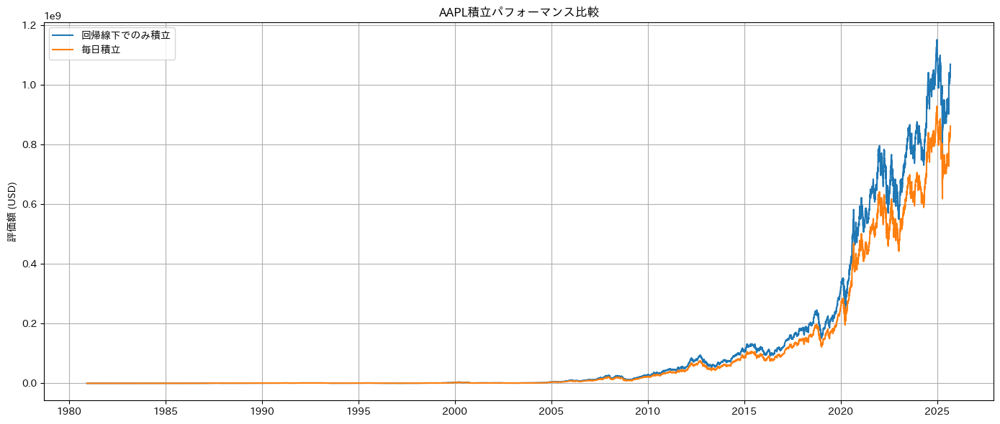


最終評価額（回帰線下でのみ積立）: $1,069,324,068.96
最終評価額（毎日積立）: $862,266,187.49

回帰線下でのみ積立：
  - 投資額: $729,640.41
  - 評価額: $1,069,324,068.96
  - 収益率: 146554.94%

毎日積立：
  - 投資額: $1,127,400.00
  - 評価額: $862,266,187.49
  - 収益率: 76482.72%
  -回帰直線の下にある割合 : 34.88%


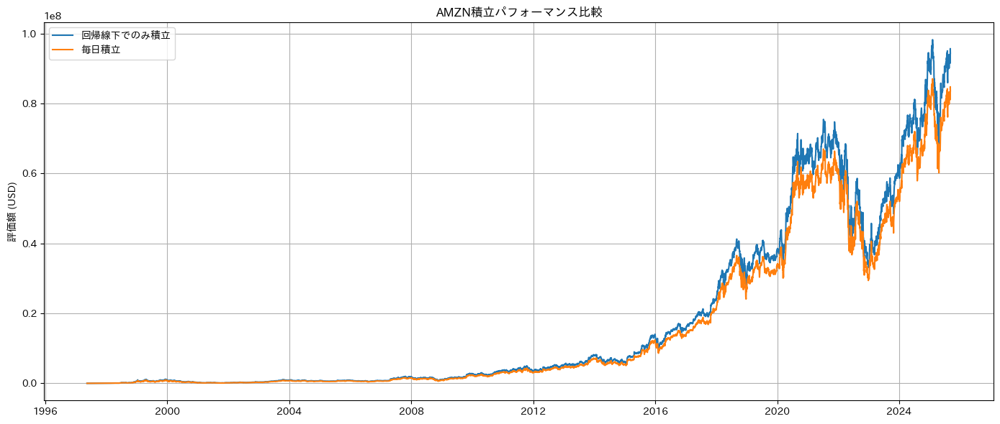


最終評価額（回帰線下でのみ積立）: $94,365,898.41
最終評価額（毎日積立）: $83,607,582.93

回帰線下でのみ積立：
  - 投資額: $537,031.75
  - 評価額: $94,365,898.41
  - 収益率: 17571.75%

毎日積立：
  - 投資額: $712,200.00
  - 評価額: $83,607,582.93
  - 収益率: 11739.34%
  -回帰直線の下にある割合 : 41.20%


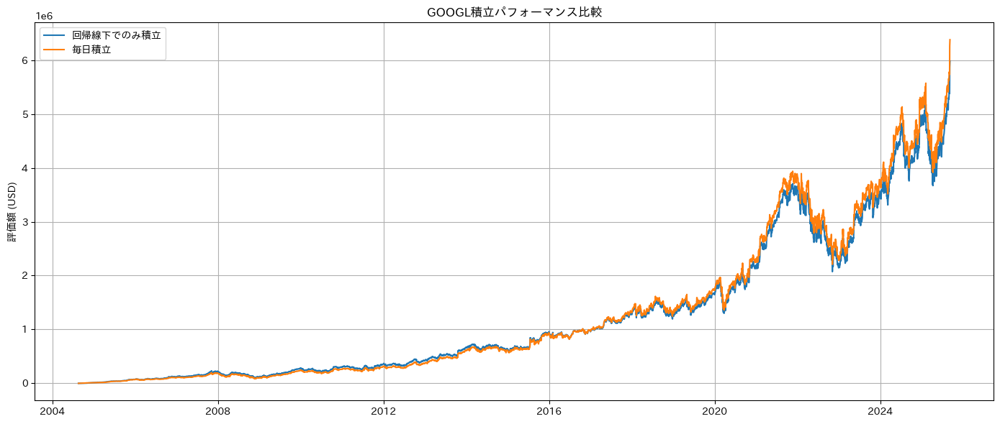


最終評価額（回帰線下でのみ積立）: $5,982,500.37
最終評価額（毎日積立）: $6,379,442.57

回帰線下でのみ積立：
  - 投資額: $345,969.93
  - 評価額: $5,982,500.37
  - 収益率: 1729.20%

毎日積立：
  - 投資額: $529,600.00
  - 評価額: $6,379,442.57
  - 収益率: 1204.58%
  -回帰直線の下にある割合 : 45.83%


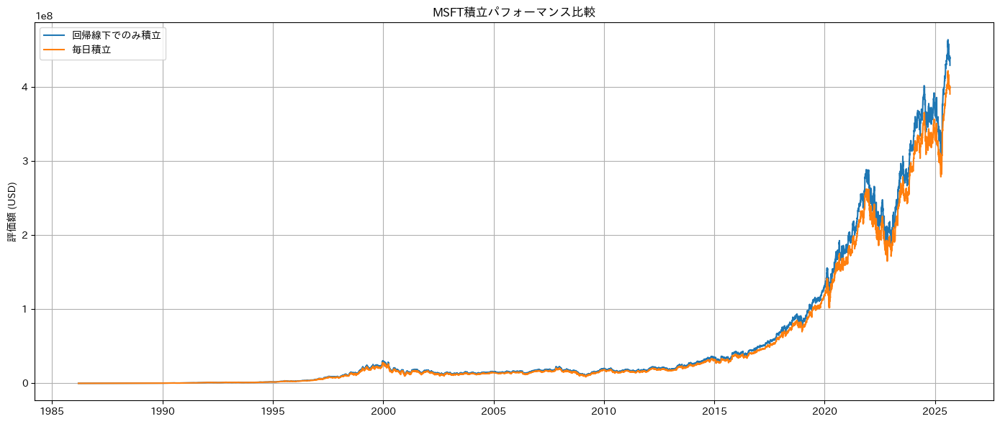


最終評価額（回帰線下でのみ積立）: $428,840,268.67
最終評価額（毎日積立）: $390,080,227.24

回帰線下でのみ積立：
  - 投資額: $1,054,104.06
  - 評価額: $428,840,268.67
  - 収益率: 40682.92%

毎日積立：
  - 投資額: $994,800.00
  - 評価額: $390,080,227.24
  - 収益率: 39211.92%
  -回帰直線の下にある割合 : 71.15%


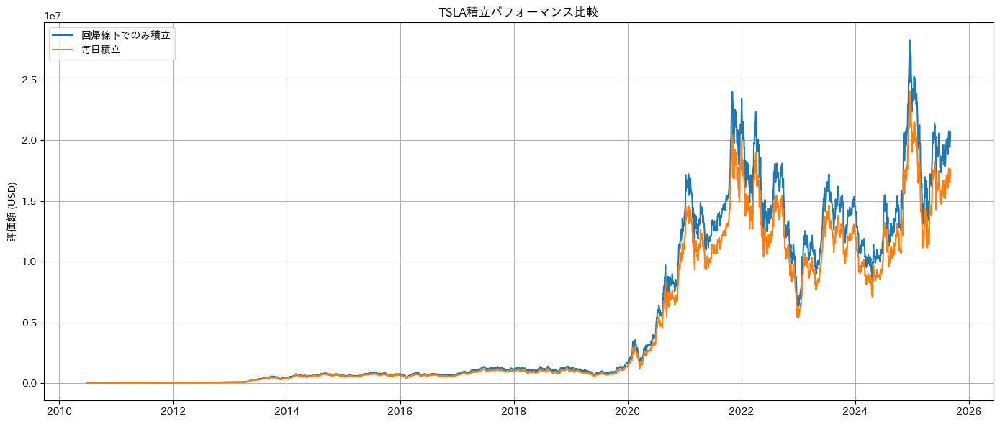


最終評価額（回帰線下でのみ積立）: $20,709,316.30
最終評価額（毎日積立）: $17,620,607.81

回帰線下でのみ積立：
  - 投資額: $421,344.52
  - 評価額: $20,709,316.30
  - 収益率: 4915.06%

毎日積立：
  - 投資額: $382,100.00
  - 評価額: $17,620,607.81
  - 収益率: 4611.52%
  -回帰直線の下にある割合 : 63.91%


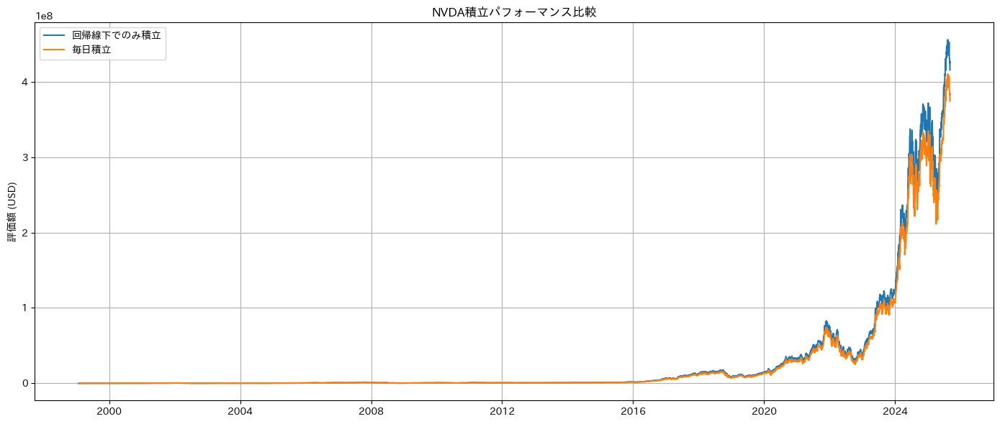


最終評価額（回帰線下でのみ積立）: $415,595,311.82
最終評価額（毎日積立）: $374,190,321.56

回帰線下でのみ積立：
  - 投資額: $483,854.54
  - 評価額: $415,595,311.82
  - 収益率: 85892.61%

毎日積立：
  - 投資額: $669,700.00
  - 評価額: $374,190,321.56
  - 収益率: 55874.32%
  -回帰直線の下にある割合 : 45.24%


In [ ]:
for name, data in data_dict.items():
    data = data.copy()
    log_trend_list = []

    log_close = np.log(data['Close'])#.dropna()
    dates = log_close.index
    x = (dates - dates[0]).days.values  # 日数

    # 対数価格
    data['log_price'] = np.log(data['Close'])

    for i in range(len(data)):
        if i < 2:  # 最低日数のしきい値
            log_trend_list.append(1000000000)
            continue

        # x = np.arange(i + 1)
        # y = data['log_price'].iloc[:i + 1].values
        # slope, intercept, *_ = linregress(x, y)
        # trend_today = intercept + slope * x[-1]

        y = log_close.iloc[:i + 1].values.ravel()
        slope, intercept, *_ = linregress(x[:i + 1], y)
        trend_today = intercept + slope * x[i]

        log_trend_list.append(trend_today)

    data['log_trend_dynamic'] = log_trend_list
    # ① 回帰線より下のときのみ積立
    data['buy_conditional'] = data['log_price'] < data['log_trend_dynamic']

    data['investment_amount_conditional'] = pd.Series(
        np.where(
            data['buy_conditional'].values,
            investment_amount / (data['buy_conditional'].expanding().mean()),
            0.0
        ),
        index=data.index
    )

    data['data_units_conditional'] = data['investment_amount_conditional'] / data['Close'].squeeze()

    data['data_cum_conditional'] = data['data_units_conditional'].cumsum()
    data['total_value_conditional'] = data['data_cum_conditional'] * data['Close'].squeeze()

    # ② 毎日積立
    data['data_units_daily'] = investment_amount / data['Close'].values
    data['data_cum_daily'] = data['data_units_daily'].cumsum()
    data['total_value_daily'] = data['data_cum_daily'] * data['Close'].squeeze()

    # 結果を可視化
    plt.figure(figsize=(14, 6))
    plt.plot(data.index, data['total_value_conditional'], label='回帰線下でのみ積立')
    plt.plot(data.index, data['total_value_daily'], label='毎日積立')
    plt.title(f'{name}積立パフォーマンス比較')
    plt.ylabel('評価額 (USD)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # 最終結果の比較
    final_conditional = data['total_value_conditional'].iloc[-1]
    final_daily = data['total_value_daily'].iloc[-1]
    print(f"\n最終評価額（回帰線下でのみ積立）: ${final_conditional:,.2f}")
    print(f"最終評価額（毎日積立）: ${final_daily:,.2f}")

    total_investment_conditional = data['investment_amount_conditional'].cumsum().iloc[-1]
    total_investment_daily = len(data) * investment_amount

    return_conditional = final_conditional / total_investment_conditional
    return_daily = final_daily / total_investment_daily

    print(f"\n回帰線下でのみ積立：")
    print(f"  - 投資額: ${total_investment_conditional:,.2f}")
    print(f"  - 評価額: ${final_conditional:,.2f}")
    print(f"  - 収益率: {return_conditional:.2%}")

    print(f"\n毎日積立：")
    print(f"  - 投資額: ${total_investment_daily:,.2f}")
    print(f"  - 評価額: ${final_daily:,.2f}")
    print(f"  - 収益率: {return_daily:.2%}")

    print(f"  -回帰直線の下にある割合 : {data['buy_conditional'].mean():.2%}")

## 各年から投資を始めた際のリターンをシミュレーション

### 投資開始時点~該当時点の近似直線によるシミュレーション
(投資開始時点からの近似直線を引く)

In [ ]:
# 全カラム表示
pd.set_option('display.max_columns', None)

# 最大100行まで表示
pd.set_option('display.max_rows', 100)


In [ ]:
return_fds = {}
for name, data_all in data_dict.items():

    # 対数価格
    data_all['log_price'] = np.log(data_all['Close']).squeeze()

    min_year = data_all.index.min().year
    max_year = data_all.index.max().year

    years = []
    total_investment_conditionals = []
    final_conditionals = []
    return_conditionals = []
    total_investment_dailys = []
    final_dailys = []
    return_dailys= []
    under_trends = []
    for year in range(min_year, max_year + 1):
        data = data_all[data_all.index >= pd.Timestamp(f"{year}-01-01")].copy()
        log_trend_list = []

        x = (data.index - data.index[0]).days.values

        for i in range(len(data)):
            if i < 2:  # 最低日数のしきい値
                log_trend_list.append(1000000000)
                continue

            y = data['log_price'].iloc[:i + 1].values.ravel()
            slope, intercept, *_ = linregress(x[:i + 1], y)
            trend_today = intercept + slope * x[i]

            log_trend_list.append(trend_today)

        data['log_trend_dynamic'] = log_trend_list
        # ① 回帰線より下のときのみ積立
        data['buy_conditional'] = data['log_price'] < data['log_trend_dynamic']

        data['investment_amount_conditional'] = pd.Series(
            np.where(
                data['buy_conditional'].values,
                investment_amount / (data['buy_conditional'].expanding().mean()),
                0.0
            ),
            index=data.index
        )

        data['data_units_conditional'] = data['investment_amount_conditional'] / data['Close'].squeeze()

        data['data_cum_conditional'] = data['data_units_conditional'].cumsum()
        data['total_value_conditional'] = data['data_cum_conditional'] * data['Close'].squeeze()

        # ② 毎日積立
        data['data_units_daily'] = investment_amount / data['Close'].values
        data['data_cum_daily'] = data['data_units_daily'].cumsum()
        data['total_value_daily'] = data['data_cum_daily'] * data['Close'].squeeze()

        # 最終結果の比較
        final_conditional = data['total_value_conditional'].iloc[-1]
        final_daily = data['total_value_daily'].iloc[-1]

        total_investment_conditional = (data['investment_amount_conditional']).cumsum().iloc[-1]
        total_investment_daily = len(data) * investment_amount

        return_conditional = final_conditional / total_investment_conditional
        return_daily = final_daily / total_investment_daily
        under_trend = data['buy_conditional'].mean()

        years.append(year)
        total_investment_conditionals.append(total_investment_conditional)
        final_conditionals.append(final_conditional)
        return_conditionals.append(return_conditional)
        total_investment_dailys.append(total_investment_daily)
        final_dailys.append(final_daily)
        return_dailys.append(return_daily)
        under_trends.append(under_trend)


    return_df = pd.DataFrame({
        "年" : years,
        "回帰線下投資額" :total_investment_conditionals,
        "毎日積立投資額" :total_investment_dailys,
        "回帰線下評価額" :final_conditionals,
        "毎日積立評価額" :final_dailys,
        "回帰線下収益率" :return_conditionals,
        "毎日積立収益率" :return_dailys,
        "回帰直線の下にある割合" :under_trends,
    })

    return_df["回帰線下投資の勝利"] = return_df["回帰線下収益率"] >= return_df["毎日積立収益率"]

    print(f"{name} 勝率->{return_df["回帰線下投資の勝利"].mean()}")
    display(return_df)
    return_fds[name] = return_df


EMERGING 勝率->0.9523809523809523


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2005,584916.924415,515600,1.133551e+06,923845.728928,1.937970,1.791788,0.634794,True
1,2006,520846.049877,495000,9.702026e+05,853563.238316,1.862743,1.724370,0.492323,True
2,2007,454832.126150,469900,8.173214e+05,788756.354941,1.796974,1.678562,0.432645,True
3,2008,479439.084894,444800,8.493651e+05,741030.038781,1.771581,1.665985,0.508993,True
4,2009,362222.955074,419500,6.336067e+05,684011.616744,1.749217,1.630540,0.665316,True
5,2010,352481.343911,394300,5.924766e+05,617584.833159,1.680874,1.566282,0.402739,True
6,2011,361550.787962,369100,5.949040e+05,570551.452204,1.645423,1.545791,0.336494,True
7,2012,315396.175639,343900,5.121839e+05,526432.901925,1.623938,1.530773,0.412620,True
8,2013,337178.393483,318900,5.374186e+05,480886.968110,1.593870,1.507955,0.394167,True
9,2014,307207.078844,293700,4.740261e+05,436471.083748,1.543018,1.486112,0.451822,True


KeyboardInterrupt: 

### データ最古~該当時点の近似直線によるシミュレーション
最も古い年月日を始点として回帰直線を引く

In [ ]:
return_dfs = {}

for name, data_all in data_dict.items():

    # 対数価格
    data_all['log_price'] = np.log(data_all['Close']).squeeze()

    min_year = data_all.index.min().year
    max_year = data_all.index.max().year

    log_trend_list = []

    x = (data_all.index - data_all.index[0]).days.values

    for i in range(len(data_all)):
        if i < 2:  # 最低日数のしきい値
            log_trend_list.append(10 ** 12)
            continue

        # x = np.arange(i + 1)

        y = data_all['log_price'].iloc[:i + 1].values.ravel()
        slope, intercept, *_ = linregress(x[:i + 1], y)
        trend_today = intercept + slope * x[i]
        log_trend_list.append(trend_today)

    data_all['log_trend_dynamic'] = log_trend_list

    years = []
    total_investment_conditionals = []
    final_conditionals = []
    return_conditionals = []
    total_investment_dailys = []
    final_dailys = []
    return_dailys= []
    under_trends = []

    for year in range(min_year, max_year + 1):
        data = data_all[data_all.index >= pd.Timestamp(f"{year}-01-01")].copy()
        log_trend_list = []



        # ① 回帰線より下のときのみ積立
        data['buy_conditional'] = data['log_price'] < data['log_trend_dynamic']

        data['investment_amount_conditional'] = pd.Series(
            np.where(
                data['buy_conditional'].values,
                investment_amount / (data['buy_conditional'].expanding().mean()),
                0.0
            ),
            index=data.index
        )

        data['data_units_conditional'] = data['investment_amount_conditional'] / data['Close'].squeeze()


        data['data_cum_conditional'] = data['data_units_conditional'].cumsum()
        data['total_value_conditional'] = data['data_cum_conditional'] * data['Close'].squeeze()

        # ② 毎日積立
        data['data_units_daily'] = investment_amount / data['Close'].values
        data['data_cum_daily'] = data['data_units_daily'].cumsum()
        data['total_value_daily'] = data['data_cum_daily'] * data['Close'].squeeze()

        # 最終結果の比較
        final_conditional = data['total_value_conditional'].iloc[-1]
        final_daily = data['total_value_daily'].iloc[-1]

        total_investment_conditional = (data['investment_amount_conditional']).cumsum().iloc[-1]
        total_investment_daily = len(data) * investment_amount

        return_conditional = final_conditional / total_investment_conditional
        return_daily = final_daily / total_investment_daily
        under_trend = data['buy_conditional'].mean()

        years.append(year)
        total_investment_conditionals.append(total_investment_conditional)
        final_conditionals.append(final_conditional)
        return_conditionals.append(return_conditional)
        total_investment_dailys.append(total_investment_daily)
        final_dailys.append(final_daily)
        return_dailys.append(return_daily)
        under_trends.append(under_trend)

    return_df = pd.DataFrame({
        "年" : years,
        "回帰線下投資額" :total_investment_conditionals,
        "毎日積立投資額" :total_investment_dailys,
        "回帰線下評価額" :final_conditionals,
        "毎日積立評価額" :final_dailys,
        "回帰線下収益率" :return_conditionals,
        "毎日積立収益率" :return_dailys,
        "回帰直線の下にある割合" :under_trends,
    })

    return_df["回帰線下投資の勝利"] = return_df["回帰線下収益率"] >= return_df["毎日積立収益率"]

    print(f"{name} 勝率->{return_df["回帰線下投資の勝利"].mean()}")
    display(return_df)
    return_dfs[name] = return_df

EMERGING 勝率->1.0


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2005,584916.924415,515600,1.133551e+06,923845.726877,1.937970,1.791788,0.634794,True
1,2006,528827.863797,495000,9.944818e+05,853563.237138,1.880540,1.724370,0.651717,True
2,2007,489399.079717,469900,8.815347e+05,788756.353168,1.801259,1.678562,0.654395,True
3,2008,408821.360517,444800,7.173392e+05,741030.038847,1.754652,1.665985,0.677158,True
4,2009,412723.329177,419500,7.121737e+05,684011.617549,1.725547,1.630540,0.658641,True
5,2010,444806.893488,394300,7.564796e+05,617584.833739,1.700692,1.566282,0.654831,True
6,2011,410131.761339,369100,6.914920e+05,570551.453591,1.686024,1.545791,0.685722,True
7,2012,277230.056582,343900,4.483249e+05,526432.902896,1.617159,1.530773,0.705728,True
8,2013,259442.340014,318900,4.137515e+05,480886.969907,1.594773,1.507955,0.682973,True
9,2014,239425.335626,293700,3.765132e+05,436471.084242,1.572570,1.486112,0.657133,True


SP500 勝率->0.6868686868686869


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditi

,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,1927,2.121317e+06,2453600,2.543424e+08,3.942659e+08,119.898341,160.688752,0.217436,False
1,1928,2.122389e+06,2453500,2.545732e+08,3.942292e+08,119.946560,160.680343,0.217404,False
2,1929,2.121532e+06,2428500,2.411834e+08,3.860303e+08,113.683576,158.958325,0.215730,False
3,1930,2.125761e+06,2403600,2.262049e+08,3.797588e+08,106.411246,157.995856,0.212515,False
4,1931,2.310440e+06,2378500,2.471433e+08,3.718512e+08,106.968084,156.338542,0.204204,False
5,1932,2.590820e+06,2353300,2.871541e+08,3.592515e+08,110.835230,152.658600,0.195683,False
6,1933,3.132695e+06,2328300,4.214315e+08,3.348132e+08,134.526834,143.801589,0.187175,False
7,1934,3.736182e+06,2304100,7.729868e+08,3.167052e+08,206.892166,137.452872,0.186277,True
8,1935,3.513530e+06,2279200,6.570894e+08,3.001710e+08,187.016857,131.700151,0.188312,True
9,1936,3.289984e+06,2254200,5.407265e+08,2.845274e+08,164.355350,126.221015,0.190400,True


SP500_TR 勝率->0.9375


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2010,384130.463747,377100,1.237093e+06,1.216194e+06,3.220501,3.225124,0.518960,False
1,2011,381683.350970,369100,1.203795e+06,1.159105e+06,3.153909,3.140354,0.518017,True
2,2012,504897.665452,343900,1.657275e+06,9.922654e+05,3.282398,2.885331,0.492585,True
3,2013,589124.016495,318900,1.926320e+06,8.435482e+05,3.269804,2.645181,0.516776,True
4,2014,387906.130578,293700,1.185432e+06,7.201711e+05,3.055977,2.452064,0.561117,True
5,2015,213340.776397,268500,5.472520e+05,6.174700e+05,2.565154,2.299702,0.608566,True
6,2016,184657.478407,243300,4.305174e+05,5.227727e+05,2.331438,2.148675,0.581176,True
7,2017,177280.076132,218100,3.770401e+05,4.313941e+05,2.126805,1.977965,0.532783,True
8,2018,190708.550153,193000,3.993098e+05,3.551675e+05,2.093822,1.840246,0.503109,True
9,2019,128721.574203,167900,2.376501e+05,2.885309e+05,1.846233,1.718469,0.510423,True


NIKKEI 勝率->0.8852459016393442


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,1965,1.772083e+06,1491900,1.132069e+07,9.630844e+06,6.388353,6.455422,0.760172,False
1,1966,1.747024e+06,1467600,1.111009e+07,8.755503e+06,6.359437,5.965865,0.767103,True
2,1967,1.671247e+06,1443100,8.858020e+06,8.042232e+06,5.300245,5.572886,0.770009,False
3,1968,1.753146e+06,1418400,9.390678e+06,7.287600e+06,5.356472,5.137902,0.766004,True
4,1969,1.876038e+06,1393800,1.211815e+07,6.595920e+06,6.459437,4.732329,0.772421,True
5,1970,1.635420e+06,1369400,8.440272e+06,6.057220e+06,5.160920,4.423266,0.786184,True
6,1971,1.590598e+06,1344600,7.376911e+06,5.568014e+06,4.637823,4.141019,0.790421,True
7,1972,1.787331e+06,1320300,9.321876e+06,5.128883e+06,5.215528,3.884635,0.796258,True
8,1973,1.543358e+06,1295500,7.193827e+06,4.835845e+06,4.661152,3.732802,0.811501,True
9,1974,1.323429e+06,1271000,5.281530e+06,4.613400e+06,3.990793,3.629741,0.826200,True


NASDAQ100_QQQM 勝率->1.0


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2020,88815.755738,123000,162994.235562,195249.706933,1.835195,1.587396,0.363415,True
1,2021,68363.479840,117400,124784.828689,183944.950793,1.825314,1.566822,0.373935,True
2,2022,32838.077811,92200,61263.019666,141361.017253,1.865609,1.533200,0.330803,True
3,2023,20225.891126,67100,29796.712392,93243.272683,1.473197,1.389617,0.080477,True
4,2024,101265.879953,42100,132758.126261,50458.582069,1.310986,1.198541,0.030879,True
5,2025,21126.509324,16900,27688.106065,18852.113412,1.310586,1.115510,0.076923,True


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditi

NASDAQ100_QQQ 勝率->0.4074074074074074


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,1999,132688.368905,652100,2.283256e+06,6.497443e+06,17.207654,9.963875,0.112559,True
1,2000,115458.772770,645800,2.113326e+06,6.437685e+06,18.303725,9.968544,0.110561,True
2,2001,113591.253506,620600,2.469231e+06,6.242591e+06,21.737858,10.058961,0.076055,True
3,2002,193084.228480,595800,4.395596e+06,5.840921e+06,22.765173,9.803493,0.043974,True
4,2003,823618.426404,570600,1.734484e+07,5.227121e+06,21.059310,9.160746,0.025938,True
5,2004,683057.803087,545400,1.438727e+07,4.652205e+06,21.063029,8.529896,0.027136,True
6,2005,542497.179770,520200,1.142970e+07,4.180611e+06,21.068675,8.036545,0.028451,True
7,2006,401936.556453,495000,8.472127e+06,3.737178e+06,21.078269,7.549854,0.029899,True
8,2007,261933.713388,469900,5.526294e+06,3.322410e+06,21.098062,7.070462,0.031496,True
9,2008,121930.870322,444800,2.580460e+06,2.969669e+06,21.163306,6.676415,0.033273,True


NIKKEI_TR 勝率->0.47058823529411764


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditi

,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2009,223199.523672,409600,354935.324144,646666.058065,1.590215,1.578775,0.344971,True
1,2010,164322.968426,385400,311418.004004,632635.286471,1.895158,1.641503,0.335236,True
2,2011,153949.151873,361100,325873.950039,619595.258528,2.116764,1.715855,0.294932,True
3,2012,143826.643805,336600,361445.047310,605587.602517,2.513060,1.799131,0.251634,True
4,2013,239855.262008,311800,756093.765294,590998.830080,3.152292,1.895442,0.216485,True
5,2014,67503.407407,287500,193149.762420,581394.254880,2.861334,2.022241,0.234783,True
6,2015,43105.336427,263100,113133.727732,501372.669764,2.624588,1.905635,0.163816,True
7,2016,18712.299465,238700,53010.125750,441229.032813,2.832903,1.848467,0.078341,True
8,2017,0.000000,214200,0.000000,373126.943097,NaN,1.741956,0.000000,False
9,2018,0.000000,189000,0.000000,314803.130496,NaN,1.665625,0.000000,False


BOND 勝率->0.75


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2002,674474.030787,581400,815379.114104,721974.910927,1.208911,1.241787,0.612487,False
1,2003,683928.631172,570600,825142.398554,698028.720718,1.206474,1.223324,0.610235,False
2,2004,694859.769932,545400,828038.021759,644523.635487,1.191662,1.181745,0.608728,True
3,2005,727445.025828,520200,891559.779826,593073.975740,1.225604,1.140088,0.621107,True
4,2006,563732.357232,495000,613049.214419,546777.783400,1.087483,1.104602,0.642828,False
5,2007,570993.012564,469900,604076.893944,500649.327148,1.057941,1.065438,0.635454,False
6,2008,652188.617156,444800,717015.570687,457006.697355,1.099399,1.027443,0.633318,True
7,2009,544793.294429,419500,570934.508153,418021.765528,1.047984,0.996476,0.665077,True
8,2010,477596.046306,394300,467632.418745,381562.138262,0.979138,0.967695,0.672331,True
9,2011,462493.164359,369100,442353.458285,345992.476181,0.956454,0.937395,0.681116,True


ALL_WORLD 勝率->1.0


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2008,501012.577072,432600,1.423141e+06,1.176956e+06,2.840530,2.720656,0.469718,True
1,2009,592470.730409,419500,1.833945e+06,1.111156e+06,3.095418,2.648763,0.465554,True
2,2010,467306.538027,394300,1.332826e+06,9.746115e+05,2.852145,2.471751,0.493786,True
3,2011,401835.777743,369100,1.072292e+06,8.649697e+05,2.668483,2.343456,0.513140,True
4,2012,320225.518731,343900,7.447450e+05,7.651305e+05,2.325689,2.224863,0.513812,True
5,2013,482961.997099,318900,1.182150e+06,6.686356e+05,2.447709,2.096694,0.479147,True
6,2014,380576.291228,293700,8.962994e+05,5.867478e+05,2.355111,1.997779,0.517194,True
7,2015,222469.883751,268500,4.655851e+05,5.151503e+05,2.092801,1.918623,0.552328,True
8,2016,193783.775192,243300,3.792922e+05,4.453978e+05,1.957296,1.830653,0.531854,True
9,2017,209458.464021,218100,3.886308e+05,3.746164e+05,1.855408,1.717636,0.477762,True


INDIA 勝率->1.0


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2012,308338.175900,341700,612616.515302,589123.527057,1.986833,1.724096,0.397717,True
1,2013,276998.728500,318900,541596.169027,531350.553036,1.955230,1.666198,0.407965,True
2,2014,275364.348895,293700,516295.054799,468926.066494,1.874952,1.596616,0.391556,True
3,2015,217831.730475,268500,399521.744676,415464.057183,1.834084,1.547352,0.418250,True
4,2016,152874.191926,243300,265063.838075,365316.443154,1.733869,1.501506,0.392931,True
5,2017,186747.070869,218100,312009.835375,311314.572020,1.670762,1.427394,0.325080,True
6,2018,168223.340703,193000,278899.093500,266148.520523,1.657910,1.379008,0.344041,True
7,2019,91141.546598,167900,142408.888516,223279.523527,1.562502,1.329836,0.329363,True
8,2020,72687.606443,142700,105487.557782,180969.967353,1.451245,1.268185,0.256482,True
9,2021,253784.995347,117400,332356.558106,135371.286300,1.309599,1.153077,0.139693,True


CHINA 勝率->0.9333333333333333


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2011,499199.945350,363000,720291.559762,505955.926790,1.442892,1.393818,0.510744,True
1,2012,577461.033700,343900,859312.663919,471345.991252,1.488088,1.370590,0.511486,True
2,2013,494025.931515,318900,717521.538267,425142.387289,1.452397,1.333153,0.543744,True
3,2014,397142.381597,293700,556092.341615,382446.595435,1.400234,1.302168,0.577800,True
4,2015,383865.130875,268500,533180.696565,341742.534532,1.388979,1.272784,0.611546,True
5,2016,285132.304119,243300,378043.508279,305143.816408,1.325853,1.254187,0.628031,True
6,2017,360361.632918,218100,460580.896213,262815.249797,1.278107,1.205022,0.603851,True
7,2018,332172.292190,193000,422750.744485,230745.737919,1.272685,1.195574,0.670466,True
8,2019,206666.486139,167900,266404.295575,202845.116830,1.289054,1.208131,0.727814,True
9,2020,212592.379542,142700,269812.646447,173290.365657,1.269155,1.214368,0.735809,True


BTC 勝率->0.6666666666666666


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2014,6.924917e+05,400800,1.544796e+07,3.037927e+07,22.307797,75.796572,0.613523,False
1,2015,7.443838e+05,390200,1.139038e+07,2.712497e+07,15.301753,69.515546,0.617632,False
2,2016,1.003500e+06,353700,1.330612e+07,1.171371e+07,13.259706,33.117646,0.668363,False
3,2017,6.980534e+05,317100,8.625094e+06,4.138711e+06,12.355922,13.051755,0.745506,False
4,2018,3.934413e+05,280600,3.956860e+06,2.128789e+06,10.057054,7.586560,0.842480,True
5,2019,2.465529e+05,244100,1.570283e+06,1.536867e+06,6.368950,6.296056,0.883654,True
6,2020,2.234073e+05,207600,9.746598e+05,8.971882e+05,4.362703,4.321716,0.864644,True
7,2021,2.988462e+05,171000,9.293767e+05,4.898919e+05,3.109883,2.864865,0.843860,True
8,2022,1.345000e+05,134500,4.006040e+05,4.006040e+05,2.978469,2.978469,1.000000,True
9,2023,9.800000e+04,98000,2.380292e+05,2.380292e+05,2.428870,2.428870,1.000000,True


ETH 勝率->0.5555555555555556


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2017,335312.561210,285900,1.501878e+06,2.461938e+06,4.479039,8.611187,0.532004,False
1,2018,330191.731136,280600,1.410873e+06,2.414401e+06,4.272890,8.604422,0.532074,False
2,2019,527738.002451,244100,1.655991e+06,1.894891e+06,3.137904,7.762765,0.473576,False
3,2020,606274.536674,207600,2.065507e+06,9.690106e+05,3.406884,4.667681,0.539981,False
4,2021,494508.432677,171000,1.191950e+06,3.409375e+05,2.410373,1.993786,0.653216,True
5,2022,217252.059273,134500,5.025825e+05,2.747426e+05,2.313361,2.042696,0.830483,True
6,2023,94441.984191,98000,1.820198e+05,1.837154e+05,1.927319,1.874647,0.904082,True
7,2024,68792.203102,61500,1.097458e+05,9.494967e+04,1.595324,1.543897,0.847154,True
8,2025,23856.422246,24900,4.077788e+04,4.174703e+04,1.709304,1.676587,0.955823,True


XRP 勝率->0.8888888888888888


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2017,221141.469498,285900,1.636708e+06,1.805844e+06,7.401180,6.316348,0.372858,True
1,2018,209768.524401,280600,1.546159e+06,1.760282e+06,7.370788,6.273278,0.372773,True
2,2019,246865.540223,244100,1.978440e+06,1.561845e+06,8.014240,6.398381,0.309299,True
3,2020,259868.346487,207600,1.935621e+06,1.217632e+06,7.448466,5.865278,0.296243,True
4,2021,405917.218291,171000,2.729640e+06,7.779343e+05,6.724622,4.549323,0.322222,True
5,2022,154437.414409,134500,1.026283e+06,6.307551e+05,6.645299,4.689629,0.409665,True
6,2023,54021.624651,98000,3.182560e+05,4.073273e+05,5.891271,4.156401,0.323469,True
7,2024,45228.331136,61500,2.491717e+05,1.994335e+05,5.509195,3.242821,0.247154,True
8,2025,0.000000,24900,0.000000e+00,2.831160e+04,NaN,1.137012,0.000000,False


SOL 勝率->0.6666666666666666


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2020,258695.932192,197600,6.251129e+06,5.685468e+06,24.164001,28.772613,0.654352,False
1,2021,236663.117292,171000,1.262202e+06,1.019067e+06,5.333329,5.959459,0.683041,False
2,2022,116966.814719,134500,5.812478e+05,6.057628e+05,4.969339,4.503812,0.796283,True
3,2023,87502.429956,98000,3.791556e+05,3.943811e+05,4.333086,4.024297,0.720408,True
4,2024,132703.795690,61500,1.857145e+05,8.145724e+04,1.399466,1.324508,0.573984,True
5,2025,29178.371875,24900,3.703185e+04,3.097657e+04,1.269154,1.244039,0.923695,True


ADA 勝率->0.625


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2018,368058.770667,253300,2.048293e+06,1.474595e+06,5.565124,5.821538,0.636005,False
1,2019,431008.747740,244100,2.796342e+06,1.324124e+06,6.487900,5.424516,0.642360,True
2,2020,344451.990351,207600,8.615428e+05,7.265802e+05,2.501198,3.499905,0.671002,False
3,2021,402645.700709,171000,5.280897e+05,2.686335e+05,1.311549,1.570956,0.776608,False
4,2022,132227.442718,134500,2.397928e+05,2.409222e+05,1.813487,1.791243,0.974721,True
5,2023,95698.892806,98000,1.817387e+05,1.831020e+05,1.899068,1.868387,0.966327,True
6,2024,60026.509344,61500,9.128759e+04,9.173623e+04,1.520788,1.491646,0.946341,True
7,2025,27228.551131,24900,3.032697e+04,2.765858e+04,1.113793,1.110786,0.963855,True


DOT 勝率->0.6666666666666666


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2020,189463.210366,184400,99169.870190,103885.378224,0.523425,0.563370,0.674078,False
1,2021,209249.312579,171000,92460.588855,92988.754417,0.441868,0.543794,0.692982,False
2,2022,103174.140797,134500,72262.037572,87316.399092,0.700389,0.649193,0.695167,True
3,2023,74615.951144,98000,63799.551601,71406.037526,0.855039,0.728633,0.581633,True
4,2024,165081.803861,61500,143763.048355,44982.622225,0.870859,0.731425,0.395122,True
5,2025,44074.466500,24900,41419.573916,22058.998421,0.939763,0.885904,0.574297,True


MATIC 勝率->0.5714285714285714


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2019,304238.630837,213900,8.662282e+05,844125.857064,2.847200,3.946357,0.640486,False
1,2020,323346.143270,191000,1.248133e+06,522727.413163,3.860053,2.736793,0.669110,True
2,2021,359967.179880,154400,9.387155e+04,74983.786117,0.260778,0.485646,0.738342,False
3,2022,142263.531922,117900,4.412958e+04,38673.758964,0.310196,0.328022,0.965225,False
4,2023,81400.000000,81400,2.998218e+04,29982.179936,0.368331,0.368331,1.000000,True
5,2024,44900.000000,44900,1.985606e+04,19856.055014,0.442228,0.442228,1.000000,True
6,2025,8300.000000,8300,5.751464e+03,5751.464337,0.692948,0.692948,1.000000,True


OIL 勝率->0.6666666666666666


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2000,780772.003433,493100,245392.067294,175251.779630,0.314294,0.355408,0.668424,False
1,2001,808560.017198,484200,255075.070183,170194.371348,0.315468,0.351496,0.669971,False
2,2002,891547.181507,459500,269370.359660,152434.583109,0.302138,0.331740,0.682263,False
3,2003,862050.509581,434500,263708.745714,134674.668205,0.305909,0.309953,0.716456,False
4,2004,972422.412422,409500,282071.921070,119836.057537,0.290071,0.292640,0.754335,False
5,2005,757959.205100,384600,219608.665117,108661.310807,0.289737,0.282531,0.803172,True
6,2006,541773.401734,359500,156643.696264,100472.744127,0.289131,0.279479,0.859249,True
7,2007,396503.512689,334500,114312.571881,93531.004003,0.288302,0.279614,0.900747,True
8,2008,448583.873052,309300,125515.612079,86975.746319,0.279804,0.281202,0.928225,False
9,2009,286386.317426,284000,82730.542332,81744.353230,0.288877,0.287832,0.986620,True


GOLD 勝率->0.8076923076923077


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2000,914726.418677,627700,3.636471e+06,2.829148e+06,3.975474,4.507166,0.613191,False
1,2001,912709.733891,619300,3.588187e+06,2.716834e+06,3.931357,4.386943,0.616341,False
2,2002,930240.830689,594600,3.854737e+06,2.387233e+06,4.143806,4.014855,0.629499,True
3,2003,813661.924892,569600,2.921289e+06,2.095645e+06,3.590299,3.679153,0.652212,False
4,2004,750260.144505,544600,2.453155e+06,1.846379e+06,3.269739,3.390340,0.671135,False
5,2005,720024.043247,519700,2.042045e+06,1.626255e+06,2.836079,3.129218,0.677699,False
6,2006,975316.269784,494900,3.087086e+06,1.424305e+06,3.165216,2.877965,0.672661,True
7,2007,806662.817701,469900,2.377648e+06,1.274182e+06,2.947512,2.711602,0.707597,True
8,2008,691968.857107,444700,1.934624e+06,1.142670e+06,2.795825,2.569530,0.744322,True
9,2009,591946.466821,419400,1.496282e+06,1.037041e+06,2.527732,2.472678,0.769671,True


KO 勝率->0.640625


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,1962,2.044865e+06,1602700,4.132739e+08,3.151903e+08,202.103286,196.662068,0.610719,True
1,1963,2.207318e+06,1577500,5.807262e+08,2.717880e+08,263.091302,172.290338,0.615594,True
2,1964,1.962385e+06,1552400,4.015358e+08,2.345646e+08,204.616221,151.098012,0.625548,True
3,1965,1.780139e+06,1527100,2.760466e+08,2.070322e+08,155.070299,135.572157,0.634994,True
4,1966,1.688702e+06,1501900,2.011613e+08,1.847308e+08,119.121783,122.998084,0.637526,False
5,1967,1.803925e+06,1476700,2.275530e+08,1.636207e+08,126.143272,110.801599,0.632762,True
6,1968,1.694963e+06,1451600,1.954554e+08,1.491185e+08,115.315455,102.727002,0.642877,True
7,1969,1.522211e+06,1429000,1.299672e+08,1.387805e+08,85.380552,97.117213,0.650595,False
8,1970,1.537318e+06,1404000,1.233694e+08,1.279705e+08,80.249780,91.147103,0.644587,False
9,1971,1.573897e+06,1378600,1.219088e+08,1.175644e+08,77.456693,85.278072,0.638039,False


META 勝率->1.0


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2012,419711.046976,334400,3.187196e+06,2.473532e+06,7.593787,7.396927,0.735048,True
1,2013,406826.583611,318900,3.161500e+06,1.981945e+06,7.771124,6.214940,0.756664,True
2,2014,338643.409674,293700,2.073517e+06,1.398172e+06,6.123009,4.760546,0.804222,True
3,2015,228204.743851,268500,1.063867e+06,1.117460e+06,4.661899,4.161863,0.846927,True
4,2016,203123.195456,243300,8.467332e+05,8.999486e+05,4.168570,3.698926,0.831073,True
5,2017,178083.546806,218100,6.833468e+05,7.360501e+05,3.837226,3.374828,0.811554,True
6,2018,153212.755789,193000,5.612374e+05,6.132070e+05,3.663124,3.177238,0.787047,True
7,2019,128473.158467,167900,4.500797e+05,5.008948e+05,3.503297,2.983293,0.755211,True
8,2020,103954.869878,142700,3.463797e+05,3.950278e+05,3.332020,2.768240,0.711983,True
9,2021,79852.684470,117400,2.658980e+05,3.108843e+05,3.329857,2.648077,0.651618,True


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditi

AAPL 勝率->0.5434782608695652


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,1980,729640.407728,1127400,1.069324e+09,8.622662e+08,1465.549391,764.827186,0.348767,True
1,1981,725611.911303,1126100,1.059463e+09,8.592342e+08,1460.096070,763.017650,0.348726,True
2,1982,734261.766793,1100800,1.077529e+09,7.832968e+08,1467.500441,711.570517,0.343387,True
3,1983,742649.438070,1075500,1.043935e+09,6.826750e+08,1405.690258,634.751260,0.343282,True
4,1984,605351.596877,1050200,7.013690e+08,6.293868e+08,1158.614191,599.301865,0.343363,True
5,1985,643165.382235,1024900,6.967728e+08,5.629180e+08,1083.349348,549.241909,0.328910,True
6,1986,870713.577981,999700,8.303777e+08,4.716917e+08,953.674864,471.833284,0.313594,True
7,1987,936441.523219,974400,8.963705e+08,4.153963e+08,957.209313,426.309882,0.320197,True
8,1988,718280.529122,949100,6.885193e+08,3.915631e+08,958.566062,412.562486,0.328732,True
9,1989,500119.535025,923800,4.806681e+08,3.703712e+08,961.106488,400.921387,0.337735,True


AMZN 勝率->0.5172413793103449


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,1997,5.370317e+05,712200,9.436590e+07,8.360758e+07,175.717542,117.393405,0.411963,True
1,1998,5.000228e+05,696200,5.304952e+07,5.518626e+07,106.094190,79.267826,0.410227,True
2,1999,5.026878e+05,671000,4.238074e+07,4.366460e+07,84.308281,65.073925,0.401937,True
3,2000,4.428104e+05,645800,3.508887e+07,4.189731e+07,79.241303,64.876606,0.390833,True
4,2001,4.479608e+05,620600,3.303272e+07,3.898044e+07,73.740212,62.810895,0.366097,True
5,2002,4.665597e+05,595800,2.426549e+07,2.865838e+07,52.009388,48.100679,0.339711,True
6,2003,5.248717e+05,570600,2.170999e+07,2.129208e+07,41.362470,37.315244,0.310550,True
7,2004,5.482510e+05,545400,2.331134e+07,1.782011e+07,42.519473,32.673470,0.310598,True
8,2005,4.531960e+05,520200,9.937250e+06,1.509345e+07,21.927049,29.014700,0.304691,False
9,2006,5.133478e+05,495000,7.477163e+06,1.210820e+07,14.565491,24.461012,0.273333,False


GOOGL 勝率->0.8636363636363636


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2004,345969.929134,529600,5.982500e+06,6.379443e+06,17.291966,12.045775,0.458270,True
1,2005,323706.304273,520200,4.971108e+06,5.763821e+06,15.356847,11.080009,0.456555,True
2,2006,288766.783042,495000,3.882239e+06,4.839984e+06,13.444201,9.777746,0.448889,True
3,2007,264675.611299,469900,3.179311e+06,4.257429e+06,12.012106,9.060288,0.421792,True
4,2008,246988.093037,444800,2.721315e+06,3.808012e+06,11.018003,8.561177,0.393660,True
5,2009,237391.298256,419500,2.252834e+06,3.265294e+06,9.489961,7.783775,0.357092,True
6,2010,232346.571222,394300,1.785072e+06,2.701489e+06,7.682798,6.851354,0.321583,True
7,2011,234654.854435,369100,1.392692e+06,2.253050e+06,5.935067,6.104173,0.279599,False
8,2012,279275.785364,343900,1.249479e+06,1.832226e+06,4.473997,5.327786,0.227101,False
9,2013,526564.517365,318900,2.488251e+06,1.462407e+06,4.725444,4.585787,0.177172,True


MSFT 勝率->0.95


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,1986,1.054104e+06,994800,4.288403e+08,3.900802e+08,406.829145,392.119241,0.711500,True
1,1987,1.062499e+06,974400,3.735948e+08,2.447878e+08,351.618860,251.218991,0.715825,True
2,1988,9.584075e+05,949100,1.645948e+08,1.822423e+08,171.737802,192.015871,0.720788,False
3,1989,9.793776e+05,923800,1.204929e+08,1.286505e+08,123.030097,139.262250,0.713141,False
4,1990,1.065792e+06,898600,1.180792e+08,8.030702e+07,110.790140,89.369043,0.706989,True
5,1991,1.099116e+06,873300,1.248013e+08,5.599182e+07,113.546915,64.115213,0.719455,True
6,1992,8.999309e+05,848000,6.925040e+07,4.287820e+07,76.950795,50.563920,0.740684,True
7,1993,7.756764e+05,822600,3.501827e+07,3.462227e+07,45.145461,42.088830,0.750790,True
8,1994,7.722199e+05,797300,2.771158e+07,2.674372e+07,35.885607,33.542854,0.742882,True
9,1995,7.796449e+05,772100,2.208911e+07,2.023545e+07,28.332275,26.208334,0.734490,True


TSLA 勝率->0.75


,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,2010,421344.517226,382100,2.070932e+07,1.762061e+07,49.150554,46.115174,0.639100,True
1,2011,379871.117376,369100,1.369866e+07,1.456844e+07,36.061340,39.470163,0.650772,False
2,2012,390260.046866,343900,1.071979e+07,9.566585e+06,27.468314,27.817926,0.640593,False
3,2013,458804.679532,318900,8.301513e+06,5.313032e+06,18.093785,16.660497,0.635936,True
4,2014,418095.915717,293700,6.977501e+06,3.481424e+06,16.688758,11.853673,0.685053,True
5,2015,228050.374088,268500,2.771456e+06,2.876188e+06,12.152823,10.712060,0.741155,True
6,2016,208308.487199,243300,2.197891e+06,2.293497e+06,10.551137,9.426620,0.714344,True
7,2017,191175.212981,218100,1.572394e+06,1.654365e+06,8.224886,7.585352,0.681339,True
8,2018,179274.416574,193000,1.166963e+06,1.226245e+06,6.509367,6.353600,0.639896,True
9,2019,180729.932871,167900,7.942571e+05,8.064184e+05,4.394718,4.802968,0.586063,False


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional


NVDA 勝率->0.6296296296296297


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditional
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\2025428517.py:74: RuntimeWarning: invalid value encountered in scalar divide
  return_conditional = final_conditional / total_investment_conditi

,年,回帰線下投資額,毎日積立投資額,回帰線下評価額,毎日積立評価額,回帰線下収益率,毎日積立収益率,回帰直線の下にある割合,回帰線下投資の勝利
0,1999,483854.542321,669700,4.155953e+08,3.741903e+08,858.926128,558.743199,0.452441,True
1,2000,503199.142139,645800,3.640741e+08,2.784615e+08,723.518849,431.188428,0.454785,True
2,2001,354194.258293,620600,2.480902e+08,2.538113e+08,700.435367,408.977312,0.461167,True
3,2002,341383.934591,595800,2.398759e+08,2.387932e+08,702.657227,400.794273,0.438738,True
4,2003,332705.854851,570600,2.185109e+08,2.081008e+08,656.769002,364.705182,0.414125,True
5,2004,336928.435173,545400,2.022245e+08,1.748020e+08,600.200300,320.502348,0.387055,True
6,2005,387357.845000,520200,2.153238e+08,1.446409e+08,555.878287,278.048684,0.357363,True
7,2006,530532.145532,495000,2.728667e+08,1.248030e+08,514.326511,252.127227,0.353939,True
8,2007,414599.911434,469900,2.031094e+08,1.142716e+08,489.892541,243.182748,0.371994,True
9,2008,212702.307635,444800,1.102401e+08,1.073438e+08,518.283524,241.330554,0.392986,True


YF.download() has changed argument auto_adjust default to True


[*********************100%***********************]  2 of 2 completed


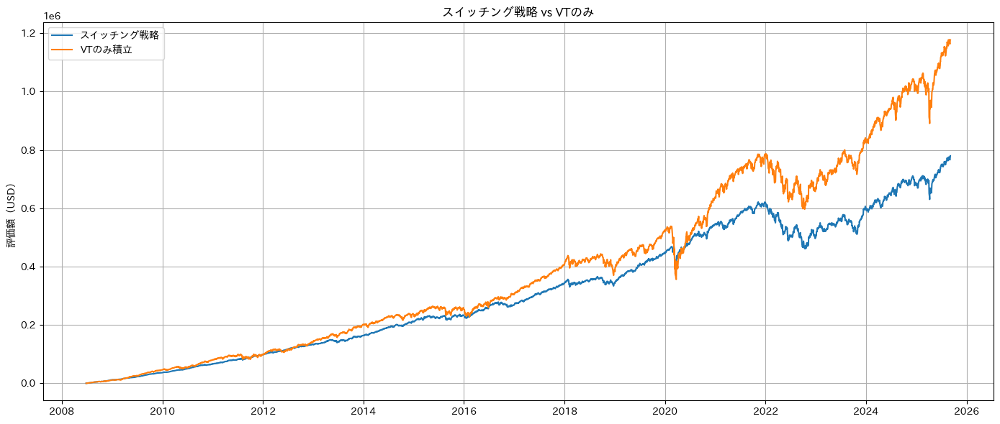


最終評価額（スイッチング）: $779,649.34
最終評価額（VTのみ）: $1,176,955.92


C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\4039093668.py:56: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(f"\n最終評価額（スイッチング）: ${value_switching[-1]:,.2f}")
C:\Users\t-miura\AppData\Local\Temp\ipykernel_20684\4039093668.py:57: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(f"最終評価額（VTのみ）: ${value_vt_only[-1]:,.2f}")


In [ ]:
# VT（全世界株）と TLT（米国債）のスイッチング戦略バックテスト

import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

# データ取得（2008年以降）
tickers = ['VT', 'TLT']
data = yf.download(tickers, start='2008-01-01')['Close']
data = data.dropna()

# 対数価格
log_vt = np.log(data['VT'])
dates = log_vt.index
x = (dates - dates[0]).days.values

# 回帰直線（VT）
slope, intercept, *_ = linregress(x, log_vt.values)
log_trend = intercept + slope * x

# スイッチングルール：VTが回帰線を下回っていたらTLT、それ以外はVT
condition = log_vt < log_trend

# 投資額設定（毎営業日 100ドル）
investment = 100

# 投資単位の計算（どちらか一方にのみ）
daily_units_vt = np.where(condition, 0, investment / data['VT'])
daily_units_tlt = np.where(condition, investment / data['TLT'], 0)

# 累積投資ユニット
cum_units_vt = np.cumsum(daily_units_vt)
cum_units_tlt = np.cumsum(daily_units_tlt)

# 各日の評価額
value_switching = cum_units_vt * data['VT'] + cum_units_tlt * data['TLT']

# 比較：VTのみ積立
vt_units_only = np.cumsum(np.full_like(data['VT'], investment) / data['VT'])
value_vt_only = vt_units_only * data['VT']

# プロット
plt.figure(figsize=(14, 6))
plt.plot(dates, value_switching, label='スイッチング戦略')
plt.plot(dates, value_vt_only, label='VTのみ積立')
plt.title('スイッチング戦略 vs VTのみ')
plt.ylabel('評価額（USD）')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# 最終結果表示
print(f"\n最終評価額（スイッチング）: ${value_switching[-1]:,.2f}")
print(f"最終評価額（VTのみ）: ${value_vt_only[-1]:,.2f}")
